<img src="Images/16794938722698_Data Scientist-P7-01-banner.png">
<center><font color="#00007F" size=7><br><b>PROJET 7<br><br><font color="#3A8EBA" size=6 align="center">Implémentez un modèle de scoring</font></b></font></center>
<br><center><font color="limegreen" size=5><b>Notebook d'ingénierie du modèle (nettoyage, enrichissement, simulations, optimisations)<font color="#00007F"></font></b></font></center>

---

* Dernière mise à jour :  02-07-2025
<a name="sommaire"></a>
### Table of Contents

* [Introduction](#intro)
* [Chapitre 1 Paramétrage techniques](#chapitre1)
    * [1.1 Import des librairies](#section_1_1)
    * [1.2 Options d'affichage](#section_1_2)
    * [1.3 Déclaration des paramètres](#section_1_3)   
    * [1.4 Déclaration des fonctions](#section_1_4)
* [Chapitre 2 Visualisation des données brutes](#chapitre2)
    * [2.1 Chargement des données](#section_2_1)
    * [2.2 Apercu des données](#section_2_2)
* [Chapitre 3 Etude des variables](#chapitre3)
    * [3.1 Analyse univariée]](#section_3_1)
    * [3. Analyse bivariées](#section_3_2
    * [3.3 Imputation des valeurs nulles](#section_3_3)
    * [3.4 Recherche des outliers](#section_3_4))
* [Chapitre 4Features enginnerings](#chapitre4)
    * [4.1Kernel Kagglee](#section_4_1)
    * [4.2Dataset finalisé]e](#section_4_
    * [4.3 Notion de Score Métier](#section_4_3)) 
* [Chapitre Modélisationte](#chapitre5)
    * [5.Tests sur un echantillones](#section_5_1)
    * [5.Optimisation des modèles selectionnéses](#section_5_2* [Chapitre 6 API](#chapitre6)
    * [6.1 Construction du modèle final avec joblib](#section_6_1)
    * [6.2 Déploiement de l'API]](#section_621)
* [Chapitre 7 Data Drift](#chapitre7)4)

---

###  <font color="blue" size=5>Introduction </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="intro"></a><a name="intro"></a>

Vous êtes Data Scientist au sein d'une société financière, nommée <b>"Prêt à dépenser"</b>, qui propose des crédits à la consommation pour des personnes ayant peu ou pas du tout d'historique de prêt.

L’entreprise souhaite <b>mettre en œuvre un outil de “scoring crédit” pour calculer la probabilité</b> qu’un client rembourse son crédit, puis classifie la demande en crédit accordé ou refusé. Elle souhaite donc développer un <b>algorithme de classification</b> en s’appuyant sur des sources de données variées (données comportementales, données provenant d'autres institutions financières, etc.)

###  <font color="blue" size=5>Mission </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="mission"></a><a name="mission"></a>

1. Construire un modèle de scoring qui donnera une prédiction sur la probabilité de faillite d'un client de façon automatique.


2. Analyser les features qui contribuent le plus au modèle, d’une manière générale (feature importance globale) et au niveau d’un client (feature importance locale), afin, dans un soucis de transparence, de permettre à un chargé d’études de mieux comprendre le score attribué par le modèle.


3. Mettre en production le modèle de scoring de prédiction à l’aide d’une API et réaliser une interface de test de cette API.


4. Mettre en œuvre une approche globale MLOps de bout en bout, du tracking des expérimentations à l’analyse en production du data drift.

###  <font color="blue" size=5>Chapitre 1 - Paramétrage techniques </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre1"></a><a name="chapitre1"></a>

#### <font color="green" size=4>1.1 Import des librairies </font><a href="#chapitre1" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_1_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [44]:
import sys
import re                       #librairie pour les expressions regulières
import pandas as pd             #manipulation données
import numpy as np              #caluls/opérations sur les données
import matplotlib #visualisation des données 
import matplotlib.pyplot as plt #visualisation des données sous forme graphique
import seaborn as sns           #visualisation des données sous forme graphique amélioré
from scipy.stats import iqr     #import de la fonction IQR depuis la librairie scipy
import statistics
from sklearn.linear_model import LinearRegression #import de la fonction LinearRegression depuis la librairie sklearn
from statsmodels.graphics.gofplots import qqplot
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics.cluster import pair_confusion_matrix
from scipy import stats
import time
import datetime

from sklearn import preprocessing

import missingno as msno        #import librairie pour les valeurs manquantes
#pip install C:\Users\240694\missingno-0.5.2.tar.gz
#ressource :
#https://www.kaggle.com/code/selahattinsanli/visualizing-missing-data

import webbrowser              #librairie pour lire les pages html

# Analyse et modélisation texte
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report,confusion_matrix

import string

from sklearn.impute import SimpleImputer
import gc
from contextlib import contextmanager
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, roc_curve
from sklearn.model_selection import KFold, StratifiedKFold

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

from sklearn.dummy import DummyClassifier

# Modèles linéaires
from sklearn.linear_model import LogisticRegression

# Modèles ensemblistes 
from sklearn.ensemble import RandomForestClassifier 
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier

from sklearn.metrics import RocCurveDisplay, roc_auc_score, auc, roc_curve, accuracy_score, precision_score, recall_score, fbeta_score, make_scorer, confusion_matrix

from sklearn import model_selection
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay 
from sklearn.pipeline import Pipeline

from imblearn.over_sampling import SMOTE, RandomOverSampler, SMOTENC
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import Pipeline as imbpipeline

import mlflow

from sklearn.base import clone
import matplotlib.ticker as ticker
import os

from matplotlib import cm
from matplotlib.colors import Normalize
import shap
import joblib
from evidently import Report
from evidently.presets import DataDriftPreset

In [14]:
print("Version de Python")
print(sys.version)

Version de Python
3.12.4 | packaged by Anaconda, Inc. | (main, Jun 18 2024, 15:03:56) [MSC v.1929 64 bit (AMD64)]


In [48]:
pip show numpy pandas matplotlib seaborn scipy scikit-learn missingno pytest mlflow evidently streamlit fastapi shap joblib imbalanced-learn

Name: numpy
Version: 1.26.4
Summary: Fundamental package for array computing in Python
Home-page: https://numpy.org
Author: Travis E. Oliphant et al.
Author-email: 
License: Copyright (c) 2005-2023, NumPy Developers.
All rights reserved.

Redistribution and use in source and binary forms, with or without
modification, are permitted provided that the following conditions are
met:

    * Redistributions of source code must retain the above copyright
       notice, this list of conditions and the following disclaimer.

    * Redistributions in binary form must reproduce the above
       copyright notice, this list of conditions and the following
       disclaimer in the documentation and/or other materials provided
       with the distribution.

    * Neither the name of the NumPy Developers nor the names of any
       contributors may be used to endorse or promote products derived
       from this software without specific prior written permission.

THIS SOFTWARE IS PROVIDED BY THE COPYR

| Module   | N° version
| :---        | :----       
| Python      | 3.12.4          
| numpy       | 1.26.4          
| pandas      | 2.2.2
| matplotlib  | 3.8.4       
| seaborn	  | 0.13.2     
| scipy	      | 1.13.1
| scikit-learn	      | 1.4.2
| Notebook Jupyter |6.3.0
| missingno | 0.4.2

#### <font color="green" size=4>1.2 Options d'affichage </font><a href="#chapitre1" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_1_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [18]:
pd.set_option("display.max_columns", None)
pd.set_option('display.max_colwidth', None)

#### <font color="green" size=4>1.3 Déclarations des paramètres </font><a href="#chapitre1" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_1_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

repertoire de la source de données :

In [23]:
source_repertory = 'Sources/'

nom des fichiers sources :

In [25]:
source_app_test='application_test.csv'
source_app_train='application_train.csv'
source_bureau='bureau.csv'
source_bureau_balance='bureau_balance.csv'
source_credit_card_balance='credit_card_balance.csv'
source_HomeCredit_columns_description='HomeCredit_columns_description.csv'
source_installments_payments='installments_payments.csv'
source_POS_CASH_balance='POS_CASH_balance.csv'
source_previous_application='previous_application.csv'
source_sample_submission='sample_submission.csv'


separateur défini dans le fichier source :

In [27]:
delimiter_file = ','

#### <font color="green" size=4>1.4 Déclaration des fonctions </font><a href="#chapitre1" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_1_4"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [29]:
###################################################################################################
#fonction retournant l'ensemble des colonnes d'un dataframe avec le type de colonne et le % valeurs NaN
#df : un dataframe
###################################################################################################
def desc_col (df):
    infos = pd.DataFrame(df.dtypes).T.rename(index={0:'Type'}) 
    infos = infos.append(pd.DataFrame(round((df.isna().sum()*100/df.shape[0]),1)).T.rename(index={0:'%_null'}))
    infos = infos.append(pd.DataFrame(round(100-(df.isna().sum()*100/df.shape[0]),1)).T.rename(index={0:'%_fill'}))
    return infos

# HOME CREDIT DEFAULT RISK COMPETITION
# Most features are created by applying min, max, mean, sum and var functions to grouped tables. 
# Little feature selection is done and overfitting might be a problem since many features are related.
# The following key ideas were used:
# - Divide or subtract important features to get rates (like annuity and income)
# - In Bureau Data: create specific features for Active credits and Closed credits
# - In Previous Applications: create specific features for Approved and Refused applications
# - Modularity: one function for each table (except bureau_balance and application_test)
# - One-hot encoding for categorical features
# All tables are joined with the application DF using the SK_ID_CURR key (except bureau_balance).

@contextmanager
def timer(title):
    t0 = time.time()
    yield
    print("{} - done in {:.0f}s".format(title, time.time() - t0))

# One-hot encoding for categorical columns with get_dummies + Converting NaN Values into a Dummy Variable
def one_hot_encoder(df, nan_as_category = True):
    original_columns = list(df.columns)
    categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
    df = pd.get_dummies(df, columns= categorical_columns, dummy_na= nan_as_category)
    new_columns = [c for c in df.columns if c not in original_columns]
    return df, new_columns

# Preprocess application_train.csv
def application_train(num_rows = None, nan_as_category = False):
    df = DataTrain_impute
    print("Train samples: {}".format(len(df)))
    # Optional: Remove 4 applications with XNA CODE_GENDER (train set)
    #df = df[df['CODE_GENDER'] != 'XNA']
    
    # Categorical features with Binary encode (0 or 1; two categories)
    for bin_feature in ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY']:
        df[bin_feature], uniques = pd.factorize(df[bin_feature])
    # Categorical features with One-Hot encode
    df, cat_cols = one_hot_encoder(df, nan_as_category)
    
    # NaN values for DAYS_EMPLOYED: 365.243 -> nan
    #df['DAYS_EMPLOYED'].replace(365243, np.nan, inplace= True)
    # Some simple new features (percentages)
    
    # the percentage of the days employed relative to the client's age
    df['DAYS_EMPLOYED_PERC'] = df['DAYS_EMPLOYED'] / df['DAYS_BIRTH']
    # the percentage of the credit amount relative to a client's income
    df['CREDIT_INCOME_PERC'] = df['AMT_CREDIT'] / df['AMT_INCOME_TOTAL']
    #  the percentage of the client's income to one person in familly 
    df['INCOME_PER_PERSON'] = df['AMT_INCOME_TOTAL'] / df['CNT_FAM_MEMBERS']
    # the percentage of the loan annuity relative to a client's income
    df['ANNUITY_INCOME_PERC'] = df['AMT_ANNUITY'] / df['AMT_INCOME_TOTAL']
    # the length of the payment in months (since the annuity is the monthly amount due
    df['PAYMENT_RATE'] = df['AMT_ANNUITY'] / df['AMT_CREDIT']
    
    gc.collect()
    return df

# Preprocess bureau.csv and bureau_balance.csv
def bureau_and_balance(num_rows = None, nan_as_category = True):
    bureau = DataBureau
    bb = DataBureauBalance
    bb, bb_cat = one_hot_encoder(bb, nan_as_category)
    bureau, bureau_cat = one_hot_encoder(bureau, nan_as_category)
    
    # Bureau balance: Perform aggregations and merge with bureau.csv
    bb_aggregations = {'MONTHS_BALANCE': ['min', 'max', 'size']}
    for col in bb_cat:
        bb_aggregations[col] = ['mean']
    bb_agg = bb.groupby('SK_ID_BUREAU').agg(bb_aggregations)
    bb_agg.columns = pd.Index([e[0] + "_" + e[1].upper() for e in bb_agg.columns.tolist()])
    bureau = bureau.join(bb_agg, how='left', on='SK_ID_BUREAU')
    bureau.drop(['SK_ID_BUREAU'], axis=1, inplace= True)
    del bb, bb_agg
    gc.collect()
    
    # Bureau and bureau_balance numeric features
    num_aggregations = {
        'DAYS_CREDIT': ['min', 'max', 'mean', 'var'],
        'DAYS_CREDIT_ENDDATE': ['min', 'max', 'mean'],
        'DAYS_CREDIT_UPDATE': ['mean'],
        'CREDIT_DAY_OVERDUE': ['max', 'mean'],
        'AMT_CREDIT_MAX_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_DEBT': ['max', 'mean', 'sum'],
        'AMT_CREDIT_SUM_OVERDUE': ['mean'],
        'AMT_CREDIT_SUM_LIMIT': ['mean', 'sum'],
        'AMT_ANNUITY': ['max', 'mean'],
        'CNT_CREDIT_PROLONG': ['sum'],
        'MONTHS_BALANCE_MIN': ['min'],
        'MONTHS_BALANCE_MAX': ['max'],
        'MONTHS_BALANCE_SIZE': ['mean', 'sum']
    }
    # Bureau and bureau_balance categorical features
    cat_aggregations = {}
    for cat in bureau_cat: cat_aggregations[cat] = ['mean']
    for cat in bb_cat: cat_aggregations[cat + "_MEAN"] = ['mean']
    
    bureau_agg = bureau.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    bureau_agg.columns = pd.Index(['BURO_' + e[0] + "_" + e[1].upper() for e in bureau_agg.columns.tolist()])
    # Bureau: Active credits - using only numerical aggregations
    active = bureau[bureau['CREDIT_ACTIVE_Active'] == 1]
    active_agg = active.groupby('SK_ID_CURR').agg(num_aggregations)
    active_agg.columns = pd.Index(['ACTIVE_' + e[0] + "_" + e[1].upper() for e in active_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(active_agg, how='left', on='SK_ID_CURR')
    del active, active_agg
    gc.collect()
    # Bureau: Closed credits - using only numerical aggregations
    closed = bureau[bureau['CREDIT_ACTIVE_Closed'] == 1]
    closed_agg = closed.groupby('SK_ID_CURR').agg(num_aggregations)
    closed_agg.columns = pd.Index(['CLOSED_' + e[0] + "_" + e[1].upper() for e in closed_agg.columns.tolist()])
    bureau_agg = bureau_agg.join(closed_agg, how='left', on='SK_ID_CURR')
    del closed, closed_agg, bureau
    gc.collect()
    return bureau_agg

# Preprocess previous_applications.csv
def previous_applications(num_rows = None, nan_as_category = True):
    prev = DataPreviousApplication
    prev, cat_cols = one_hot_encoder(prev, nan_as_category= True)
    # Days 365.243 values -> nan
    prev['DAYS_FIRST_DRAWING'].replace(365243, np.nan, inplace= True)
    prev['DAYS_FIRST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE_1ST_VERSION'].replace(365243, np.nan, inplace= True)
    prev['DAYS_LAST_DUE'].replace(365243, np.nan, inplace= True)
    prev['DAYS_TERMINATION'].replace(365243, np.nan, inplace= True)
    # Add feature: value ask / value received percentage
    prev['APP_CREDIT_PERC'] = prev['AMT_APPLICATION'] / prev['AMT_CREDIT']
    # Previous applications numeric features
    num_aggregations = {
        'AMT_ANNUITY': ['min', 'max', 'mean'],
        'AMT_APPLICATION': ['min', 'max', 'mean'],
        'AMT_CREDIT': ['min', 'max', 'mean'],
        'APP_CREDIT_PERC': ['min', 'max', 'mean', 'var'],
        'AMT_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'AMT_GOODS_PRICE': ['min', 'max', 'mean'],
        'HOUR_APPR_PROCESS_START': ['min', 'max', 'mean'],
        'RATE_DOWN_PAYMENT': ['min', 'max', 'mean'],
        'DAYS_DECISION': ['min', 'max', 'mean'],
        'CNT_PAYMENT': ['mean', 'sum'],
    }
    # Previous applications categorical features
    cat_aggregations = {}
    for cat in cat_cols:
        cat_aggregations[cat] = ['mean']
    
    prev_agg = prev.groupby('SK_ID_CURR').agg({**num_aggregations, **cat_aggregations})
    prev_agg.columns = pd.Index(['PREV_' + e[0] + "_" + e[1].upper() for e in prev_agg.columns.tolist()])
    # Previous Applications: Approved Applications - only numerical features
    approved = prev[prev['NAME_CONTRACT_STATUS_Approved'] == 1]
    approved_agg = approved.groupby('SK_ID_CURR').agg(num_aggregations)
    approved_agg.columns = pd.Index(['APPROVED_' + e[0] + "_" + e[1].upper() for e in approved_agg.columns.tolist()])
    prev_agg = prev_agg.join(approved_agg, how='left', on='SK_ID_CURR')
    # Previous Applications: Refused Applications - only numerical features
    refused = prev[prev['NAME_CONTRACT_STATUS_Refused'] == 1]
    refused_agg = refused.groupby('SK_ID_CURR').agg(num_aggregations)
    refused_agg.columns = pd.Index(['REFUSED_' + e[0] + "_" + e[1].upper() for e in refused_agg.columns.tolist()])
    prev_agg = prev_agg.join(refused_agg, how='left', on='SK_ID_CURR')
    del refused, refused_agg, approved, approved_agg, prev
    gc.collect()
    return prev_agg

# Preprocess POS_CASH_balance.csv
def pos_cash(num_rows = None, nan_as_category = True):
    pos = DataPosCashBalance
    pos, cat_cols = one_hot_encoder(pos, nan_as_category= True)
    # Features
    aggregations = {
        'MONTHS_BALANCE': ['max', 'mean', 'size'],
        'SK_DPD': ['max', 'mean'],
        'SK_DPD_DEF': ['max', 'mean']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    
    pos_agg = pos.groupby('SK_ID_CURR').agg(aggregations)
    pos_agg.columns = pd.Index(['POS_' + e[0] + "_" + e[1].upper() for e in pos_agg.columns.tolist()])
    # Count pos cash accounts
    pos_agg['POS_COUNT'] = pos.groupby('SK_ID_CURR').size()
    del pos
    gc.collect()
    return pos_agg
    
# Preprocess installments_payments.csv
def installments_payments(num_rows = None, nan_as_category = True):
    ins = DataInstallmentsPayments
    ins, cat_cols = one_hot_encoder(ins, nan_as_category= True)
    # Percentage and difference paid in each installment (amount paid and installment value)
    ins['PAYMENT_PERC'] = ins['AMT_PAYMENT'] / ins['AMT_INSTALMENT']
    ins['PAYMENT_DIFF'] = ins['AMT_INSTALMENT'] - ins['AMT_PAYMENT']
    # Days past due and days before due (no negative values)
    ins['DPD'] = ins['DAYS_ENTRY_PAYMENT'] - ins['DAYS_INSTALMENT']
    ins['DBD'] = ins['DAYS_INSTALMENT'] - ins['DAYS_ENTRY_PAYMENT']
    ins['DPD'] = ins['DPD'].apply(lambda x: x if x > 0 else 0)
    ins['DBD'] = ins['DBD'].apply(lambda x: x if x > 0 else 0)
    # Features: Perform aggregations
    aggregations = {
        'NUM_INSTALMENT_VERSION': ['nunique'],
        'DPD': ['max', 'mean', 'sum'],
        'DBD': ['max', 'mean', 'sum'],
        'PAYMENT_PERC': ['max', 'mean', 'sum', 'var'],
        'PAYMENT_DIFF': ['max', 'mean', 'sum', 'var'],
        'AMT_INSTALMENT': ['max', 'mean', 'sum'],
        'AMT_PAYMENT': ['min', 'max', 'mean', 'sum'],
        'DAYS_ENTRY_PAYMENT': ['max', 'mean', 'sum']
    }
    for cat in cat_cols:
        aggregations[cat] = ['mean']
    ins_agg = ins.groupby('SK_ID_CURR').agg(aggregations)
    ins_agg.columns = pd.Index(['INSTAL_' + e[0] + "_" + e[1].upper() for e in ins_agg.columns.tolist()])
    # Count installments accounts
    ins_agg['INSTAL_COUNT'] = ins.groupby('SK_ID_CURR').size()
    del ins
    gc.collect()
    return ins_agg

# Preprocess credit_card_balance.csv
def credit_card_balance(num_rows = None, nan_as_category = True):
    cc = DataCreditCardBalance
    cc, cat_cols = one_hot_encoder(cc, nan_as_category= True)
    # General aggregations
    cc.drop(['SK_ID_PREV'], axis= 1, inplace = True)
    cc_agg = cc.groupby('SK_ID_CURR').agg(['min', 'max', 'mean', 'sum', 'var'])
    cc_agg.columns = pd.Index(['CC_' + e[0] + "_" + e[1].upper() for e in cc_agg.columns.tolist()])
    # Count credit card lines
    cc_agg['CC_COUNT'] = cc.groupby('SK_ID_CURR').size()
    del cc
    gc.collect()
    return cc_agg

# calul des features engineering avec jointure des différents datasets sur le dataset TRAIN
def feature_engineering(num_rows=None):

    df = application_train(num_rows)
    with timer("Process bureau and bureau_balance"):
        bureau = bureau_and_balance(num_rows)
        print("Bureau df shape:", bureau.shape)
        df = df.join(bureau, how='left', on='SK_ID_CURR')
        del bureau
        gc.collect()
    with timer("Process previous_applications"):
        prev = previous_applications(num_rows)
        print("Previous applications df shape:", prev.shape)
        df = df.join(prev, how='left', on='SK_ID_CURR')
        del prev
        gc.collect()
    with timer("Process POS-CASH balance"):
        pos = pos_cash(num_rows)
        print("Pos-cash balance df shape:", pos.shape)
        df = df.join(pos, how='left', on='SK_ID_CURR')
        del pos
        gc.collect()
    with timer("Process installments payments"):
        ins = installments_payments(num_rows)
        print("Installments payments df shape:", ins.shape)
        df = df.join(ins, how='left', on='SK_ID_CURR')
        del ins
        gc.collect()
    with timer("Process credit card balance"):
        cc = credit_card_balance(num_rows)
        print("Credit card balance df shape:", cc.shape)
        df = df.join(cc, how='left', on='SK_ID_CURR')
        del cc
        gc.collect()
    
    df.to_csv('Sources/my_data_feature_engineering.csv', index=False)
    
    return df

# colonnes avec des valeurs infinis 
def get_columns_with_infinite_values(df):
    res = pd.DataFrame()
    inf_cols = df.columns[np.isinf(df).any()]
    for col in inf_cols:
        inf_rows = np.isinf(df[col]).sum()
        res = res.append(
            {'colonne': col, 'inf_count': inf_rows}, ignore_index=True)
    return res


# on remplace les valeurs infinies avec np.nan
def replace_infinite_values_with_nan(df: pd.DataFrame):
    print(f'les valeurs infinite ont bien remplacé')
    return df.replace([np.inf, -np.inf], np.nan)

# colonnes avec une seule modalité 
def get_single_value_cols(df: pd.DataFrame):
    unique_vals = df.nunique()
    return unique_vals[unique_vals == 1].index.to_list()

#suppression des colonnes avec 1 seule modalité
def drop_single_value_cols(df: pd.DataFrame, cols_to_drop=None):
    if cols_to_drop is None:
        cols_to_drop = get_single_value_cols(df)
    if len(cols_to_drop) > 0:
        print(f'supprimer les colonnes avec seulement une valeur, nb.cols = {len(cols_to_drop)}')
        return df.drop(columns=cols_to_drop)
    return df

#  Nettoie les noms de colonnes d’un DataFrame :
#    - remplace les caractères spéciaux par "_"
#    - supprime les "_" en début/fin
#    - supprime les espaces multiples
def clean_column_names(df):
    df.columns = (
        df.columns
        .str.replace('[^A-Za-z0-9_]+', '_', regex=True)
        .str.strip('_')
        .str.replace('__+', '_', regex=True)  # remplace plusieurs underscores par un seul
    )
    return df

#détection des colonnes binaires et catégorielles encodées en entiers dans ton jeu de données
#utile pour smote
def detect_categorical_binary_columns(df):
    categorical_cols = []
    for col in df.columns:
        unique_vals = set(df[col].dropna().unique())
        # Colonne binaire : valeurs uniques subset de {0,1}
        if unique_vals <= {0, 1}:
            categorical_cols.append(col)
        # Colonne catégorielle : type int et peu de modalités (exemple <= 10)
        elif np.issubdtype(df[col].dtype, np.integer) and len(unique_vals) <= 10:
            categorical_cols.append(col)
    return categorical_cols

#Obtenir un échantillon de X et y pour des statistiques pour eviter d'alourdir la traitement
def sample_data(df_x: pd.DataFrame, y_: pd.Series, nb=10000):
    nb = min(nb, len(df_x))
    target = y_.name
    df_x = df_x.join(y_)
    df_sample = df_x.sample(n=nb, random_state=42)
    y_sample = df_sample[target]
    x_sample = df_sample.drop(columns=target)
    return x_sample, y_sample


# Traitement du déséquilibre de classe de la target avec les differentes methodes d'equilibrage
def umbalanced_data(x, y, method_df) :
    #y_train
    #y_train=df['TARGET']
    #y_train 
    
    y_train=y
    
    #X_train
    #feats = [f for f in df.columns if f not in ['TARGET','SK_ID_CURR','SK_ID_BUREAU','SK_ID_PREV']]
    #X_train=df.filter(feats)
    X_train = x
    # Représentation déséquilibre de la target
    #proportion_pattern = df['TARGET'].value_counts()
    #labels = proportion_pattern.index
    #explode = (0.02, 0) 

    #ax.pie(proportion_pattern, labels=labels, explode=explode, 
    #       autopct='%1.1f%%', shadow=True, startangle=90)
    #plt.pie(proportion_pattern, labels=labels, autopct='%.1f%%',
    #       textprops={'size': 'medium'}, radius=0.5,explode=explode)

    #plt.axis('equal')
    #plt.title('Pourcentage de la variable TARGET', fontsize=8)
    #plt.show()
    
        
    # Traitement des classes déséquilibrées avec la méthode passé en parametre 
    method_equilibrage = method_df
    
    with timer("Traitement de la target déséquilibrée"):
        # fit predictor and target variable
        X_equilibre, y_equilibre = method_equilibrage.fit_resample(X_train, y_train)
        print('Original dataset shape', y_train.shape)
        print('Resample dataset shape',y_equilibre.shape) 
        print(method_df, ' a crée des données pour que la classe minoritaire ( target = 1 ) ait la même taille que la classe majoritaire.\n', y_equilibre.value_counts())
    y_equilibre.value_counts()   
    X_equilibre.shape
    return X_equilibre, y_equilibre



#Fonction de scoring personnalisé 
def cost_per_client(y_true, y_pred, fn_cost=10, fp_cost=1):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    return (fn_cost * fn + fp_cost * fp) / len(y_true)

cost_per_client_scorer = make_scorer(cost_per_client, greater_is_better=False)


#Définition fonctions coût métier
def cost_metric(y_true, y_pred, fn_cost=10, fp_cost=1):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    return fn_cost * fn + fp_cost * fp

#Cherche le meilleur seuil qui optimise le cout métier au minimum
def find_best_threshold(y_true, y_proba, thresholds=np.arange(0.01, 0.99, 0.01), fn_cost=10, fp_cost=1):
    costs = []
    for t in thresholds:
        y_pred = (y_proba >= t).astype(int)
        costs.append(cost_metric(y_true, y_pred, fn_cost, fp_cost))
    best_idx = np.argmin(costs)
    return thresholds[best_idx], costs[best_idx]
    
#Courbe d'apprentissage métier
def learning_curve_with_custom_threshold(model, X, y, train_sizes=np.linspace(0.1,1.0,4), cv=3, fn_cost=10, fp_cost=1, random_state=42):
    train_costs_mean, val_costs_mean = [], []
    train_costs_std, val_costs_std = [], []
    thresholds_all = []
    thresholds_std = []
    time_train = []
    start_time_learning_curve = datetime.datetime.now()
    skf = StratifiedKFold(n_splits=cv, shuffle=True, random_state=random_state)

    
    for frac in train_sizes:
        start_time = datetime.datetime.now()
        train_costs, val_costs, thresholds_fold  = [], [], []

        n_samples = int(len(X)*frac)
        X_frac = X[:n_samples]
        y_frac = y[:n_samples]

        for train_idx, val_idx in skf.split(X_frac, y_frac):
            X_train_fold, X_val_fold = X_frac.iloc[train_idx], X_frac.iloc[val_idx]
            y_train_fold, y_val_fold = y_frac.iloc[train_idx], y_frac.iloc[val_idx]

            clf = clone(model)
            #clf.set_params(model__verbose=False)
            clf.fit(X_train_fold, y_train_fold)

            y_val_proba = clf.predict_proba(X_val_fold)[:,1]
            best_thresh, _ = find_best_threshold(y_val_fold, y_val_proba, fn_cost=fn_cost, fp_cost=fp_cost)
            thresholds_fold.append(best_thresh)
            
            y_train_proba = clf.predict_proba(X_train_fold)[:,1]
            y_train_pred = (y_train_proba >= best_thresh).astype(int)
            train_cost = cost_metric(y_train_fold, y_train_pred, fn_cost, fp_cost) / len(y_train_fold) #cout moyen par client dans le train
            train_costs.append(train_cost)

            y_val_pred = (y_val_proba >= best_thresh).astype(int)
            val_cost = cost_metric(y_val_fold, y_val_pred, fn_cost, fp_cost) / len(y_val_fold) #cout moyen par client dans le val
            val_costs.append(val_cost)
        
        train_costs_mean.append(np.mean(train_costs))
        val_costs_mean.append(np.mean(val_costs))
        train_costs_std.append(np.std(train_costs))
        val_costs_std.append(np.std(val_costs))
        thresholds_all.append(np.mean(thresholds_fold))
        thresholds_std.append(np.std(thresholds_fold))
        
        end_time = datetime.datetime.now()
        duration  = (end_time - start_time).total_seconds() #en seconde
        time_train.append(duration)

    end_time_learning_curve = datetime.datetime.now()
    duration_learning_curve  = (end_time_learning_curve - start_time_learning_curve).total_seconds() #en seconde

    return (train_sizes*100, 
            np.array(train_costs_mean), np.array(val_costs_mean), 
            np.array(train_costs_std), np.array(val_costs_std), np.array(time_train), np.array(thresholds_all),  np.array(thresholds_std),
            duration_learning_curve
           )

#Affiche la courbe d'apprentissage du modèle par cout métier moyen par client sur le jeu de train et de validation pour chaque echantillon testé
def show_learning_curve(config, train_sizes_pct, train_mean, train_std, val_mean, val_std, thresholds_mean, thresholds_std, time_train):
    fig = plt.figure(figsize=(8,6))
    
    # Axe principal : coût métier
    ax1 = plt.gca()
    ax1.plot(train_sizes_pct, train_mean, 'o-', color='blue', label='Coût métier train (moyenne)')
    ax1.fill_between(train_sizes_pct, train_mean - train_std, train_mean + train_std, alpha=0.1, color='blue')
    
    ax1.plot(train_sizes_pct, val_mean, 'o-', color='green', label='Coût métier val (moyenne)')
    ax1.fill_between(train_sizes_pct, val_mean - val_std, val_mean + val_std, alpha=0.1, color='green')
    
    ax1.set_xlabel("Taille échantillon entraînement (%)")
    ax1.set_ylabel("Coût métier moyen par client")
    ax1.tick_params(axis='y')
    #ax1.grid()
    ax1.grid(True, color='lightgray', linestyle='--', linewidth=0.8)
    # Axe secondaire : temps d'entraînement
    ax2 = ax1.twinx()
    ax2.plot(train_sizes_pct, time_train, 'o--', color='red', label="Temps d'entraînement (sec)")
    ax2.set_ylabel("Temps d'entraînement (secondes)", color='red')
    ax2.tick_params(axis='y', labelcolor='red')

    # Axe tertiaire : seuil optimal (axe décalé à droite)
    ax3 = ax1.twinx()
    
    # Décaler cet axe vers la droite
    ax3.spines["right"].set_position(("axes", 1.2))  # 1.2 = 20% à droite de ax2
    ax3.plot(train_sizes_pct, thresholds_mean, 'o--', color='grey', label="Seuil optimisé")
    ax3.fill_between(train_sizes_pct, thresholds_mean - thresholds_std, thresholds_mean + thresholds_std, alpha=0.1, color='grey')
    ax3.set_ylabel("Seuil optimisé", color='grey')
    ax3.tick_params(axis='y', colors='grey')

    # Définir une échelle personnalisée pour ax3
    ax3.set_ylim(0, 1)
    ax3.set_yticks([0.0, 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])
    ax3.set_yticklabels(['0%', '10%', '20%', '30%', '40%', '50%', '60%', '70%', '80%', '90%', '100%'])

    # Pour que le 3ème axe soit visible
    ax3.spines["right"].set_visible(True)

    # Légendes combinées
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    lines3, labels3 = ax3.get_legend_handles_labels()
    plt.legend(lines1 + lines2 + lines3, labels1 + labels2 + labels3, loc='upper center', bbox_to_anchor=(0.5, -0.15))
    
    plt.title("Courbe d'apprentissage avec coût métier moyen par client et temps d'entraînement")
    plt.tight_layout()
    name = "mlflow_outputs/learning_curve_"+config+".png"
    fig.savefig(name)
    mlflow.log_artifact(name)
    plt.show()



#Fonction d'évaluation d'un fold
def eval_fold(model, X_train, y_train, X_val, y_val, seuils=np.arange(0.01, 0.99, 0.01), fn_cost=10, fp_cost=1):
    model.fit(X_train, y_train)
    y_proba = model.predict_proba(X_val)[:, 1]
    best_thresh, best_cost = 0.5, float('inf')
    for s in seuils:
        y_pred = (y_proba >= s).astype(int)
        cost = cost_per_client(y_val, y_pred, fn_cost, fp_cost)
        if cost < best_cost:
            best_cost = cost
            best_thresh = s
    cost_05 = cost_per_client(y_val, (y_proba >= 0.5).astype(int), fn_cost, fp_cost)
    gain = cost_05 - best_cost
    roc_auc = roc_auc_score(y_val, y_proba)
    return best_thresh, best_cost, cost_05, gain, roc_auc


#Affichage de la courbe coût métier en fonction du seuil
def plot_cost_vs_threshold(model_label, y_true, y_proba, fn_cost=10, fp_cost=1, seuil_special=None):
    seuils = np.arange(0.01, 0.99, 0.01)
    costs = []
    fn_list, fp_list = [], []
    for s in seuils:
        y_pred = (y_proba >= s).astype(int)
        tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
        cost = (fn_cost * fn + fp_cost * fp) / len(y_true)
        costs.append(cost)
        fn_list.append(fn)
        fp_list.append(fp)

    #Trouver seuil optimal et seuil 0.5
    #best_idx = np.argmin(costs)
    #best_thresh = seuils[best_idx]
    #best_cost = costs[best_idx]
    if seuil_special is not None:
        y_pred_special = (y_proba >= seuil_special).astype(int)
        cost_special = (fn_cost * confusion_matrix(y_true, y_pred_special).ravel()[2] + 
                        fp_cost * confusion_matrix(y_true, y_pred_special).ravel()[1]) / len(y_true)
 
    idx_05 = np.argmin(np.abs(seuils - 0.5))
    cost_05 = costs[idx_05]
    
    fig, ax1 = plt.subplots(figsize=(7, 5))
    ax1.plot(seuils, np.array(fn_list), label="Faux Négatifs (FN)", color='red')
    ax1.plot(seuils, np.array(fp_list), label="Faux Positifs (FP)", color='blue')
    ax1.set_xlabel("Seuil de classification")
    ax1.set_ylabel("Composantes du coût métier")
    ax1.grid(True, color='lightgray', linestyle='--', linewidth=0.8)

    ax2 = ax1.twinx()
    ax2.plot(seuils, costs, label='Coût métier', color='black')
    ax2.set_ylabel("Coût métier moyen par client", color='black')
    ax2.tick_params(axis='y', labelcolor='black')

    ax1.axvline(x=seuil_special, color='green', linestyle='--', label=f"Seuil optimisé CV = {seuil_special:.2f} (Coût = {cost_special:.3f})")
    ax1.axvline(x=0.5, color='red', linestyle='--', label=f"Seuil défaut = 0.5 (Coût = {cost_05:.3f})")

    lines_1, labels_1 = ax1.get_legend_handles_labels()
    lines_2, labels_2 = ax2.get_legend_handles_labels()
    ax1.legend(lines_1 + lines_2, labels_1 + labels_2, loc='upper center', bbox_to_anchor=(0.5, -0.15))
 
    plt.title("Evaluation du coût métier en fonction du seuil")
    plt.tight_layout()
    plt.xticks(np.arange(0.0, 1.0, 0.10)) 
    name = "mlflow_outputs/"+model_label+"_cost_vs_threshold.png"
    plt.savefig(name)
    mlflow.log_artifact(name)
    plt.show()


# --- 5. Fonction évaluation finale ---
def eval_seuil_final_(model, modellabel, config, Xtrainval, ytrainval, Xtest, ytest, fn_cost=10, fp_cost=1, cv_res=None, log_mlflow=True, df_perf=None, best_params=None, tuning=None):
    start_eval = time.time()
    model.fit(Xtrainval, ytrainval)
    y_proba_train = model.predict_proba(Xtrainval)[:, 1]
    #seuils = np.arange(0.01, 0.99, 0.01)
    #seuil_costs = [(s, cost_per_client(ytrainval, (y_proba_train >= s).astype(int), fn_cost, fp_cost)) for s in seuils]
    #best_thresh = min(seuil_costs, key=lambda x: x[1])[0]
    best_thresh = round(cv_res["seuil_moyen"],2)
    y_proba_test = model.predict_proba(Xtest)[:, 1]
    y_pred_opt = (y_proba_test >= best_thresh).astype(int)
    y_pred_05 = (y_proba_test >= 0.5).astype(int)
    cost_opt = cost_per_client(ytest, y_pred_opt, fn_cost, fp_cost)
    cost_05 = cost_per_client(ytest, y_pred_05, fn_cost, fp_cost)
    gain = cost_05 - cost_opt
    roc_auc = roc_auc_score(ytest, y_proba_test)

    #Courbe d'évaluation du cout métier en fonction du seuil avec marquage du seuil optimisé issue de la CV et le seuil par defaut
    plot_cost_vs_threshold(modellabel, ytest, y_proba_test, fn_cost, fp_cost, best_thresh)
    
    cm_opt_raw = confusion_matrix(ytest, y_pred_opt)
    cm_opt = confusion_matrix(ytest, y_pred_opt, normalize='all') #pourcentages sur total
    cm_default_raw = confusion_matrix(ytest, y_pred_05)
    cm_default = confusion_matrix(ytest, y_pred_05, normalize='all') #pourcentages sur total

    #Matrice confusion optimisée
    annot_opt = np.array([[f"{v}\n({p:.2%})" for v, p in zip(row_v, row_p)] for row_v, row_p in zip(cm_opt_raw, cm_opt)])
    fig1, ax1 = plt.subplots(figsize=(4, 3))
    sns.heatmap(cm_opt, annot=annot_opt, fmt="", cmap="Blues", ax=ax1, cbar=False, xticklabels=["0", "1"], yticklabels=["0", "1"])
    ax1.set_title(f"Matrice confusion (seuil optimisé = {best_thresh:.2f})")
    ax1.set_xlabel("Prédiction")
    ax1.set_ylabel("Réel")
    fig1.tight_layout()
    name1 = "mlflow_outputs/"+config+"_conf_matrix_optim.png"
    fig1.savefig(name1) 
    mlflow.log_artifact(name1)
    plt.show(fig1)

    # Matrice confusion seuil 0.5
    annot_default = np.array([[f"{v}\n({p:.2%})" for v, p in zip(row_v, row_p)] for row_v, row_p in zip(cm_default_raw, cm_default)])
    fig2, ax2 = plt.subplots(figsize=(4, 3))
    sns.heatmap(cm_default, annot=annot_default, fmt="", cmap="Reds", ax=ax2, cbar=False, xticklabels=["0", "1"], yticklabels=["0", "1"])
    ax2.set_title("Matrice confusion (seuil défaut = 0.5)")
    ax2.set_xlabel("Prédiction")
    ax2.set_ylabel("Réel")
    fig2.tight_layout()
    name2 = "mlflow_outputs/"+config+"_conf_matrix_default.png"
    fig2.savefig(name2)
    mlflow.log_artifact(name2)
    plt.show(fig2)


    # ROC curve with point at optimal threshold
    fpr, tpr, thresholds = roc_curve(ytest, y_proba_test)
    fig3, ax3 = plt.subplots(figsize=(6, 5))
    ax3.plot(fpr, tpr, label="ROC curve")
    ax3.plot([0, 1], [0, 1], linestyle='--', color='grey')
    
    # Trouver le TPR et FPR pour le seuil optimal
    idx_thresh = np.argmin(np.abs(thresholds - best_thresh))
    fpr_opt = fpr[idx_thresh]
    tpr_opt = tpr[idx_thresh]
    
    # Affichage du point
    ax3.plot(fpr_opt, tpr_opt, marker='o', color='green', label=f"Seuil optimisé = {best_thresh:.2f}\n(FPR={fpr_opt:.2f}, TPR={tpr_opt:.2f})")
    
    # Seuil 0.5
    idx_05 = np.argmin(np.abs(thresholds - 0.5))
    fpr_05 = fpr[idx_05]
    tpr_05 = tpr[idx_05]
    ax3.plot(fpr_05, tpr_05, marker='x', color='red', label=f"Seuil défaut = 0.5\n(FPR={fpr_05:.2f}, TPR={tpr_05:.2f})")
    
    ax3.set_xlabel("Taux de faux positifs (FPR)")
    ax3.set_ylabel("Taux de vrais positifs (TPR)")
    ax3.set_title(f"Courbe ROC (AUC = {roc_auc:.3f})")
    ax3.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15))
    ax3.grid(True, color='lightgray', linestyle='--', linewidth=0.8)

    fig3.tight_layout()
    name3 = "mlflow_outputs/"+config+"_roc_curve.png"
    fig3.savefig(name3)
    mlflow.log_artifact(name3)
    plt.show(fig3)

    #Enregistrement de plusieurs paramètres sous forme d'un dictionnaire
    paramss = {}
    paramss['MODELE'] = modellabel
    paramss['CONFIGURATION'] =  config
    paramss['TUNING'] = tuning
    paramss['BEST_HYPERPARAMETRES'] = str(best_params)
    paramss['TRAIN_SIZE'] = len(Xtrainval)
    paramss['TEST_SIZE'] = len(Xtest)
    mlflow.log_params(paramss)

    #Log metrics dans mlflow
    mlflow.log_metric("cout_metier_optimisé", cost_opt)
    mlflow.log_metric("cout_metier_0.5", cost_05)
    mlflow.log_metric("gain", gain)
    mlflow.log_metric("roc_auc", roc_auc)
    total_eval_time = time.time() - start_eval
    mlflow.log_metric("temps_évaluation_sec", total_eval_time)

    if df_perf is not None:
        df_perf.loc[len(df_perf)] = {
                'model' : modellabel, 
                'configuration' : config,
                'tuning' : tuning,
                'cv_seuil_optimal':  round(cv_res["seuil_moyen"], 2),
                'cv_std_seuil_optimal':  round(cv_res["std_seuil"], 3),
                'cv_cout_metier_optimal': round(cv_res["cout_optim"], 3),
                'cv_std_cout_metier_optimal': round(cv_res["std_cout"], 3),
                'cv_cout_metier_0.5': round(cv_res["cout_0.5"], 3), 
                'cv_gain': round(cv_res["gain"], 3),
                'cv_roc_auc': round(cv_res["roc_auc"], 3),
                'cv_temps_sec': round(cv_res["temps_sec"], 1),
                'eval_cout_metier_optimal': round(cost_opt, 3),
                'eval_cout_metier_0.5': round(cost_05, 3),
                'eval_gain': round(gain, 3),
                'eval_roc_auc': round(roc_auc, 3),
                'eval_temps_sec': round(total_eval_time, 1)
            }

    return {
            'seuil_optimal': cv_res["seuil_moyen"],
            'cout_metier_optimal': cost_opt,
            'cout_metier_05': cost_05,
            'gain': gain,
            'roc_auc': roc_auc
        }

# --- 6. Evaluation croisée ---
def eval_cross_validation_(model, X, y, cv=5, fn_cost=10, fp_cost=1, log_mlflow=True):
    start_cv = time.time()
    skf = StratifiedKFold(n_splits=cv, shuffle=True, random_state=42)
    seuils, costs, rocs, gains, defaults = [], [], [], [], []

    for train_idx, val_idx in skf.split(X, y):
        X_tr, X_val = X.iloc[train_idx], X.iloc[val_idx]
        y_tr, y_val = y.iloc[train_idx], y.iloc[val_idx]
        model_clone = clone(model)
        best_s, best_c, cost_05, gain, roc = eval_fold(model_clone, X_tr, y_tr, X_val, y_val, fn_cost=fn_cost, fp_cost=fp_cost)
        seuils.append(best_s)
        costs.append(best_c)
        rocs.append(roc)
        gains.append(gain)
        defaults.append(cost_05)
    
    end_cv = time.time()
    total_cv_time = end_cv - start_cv
    
    results = {
        "seuil_moyen": np.mean(seuils),
        "std_seuil": np.std(seuils),
        "cout_optim": np.mean(costs),
        "std_cout": np.std(costs),
        "roc_auc": np.mean(rocs),
        "gain": np.mean(gains),
        "cout_0.5": np.mean(defaults),
        "temps_sec": total_cv_time
    }
 
    if log_mlflow:
        for k, v in results.items():
            mlflow.log_metric(f"cv_{k}", v)

    return results

def eval_model_(model, model_label, config, Xtrainval, ytrainval, Xtest, ytest, df_perf_tableaux, tuning=None, best_hyperparam=None):
    with mlflow.start_run(run_name=config): 
        # Apprentissage
        train_sizes_pct, train_mean, val_mean, train_std, val_std, time_train, thresholds_mean, thresholds_std, duration_learning_curve = learning_curve_with_custom_threshold(
        model=model,
        X=Xtrainval,
        y=ytrainval,
        train_sizes=np.linspace(0.1, 1.0, 4), #echantillon de taille 4 variant de 10% à 100%
        cv=5,
        fn_cost=10,
        fp_cost=1,
        random_state=42
        )
        show_learning_curve(config, train_sizes_pct, train_mean, train_std, val_mean, val_std, thresholds_mean, thresholds_std, time_train)
        # Évaluation croisée
        cv_results = eval_cross_validation_(model, Xtrainval, ytrainval, cv=5, fn_cost=10, fp_cost=1)

        # Évaluation finale
        resultats = eval_seuil_final_(model, model_label, config, Xtrainval, ytrainval, Xtest, ytest, fn_cost=10, fp_cost=1, cv_res=cv_results, log_mlflow=True, df_perf=df_perf_tableaux, best_params=best_hyperparam, tuning=tuning)
        

###  <font color="blue" size=5>Chapitre 2 - Visualisation des données brutes </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre2"></a><a name="chapitre2"></a>

#### <font color="green" size=4>2.1 Chargement des données </font><a href="#chapitre2" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_2_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [32]:
source_app_test='application_test.csv'
source_app_train='application_train.csv'
source_bureau='bureau.csv'
source_bureau_balance='bureau_balance.csv'
source_credit_card_balance='credit_card_balance.csv'
source_HomeCredit_columns_description='HomeCredit_columns_description.csv'
source_installments_payments='installments_payments.csv'
source_POS_CASH_balance='POS_CASH_balance.csv'
source_previous_application='previous_application.csv'
source_sample_submission='sample_submission.csv'

DataAppTest              = pd.read_csv(open(source_repertory + source_app_test,'r'), sep = delimiter_file)
DataAppTrain             = pd.read_csv(open(source_repertory + source_app_train,'r'), sep = delimiter_file)
DataBureau               = pd.read_csv(open(source_repertory + source_bureau,'r'), sep = delimiter_file)
DataBureauBalance        = pd.read_csv(open(source_repertory + source_bureau_balance,'r'), sep = delimiter_file)
DataCreditCardBalance    = pd.read_csv(open(source_repertory + source_credit_card_balance,'r'), sep = delimiter_file)
DataColumnsDescription   = pd.read_csv(open(source_repertory + source_HomeCredit_columns_description,'r'), sep = delimiter_file)
DataInstallmentsPayments = pd.read_csv(open(source_repertory + source_installments_payments,'r'), sep = delimiter_file)
DataPosCashBalance       = pd.read_csv(open(source_repertory + source_POS_CASH_balance,'r'), sep = delimiter_file)
DataPreviousApplication  = pd.read_csv(open(source_repertory + source_previous_application,'r'), sep = delimiter_file)
DataSampleSubmission     = pd.read_csv(open(source_repertory + source_sample_submission,'r'), sep = delimiter_file)


#### <font color="green" size=4>2.2 Aperçu des données </font><a href="#chapitre2" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_2_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

<b><u>Application</u></b> :

La table Application contient toutes les demandes actuelles des prêts. Une ligne représente un prêt et toutes les autres tables sont liées avec cette table avec l'ID unique du client 'SK_ID_CURR'. La table application est divisée en deux fichiers : un fichier pour l'entrainement (application_train) qui contient la variable cible a prédire (TARGET) et un deuxieme fichier pour le test (application_test sans TARGET).

In [57]:
DataAppTest

,SK_ID_CURR,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100001,Cash loans,F,N,Y,0,135000.0,568800.0,20560.5,450000.0,Unaccompanied,Working,Higher education,Married,House / apartment,0.018850,-19241,-2329,-5170.0,-812,NaN,1,1,0,1,0,1,NaN,2.0,2,2,TUESDAY,18,0,0,0,0,0,0,Kindergarten,0.752614,0.789654,0.159520,0.0660,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.1250,NaN,NaN,NaN,0.0505,NaN,NaN,0.0672,0.0612,0.9732,NaN,NaN,NaN,0.1379,0.1250,NaN,NaN,NaN,0.0526,NaN,NaN,0.0666,0.0590,0.9732,NaN,NaN,NaN,0.1379,0.1250,NaN,NaN,NaN,0.0514,NaN,NaN,NaN,block of flats,0.0392,"Stone, brick",No,0.0,0.0,0.0,0.0,-1740.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
1,100005,Cash loans,M,N,Y,0,99000.0,222768.0,17370.0,180000.0,Unaccompanied,Working,Secondary / secondary special,Married,House / apartment,0.035792,-18064,-4469,-9118.0,-1623,NaN,1,1,0,1,0,0,Low-skill Laborers,2.0,2,2,FRIDAY,9,0,0,0,0,0,0,Self-employed,0.564990,0.291656,0.432962,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,3.0
2,100013,Cash loans,M,Y,Y,0,202500.0,663264.0,69777.0,630000.0,NaN,Working,Higher education,Married,House / apartment,0.019101,-20038,-4458,-2175.0,-3503,5.0,1,1,0,1,0,0,Drivers,2.0,2,2,MONDAY,14,0,0,0,0,0,0,Transport: type 3,NaN,0.699787,0.610991,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,-856.0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,1.0,4.0
3,100028,Cash loans,F,N,Y,2,315000.0,1575000.0,49018.5,1575000.0,Unaccompanied,Working,Secondary / secondary special,Marr

In [58]:
DataAppTest.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 121 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(40), object(16)
memory usage: 45.0+ MB


<span style="color:DarkOrange"><u><b>DataAppTest</b></u> : <br></span>
    105 indicateurs quantitatif<br>
    16 indicateurs qualitatifs

In [62]:
#nb lignes et colonnes
print('nb lignes   =',DataAppTest.shape[0])
print('nb colonnes =',DataAppTest.shape[1])

nb lignes   = 48744
nb colonnes = 121


|Nb colonnes | dont quantitatifs | dont qualitatifs | Nb lignes | Taille (Mo)
| :----       | :---              | :---              | :---       | :---      
| 121          | 105                | 16                 | 48 744 |  45

In [65]:
DataAppTrain.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 122 entries, SK_ID_CURR to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(41), object(16)
memory usage: 286.2+ MB


In [67]:
DataAppTrain

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,NAME_TYPE_SUITE,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,FONDKAPREMONT_MODE,HOUSETYPE_MODE,TOTALAREA_MODE,WALLSMATERIAL_MODE,EMERGENCYSTATE_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,351000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.018801,-9461,-637,-3648.0,-2120,NaN,1,1,0,1,1,0,Laborers,1.0,2,2,WEDNESDAY,10,0,0,0,0,0,0,Business Entity Type 3,0.083037,0.262949,0.139376,0.0247,0.0369,0.9722,0.6192,0.0143,0.00,0.0690,0.0833,0.1250,0.0369,0.0202,0.0190,0.0000,0.0000,0.0252,0.0383,0.9722,0.6341,0.0144,0.0000,0.0690,0.0833,0.1250,0.0377,0.0220,0.0198,0.0,0.0000,0.0250,0.0369,0.9722,0.6243,0.0144,0.00,0.0690,0.0833,0.1250,0.0375,0.0205,0.0193,0.0000,0.0000,reg oper account,block of flats,0.0149,"Stone, brick",No,2.0,2.0,2.0,2.0,-1134.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,1129500.0,Family,State servant,Higher education,Married,House / apartment,0.003541,-16765,-1188,-1186.0,-291,NaN,1,1,0,1,1,0,Core staff,2.0,1,1,MONDAY,11,0,0,0,0,0,0,School,0.311267,0.622246,NaN,0.0959,0.0529,0.9851,0.7960,0.0605,0.08,0.0345,0.2917,0.3333,0.0130,0.0773,0.0549,0.0039,0.0098,0.0924,0.0538,0.9851,0.8040,0.0497,0.0806,0.0345,0.2917,0.3333,0.0128,0.0790,0.0554,0.0,0.0000,0.0968,0.0529,0.9851,0.7987,0.0608,0.08,0.0345,0.2917,0.3333,0.0132,0.0787,0.0558,0.0039,0.0100,reg oper account,block of flats,0.0714,Block,No,1.0,0.0,1.0,0.0,-828.0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,135000.0,Unaccompanied,Working,Secondary / secondary special,Single / not married,House / apartment,0.010032,-19046,-225,-4260.0,-2531,26.0,1,1,1,1,1,0,Laborers,1.0,2,2,MONDAY,9,0,0,0,0,0,0,Government,NaN,0.555912,0.729567,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [68]:
#nb lignes et colonnes
print('nb lignes   =',DataAppTrain.shape[0])
print('nb colonnes =',DataAppTrain.shape[1])

nb lignes   = 307511
nb colonnes = 122


|Nb colonnes | dont quantitatifs | dont qualitatifs | Nb lignes | Taille (Mo)
| :----       | :---              | :---              | :---       | :---      
| 122          | 106               | 16                 | 307 511 |  286

1 colonne quantitatif supplémentaire p/r à DataAppTest : c'est la variable TARGET qui permet de dire si le client a eu une défaillance ou pas pour rembourser son crédit.

In [72]:
#description complète de la table avec le %valeurs nulles, le nb de lignes renseignés, valeurs uniques, etc
info_Data = desc_col(DataAppTrain).append(DataAppTrain.describe(include='all'))
info_Data.head(4)

AttributeError: 'DataFrame' object has no attribute 'append'

<u>Variable Target</u><br>
- 0 : client non-defaillant
- 1 : client défaillant (ayant rencontré des problèmes de remboursement)

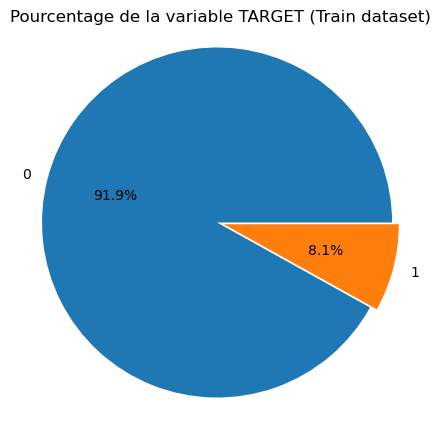

Nb modalités distinctes : 2


In [75]:
#représentation graphique en cercle
plt.figure(figsize=(5,5))

proportion_pattern = DataAppTrain['TARGET'].value_counts()
labels = proportion_pattern.index
explode = (0.02, 0) 

#ax.pie(proportion_pattern, labels=labels, explode=explode, 
#       autopct='%1.1f%%', shadow=True, startangle=90)
plt.pie(proportion_pattern, labels=labels, autopct='%.1f%%',
       textprops={'size': 'medium'}, radius=0.5,explode=explode)

plt.axis('equal')
plt.title('Pourcentage de la variable TARGET (Train dataset)', fontsize=12)
plt.show()
print('Nb modalités distinctes :',len(DataAppTrain.groupby('TARGET')))

In [77]:
DataTrain = DataAppTrain.copy()
DataTest = DataAppTest.copy()

<b>Visulation des taux de valeurs renseignées sur le dataframe DataAppTrain</b> :

<i>Sous format graphique</i> :

ValueError: The number of FixedLocator locations (0), usually from a call to set_ticks, does not match the number of labels (122).

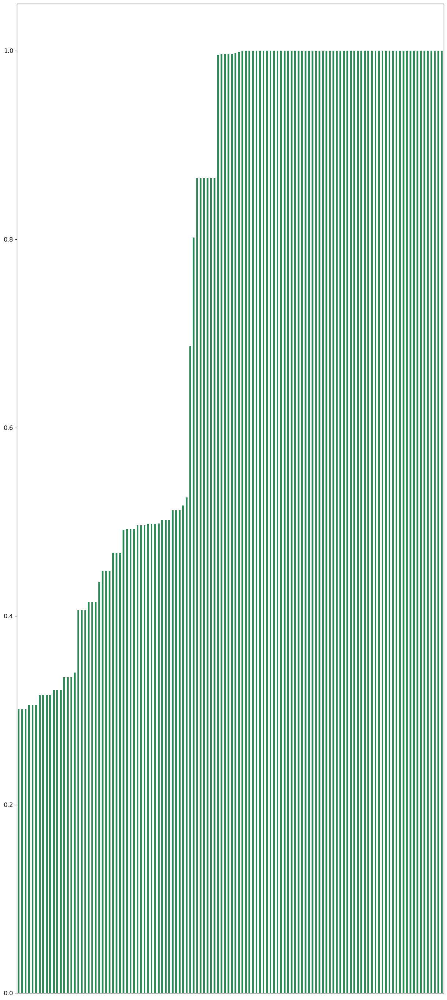

In [81]:
msno.bar(DataTrain,figsize=(15,35), fontsize=12, color="seagreen", log=False, sort="ascending")

<i>Sous format chiffres</i> :

In [92]:
shape = DataTrain.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataTrain.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_CURR                      100.000000
FLAG_DOCUMENT_15                100.000000
HOUR_APPR_PROCESS_START         100.000000
REG_REGION_NOT_LIVE_REGION      100.000000
LIVE_REGION_NOT_WORK_REGION     100.000000
REG_CITY_NOT_LIVE_CITY          100.000000
REG_CITY_NOT_WORK_CITY          100.000000
LIVE_CITY_NOT_WORK_CITY         100.000000
ORGANIZATION_TYPE               100.000000
FLAG_DOCUMENT_21                100.000000
FLAG_DOCUMENT_20                100.000000
FLAG_DOCUMENT_19                100.000000
FLAG_DOCUMENT_18                100.000000
FLAG_DOCUMENT_17                100.000000
FLAG_DOCUMENT_16                100.000000
FLAG_DOCUMENT_14                100.000000
REGION_RATING_CLIENT_W_CITY     100.000000
FLAG_DOCUMENT_13                100.000000
FLAG_DOCUMENT_12                100.000000
FLAG_DOCUMENT_11                100.000000
FLAG_DOCUMENT_10                100.000000
FLAG_DOCUMENT_9                 100.000000
FLAG_DOCUMENT_8                 100.000000
FLAG_DOCUME

Synthèse Tableau de remplissage des colonnes : 

|[ 0 - 50% ] | ] 50 - 99% ] | ] 99 - 100% ] | Total
| :----          | :---        | :---        | :---             
| 41 | 16 | 65| 122

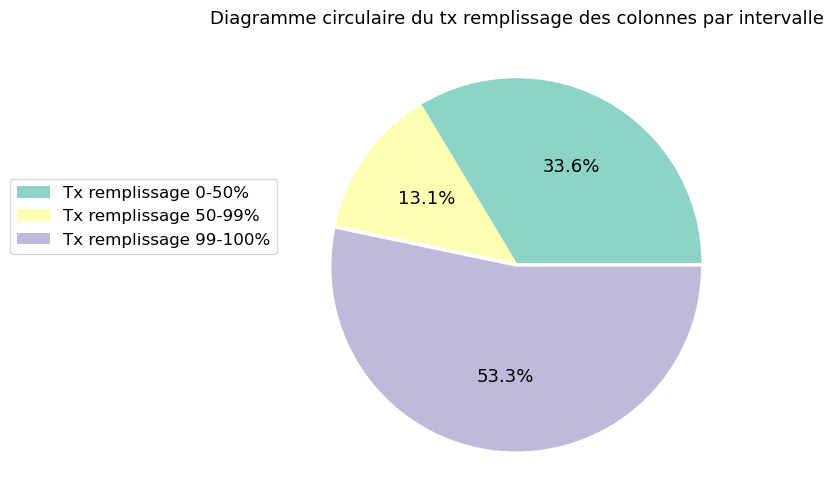

In [96]:
labels = 'Tx remplissage 0-50%','Tx remplissage 50-99%','Tx remplissage 99-100%'
datatmp = [41,16,65]

fig, ax = plt.subplots(figsize=(10, 6), subplot_kw=dict(aspect="equal"))
wedges, texts, autotexts = ax.pie(datatmp, autopct='%1.1f%%',
                                  textprops=dict(color="black"),colors=sns.color_palette('Set3'),explode=[0,0, 0.02])
#autopct=lambda pct: func(pct, datatmp)
#dict(color="black")
ax.legend(wedges, labels,
           fontsize="12",
          bbox_to_anchor=(1, -0.3, -1, 1))

plt.setp(autotexts, size=13)
ax.set_title("Diagramme circulaire du tx remplissage des colonnes par intervalle", size=13)
plt.show()


In [98]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (Train) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (Train) est de 75.6%


In [100]:
TAB_DATA = pd.DataFrame()
row_index = 0
TAB_DATA.loc[row_index, 'Dataset'] = 'application_train'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataAppTrain.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataAppTrain.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 106
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 16
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b>Visulation des taux de valeurs renseignées sur le dataframe DataAppTest</b> :

<i>Sous format graphique</i> :

<AxesSubplot:>

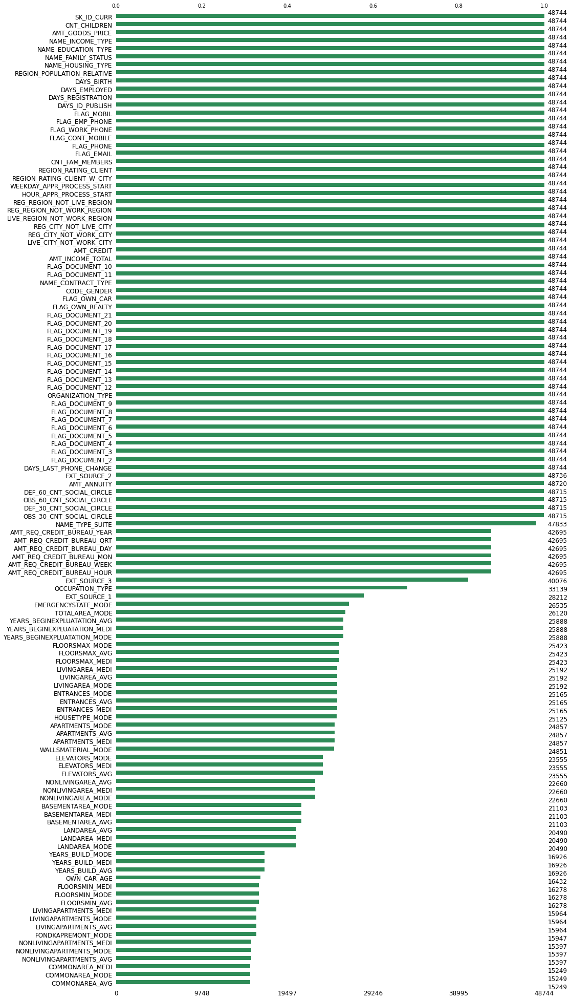

In [24]:
msno.bar(DataTest,figsize=(15,35), fontsize=12, color="seagreen", log=False, sort="ascending")

<i>Sous format chiffres</i> :

In [102]:
shape = DataTest.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataTest.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_CURR                      100.000000
FLAG_DOCUMENT_14                100.000000
REG_REGION_NOT_LIVE_REGION      100.000000
LIVE_REGION_NOT_WORK_REGION     100.000000
REG_CITY_NOT_LIVE_CITY          100.000000
REG_CITY_NOT_WORK_CITY          100.000000
LIVE_CITY_NOT_WORK_CITY         100.000000
ORGANIZATION_TYPE               100.000000
FLAG_DOCUMENT_21                100.000000
FLAG_DOCUMENT_20                100.000000
FLAG_DOCUMENT_19                100.000000
FLAG_DOCUMENT_18                100.000000
FLAG_DOCUMENT_17                100.000000
FLAG_DOCUMENT_16                100.000000
FLAG_DOCUMENT_15                100.000000
FLAG_DOCUMENT_13                100.000000
WEEKDAY_APPR_PROCESS_START      100.000000
FLAG_DOCUMENT_12                100.000000
FLAG_DOCUMENT_11                100.000000
FLAG_DOCUMENT_10                100.000000
FLAG_DOCUMENT_9                 100.000000
FLAG_DOCUMENT_8                 100.000000
FLAG_DOCUMENT_7                 100.000000
FLAG_DOCUME

In [104]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (Test) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (Test) est de 76.2%


In [106]:
TAB_DATA.loc[row_index, 'Dataset'] = 'application_test'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataAppTest.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataAppTest.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 105
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 16
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

In [108]:
DataBureau

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.00,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.00,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.50,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.00,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.00,NaN,NaN,0.0,Consumer credit,-21,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716423,259355,5057750,Active,currency 1,-44,0,-30.0,NaN,0.0,0,11250.00,11250.0,0.0,0.0,Microloan,-19,NaN
1716424,100044,5057754,Closed,currency 1,-2648,0,-2433.0,-2493.0,5476.5,0,38130.84,0.0,0.0,0.0,Consumer credit,-2493,NaN
1716425,100044,5057762,Closed,currency 1,-1809,0,-1628.0,-970.0,NaN,0,15570.00,NaN,NaN,0.0,Consumer credit,-967,NaN
1716426,246829,5057770,Closed,currency 1,-1878,0,-1513.0,-1513.0,NaN,0,36000.00,0.0,0.0,0.0,Consumer credit,-1508,NaN


<b><u>Bureau</u></b> :

In [29]:
DataBureau.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1716428 entries, 0 to 1716427
Data columns (total 17 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_CURR              int64  
 1   SK_ID_BUREAU            int64  
 2   CREDIT_ACTIVE           object 
 3   CREDIT_CURRENCY         object 
 4   DAYS_CREDIT             int64  
 5   CREDIT_DAY_OVERDUE      int64  
 6   DAYS_CREDIT_ENDDATE     float64
 7   DAYS_ENDDATE_FACT       float64
 8   AMT_CREDIT_MAX_OVERDUE  float64
 9   CNT_CREDIT_PROLONG      int64  
 10  AMT_CREDIT_SUM          float64
 11  AMT_CREDIT_SUM_DEBT     float64
 12  AMT_CREDIT_SUM_LIMIT    float64
 13  AMT_CREDIT_SUM_OVERDUE  float64
 14  CREDIT_TYPE             object 
 15  DAYS_CREDIT_UPDATE      int64  
 16  AMT_ANNUITY             float64
dtypes: float64(8), int64(6), object(3)
memory usage: 222.6+ MB


In [30]:
DataBureau.head(5)

,SK_ID_CURR,SK_ID_BUREAU,CREDIT_ACTIVE,CREDIT_CURRENCY,DAYS_CREDIT,CREDIT_DAY_OVERDUE,DAYS_CREDIT_ENDDATE,DAYS_ENDDATE_FACT,AMT_CREDIT_MAX_OVERDUE,CNT_CREDIT_PROLONG,AMT_CREDIT_SUM,AMT_CREDIT_SUM_DEBT,AMT_CREDIT_SUM_LIMIT,AMT_CREDIT_SUM_OVERDUE,CREDIT_TYPE,DAYS_CREDIT_UPDATE,AMT_ANNUITY
0,215354,5714462,Closed,currency 1,-497,0,-153.0,-153.0,NaN,0,91323.0,0.0,NaN,0.0,Consumer credit,-131,NaN
1,215354,5714463,Active,currency 1,-208,0,1075.0,NaN,NaN,0,225000.0,171342.0,NaN,0.0,Credit card,-20,NaN
2,215354,5714464,Active,currency 1,-203,0,528.0,NaN,NaN,0,464323.5,NaN,NaN,0.0,Consumer credit,-16,NaN
3,215354,5714465,Active,currency 1,-203,0,NaN,NaN,NaN,0,90000.0,NaN,NaN,0.0,Credit card,-16,NaN
4,215354,5714466,Active,currency 1,-629,0,1197.0,NaN,77674.5,0,2700000.0,NaN,NaN,0.0,Consumer credit,-21,NaN


Tous les crédits du client fournis par d'autres institutions financières qui ont été rapportés a 'Home credit'.<br> 
Il y a autant de lignes que le nombre de crédits du meme client présent dans "application" avec l'unique id "SK_ID_CURR"

In [31]:
shape = DataBureau.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataBureau.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_CURR                100.000000
DAYS_CREDIT_UPDATE        100.000000
CREDIT_ACTIVE             100.000000
CREDIT_CURRENCY           100.000000
DAYS_CREDIT               100.000000
CREDIT_DAY_OVERDUE        100.000000
SK_ID_BUREAU              100.000000
CNT_CREDIT_PROLONG        100.000000
AMT_CREDIT_SUM_OVERDUE    100.000000
CREDIT_TYPE               100.000000
AMT_CREDIT_SUM             99.999243
DAYS_CREDIT_ENDDATE        93.850427
AMT_CREDIT_SUM_DEBT        84.988068
AMT_CREDIT_SUM_LIMIT       65.522585
DAYS_ENDDATE_FACT          63.083042
AMT_CREDIT_MAX_OVERDUE     34.486736
AMT_ANNUITY                28.526510
dtype: float64


In [32]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataBureau) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataBureau) est de 86.5%


In [33]:
TAB_DATA.loc[row_index, 'Dataset'] = 'bureau'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataBureau.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataBureau.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 14
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 3
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Bureau Balance</u></b> :

In [34]:
DataBureauBalance.info()    

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27299925 entries, 0 to 27299924
Data columns (total 3 columns):
 #   Column          Dtype 
---  ------          ----- 
 0   SK_ID_BUREAU    int64 
 1   MONTHS_BALANCE  int64 
 2   STATUS          object
dtypes: int64(2), object(1)
memory usage: 624.8+ MB


In [35]:
shape = DataBureauBalance.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataBureauBalance.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_BUREAU      100.0
MONTHS_BALANCE    100.0
STATUS            100.0
dtype: float64


In [36]:
DataBureauBalance.head(5)

,SK_ID_BUREAU,MONTHS_BALANCE,STATUS
0,5715448,0,C
1,5715448,-1,C
2,5715448,-2,C
3,5715448,-3,C
4,5715448,-4,C


In [37]:
DataBureauBalance['STATUS'].unique()

array(['C', '0', 'X', '1', '2', '3', '5', '4'], dtype=object)

In [38]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataBureauBalance) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataBureauBalance) est de 100.0%


Soldes mensuels des crédits précédents du table bureau. Ce tableau a une ligne pour chaque mois d'historique de chaque crédit précédent rapporté a 'Home Credit'

In [39]:
TAB_DATA.loc[row_index, 'Dataset'] = 'bureau_balance'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataBureauBalance.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataBureauBalance.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 2
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 1
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Credit Card Balance</u></b> :

In [40]:
DataCreditCardBalance.info()   

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3840312 entries, 0 to 3840311
Data columns (total 23 columns):
 #   Column                      Dtype  
---  ------                      -----  
 0   SK_ID_PREV                  int64  
 1   SK_ID_CURR                  int64  
 2   MONTHS_BALANCE              int64  
 3   AMT_BALANCE                 float64
 4   AMT_CREDIT_LIMIT_ACTUAL     int64  
 5   AMT_DRAWINGS_ATM_CURRENT    float64
 6   AMT_DRAWINGS_CURRENT        float64
 7   AMT_DRAWINGS_OTHER_CURRENT  float64
 8   AMT_DRAWINGS_POS_CURRENT    float64
 9   AMT_INST_MIN_REGULARITY     float64
 10  AMT_PAYMENT_CURRENT         float64
 11  AMT_PAYMENT_TOTAL_CURRENT   float64
 12  AMT_RECEIVABLE_PRINCIPAL    float64
 13  AMT_RECIVABLE               float64
 14  AMT_TOTAL_RECEIVABLE        float64
 15  CNT_DRAWINGS_ATM_CURRENT    float64
 16  CNT_DRAWINGS_CURRENT        int64  
 17  CNT_DRAWINGS_OTHER_CURRENT  float64
 18  CNT_DRAWINGS_POS_CURRENT    float64
 19  CNT_INSTALMENT_MATURE

In [41]:
shape = DataCreditCardBalance.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataCreditCardBalance.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_PREV                    100.000000
SK_ID_CURR                    100.000000
SK_DPD                        100.000000
NAME_CONTRACT_STATUS          100.000000
CNT_DRAWINGS_CURRENT          100.000000
AMT_TOTAL_RECEIVABLE          100.000000
AMT_RECIVABLE                 100.000000
AMT_RECEIVABLE_PRINCIPAL      100.000000
AMT_PAYMENT_TOTAL_CURRENT     100.000000
AMT_DRAWINGS_CURRENT          100.000000
AMT_CREDIT_LIMIT_ACTUAL       100.000000
AMT_BALANCE                   100.000000
MONTHS_BALANCE                100.000000
SK_DPD_DEF                    100.000000
AMT_INST_MIN_REGULARITY        92.051792
CNT_INSTALMENT_MATURE_CUM      92.051792
AMT_DRAWINGS_POS_CURRENT       80.475128
AMT_DRAWINGS_OTHER_CURRENT     80.475128
AMT_DRAWINGS_ATM_CURRENT       80.475128
CNT_DRAWINGS_ATM_CURRENT       80.475128
CNT_DRAWINGS_OTHER_CURRENT     80.475128
CNT_DRAWINGS_POS_CURRENT       80.475128
AMT_PAYMENT_CURRENT            80.001937
dtype: float64


In [42]:
DataCreditCardBalance.head(5)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,AMT_BALANCE,AMT_CREDIT_LIMIT_ACTUAL,AMT_DRAWINGS_ATM_CURRENT,AMT_DRAWINGS_CURRENT,AMT_DRAWINGS_OTHER_CURRENT,AMT_DRAWINGS_POS_CURRENT,AMT_INST_MIN_REGULARITY,AMT_PAYMENT_CURRENT,AMT_PAYMENT_TOTAL_CURRENT,AMT_RECEIVABLE_PRINCIPAL,AMT_RECIVABLE,AMT_TOTAL_RECEIVABLE,CNT_DRAWINGS_ATM_CURRENT,CNT_DRAWINGS_CURRENT,CNT_DRAWINGS_OTHER_CURRENT,CNT_DRAWINGS_POS_CURRENT,CNT_INSTALMENT_MATURE_CUM,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,2562384,378907,-6,56.970,135000,0.0,877.5,0.0,877.5,1700.325,1800.0,1800.0,0.000,0.000,0.000,0.0,1,0.0,1.0,35.0,Active,0,0
1,2582071,363914,-1,63975.555,45000,2250.0,2250.0,0.0,0.0,2250.000,2250.0,2250.0,60175.080,64875.555,64875.555,1.0,1,0.0,0.0,69.0,Active,0,0
2,1740877,371185,-7,31815.225,450000,0.0,0.0,0.0,0.0,2250.000,2250.0,2250.0,26926.425,31460.085,31460.085,0.0,0,0.0,0.0,30.0,Active,0,0
3,1389973,337855,-4,236572.110,225000,2250.0,2250.0,0.0,0.0,11795.760,11925.0,11925.0,224949.285,233048.970,233048.970,1.0,1,0.0,0.0,10.0,Active,0,0
4,1891521,126868,-1,453919.455,450000,0.0,11547.0,0.0,11547.0,22924.890,27000.0,27000.0,443044.395,453919.455,453919.455,0.0,1,0.0,1.0,101.0,Active,0,0


Soldes mensuels des cartes de crédits précédents 'SK_ID_PREV' que le demandeur actuel 'SK_ID_CURR' possède chez Home Credit. Ce tableau comporte une ligne pour chaque mois de l'historique de chaque carte de crédit et son solde.

In [43]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataCreditCardBalance) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataCreditCardBalance) est de 93.3%


In [44]:
TAB_DATA.loc[row_index, 'Dataset'] = 'credit_card_balance'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataCreditCardBalance.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataCreditCardBalance.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 22
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 1
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Columns Description</u></b> :

In [45]:
DataColumnsDescription.info()   

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219 entries, 0 to 218
Data columns (total 5 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   Unnamed: 0   219 non-null    int64 
 1   Table        219 non-null    object
 2   Row          219 non-null    object
 3   Description  219 non-null    object
 4   Special      86 non-null     object
dtypes: int64(1), object(4)
memory usage: 8.7+ KB


In [46]:
shape = DataColumnsDescription.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataColumnsDescription.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

Unnamed: 0     100.000000
Table          100.000000
Row            100.000000
Description    100.000000
Special         39.269406
dtype: float64


In [47]:
DataColumnsDescription.head(5)

,Unnamed: 0,Table,Row,Description,Special
0,1,application_{train|test}.csv,SK_ID_CURR,ID of loan in our sample,NaN
1,2,application_{train|test}.csv,TARGET,"Target variable (1 - client with payment difficulties: he/she had late payment more than X days on at least one of the first Y installments of the loan in our sample, 0 - all other cases)",NaN
2,5,application_{train|test}.csv,NAME_CONTRACT_TYPE,Identification if loan is cash or revolving,NaN
3,6,application_{train|test}.csv,CODE_GENDER,Gender of the client,NaN
4,7,application_{train|test}.csv,FLAG_OWN_CAR,Flag if the client owns a car,NaN


Définition des colonnes dans chaque table

In [48]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataColumnsDescription) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataColumnsDescription) est de 87.9%


In [49]:
TAB_DATA.loc[row_index, 'Dataset'] = 'HomeCredit_columns_description'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataColumnsDescription.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataColumnsDescription.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 1
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 4
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Installments Payments</u></b> :

In [50]:
DataInstallmentsPayments.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13605401 entries, 0 to 13605400
Data columns (total 8 columns):
 #   Column                  Dtype  
---  ------                  -----  
 0   SK_ID_PREV              int64  
 1   SK_ID_CURR              int64  
 2   NUM_INSTALMENT_VERSION  float64
 3   NUM_INSTALMENT_NUMBER   int64  
 4   DAYS_INSTALMENT         float64
 5   DAYS_ENTRY_PAYMENT      float64
 6   AMT_INSTALMENT          float64
 7   AMT_PAYMENT             float64
dtypes: float64(5), int64(3)
memory usage: 830.4 MB


In [51]:
shape = DataInstallmentsPayments.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataInstallmentsPayments.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_PREV                100.000000
SK_ID_CURR                100.000000
NUM_INSTALMENT_VERSION    100.000000
NUM_INSTALMENT_NUMBER     100.000000
DAYS_INSTALMENT           100.000000
AMT_INSTALMENT            100.000000
DAYS_ENTRY_PAYMENT         99.978648
AMT_PAYMENT                99.978648
dtype: float64


In [52]:
DataInstallmentsPayments.head(5)

,SK_ID_PREV,SK_ID_CURR,NUM_INSTALMENT_VERSION,NUM_INSTALMENT_NUMBER,DAYS_INSTALMENT,DAYS_ENTRY_PAYMENT,AMT_INSTALMENT,AMT_PAYMENT
0,1054186,161674,1.0,6,-1180.0,-1187.0,6948.360,6948.360
1,1330831,151639,0.0,34,-2156.0,-2156.0,1716.525,1716.525
2,2085231,193053,2.0,1,-63.0,-63.0,25425.000,25425.000
3,2452527,199697,1.0,3,-2418.0,-2426.0,24350.130,24350.130
4,2714724,167756,1.0,2,-1383.0,-1366.0,2165.040,2160.585


Historique des remboursements pour les crédits précédent 'SK_ID_PREV' dans Home Credit liés aux demandes actuelles 'SK_ID_CURR'. Il y a une ligne pour chaque paiement effectué Et une ligne pour chaque paiement manqué.

In [53]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataInstallmentsPayments) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataInstallmentsPayments) est de 100.0%


In [54]:
TAB_DATA.loc[row_index, 'Dataset'] = 'installments_payments'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataInstallmentsPayments.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataInstallmentsPayments.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 8
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 0
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Pos Cash Balance</u></b> :

In [55]:
DataPosCashBalance.info()   

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10001358 entries, 0 to 10001357
Data columns (total 8 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   SK_ID_PREV             int64  
 1   SK_ID_CURR             int64  
 2   MONTHS_BALANCE         int64  
 3   CNT_INSTALMENT         float64
 4   CNT_INSTALMENT_FUTURE  float64
 5   NAME_CONTRACT_STATUS   object 
 6   SK_DPD                 int64  
 7   SK_DPD_DEF             int64  
dtypes: float64(2), int64(5), object(1)
memory usage: 610.4+ MB


In [56]:
shape = DataPosCashBalance.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataPosCashBalance.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_PREV               100.000000
SK_ID_CURR               100.000000
MONTHS_BALANCE           100.000000
NAME_CONTRACT_STATUS     100.000000
SK_DPD                   100.000000
SK_DPD_DEF               100.000000
CNT_INSTALMENT            99.739325
CNT_INSTALMENT_FUTURE     99.739165
dtype: float64


In [57]:
DataPosCashBalance.head(5)

,SK_ID_PREV,SK_ID_CURR,MONTHS_BALANCE,CNT_INSTALMENT,CNT_INSTALMENT_FUTURE,NAME_CONTRACT_STATUS,SK_DPD,SK_DPD_DEF
0,1803195,182943,-31,48.0,45.0,Active,0,0
1,1715348,367990,-33,36.0,35.0,Active,0,0
2,1784872,397406,-32,12.0,9.0,Active,0,0
3,1903291,269225,-35,48.0,42.0,Active,0,0
4,2341044,334279,-35,36.0,35.0,Active,0,0


Soldes mensuels des prêts (POS : point of sales) ou des prêts cash précédents que le demandeur a eu avec Home Credit. Ce tableau comporte une ligne pour chaque mois de l'historique de chaque crédit précédent à 'Home Credit' lié à la demande actuelle 'SK_ID_CURR'.

In [58]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataPosCashBalance) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataPosCashBalance) est de 99.9%


In [59]:
TAB_DATA.loc[row_index, 'Dataset'] = 'POS_CASH_balance'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataPosCashBalance.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataPosCashBalance.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 7
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 1
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Previous Application</u></b> :

In [60]:
DataPreviousApplication.info()  

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [61]:
shape = DataPreviousApplication.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataPreviousApplication.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_PREV                     100.000000
NAME_CASH_LOAN_PURPOSE         100.000000
NAME_YIELD_GROUP               100.000000
NAME_SELLER_INDUSTRY           100.000000
SELLERPLACE_AREA               100.000000
CHANNEL_TYPE                   100.000000
NAME_PRODUCT_TYPE              100.000000
NAME_PORTFOLIO                 100.000000
NAME_GOODS_CATEGORY            100.000000
NAME_CLIENT_TYPE               100.000000
CODE_REJECT_REASON             100.000000
SK_ID_CURR                     100.000000
DAYS_DECISION                  100.000000
NAME_CONTRACT_STATUS           100.000000
NAME_PAYMENT_TYPE              100.000000
AMT_APPLICATION                100.000000
NFLAG_LAST_APPL_IN_DAY         100.000000
FLAG_LAST_APPL_PER_CONTRACT    100.000000
HOUR_APPR_PROCESS_START        100.000000
WEEKDAY_APPR_PROCESS_START     100.000000
NAME_CONTRACT_TYPE             100.000000
AMT_CREDIT                      99.999940
PRODUCT_COMBINATION             99.979284
CNT_PAYMENT                     77

In [62]:
DataPreviousApplication.head(5)

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,RATE_DOWN_PAYMENT,RATE_INTEREST_PRIMARY,RATE_INTEREST_PRIVILEGED,NAME_CASH_LOAN_PURPOSE,NAME_CONTRACT_STATUS,DAYS_DECISION,NAME_PAYMENT_TYPE,CODE_REJECT_REASON,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,NAME_GOODS_CATEGORY,NAME_PORTFOLIO,NAME_PRODUCT_TYPE,CHANNEL_TYPE,SELLERPLACE_AREA,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,Y,1,0.0,0.182832,0.867336,XAP,Approved,-73,Cash through the bank,XAP,NaN,Repeater,Mobile,POS,XNA,Country-wide,35,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-164,XNA,XAP,Unaccompanied,Repeater,XNA,Cash,x-sell,Contact center,-1,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,Y,1,NaN,NaN,NaN,XNA,Approved,-301,Cash through the bank,XAP,"Spouse, partner",Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,Y,1,NaN,NaN,NaN,XNA,Approved,-512,Cash through the bank,XAP,NaN,Repeater,XNA,Cash,x-sell,Credit and cash offices,-1,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,Y,1,NaN,NaN,NaN,Repairs,Refused,-781,Cash through the bank,HC,NaN,Repeater,XNA,Cash,walk-in,Credit and cash offices,-1,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


Cette table contient toutes les demandes précédentes de prêts chez 'Home Credit' et qui ont une demande actuelle 'SK_ID_CURR'. Il y a une ligne pour chaque demande antérieure identifiée par 'SK_ID_PREV'.

In [63]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataPreviousApplication) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataPreviousApplication) est de 82.0%


In [64]:
TAB_DATA.loc[row_index, 'Dataset'] = 'previous_application'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataPreviousApplication.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataPreviousApplication.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 21
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 16
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

<b><u>Sample Submission</u></b> :

In [65]:
DataSampleSubmission.info()    

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   SK_ID_CURR  48744 non-null  int64  
 1   TARGET      48744 non-null  float64
dtypes: float64(1), int64(1)
memory usage: 761.8 KB


In [66]:
shape = DataSampleSubmission.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataSampleSubmission.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
with pd.option_context('display.max_rows', None,):
    print(taux_completion.sort_values(ascending=False))

SK_ID_CURR    100.0
TARGET        100.0
dtype: float64


In [67]:
moy = round(
    taux_completion.mean(), 1
)  # calcul la moyenne du taux de completion au global au dizième près
print(f"La moyenne du tx remplissage dans le jeu de données (DataSampleSubmission) est de {moy}%")

La moyenne du tx remplissage dans le jeu de données (DataSampleSubmission) est de 100.0%


In [68]:
#nb valeurs distincts TARGET
print('Nb valeurs distincts pour TARGET :',len(DataSampleSubmission.groupby('TARGET')))
resultat = DataSampleSubmission.groupby(['TARGET'], dropna=False).size().reset_index()
resultat.columns = ['TARGET','nb']
resultat['Percentage'] = 100 * resultat['nb']  / resultat['nb'].sum()
resultat.sort_values('Percentage',ascending=False,inplace=True)
resultat.head(10)

Nb valeurs distincts pour TARGET : 1


,TARGET,nb,Percentage
0,0.5,48744,100.0


In [69]:
TAB_DATA.loc[row_index, 'Dataset'] = 'sample_submission'
TAB_DATA.loc[row_index, 'Nb lignes'] = DataSampleSubmission.shape[0]
TAB_DATA.loc[row_index, 'Nb colonnes'] = DataSampleSubmission.shape[1]
TAB_DATA.loc[row_index, 'Nb quantitatifs'] = 2
TAB_DATA.loc[row_index, 'Nb qualitatifs'] = 0
TAB_DATA.loc[row_index, 'Moy tx remplissage'] = moy
row_index = row_index + 1

In [70]:
TAB_DATA

,Dataset,Nb lignes,Nb colonnes,Nb quantitatifs,Nb qualitatifs,Moy tx remplissage
0,application_train,307511.0,122.0,106.0,16.0,75.6
1,application_test,48744.0,121.0,105.0,16.0,76.2
2,bureau,1716428.0,17.0,14.0,3.0,86.5
3,bureau_balance,27299925.0,3.0,2.0,1.0,100.0
4,credit_card_balance,3840312.0,23.0,22.0,1.0,93.3
5,HomeCredit_columns_description,219.0,5.0,1.0,4.0,87.9
6,installments_payments,13605401.0,8.0,8.0,0.0,100.0
7,POS_CASH_balance,10001358.0,8.0,7.0,1.0,99.9
8,previous_application,1670214.0,37.0,21.0,16.0,82.0
9,sample_submission,48744.0,2.0,2.0,0.0,100.0


<u>NB</u> :
- <b>Application_Test</b> n'ayant pas la variable TARGET, ce dataset ne sera pas exploité car impossible de comparer la prédiction du score avec la réalité.
- Seul <b>Application_Train</b> sera exploité ici car contient la variable TARGET

3 jeux de données seront à créer dans Application_Train pour l'apprentissage du modèle de machine learning :
- 80% train dont 80% pour l'entrainement et 20% pour la validation
- 20% test


Dans la suite, nous nous interessons au dataset <b>Application_Train</b>

<b><u>Valeurs manquantes et doublons</u></b> :

<b>Liste de nos features qualitatives :</b>

In [110]:
#variables avec uniquement les colonnes de type object et bool  = colonnes qualitatives
i = 0
ColonnesQuali = list(DataTrain.select_dtypes(include=['object', 'bool']).columns)
print("Les variables qualitatives sont les suivantes : \n")
for categ in ColonnesQuali :
    print(categ, ":", DataTrain[categ].nunique())
    i = i + 1
print("\nNb variables qualitatives = ",i)

Les variables qualitatives sont les suivantes : 

NAME_CONTRACT_TYPE : 2
CODE_GENDER : 3
FLAG_OWN_CAR : 2
FLAG_OWN_REALTY : 2
NAME_TYPE_SUITE : 7
NAME_INCOME_TYPE : 8
NAME_EDUCATION_TYPE : 5
NAME_FAMILY_STATUS : 6
NAME_HOUSING_TYPE : 6
OCCUPATION_TYPE : 18
WEEKDAY_APPR_PROCESS_START : 7
ORGANIZATION_TYPE : 58
FONDKAPREMONT_MODE : 4
HOUSETYPE_MODE : 3
WALLSMATERIAL_MODE : 7
EMERGENCYSTATE_MODE : 2

Nb variables qualitatives =  16


<b>Liste de nos features quantitatives :</b>

In [113]:
#variables avec uniquement les colonnes de type float64 et int64  = colonnes quantitatives
i = 0
ColonnesQuanti = list(DataTrain.select_dtypes(include=['float64', 'int64']).columns)
print("Les variables quantitatives sont les suivantes : \n")
for num in ColonnesQuanti :
    print(num)
    i = i + 1
print("\nNb variables quantitatives = ",i)

Les variables quantitatives sont les suivantes : 

SK_ID_CURR
TARGET
CNT_CHILDREN
AMT_INCOME_TOTAL
AMT_CREDIT
AMT_ANNUITY
AMT_GOODS_PRICE
REGION_POPULATION_RELATIVE
DAYS_BIRTH
DAYS_EMPLOYED
DAYS_REGISTRATION
DAYS_ID_PUBLISH
OWN_CAR_AGE
FLAG_MOBIL
FLAG_EMP_PHONE
FLAG_WORK_PHONE
FLAG_CONT_MOBILE
FLAG_PHONE
FLAG_EMAIL
CNT_FAM_MEMBERS
REGION_RATING_CLIENT
REGION_RATING_CLIENT_W_CITY
HOUR_APPR_PROCESS_START
REG_REGION_NOT_LIVE_REGION
REG_REGION_NOT_WORK_REGION
LIVE_REGION_NOT_WORK_REGION
REG_CITY_NOT_LIVE_CITY
REG_CITY_NOT_WORK_CITY
LIVE_CITY_NOT_WORK_CITY
EXT_SOURCE_1
EXT_SOURCE_2
EXT_SOURCE_3
APARTMENTS_AVG
BASEMENTAREA_AVG
YEARS_BEGINEXPLUATATION_AVG
YEARS_BUILD_AVG
COMMONAREA_AVG
ELEVATORS_AVG
ENTRANCES_AVG
FLOORSMAX_AVG
FLOORSMIN_AVG
LANDAREA_AVG
LIVINGAPARTMENTS_AVG
LIVINGAREA_AVG
NONLIVINGAPARTMENTS_AVG
NONLIVINGAREA_AVG
APARTMENTS_MODE
BASEMENTAREA_MODE
YEARS_BEGINEXPLUATATION_MODE
YEARS_BUILD_MODE
COMMONAREA_MODE
ELEVATORS_MODE
ENTRANCES_MODE
FLOORSMAX_MODE
FLOORSMIN_MODE
LANDAREA_

<u>Variables avec valeurs manquantes</u> :

In [115]:
shape = DataTrain.shape

# Nombre d'éléments renseignés par colonne
nbre_renseigne = DataTrain.count()

# Nombre d'éléments non renseigné par colonne
nbre_non_renseigne = shape[0] - nbre_renseigne

# Taux de complétion de chaque colonne
taux_completion = round(nbre_renseigne * 100 / shape[0],10)
#with pd.option_context('display.max_rows', None,):
#    print(taux_completion.sort_values(ascending=False))
df1 = pd.DataFrame(taux_completion , columns=['tx completion'])
df1[df1['tx completion'] < 100]

,tx completion
AMT_ANNUITY,99.996098
AMT_GOODS_PRICE,99.909597
NAME_TYPE_SUITE,99.579852
OWN_CAR_AGE,34.009190
OCCUPATION_TYPE,68.654455
...,...
AMT_REQ_CREDIT_BUREAU_DAY,86.498369
AMT_REQ_CREDIT_BUREAU_WEEK,86.498369
AMT_REQ_CREDIT_BUREAU_MON,86.498369
AMT_REQ_CREDIT_BUREAU_QRT,86.498369


<div class="alert alert-block alert-info"><b>67 variables sur 122 ont des valeurs manquantes</b></div>

<b>Supression des doublons</b> :

In [119]:
print('Nb lignes en doublon (toutes features confondus) :', DataTrain.duplicated().sum())
print('Nb lignes en doublon sur la colonne SK_ID_CURR :', DataTrain.duplicated(['SK_ID_CURR']).sum())

Nb lignes en doublon (toutes features confondus) : 0
Nb lignes en doublon sur la colonne SK_ID_CURR : 0


<div class="alert alert-block alert-info"><b>Il n'y a aucun doublons</b></div>

###  <font color="blue" size=5>Chapitre 3 - Etude des variables </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre3"></a><a name="chapitre4"></a>

#### <font color="green" size=4>3.1 Analyse univariée</font> <a href="#chapitre3" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_3_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

<b>Variables quantitatives</b> :

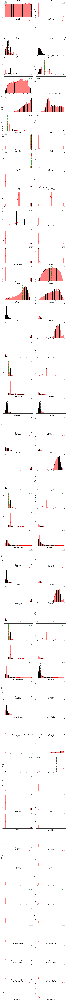

In [75]:
fig = plt.figure(figsize=(20,300))

for i, c in enumerate(ColonnesQuanti,1):
    ax = fig.add_subplot(53,2,i)
    #ax.hist(Data[c],  bins=30, color='grey')
    sns.histplot(DataTrain[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.vlines(DataTrain[c].mean(), *ax.get_ylim(), color='black', ls='-.', lw=1.5)
    ax.vlines(DataTrain[c].median(), *ax.get_ylim(), color='green', ls='-.', lw=1.5)
     #ax.vlines(df[c].mode(), *ax.get_ylim(), color='blue', ls='-.', lw=1.5)
    ax.legend(['density', 'mean','median'])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

<u>Les variables quantitatives avec valeurs négatives </u> :
- <b>DAYS_BIRTH</b> (Client's age in days at the time of application) : <font color=blue>âge du client en nbre de jours au moment de la demande</font>
- <b>DAYS_EMPLOYED</b> (How many days before the application the person started current employment) : <font color=blue>nbre de jours avant la demande où le client a commencé à occuper son emploi actuel</font>
- <b>DAYS_REGISTRATION</b> (How many days before the application did client change his registration) : <font color=blue>nbre de jours avant la demande  où le client a modifié son inscription</font>
- <b>DAYS_ID_PUBLISH</b> (How many days before the application did client change the identity document with which he applied for the loan) : <font color=blue>nbre de jours avant la demande où le client a changé la pièce d’identité avec laquelle il a demandé le prêt</font>
- <b>DAYS_LAST_PHONE_CHANGE</b> (How many days before application did client change phone) : <font color=blue>nbre de jours avant la demande où le client a changé son téléphone</font>

<b>Variables qualitatives</b> :

In [76]:
#affichage des modalités des variables qualitatives (y compris avec valeurs nulles)
for column in ColonnesQuali:
    df = DataTrain.groupby(column, dropna = False)['SK_ID_CURR'].count().reset_index()
    df = df.rename(columns={'SK_ID_CURR': 'count'})
    df['Percentage'] = round(100 * df['count']  / df['count'].sum(),3)
    df.sort_values('Percentage',ascending=False,inplace=True)
    print("\n",df)



   NAME_CONTRACT_TYPE   count  Percentage
0         Cash loans  278232      90.479
1    Revolving loans   29279       9.521

   CODE_GENDER   count  Percentage
0           F  202448      65.834
1           M  105059      34.164
2         XNA       4       0.001

   FLAG_OWN_CAR   count  Percentage
0            N  202924      65.989
1            Y  104587      34.011

   FLAG_OWN_REALTY   count  Percentage
1               Y  213312      69.367
0               N   94199      30.633

    NAME_TYPE_SUITE   count  Percentage
6    Unaccompanied  248526      80.819
1           Family   40149      13.056
5  Spouse, partner   11370       3.697
0         Children    3267       1.062
4          Other_B    1770       0.576
7              NaN    1292       0.420
3          Other_A     866       0.282
2  Group of people     271       0.088

        NAME_INCOME_TYPE   count  Percentage
7               Working  158774      51.632
1  Commercial associate   71617      23.289
3             Pensioner   5

<u>Variables qualitatives présentant des valeurs nulles</u> :

- EMERGENCYSTATE_MODE (51,845%)<br>
- WALLSMATERIAL_MODE  (50.841%)<br>
- HOUSETYPE_MODE (50.176%)<br>
- FONDKAPREMONT_MODE (68.386%)  <br>
- OCCUPATION_TYPE (31.346%)<br>
- NAME_TYPE_SUITE (0.420%)<br>

<u>Variables qualitatives présentant des modalités non définies</u>:
- CODE_GENDER : XNA (0.001%)<br>


#### <font color="green" size=4>3.2 Analyse bivariée</font> <a href="#chapitre4" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_3_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

<b>Analyse de la TARGET en fonction des variables qualitatives</b> :

- NAME_CONTRACT_TYPE

In [77]:
pd.crosstab(DataTrain.TARGET, DataTrain.NAME_CONTRACT_TYPE, dropna=False, normalize='all')

NAME_CONTRACT_TYPE,Cash loans,Revolving loans
TARGET,,
0,0.829274,0.089997
1,0.075513,0.005216


- <b>90,5%</b> des demandes de crédits sont réservés à des prêts personnels (Cash loans) dont :<br>
 > 83% présentent aucune défaillances de remboursements<br>
 7,5% présentent des défaillances
<br><br>

- <b>9,5%</b> des demandes de crédits sont réservés à des crédits révolvings (Revolving loans) dont :<br>
 > 9% présentent aucune défaillances de remboursements<br>
 0,5% présentent des défaillances

- CODE_GENDER

In [78]:
pd.crosstab(DataTrain.TARGET, DataTrain.CODE_GENDER, dropna=False,normalize='all')

CODE_GENDER,F,M,XNA
TARGET,,,
0,0.612264,0.306994,0.000013
1,0.046080,0.034649,0.000000


- <b>65,8%</b> des demandes de crédits sont réservés à des femmes dont :
 > 61,2% présentent aucune défaillances de remboursements<br>
4,6% présentent des défaillances
<br><br>

- <b>34,2%</b> des demandes de crédits sont réservés à des hommes dont :
 > 30,7% présentent aucune défaillances de remboursements<br>
 3,5% présentent des défaillances
<br><br>

- <b>0,001%</b> des demandes de crédits sont réservés à un genre non défini dont :
 > 0,001% présentent aucune défaillances de remboursements<br>
 0,0% présentent des défaillances

- FLAG_OWN_CAR

In [79]:
pd.crosstab(DataTrain.TARGET, DataTrain.FLAG_OWN_CAR, dropna=False,normalize='all')

FLAG_OWN_CAR,N,Y
TARGET,,
0,0.603800,0.315472
1,0.056092,0.024637


- <b>66,0%</b> des demandes de crédits sont réservés à clients sans voiture dont :<br>
 > 60,4% présentent aucune défaillances de remboursements<br>
5,6% présentent des défaillances
<br><br>

- <b>34,0%</b> des demandes de crédits sont réservés à des clients possédant une voiture dont :<br>
 > 31,5% présentent aucune défaillances de remboursements<br>
2,5% présentent des défaillances

- FLAG_OWN_REALTY

In [80]:
pd.crosstab(DataTrain.TARGET, DataTrain.FLAG_OWN_REALTY, dropna=False,normalize='all')

FLAG_OWN_REALTY,N,Y
TARGET,,
0,0.280826,0.638445
1,0.025502,0.055227


- <b>30,6%</b> des demandes de crédits sont réservés à des clients non propriétaires dont :<br>
 > 28,1% présentent aucune défaillances de remboursements<br>
2,5% présentent des défaillances
<br><br>

- <b>69,4%</b> des demandes de crédits sont réservés à des clients propriétaires dont :<br>
 > 63,8% présentent aucune défaillances de remboursements<br>
5,6% présentent des défaillances

- NAME_INCOME_TYPE

In [81]:
pd.crosstab(DataTrain.TARGET, DataTrain.NAME_INCOME_TYPE, dropna=False,normalize='all')

NAME_INCOME_TYPE,Businessman,Commercial associate,Maternity leave,Pensioner,State servant,Student,Unemployed,Working
TARGET,,,,,,,,
0,0.000033,0.215462,0.000010,0.170335,0.066515,0.000059,0.000046,0.466813
1,0.000000,0.017430,0.000007,0.009697,0.004062,0.000000,0.000026,0.049507


Les 3 principales catégories de type de revenu sont :
1. Les Actifs (Working) = 51,6% dont 46,7% présentent aucune défaillances de remboursements<br>
2. Les Associés Commerciaux (Commercial associate) = 23,3% dont 21,5%  présentent aucune défaillances de remboursements<br>
3. Les Retraités (Pensioner) = 18% dont 17% présentent aucune défaillances de remboursements<br>

- NAME_EDUCATION_TYPE   

In [82]:
pd.crosstab(DataTrain.TARGET, DataTrain.NAME_EDUCATION_TYPE, dropna=False,normalize='all')

NAME_EDUCATION_TYPE,Academic degree,Higher education,Incomplete higher,Lower secondary,Secondary / secondary special
TARGET,,,,,
0,0.000524,0.230411,0.030584,0.011053,0.646699
1,0.000010,0.013037,0.002836,0.001356,0.063490


- <b>71,0%</b> des demandes de crédits sont réservés à des clients ayant effectués des études secondaires dont :<br>
 > 64,7% présentent aucune défaillances de remboursements<br>
6,3% présentent des défaillances
<br><br>

- <b>24,3%</b> des demandes de crédits sont réservés à des clients ayant effectués des études dans l'enseignement supérieur dont :<br>
 > 23,0% présentent aucune défaillances de remboursements<br>
1,3% présentent des défaillances

- NAME_FAMILY_STATUS

In [83]:
pd.crosstab(DataTrain.TARGET, DataTrain.NAME_FAMILY_STATUS, dropna=False,normalize='all')

NAME_FAMILY_STATUS,Civil marriage,Married,Separated,Single / not married,Unknown,Widow
TARGET,,,,,,
0,0.087197,0.590489,0.059022,0.133286,0.000007,0.049270
1,0.009629,0.048291,0.005268,0.014494,0.000000,0.003047


- <b>63,9%</b> des demandes de crédits sont réservés à des clients mariés dont :<br>
 > 59,0% présentent aucune défaillances de remboursements<br>
4,9% présentent des défaillances
<br><br>

- <b>14,8%</b> des demandes de crédits sont réservés à des clients célibataires dont :<br>
 > 13,3% présentent aucune défaillances de remboursements<br>
1,5% présentent des défaillances

-  WEEKDAY_APPR_PROCESS_START

In [84]:
pd.crosstab(DataTrain.TARGET, DataTrain.WEEKDAY_APPR_PROCESS_START, dropna=False,normalize='all')

WEEKDAY_APPR_PROCESS_START,FRIDAY,MONDAY,SATURDAY,SUNDAY,THURSDAY,TUESDAY,WEDNESDAY
TARGET,,,,,,,
0,0.150359,0.152125,0.101401,0.048447,0.151191,0.160645,0.155103
1,0.013336,0.012793,0.008683,0.004172,0.013326,0.014637,0.013782


- Le Mardi est le jour où les clients demandent le plus souvent des crédits (17,5% dont 16% présentent aucune défaillances)
- Le Lundi, Mercredi, Jeudi et Vendredi sont assez homogènes (16,5% dont 15% présentent aucune défaillances)
- Le Dimanche est la journée où il y a le moins de demandes (5,3% dont 4,8% présentent aucune défaillances)

<b>Analyse de la TARGET en fonction des variables quantitatives</b> :

<u>Matrice des corrélations de Pearson</u> :

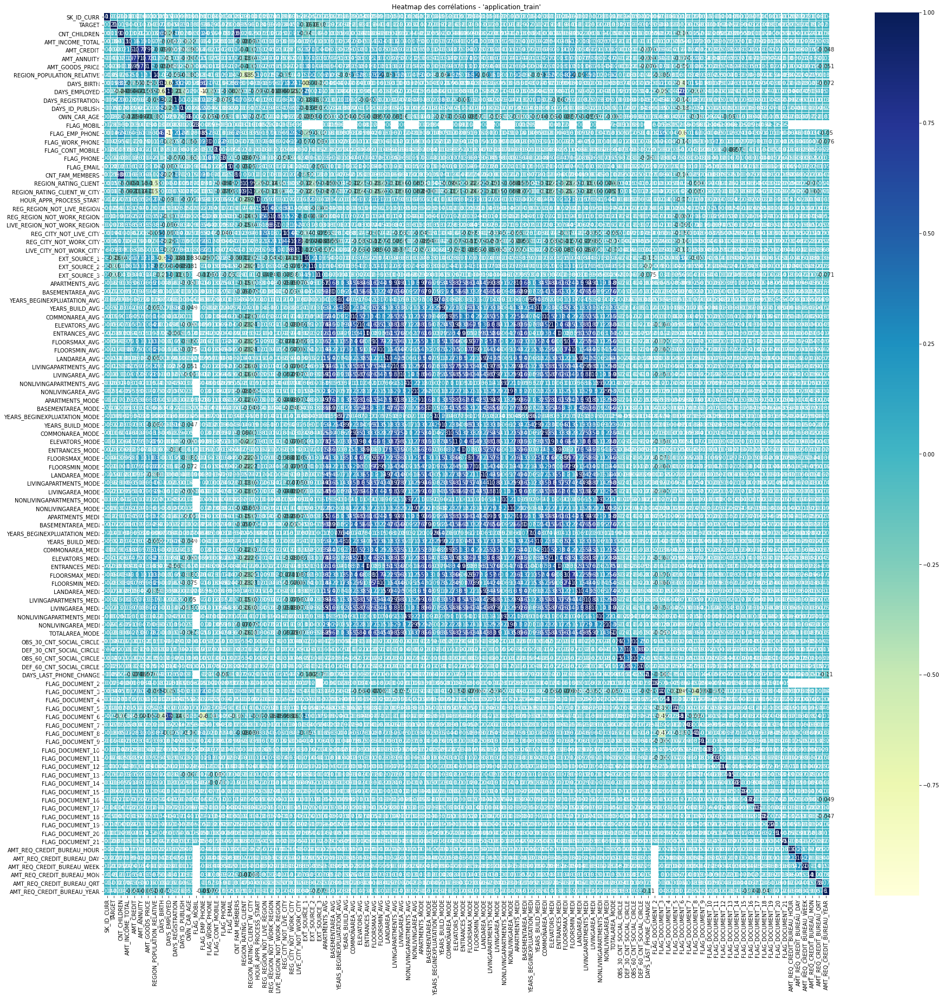

In [85]:
Data_num = DataTrain[ColonnesQuanti]

# Affichage de la heatmap des corrélations
plt.figure(figsize=(30,30))
sns.heatmap(Data_num.corr() , annot=True, linewidths=.2, cmap="YlGnBu")
plt.title("Heatmap des corrélations - 'application_train'");

In [86]:
#corrélation des features numériques avec TARGET
correlations = Data_num.corr()['TARGET'].sort_values(ascending=False)

In [87]:
#Top 20 corrélations positives
correlations.head(20)

TARGET                         1.000000
DAYS_BIRTH                     0.078239
REGION_RATING_CLIENT_W_CITY    0.060893
REGION_RATING_CLIENT           0.058899
DAYS_LAST_PHONE_CHANGE         0.055218
DAYS_ID_PUBLISH                0.051457
REG_CITY_NOT_WORK_CITY         0.050994
FLAG_EMP_PHONE                 0.045982
REG_CITY_NOT_LIVE_CITY         0.044395
FLAG_DOCUMENT_3                0.044346
DAYS_REGISTRATION              0.041975
OWN_CAR_AGE                    0.037612
LIVE_CITY_NOT_WORK_CITY        0.032518
DEF_30_CNT_SOCIAL_CIRCLE       0.032248
DEF_60_CNT_SOCIAL_CIRCLE       0.031276
FLAG_WORK_PHONE                0.028524
AMT_REQ_CREDIT_BUREAU_YEAR     0.019930
CNT_CHILDREN                   0.019187
CNT_FAM_MEMBERS                0.009308
OBS_30_CNT_SOCIAL_CIRCLE       0.009131
Name: TARGET, dtype: float64

Les 3 features numériques les + corrélées positivement à TARGET sont :
- DAYS_BIRTH (date d'anniversaire)
- REGION_RATING_CLIENT_W_CITY (classement de la région où vit le client avec prise en compte de la ville 1, 2 ou 3)
- REGION_RATING_CLIENT (classement de la région où vit le client 1, 2 ou 3)

In [88]:
#Top 20 corrélations négatives
correlations.tail(20)

AMT_CREDIT                   -0.030369
LIVINGAREA_MODE              -0.030685
ELEVATORS_MODE               -0.032131
TOTALAREA_MODE               -0.032596
FLOORSMIN_MODE               -0.032698
LIVINGAREA_MEDI              -0.032739
LIVINGAREA_AVG               -0.032997
FLOORSMIN_MEDI               -0.033394
FLOORSMIN_AVG                -0.033614
ELEVATORS_MEDI               -0.033863
ELEVATORS_AVG                -0.034199
REGION_POPULATION_RELATIVE   -0.037227
AMT_GOODS_PRICE              -0.039645
FLOORSMAX_MODE               -0.043226
FLOORSMAX_MEDI               -0.043768
FLOORSMAX_AVG                -0.044003
DAYS_EMPLOYED                -0.044932
EXT_SOURCE_1                 -0.155317
EXT_SOURCE_2                 -0.160472
EXT_SOURCE_3                 -0.178919
Name: TARGET, dtype: float64

Les 3 features numériques les + corrélées négativement à TARGET sont :
- EXT_SOURCE_3 (score normalisé d'une source externe)
- EXT_SOURCE_2 (score normalisé d'une source externe)
- EXT_SOURCE_1 (score normalisé d'une source externe)

In [89]:
# Correlations des 3 variables les plus corrélées positivement et négativement à la TARGET.
# Extraction des variables  EXT_SOURCE et calcul des correlations.
DataTrain_EXTRACT = DataTrain[['TARGET', 'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'DAYS_BIRTH','REGION_RATING_CLIENT_W_CITY','REGION_RATING_CLIENT']]

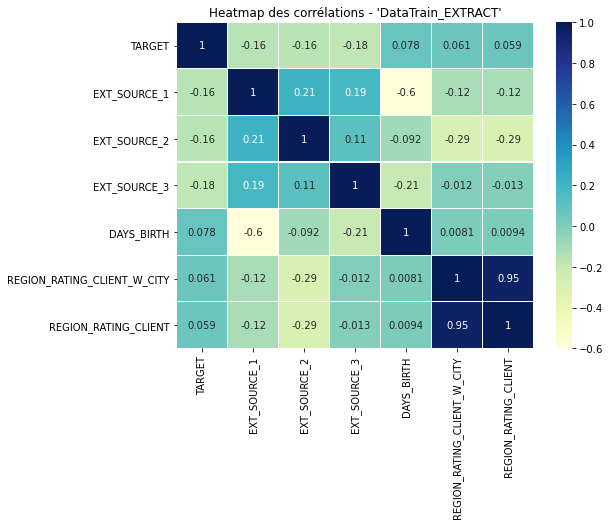

In [90]:
# Affichage de la heatmap des corrélations
plt.figure(figsize=(8,6))
sns.heatmap(DataTrain_EXTRACT.corr() , annot=True, linewidths=.2, cmap="YlGnBu")
plt.title("Heatmap des corrélations - 'DataTrain_EXTRACT'");

- REGION_RATING_CLIENT_W_CITY et REGION_RATING_CLIENT sont fortement corrélés (0,95)
- DAYS_BIRTH et EXT_SOURCE_1 sont corrélés négativement (-0,6)



#### <font color="green" size=4>3.3 Imputation des valeurs nulles</font> <a href="#chapitre3" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_3_3"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

- <i>Sur les variables quantitatives</i> :    

In [132]:
DataTrain_num = DataTrain[ColonnesQuanti]

In [134]:
ColonnesQuanti_NaN = DataTrain_num.columns[DataTrain_num.isnull().sum() > 0]
print("Nb de variables quantitatives avec valeurs manquantes :",len(ColonnesQuanti_NaN))

Nb de variables quantitatives avec valeurs manquantes : 61


In [136]:
print(ColonnesQuanti_NaN)

Index(['AMT_ANNUITY', 'AMT_GOODS_PRICE', 'OWN_CAR_AGE', 'CNT_FAM_MEMBERS',
       'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG',
       'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG',
       'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG',
       'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG',
       'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG',
       'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
       'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE',
       'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE',
       'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE',
       'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI',
       'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI',
       'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI',
       'LANDAREA_MEDI', 'LIVINGAPART

In [138]:
list_ColonnesQuanti_NaN = ['AMT_ANNUITY', 'AMT_GOODS_PRICE', 'OWN_CAR_AGE', 'CNT_FAM_MEMBERS',
       'EXT_SOURCE_1', 'EXT_SOURCE_2', 'EXT_SOURCE_3', 'APARTMENTS_AVG',
       'BASEMENTAREA_AVG', 'YEARS_BEGINEXPLUATATION_AVG', 'YEARS_BUILD_AVG',
       'COMMONAREA_AVG', 'ELEVATORS_AVG', 'ENTRANCES_AVG', 'FLOORSMAX_AVG',
       'FLOORSMIN_AVG', 'LANDAREA_AVG', 'LIVINGAPARTMENTS_AVG',
       'LIVINGAREA_AVG', 'NONLIVINGAPARTMENTS_AVG', 'NONLIVINGAREA_AVG',
       'APARTMENTS_MODE', 'BASEMENTAREA_MODE', 'YEARS_BEGINEXPLUATATION_MODE',
       'YEARS_BUILD_MODE', 'COMMONAREA_MODE', 'ELEVATORS_MODE',
       'ENTRANCES_MODE', 'FLOORSMAX_MODE', 'FLOORSMIN_MODE', 'LANDAREA_MODE',
       'LIVINGAPARTMENTS_MODE', 'LIVINGAREA_MODE', 'NONLIVINGAPARTMENTS_MODE',
       'NONLIVINGAREA_MODE', 'APARTMENTS_MEDI', 'BASEMENTAREA_MEDI',
       'YEARS_BEGINEXPLUATATION_MEDI', 'YEARS_BUILD_MEDI', 'COMMONAREA_MEDI',
       'ELEVATORS_MEDI', 'ENTRANCES_MEDI', 'FLOORSMAX_MEDI', 'FLOORSMIN_MEDI',
       'LANDAREA_MEDI', 'LIVINGAPARTMENTS_MEDI', 'LIVINGAREA_MEDI',
       'NONLIVINGAPARTMENTS_MEDI', 'NONLIVINGAREA_MEDI', 'TOTALAREA_MODE',
       'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'DAYS_LAST_PHONE_CHANGE', 'AMT_REQ_CREDIT_BUREAU_HOUR',
       'AMT_REQ_CREDIT_BUREAU_DAY', 'AMT_REQ_CREDIT_BUREAU_WEEK',
       'AMT_REQ_CREDIT_BUREAU_MON', 'AMT_REQ_CREDIT_BUREAU_QRT',
       'AMT_REQ_CREDIT_BUREAU_YEAR']

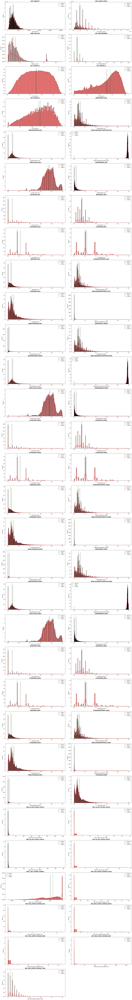

In [98]:
fig = plt.figure(figsize=(20,150))

for i, c in enumerate(list_ColonnesQuanti_NaN,1):
    ax = fig.add_subplot(31,2,i)
    #ax.hist(Data[c],  bins=30, color='grey')
    sns.histplot(DataTrain[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.vlines(DataTrain[c].mean(), *ax.get_ylim(), color='black', ls='-.', lw=1.5)
    ax.vlines(DataTrain[c].median(), *ax.get_ylim(), color='green', ls='-.', lw=1.5)
     #ax.vlines(df[c].mode(), *ax.get_ylim(), color='blue', ls='-.', lw=1.5)
    ax.legend(['density', 'mean','median'])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

D'après La distribution des données sur les valeurs manquantes, la plupart de ces données présentent une forte asymétrie<br>

i) Nous testons <u>la médiane</u> pour compléter les valeurs manquantes.

In [99]:
DataTrain_impute_median = DataTrain.copy()
for i in list_ColonnesQuanti_NaN:
    DataTrain_impute_median[i].fillna(DataTrain_impute_median[i].median(), inplace=True)

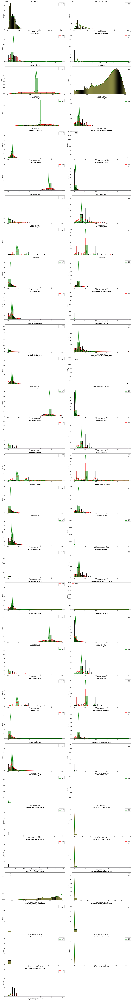

In [100]:
fig = plt.figure(figsize=(20,150))

for i, c in enumerate(list_ColonnesQuanti_NaN,1):
    ax = fig.add_subplot(31,2,i)
    sns.histplot(DataTrain[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    sns.histplot(DataTrain_impute_median[c], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.legend(["avant", "apres"])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

Visuellement après imputation par la médiane :
- 33 variables numériques sur 61 (soit +54%) ont une répartition de leurs données assez différentes des données d'origine
- 28 variables numériques sur 61 (soit +46%) ont une répartition de leurs données semblables à celles d'origine


ii) Nous testons <u>la moyenne</u> pour compléter les valeurs manquantes.

In [101]:
DataTrain_impute_mean = DataTrain.copy()
for i in list_ColonnesQuanti_NaN:
    DataTrain_impute_mean[i].fillna(DataTrain_impute_mean[i].mean(), inplace=True)

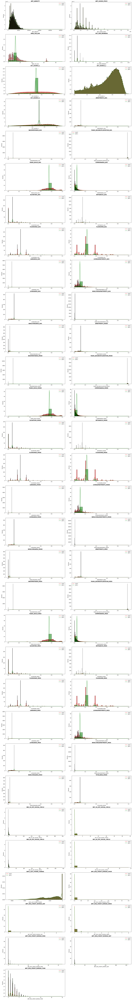

In [102]:
fig = plt.figure(figsize=(20,150))

for i, c in enumerate(list_ColonnesQuanti_NaN,1):
    ax = fig.add_subplot(31,2,i)
    sns.histplot(DataTrain[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    sns.histplot(DataTrain_impute_mean[c], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.legend(["avant", "apres"])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

Visuellement après imputation par la moyenne :
- 20 variables numériques sur 61 (soit +33%) ont une répartition de leurs données assez différentes des données d'origine
- 41 variables numériques sur 61 (soit +67%) ont une répartition de leurs données semblables à celles d'origine

iii) Nous testons <u>la valeur 0</u> pour compléter les valeurs manquantes.

In [98]:
DataTrain_impute_zero = DataTrain.copy()
for i in list_ColonnesQuanti_NaN:
    DataTrain_impute_zero[i].fillna(0, inplace=True)

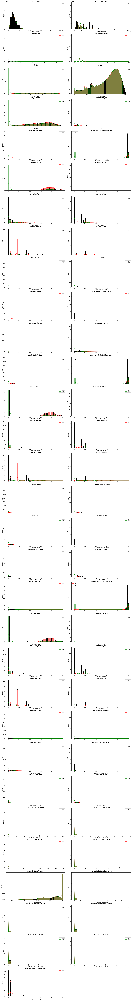

In [100]:
fig = plt.figure(figsize=(20,150))

for i, c in enumerate(list_ColonnesQuanti_NaN,1):
    ax = fig.add_subplot(31,2,i)
    sns.histplot(DataTrain[c], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
    sns.histplot(DataTrain_impute_zero[c], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
    ax.set_title(c)
    ax.legend(["avant", "apres"])
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

Visuellement après imputation par la valeur 0 :
- 10 variables numériques sur 61 (soit +16%) ont une répartition de leurs données assez différentes des données d'origine
- 51 variables numériques sur 61 (soit +84%) ont une répartition de leurs données semblables à celles d'origine

<div class="alert alert-block alert-info"><b>On conservera donc la valeur 0 pour remplacer les valeurs NaN pour les variables quantitatives</b></div>

In [140]:
DataTrain_impute = DataTrain.copy()
for i in list_ColonnesQuanti_NaN:
    DataTrain_impute[i].fillna(0, inplace=True)

C:\Users\MOI\AppData\Local\Temp\ipykernel_21860\1072061630.py:3: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  DataTrain_impute[i].fillna(0, inplace=True)


- <i>Sur les variables qualitatives</i> :

In [143]:
DataTrain_cat = DataTrain[ColonnesQuali]

In [145]:
ColonnesQuali_NaN = DataTrain_cat.columns[DataTrain_cat.isnull().sum() > 0]
print("Nb de variables qualitatives avec valeurs manquantes :",len(ColonnesQuali_NaN))

Nb de variables qualitatives avec valeurs manquantes : 6


In [147]:
print(ColonnesQuali_NaN)

Index(['NAME_TYPE_SUITE', 'OCCUPATION_TYPE', 'FONDKAPREMONT_MODE',
       'HOUSETYPE_MODE', 'WALLSMATERIAL_MODE', 'EMERGENCYSTATE_MODE'],
      dtype='object')


In [149]:
list_ColonnesQuali_NaN = ['NAME_TYPE_SUITE', 'OCCUPATION_TYPE', 'FONDKAPREMONT_MODE',
       'HOUSETYPE_MODE', 'WALLSMATERIAL_MODE', 'EMERGENCYSTATE_MODE']

In [151]:
list_ColonnesQuali_NaN

['NAME_TYPE_SUITE',
 'OCCUPATION_TYPE',
 'FONDKAPREMONT_MODE',
 'HOUSETYPE_MODE',
 'WALLSMATERIAL_MODE',
 'EMERGENCYSTATE_MODE']

Remplissage des valeurs manquntes par la modalité la plus fréquente :


In [154]:
# Imputation par le mode
imputer_mode = SimpleImputer(strategy='most_frequent')

for i in list_ColonnesQuali_NaN:
    DataTrain_impute[i] = imputer_mode.fit_transform(DataTrain_impute[[i]])
    

ValueError: 2

In [ ]:
#affichage des modalités des variables qualitatives (y compris avec valeurs nulles)
for column in list_ColonnesQuali_NaN:
    df = DataTrain_impute.groupby(column, dropna = False)['SK_ID_CURR'].count().reset_index()
    df = df.rename(columns={'SK_ID_CURR': 'count'})
    df['Percentage'] = round(100 * df['count']  / df['count'].sum(),3)
    df.sort_values('Percentage',ascending=False,inplace=True)
    print("\n",df)


<AxesSubplot:>

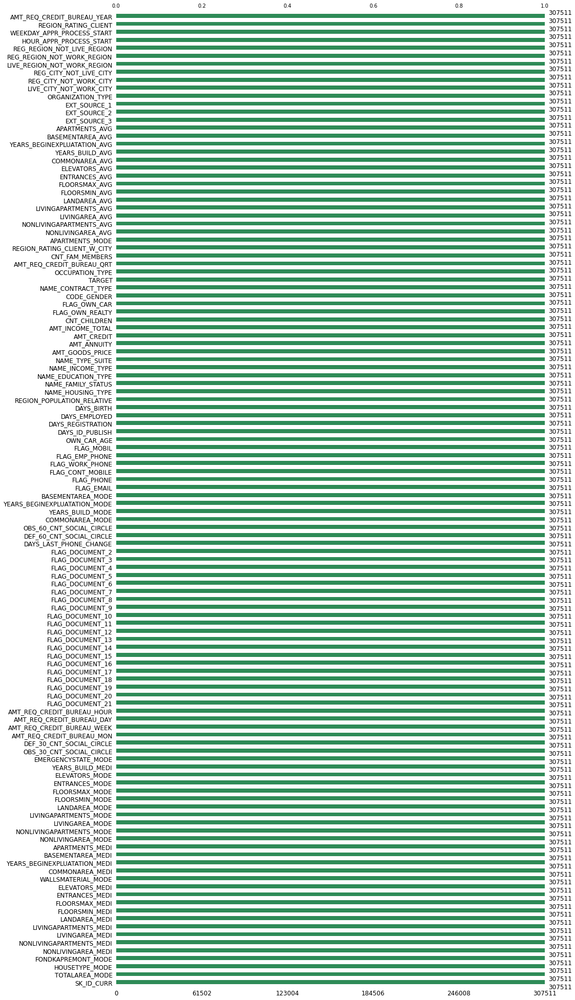

In [103]:
#verification de la complétion des valeurs
msno.bar(DataTrain_impute,figsize=(15,35), fontsize=12, color="seagreen", log=False, sort="ascending")

#### <font color="green" size=4>3.4 Recherche des outliers</font> <a href="#chapitre3" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_3_4"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

<b><u>i) Valeurs abérrantes absurdes</u></b>


<b>Pour les variables quantitatives à valeurs négatives</b> :

- Remplacement en valeur absolue

In [157]:
list_colonnes_quanti_neg = ['DAYS_BIRTH', 'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'DAYS_LAST_PHONE_CHANGE']

DataTrain_impute[ list_colonnes_quanti_neg ] = DataTrain_impute[ list_colonnes_quanti_neg ].abs()

<b>Pour les variables qualitatives </b> :
- Seule la variable CODE_GENDER définissant le genre du client HOMME / FEMME présente une modalité hors norme "XNA"
- On va donc supprimer cette valeur

In [160]:
DataTrain_impute.drop( DataTrain_impute[ DataTrain_impute['CODE_GENDER'] == 'XNA' ].index, inplace=True)

In [162]:
#affichage des modalités de la variable CODE_GENDER apres traitement
df = DataTrain_impute.groupby('CODE_GENDER', dropna = False)['SK_ID_CURR'].count().reset_index()
df = df.rename(columns={'SK_ID_CURR': 'count'})
df['Percentage'] = round(100 * df['count']  / df['count'].sum(),3)
df.sort_values('Percentage',ascending=False,inplace=True)
print("\n",df)



   CODE_GENDER   count  Percentage
0           F  202448      65.835
1           M  105059      34.165


<b><u>ii) Valeurs abérrantes extremes</u></b>


<u>Méthode InterQuartile</u> :

In [166]:
Data_num = DataTrain_impute[ColonnesQuanti]

In [168]:
fig = plt.figure(figsize=(20,300))

for i, c in enumerate(ColonnesQuanti,1):
    ax = fig.add_subplot(53,2,i)
    #ax.hist(Data_num[c],  bins=30, color='grey')
    ax = sns.boxplot(data=Data_num, x=c, orient="h", palette="Set2", medianprops=dict(linestyle='--', linewidth=1.5, color='white'))
    ax.set_title(c)
    ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

C:\Users\MOI\AppData\Local\Temp\ipykernel_21860\1360735775.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(data=Data_num, x=c, orient="h", palette="Set2", medianprops=dict(linestyle='--', linewidth=1.5, color='white'))
C:\Users\MOI\AppData\Local\Temp\ipykernel_21860\1360735775.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(data=Data_num, x=c, orient="h", palette="Set2", medianprops=dict(linestyle='--', linewidth=1.5, color='white'))
C:\Users\MOI\AppData\Local\Temp\ipykernel_21860\1360735775.py:6: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same eff

Nous allons nous interessé à 2 variables avec valeurs extremes ;
- AMT_INCOME_TOTAL > 10000000
- DAYS_EMPLOYED > 350000

<u>AMT_INCOME_TOTAL</u>

In [170]:
DataTrain_impute.loc[DataTrain_impute['AMT_INCOME_TOTAL'] >= 100000000,('SK_ID_CURR','AMT_INCOME_TOTAL')]

,SK_ID_CURR,AMT_INCOME_TOTAL
12840,114967,117000000.0


In [172]:
DataTrain_impute.loc[DataTrain_impute['SK_ID_CURR'] == 114967,('OCCUPATION_TYPE')]

12840    Laborers
Name: OCCUPATION_TYPE, dtype: object

On va supprimer cette ligne car la valeur du salaire est la plus extreme et en contradiction avec le type de poste de travail (ici Ouvrier)

In [175]:
#drop de l'index concerné
DataTrain_impute.drop( DataTrain_impute[ DataTrain_impute['SK_ID_CURR'] == 114967 ].index, inplace=True)

In [177]:
#verification du drop
DataTrain_impute.loc[DataTrain_impute['AMT_INCOME_TOTAL'] >=  100000000,('SK_ID_CURR','AMT_INCOME_TOTAL')]

,SK_ID_CURR,AMT_INCOME_TOTAL


<u>DAYS_EMPLOYED</u> :

In [180]:
DataTrain_impute.loc[DataTrain_impute['DAYS_EMPLOYED'] >=  350000,('SK_ID_CURR','DAYS_EMPLOYED')]

,SK_ID_CURR,DAYS_EMPLOYED
8,100011,365243
11,100015,365243
23,100027,365243
38,100045,365243
43,100050,365243
...,...,...
307469,456209,365243
307483,456227,365243
307487,456231,365243
307505,456249,365243


Un nombre de jours travaillé égale à 365243 jours = 1000 ans ! est une valeur extreme abérante.<br>
On va la remplacer par NaN

In [183]:
# Remplace la valeur abérrante par NaN
DataTrain_impute['DAYS_EMPLOYED'].replace(365243, np.nan, inplace = True)

C:\Users\MOI\AppData\Local\Temp\ipykernel_21860\2108500928.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  DataTrain_impute['DAYS_EMPLOYED'].replace(365243, np.nan, inplace = True)


In [185]:
#verification 
DataTrain_impute.loc[DataTrain_impute['DAYS_EMPLOYED'] >=  350000,('SK_ID_CURR','DAYS_EMPLOYED')]

,SK_ID_CURR,DAYS_EMPLOYED


On va déterminer quelle valeur choisir pour les valeurs = NaN

- par la valeur 0 :

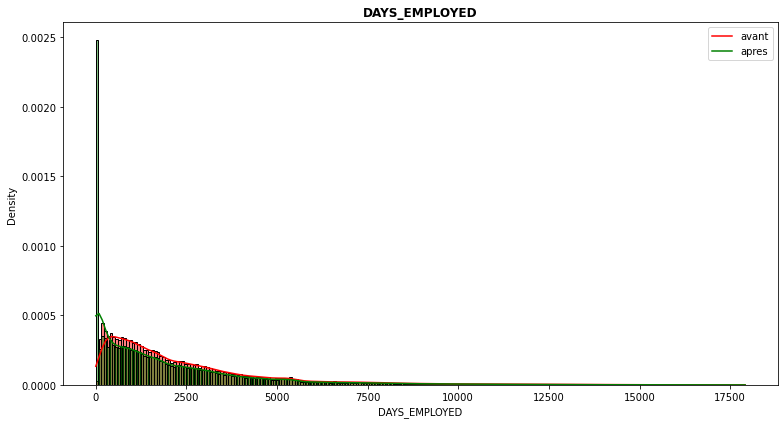

In [141]:
#par la valeur 0
DataTrain_impute_DAYS_EMP = DataTrain_impute.copy()
DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].fillna(0, inplace=True)
    
fig = plt.figure(figsize=(11,6))

ax = fig.add_subplot(1,1,1)
sns.histplot(DataTrain_impute['DAYS_EMPLOYED'], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
sns.histplot(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
ax.set_title('DAYS_EMPLOYED')
ax.legend(["avant", "apres"])
ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

In [142]:
print('Avant : écart type =',round(DataTrain_impute['DAYS_EMPLOYED'].std(),3))
print('Après : écart type =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std(),3))
print('Ecart (Après - Avant) =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std()-DataTrain_impute['DAYS_EMPLOYED'].std(),2))
print('')

Avant : écart type = 2338.33
Après : écart type = 2307.04
Ecart (Après - Avant) = -31.29



- par la médiane :

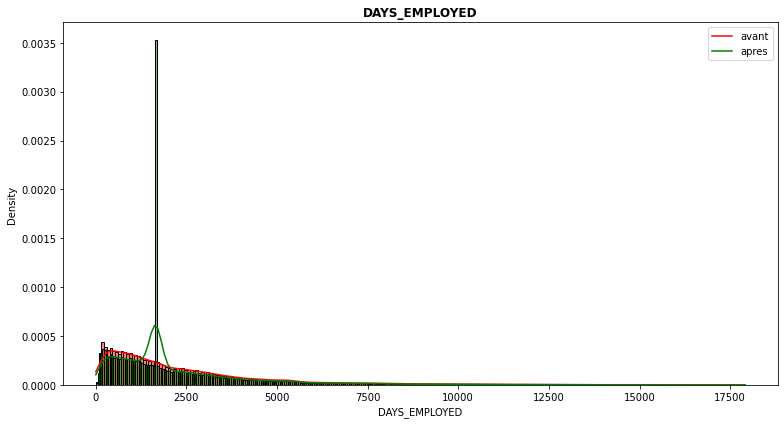

In [143]:
#par la médiane
DataTrain_impute_DAYS_EMP = DataTrain_impute.copy()
DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].fillna(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].median(), inplace=True)
    
fig = plt.figure(figsize=(11,6))

ax = fig.add_subplot(1,1,1)
sns.histplot(DataTrain_impute['DAYS_EMPLOYED'], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
sns.histplot(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
ax.set_title('DAYS_EMPLOYED')
ax.legend(["avant", "apres"])
ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

In [144]:
print('Avant : écart type =',round(DataTrain_impute['DAYS_EMPLOYED'].std(),3))
print('Après : écart type =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std(),3))
print('Ecart (Après - Avant) =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std()-DataTrain_impute['DAYS_EMPLOYED'].std(),2))
print('')

Avant : écart type = 2338.33
Après : écart type = 2136.162
Ecart (Après - Avant) = -202.17



- par la moyenne :

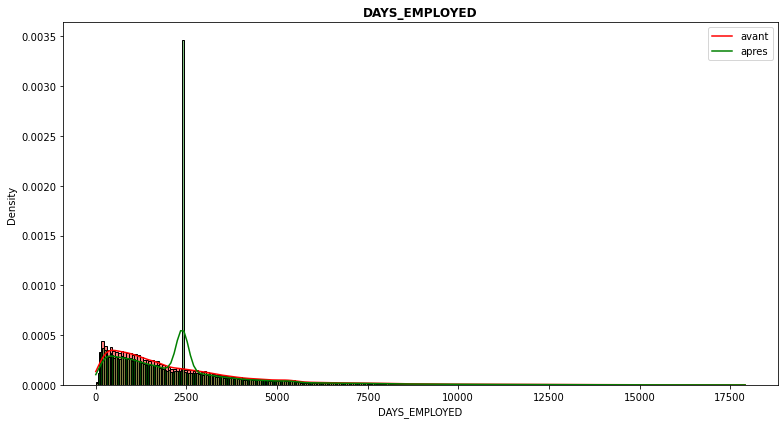

In [145]:
#par la moyenne
DataTrain_impute_DAYS_EMP = DataTrain_impute.copy()
DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].fillna(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].mean(), inplace=True)
    
fig = plt.figure(figsize=(11,6))

ax = fig.add_subplot(1,1,1)
sns.histplot(DataTrain_impute['DAYS_EMPLOYED'], color="red", label="100% Equities", kde=True, stat="density", linewidth=1)
sns.histplot(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'], color="green", label="100% Equities", kde=True, stat="density", linewidth=1)
ax.set_title('DAYS_EMPLOYED')
ax.legend(["avant", "apres"])
ax.title.set_fontweight('bold')
    
plt.tight_layout(w_pad=2, h_pad=0.65)

plt.show()

In [146]:
print('Avant : écart type =',round(DataTrain_impute['DAYS_EMPLOYED'].std(),3))
print('Après : écart type =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std(),3))
print('Ecart (Après - Avant) =',round(DataTrain_impute_DAYS_EMP['DAYS_EMPLOYED'].std()-DataTrain_impute['DAYS_EMPLOYED'].std(),2))
print('')

Avant : écart type = 2338.33
Après : écart type = 2117.351
Ecart (Après - Avant) = -220.98



<div class="alert alert-block alert-info"><b>Le choix de la valeur 0 est le plus pertinent car elle réduit au minimum la distribution de DAYS_EMPLOYED.<br>
De plus son écart-type après imputation par 0 est la plus proche des données d'origine.
</b></div>


In [187]:
# Remplace la valeur NaN par 0
DataTrain_impute['DAYS_EMPLOYED'].replace(np.nan, 0, inplace = True)

In [189]:
DataTrain_impute.loc[DataTrain_impute['DAYS_EMPLOYED'] == 0,('SK_ID_CURR','DAYS_EMPLOYED')]

,SK_ID_CURR,DAYS_EMPLOYED
8,100011,0.0
11,100015,0.0
23,100027,0.0
38,100045,0.0
43,100050,0.0
...,...,...
307469,456209,0.0
307483,456227,0.0
307487,456231,0.0
307505,456249,0.0


<div class="alert alert-block alert-info"><b>Notre dataset [DataTrain_impute] contient donc à présent toutes les données quantitaves et qualitatives nettoyées avec 100% de valeurs renseignées.
</b></div>


###  <font color="blue" size=5>Chapitre 4 - Feature enginnering </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre4"></a><a name="chapitre4"></a>

#### <font color="green" size=4>4.1 Kernel Kaggle</font> <a href="#chapitre4" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_4_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

Le travail de feature engineering s'appuie sur le kernel Kaggle donné dans les ressources du projet :<br> https://www.kaggle.com/code/jsaguiar/lightgbm-with-simple-features/script

In [193]:
df = feature_engineering()

Train samples: 307506
Bureau df shape: (305811, 116)
Process bureau and bureau_balance - done in 15s
Previous applications df shape: (338857, 249)
Process previous_applications - done in 23s
Pos-cash balance df shape: (337252, 18)
Process POS-CASH balance - done in 10s
Installments payments df shape: (339587, 26)
Process installments payments - done in 18s
Credit card balance df shape: (103558, 141)
Process credit card balance - done in 10s


#### <font color="green" size=4>4.2 Dataset finalisé</font> <a href="#chapitre4" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_4_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [180]:
source_repertory = 'Sources/'
delimiter_file = ','
source_data='my_data_feature_engineering.csv'

#DataFeatureEngennering = pd.read_csv(open(source_repertory + source_data,'r'), sep = delimiter_file)
DataFeatureEngennering = pd.read_csv(source_repertory + source_data, sep = delimiter_file)

In [182]:
DataFeatureEngennering.shape

(307506, 797)

In [184]:
DataFeatureEngennering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307506 entries, 0 to 307505
Columns: 797 entries, SK_ID_CURR to CC_COUNT
dtypes: bool(133), float64(605), int64(43), object(16)
memory usage: 1.6+ GB


Le dataset obtenu après feature engineering du kernel Kaggle est entièrement composé de variables numériques :
- 621 variables de type float64
- 177 variables de type int64

In [152]:
DataFeatureEngennering

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

In [186]:
#variables avec uniquement les colonnes de type object  = colonnes qualitatives
i = 0
ColonnesObject= list(DataFeatureEngennering.select_dtypes(include=['object']).columns)
print("Les variables qualitatives de type Object sont les suivantes : \n")
for categ in ColonnesObject :
    print(categ, ":", DataFeatureEngennering[categ].nunique())
    i = i + 1
print("\nNb variables qualitatives de type Object = ",i)

Les variables qualitatives de type Object sont les suivantes : 

CC_NAME_CONTRACT_STATUS_Active_MIN : 2
CC_NAME_CONTRACT_STATUS_Active_MAX : 2
CC_NAME_CONTRACT_STATUS_Approved_MIN : 1
CC_NAME_CONTRACT_STATUS_Approved_MAX : 2
CC_NAME_CONTRACT_STATUS_Completed_MIN : 2
CC_NAME_CONTRACT_STATUS_Completed_MAX : 2
CC_NAME_CONTRACT_STATUS_Demand_MIN : 1
CC_NAME_CONTRACT_STATUS_Demand_MAX : 2
CC_NAME_CONTRACT_STATUS_Refused_MIN : 1
CC_NAME_CONTRACT_STATUS_Refused_MAX : 2
CC_NAME_CONTRACT_STATUS_Sent proposal_MIN : 1
CC_NAME_CONTRACT_STATUS_Sent proposal_MAX : 2
CC_NAME_CONTRACT_STATUS_Signed_MIN : 2
CC_NAME_CONTRACT_STATUS_Signed_MAX : 2
CC_NAME_CONTRACT_STATUS_nan_MIN : 1
CC_NAME_CONTRACT_STATUS_nan_MAX : 1

Nb variables qualitatives de type Object =  16


In [188]:
for categ in ColonnesObject :
    DataFeatureEngennering[categ] = DataFeatureEngennering[categ].astype(object).astype(bool)

In [190]:
DataFeatureEngennering['CC_NAME_CONTRACT_STATUS_Signed_MAX'].value_counts()

CC_NAME_CONTRACT_STATUS_Signed_MAX
True     224892
False     82614
Name: count, dtype: int64

In [192]:
DataFeatureEngennering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307506 entries, 0 to 307505
Columns: 797 entries, SK_ID_CURR to CC_COUNT
dtypes: bool(149), float64(605), int64(43)
memory usage: 1.5 GB


In [194]:
#variables avec uniquement les colonnes de type bool  = colonnes qualitatives
i = 0
ColonnesBool= list(DataFeatureEngennering.select_dtypes(include=['bool']).columns)
print("Les variables qualitatives de type booleen sont les suivantes : \n")
for categ in ColonnesBool :
    print(categ, ":", DataFeatureEngennering[categ].nunique())
    i = i + 1
print("\nNb variables qualitatives de type booleen = ",i)

Les variables qualitatives de type booleen sont les suivantes : 

NAME_CONTRACT_TYPE_Cash loans : 2
NAME_CONTRACT_TYPE_Revolving loans : 2
NAME_TYPE_SUITE_Children : 2
NAME_TYPE_SUITE_Family : 2
NAME_TYPE_SUITE_Group of people : 2
NAME_TYPE_SUITE_Other_A : 2
NAME_TYPE_SUITE_Other_B : 2
NAME_TYPE_SUITE_Spouse, partner : 2
NAME_TYPE_SUITE_Unaccompanied : 2
NAME_INCOME_TYPE_Businessman : 2
NAME_INCOME_TYPE_Commercial associate : 2
NAME_INCOME_TYPE_Maternity leave : 2
NAME_INCOME_TYPE_Pensioner : 2
NAME_INCOME_TYPE_State servant : 2
NAME_INCOME_TYPE_Student : 2
NAME_INCOME_TYPE_Unemployed : 2
NAME_INCOME_TYPE_Working : 2
NAME_EDUCATION_TYPE_Academic degree : 2
NAME_EDUCATION_TYPE_Higher education : 2
NAME_EDUCATION_TYPE_Incomplete higher : 2
NAME_EDUCATION_TYPE_Lower secondary : 2
NAME_EDUCATION_TYPE_Secondary / secondary special : 2
NAME_FAMILY_STATUS_Civil marriage : 2
NAME_FAMILY_STATUS_Married : 2
NAME_FAMILY_STATUS_Separated : 2
NAME_FAMILY_STATUS_Single / not married : 2
NAME_FAMILY_

In [196]:
for categ in ColonnesBool :
    DataFeatureEngennering[categ] = DataFeatureEngennering[categ].astype(bool).astype(int)

In [198]:
DataFeatureEngennering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307506 entries, 0 to 307505
Columns: 797 entries, SK_ID_CURR to CC_COUNT
dtypes: float64(605), int32(149), int64(43)
memory usage: 1.7 GB


In [202]:
DataFeatureEngennering['CC_NAME_CONTRACT_STATUS_Demand_MIN'].value_counts()

CC_NAME_CONTRACT_STATUS_Demand_MIN
1    220601
0     86905
Name: count, dtype: int64

In [204]:
# Check for infinity values
is_infinite = DataFeatureEngennering.isin([np.inf, -np.inf])

res = is_infinite.any().any()
print(res)

True


In [38]:
get_columns_with_infinite_values(DataFeatureEngennering)

NameError: name 'DataFeatureEngennering' is not defined

In [206]:
#visualisation des valeurs infinies
DataFeatureEngennering.loc[DataFeatureEngennering['INCOME_PER_PERSON'].isin([np.inf, -np.inf]),('SK_ID_CURR','INCOME_PER_PERSON')]

,SK_ID_CURR,INCOME_PER_PERSON
41979,148605,inf
187344,317181,inf


In [208]:
DataFeatureEngennering = replace_infinite_values_with_nan(DataFeatureEngennering)

les valeurs infinite ont bien remplacé


In [209]:
get_single_value_cols(DataFeatureEngennering)

['BURO_CREDIT_ACTIVE_nan_MEAN',
 'BURO_CREDIT_CURRENCY_nan_MEAN',
 'BURO_CREDIT_TYPE_nan_MEAN',
 'BURO_STATUS_nan_MEAN_MEAN',
 'PREV_NAME_CONTRACT_TYPE_nan_MEAN',
 'PREV_WEEKDAY_APPR_PROCESS_START_nan_MEAN',
 'PREV_FLAG_LAST_APPL_PER_CONTRACT_nan_MEAN',
 'PREV_NAME_CASH_LOAN_PURPOSE_nan_MEAN',
 'PREV_NAME_CONTRACT_STATUS_nan_MEAN',
 'PREV_NAME_PAYMENT_TYPE_nan_MEAN',
 'PREV_CODE_REJECT_REASON_nan_MEAN',
 'PREV_NAME_CLIENT_TYPE_nan_MEAN',
 'PREV_NAME_GOODS_CATEGORY_House Construction_MEAN',
 'PREV_NAME_GOODS_CATEGORY_nan_MEAN',
 'PREV_NAME_PORTFOLIO_nan_MEAN',
 'PREV_NAME_PRODUCT_TYPE_nan_MEAN',
 'PREV_CHANNEL_TYPE_nan_MEAN',
 'PREV_NAME_SELLER_INDUSTRY_nan_MEAN',
 'PREV_NAME_YIELD_GROUP_nan_MEAN',
 'POS_NAME_CONTRACT_STATUS_nan_MEAN',
 'CC_SK_DPD_MIN',
 'CC_SK_DPD_DEF_MIN',
 'CC_NAME_CONTRACT_STATUS_nan_MEAN',
 'CC_NAME_CONTRACT_STATUS_nan_SUM',
 'CC_NAME_CONTRACT_STATUS_nan_VAR']

In [212]:
#visualisation d'une colonne avec 1 modalité
print('Nb valeurs distincts pour BURO_CREDIT_ACTIVE_nan_MEAN proposal_MIN :',len(DataFeatureEngennering.groupby('BURO_CREDIT_ACTIVE_nan_MEAN')))
resultat = DataFeatureEngennering.groupby(['BURO_CREDIT_ACTIVE_nan_MEAN'], dropna=True).size().reset_index()
resultat.columns = ['BURO_CREDIT_ACTIVE_nan_MEAN','nb']
resultat['Percentage'] = 100 * resultat['nb']  / resultat['nb'].sum()
resultat.sort_values('Percentage',ascending=False,inplace=True)
resultat.head(10)

Nb valeurs distincts pour BURO_CREDIT_ACTIVE_nan_MEAN proposal_MIN : 1


,BURO_CREDIT_ACTIVE_nan_MEAN,nb,Percentage
0,0.0,263486,100.0


In [214]:
DataFeatureEngennering = drop_single_value_cols(DataFeatureEngennering)
DataFeatureEngennering.shape

supprimer les colonnes avec seulement une valeur, nb.cols = 25


(307506, 772)

Variables avec valeurs manquantes :

In [217]:
ColonnesQuanti_NaN = DataFeatureEngennering.columns[DataFeatureEngennering.isnull().sum() > 0]
print("Nb de variables quantitatives avec valeurs manquantes :",len(ColonnesQuanti_NaN))


Nb de variables quantitatives avec valeurs manquantes : 510


In [219]:
print(ColonnesQuanti_NaN)

Index(['INCOME_PER_PERSON', 'BURO_DAYS_CREDIT_MIN', 'BURO_DAYS_CREDIT_MAX',
       'BURO_DAYS_CREDIT_MEAN', 'BURO_DAYS_CREDIT_VAR',
       'BURO_DAYS_CREDIT_ENDDATE_MIN', 'BURO_DAYS_CREDIT_ENDDATE_MAX',
       'BURO_DAYS_CREDIT_ENDDATE_MEAN', 'BURO_DAYS_CREDIT_UPDATE_MEAN',
       'BURO_CREDIT_DAY_OVERDUE_MAX',
       ...
       'CC_NAME_CONTRACT_STATUS_Refused_MEAN',
       'CC_NAME_CONTRACT_STATUS_Refused_SUM',
       'CC_NAME_CONTRACT_STATUS_Refused_VAR',
       'CC_NAME_CONTRACT_STATUS_Sent proposal_MEAN',
       'CC_NAME_CONTRACT_STATUS_Sent proposal_SUM',
       'CC_NAME_CONTRACT_STATUS_Sent proposal_VAR',
       'CC_NAME_CONTRACT_STATUS_Signed_MEAN',
       'CC_NAME_CONTRACT_STATUS_Signed_SUM',
       'CC_NAME_CONTRACT_STATUS_Signed_VAR', 'CC_COUNT'],
      dtype='object', length=510)


In [221]:
for i in ColonnesQuanti_NaN:  
    DataFeatureEngennering[i].replace(np.nan, 0, inplace= True)

In [223]:
#controle des variables avec valeur manquante apres imputation
print("Nb de variables quantitatives avec valeurs manquantes :",len(DataFeatureEngennering.columns[DataFeatureEngennering.isnull().sum() > 0]))

Nb de variables quantitatives avec valeurs manquantes : 0


In [225]:
DataFeatureEngennering

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

Suppression des variables corrélées >= 90%

In [228]:
# Threshold for removing correlated variables fixed at 90%
threshold = 0.9

# Absolute value correlation matrix
corr_matrix = DataFeatureEngennering.corr().abs()
corr_matrix.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

In [230]:
# Upper triangle of correlations
#upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
upper.head()

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,REGION_RATING_CLIENT_W_CITY,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,LIVINGAREA_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,APARTMENTS_MODE,BASEMENTAREA_MODE,YEARS_BEGINEXPLUATATION_MODE,YEARS_BUILD_MODE,COMMONAREA_MODE,ELEVATORS_MODE,ENTRANCES_MODE,FLOORSMAX_MODE,FLOORSMIN_MODE,LANDAREA_MODE,LIVINGAPARTMENTS_MODE,LIVINGAREA_MODE,NONLIVINGAPARTMENTS_MODE,NONLIVINGAREA_MODE,APARTMENTS_MEDI,BASEMENTAREA_MEDI,YEARS_BEGINEXPLUATATION_MEDI,YEARS_BUILD_MEDI,COMMONAREA_MEDI,ELEVATORS_MEDI,ENTRANCES_MEDI,FLOORSMAX_MEDI,FLOORSMIN_MEDI,LANDAREA_MEDI,LIVINGAPARTMENTS_MEDI,LIVINGAREA_MEDI,NONLIVINGAPARTMENTS_MEDI,NONLIVINGAREA_MEDI,TOTALAREA_MODE,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,OBS_60_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_CONTRACT_TYPE_Revolving loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_Pensioner,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_

In [232]:
# Select columns with correlations above threshold
to_drop = [column for column in upper.columns if any(upper[column] > threshold)]

print('There are %d columns to remove.' % (len(to_drop)))

There are 181 columns to remove.


In [234]:
to_drop

['AMT_GOODS_PRICE',
 'REGION_RATING_CLIENT_W_CITY',
 'LIVINGAREA_AVG',
 'APARTMENTS_MODE',
 'BASEMENTAREA_MODE',
 'YEARS_BEGINEXPLUATATION_MODE',
 'YEARS_BUILD_MODE',
 'COMMONAREA_MODE',
 'ELEVATORS_MODE',
 'ENTRANCES_MODE',
 'FLOORSMAX_MODE',
 'FLOORSMIN_MODE',
 'LANDAREA_MODE',
 'LIVINGAPARTMENTS_MODE',
 'LIVINGAREA_MODE',
 'NONLIVINGAPARTMENTS_MODE',
 'NONLIVINGAREA_MODE',
 'APARTMENTS_MEDI',
 'BASEMENTAREA_MEDI',
 'YEARS_BEGINEXPLUATATION_MEDI',
 'YEARS_BUILD_MEDI',
 'COMMONAREA_MEDI',
 'ELEVATORS_MEDI',
 'ENTRANCES_MEDI',
 'FLOORSMAX_MEDI',
 'FLOORSMIN_MEDI',
 'LANDAREA_MEDI',
 'LIVINGAPARTMENTS_MEDI',
 'LIVINGAREA_MEDI',
 'NONLIVINGAPARTMENTS_MEDI',
 'NONLIVINGAREA_MEDI',
 'TOTALAREA_MODE',
 'OBS_60_CNT_SOCIAL_CIRCLE',
 'NAME_CONTRACT_TYPE_Revolving loans',
 'NAME_INCOME_TYPE_Pensioner',
 'ORGANIZATION_TYPE_XNA',
 'HOUSETYPE_MODE_block of flats',
 'EMERGENCYSTATE_MODE_No',
 'DAYS_EMPLOYED_PERC',
 'BURO_AMT_CREDIT_SUM_DEBT_SUM',
 'ACTIVE_DAYS_CREDIT_MEAN',
 'ACTIVE_DAYS_CREDIT_END

In [236]:
# Drop Correlated Variables
DataFeatureEngennering = DataFeatureEngennering.drop(columns = to_drop)

In [238]:
# built new dataset clean feature engennering 
DataFeatureEngennering.to_csv('Sources/my_data_feature_engineering_clean.csv', index=False)

In [240]:
#controle des variables avec valeur manquante apres imputation
print("Nb de variables quantitatives avec valeurs manquantes :",len(DataFeatureEngennering.columns[DataFeatureEngennering.isnull().sum() > 0]))

Nb de variables quantitatives avec valeurs manquantes : 0


In [242]:
DataFeatureEngennering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307506 entries, 0 to 307505
Columns: 591 entries, SK_ID_CURR to CC_NAME_CONTRACT_STATUS_Signed_VAR
dtypes: float64(419), int32(130), int64(42)
memory usage: 1.2 GB


#### <font color="green" size=4>4.3 Notion de Score Métier</font> <a href="#chapitre4" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_4_3"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

Nous allons créer un score métier qui permet de minimiser le cout d’erreur de prédiction des Faux Négatif (FN) et Faux Positif (FP) pour comparer les modèles avec :
- FN : mauvais client et prédiction comme bon client : donc crédit accordé et perte en capital pour la banque
- FP : bon client et prédiction comme mauvais client : donc refus crédit et manque à gagner pour la banque

On va prendre comme hypothèse que le coût d’un FN est dix fois supérieur au coût d’un FP équivaut à dire que perdre un capital pour la banque est plus importante qu'un manque à gagner

On utilise le F-Beta Score avec beta = 2 afin de donner une importance plus grande au rappel.

En parallèle, on maintient, pour comparaison et contrôle, des mesures plus techniques, telles que l’AUC et l’accuracy.

<b><u>Rappels des mesures pour  évaluer la performance d'un modèle de classification binaire</u></b> :<br>

Source : <br>
https://machinelearningmastery.com/fbeta-measure-for-machine-learning/<br>
https://www.studysmarter.fr/resumes/informatique/fintech/courbes-roc/

<font color="green">Accuracy, Precision, Rappel, F1-score, AUC</font>

| Result Class   | Positive Prediction | Negative Prediction
| :---    | :----               | :----     
| Positive       | True Positive (TP)  | False Negative (FN)
| Negative  | False Positive (FP) | True Negative (TN)         

L'Accuracy est une mesure de probabilité du bon résultat autrement dit c'est le nombre de prédiction correcte divisé par le nombre total de prédiction<br>

Accuracy = (True Positive + True Negative) / (True Positive + False Negative + False Negative + True Negative)

La <u>précision</u> est une mesure qui quantifie le nombre de prédictions positives correctes effectuées.

Precision = True Positives / (True Positives + False Positives)

Les valeurs varient de 0 (flop precision) à 1 (top precision)

Le <u>rappel</u> est une mesure qui quantifie le nombre de prédictions positives correctes faites à partir de toutes les prédictions positives qui auraient pu être faites.

Recall = True Positives / (True Positives + False Negatives)

Les valeurs varient de 0 (flop rappel) à 1 (top rappel)

<img src="Images/Precision_et_rappel.png">
<center><font size=1>Illustration de la Précision et du Rappel dans le cadre d'une classification binaire (réf. wikipédia)</font></center>

La Précision et le Rappel mesurent donc les deux types d’erreurs qui pourraient être commises pour la classe positive. <br>
L’optimisation de la Précision minimise les faux positifs et l’optimisation du Rappel minimise les faux négatifs.<br>

Le <u>F1-score</u> permet de combiner à la fois la Précision et le Rappel en une seule mesure qui capture les deux propriétés.

F1-score = (2 * Precision * Recall) / (Precision + Recall)

Les valeurs varient de 0 (flop F1-score) à 1 (top F1-score)

La mesure F1-score est principalement utilisée lorsque les deux mesures ont une importance identique : on accorde autant d'importance à la Précision qu'au Rappel.


<font color="green">F-Beta-score</font>

La mesure F-Beta-score permet de donner une importance à la Précision et au Rappel.

Par exemple dans certains problèmes, nous pourrions être intéressés par une mesure F-score avec plus d'importance portée à la Précision, par exemple lorsque les faux positifs sont plus importants à minimiser, mais les faux négatifs sont toujours importants.

Sur d'autres problèmes, nous pourrions être intéressés par une mesure F-score avec plus d'importance portée sur le Rappel, par exemple lorsque les faux négatifs sont plus importants à minimiser, mais les faux positifs sont toujours importants.

La mesure F-Beta-score est une abstraction de la mesure F1-score où l'équilibre entre la Précision et le Rappel dans le calcul de la moyenne harmonique est contrôlé par un coefficient appelé bêta :

<b>F-Beta-score = ((1 + Beta^2) * Precision * Recall) / (Beta^2 * Precision + Recall)</b>

Trois valeurs courantes sont données pour le paramètre Beta :

| Beta parameter   | F-score | Importance
| :---    | :----               | :----     
| 0.5       | F0.5-score  |  + d'importance sur la Précision, - d'importance sur le Rappel
| 1  |  F1-score | La Précision et le Rappel sont autant important (importance =)
| <b><font color="green">2</font></b>  |  <b><font color="green">F2-score</font></b> | <b><font color="green">- d'importance sur la Précision, + d'importance sur le Rappel</font></b>


- F0.5-score = (1.25 * Precision * Recall) / (0.25 * Precision + Recall)<br>
La mesure F0.5-score a pour effet d'accroître l'importance de la précision et de réduire l'importance du rappel autrement dit elle accorde plus d'attention à minimiser les faux positifs que les faux négatifs.


- F2-score = (5 * Precision * Recall) / (4 * Precision + Recall)<br>
La mesure F2-score a pour effet de réduire l'importance de la précision et d'augmenter l'importance du rappel autrement dit elle accorde plus d'attention à minimiser les faux négatifs que les faux positifs. 


La métrique métier consiste à calculer le gain obtenu pour l'ensemble des individus du jeu de données pour limiter les pertes financières autant que possible. Du point de vue d’une banque, on cherche donc à éviter de mal catégoriser un client avec un fort risque de défaut (pertes financières importantes) càd on cherche à minimiser le pourcentage de faux négatifs (FN).

Dans ce contexte, on va fixer un poids arbitraire pour chacune des prédictions relativement à leurs valeurs réelles comme suivan - 

fn_evalu -
- fp0
tp_ u 1lue = 0

<font color="green">AUC (Area Under the Curve)</font>

Définition : <br>
Le Score AUC  est une mesure de performance utilisée pour évaluer la qualité globale d'un modèle de classification.<br>
Son calcul fournit une indication quantitative de la capacité du modèle à classer correctement les exemples positifs et négatifs.<br>
Mathématiquement, il représente la probabilité qu'un échantillon aléatoire positif se classe plus haut qu'un échantillon aléatoire négatif.


L'AUC est donc une métrique précieuse pour comparer différents modèles de classification indépendamment des seuils de classification choisis. <br>
En outre, l'AUC est particulièrement utile dans des contextes où les classes sont déséquilibrées, car elle reste une mesure impartiale par rapport à la taille des classes.<br>

- Un AUC de 0,5 implique une performance similaire à un choix aléatoire.
- Un AUC de 1,0 signifie une performance parfaite.
- Un score AUC supérieur à 0,7 indique généralement une bonne performance.

###  <font color="blue" size=5>Chapitre 5 - Modélisation </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre5"></a><a name="chapitre5"></a>


- Nous allons comparer 4 modèles : LogisticRegression (baseline), RandomForest, XGBoost, LightGBM.
- Nous utilisons une grille de recherche avec validation croisée (GridSearchCV) pour l’optimisation des hyperparamètres et comparer les performances de nos modèles.
- Pour la cross validation, l’utilisation de StratifiedKFold permet de prendre en compte la distribution de la target et de construire des folds avec une distribution de classe représentative de la distribution dans le jeu de données d’entraînement complet.
- Pour l’évaluation, nous utilisons le score métier vu prédécemment afin de choisir le meilleur modèle et les meilleurs hyperparamètres associés. En parallèle nous maintenons également pour comparaison et contrôle des métriques techniques telles que l’AUC, la précision et le rappel.

Un point important pour l'entrainement de nos modèles est le traitement du déséquilibre de la cible (TARGET) :
- environ 92% pour la TARGET=0 et environ 8% pour la TARGET=1.
- Pour gérer l’entraînement du modèle avec déséquilibre de classes, il existe différentes techniques telles que le sur-échantillonnage de la classe minoritaire (oversampling) ou le sous-échantillonnage de classe majoritaire (undersampling)
- La méthode d’Oversampling fonctionnent en augmentant le nombre d’observations de la (des) classe(s) minoritaire(s) afin d’arriver à un ratio classe minoritaire/ classe majoritaire satisfaisant  (souvent utilisé lorsqu'il n'y a pas beaucoup de données < 10 000 lignes par exemple)

- La méthode d’Undersampling fonctionnent en diminuant le nombre d’observations de la  (des) classe(s) majoritaire(s) afin d’arriver à un ratio classe minoritaire/ classe majoritaire satisfaisan (souvent utilisé lorsqu'il y a beaucoup de données >= 10 000 par exemple) 
- Il existe également la méthode SMOTE (Synthetic Minority Oversampling Technique) permettant de génèrer des données synthétiques pour la classe minoritaire (équivalent à du sur-échantillonage). SMOTE fonctionne en choisissant au hasard un point de la classe minoritaire et en calculant les k plus proches voisins pour ce point. Les points synthétiques sont ajoutés entre le point choisi et ses voisins.
- autre méthode Class_weight='balanced' : contribue à améliorer le Rappel pour la classe minoritaire.

Nous testerons les 4 méthodes pour voir laquelle est la plus efficace.

source : https://datascientest.com/comment-gerer-les-problemes-de-classification-desequilibree-partie-ii


In [46]:
source_repertory = 'Sources/'
delimiter_file = ','
source_data='my_data_feature_engineering_clean.csv'

DataFeatureEngennering = pd.read_csv(source_repertory + source_data, sep = delimiter_file)

In [47]:
#controle des variables avec valeur manquante apres imputation
print("Nb de variables quantitatives avec valeurs manquantes :",len(DataFeatureEngennering.columns[DataFeatureEngennering.isnull().sum() > 0]))

Nb de variables quantitatives avec valeurs manquantes : 0


In [48]:
DataFeatureEngennering.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307506 entries, 0 to 307505
Columns: 591 entries, SK_ID_CURR to CC_NAME_CONTRACT_STATUS_Signed_VAR
dtypes: float64(419), int64(172)
memory usage: 1.4 GB


<u>Strategie des tests</u> :<br>

1. Oversampling (On rajoute des individus dans la classe minoritaire)
- Normalisation des variables numériques (standarscaler, minmaxscaler)
- Tests des modèles (LogisticRegression, DecisionTree, RandomForest, XGBoost, LightGBM)
- Recherche rapide des hyperparametres (randomSearchCV) avec validation croisée
- Evaluation des metrics  
2. Undersampling (On enlève des individus de la classe majoritaire)
- Normalisation des variables numériques (standarscaler, minmaxscaler)
- Tests des modèles (LogisticRegression, DecisionTree, RandomForest, XGBoost, LightGBM)
- Recherche rapide des hyperparametres (randomSearchCV) avec validation croisée
- Evaluation des metrics  
3. Smote
- Normalisation des variables numériques (standarscaler, minmaxscaler)
- Tests des modèles (LogisticRegression, DecisionTree, RandomForest, XGBoost, LightGBM)
- Recherche rapide des hyperparametres (randomSearchCV) avec validation croisée
- Evaluation des metrics  
4. Class_weight='balanced'
- Normalisation des variables numériques (standarscaler, minmaxscaler)
- Tests des modèles (LogisticRegression, DecisionTree, RandomForest, XGBoost, LightGBM)
- Recherche rapide des hyperparametres (randomSearchCV) avec validation croisée
- Evaluation des metrics  

5. Choix de la méthode avec déséquilibre de classes + modèle


6. Recherche détaillée des hyperparametres (gridSearchCV) sur le meilleur modèle retenu

#### <font color="green" size=4>5.1 Tests sur un echantillon </font><a href="#chapitre5" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_5_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

In [52]:
DataFeatureEngennering = clean_column_names(DataFeatureEngennering)

In [53]:
X = DataFeatureEngennering.drop(columns=['SK_ID_CURR','TARGET'], axis=1)
y = DataFeatureEngennering['TARGET']

In [54]:
# Exemple d'utilisation :
categorical_cols = detect_categorical_binary_columns(X)
print("Colonnes catégorielles/binaries détectées :", categorical_cols)

# Récupérer les indices pour SMOTENC
categorical_indices = [X.columns.get_loc(col) for col in categorical_cols]
print("Indices colonnes catégorielles/binaries :", categorical_indices)

Colonnes catégorielles/binaries détectées : ['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'FLAG_MOBIL', 'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE', 'FLAG_EMAIL', 'REGION_RATING_CLIENT', 'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY', 'FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3', 'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6', 'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9', 'FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_12', 'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15', 'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18', 'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21', 'NAME_CONTRACT_TYPE_Cash_loans', 'NAME_TYPE_SUITE_Children', 'NAME_TYPE_SUITE_Family', 'NAME_TYPE_SUITE_Group_of_people', 'NAME_TYPE_SUITE_Other_A', 'NAME_TYPE_SUITE_Other_B', 'NAME_TYPE_SUITE_Spouse_partner', 'NAME_TYPE

In [56]:
#define total sample size desired 10%
SAMPLE_SIZE = 30750

X_sample, y_sample = sample_data(X, y, nb=SAMPLE_SIZE)

In [57]:
#verification de l'echantillonnage de la TARGET à 10% en nombre
y_sample.value_counts()

TARGET
0    28218
1     2532
Name: count, dtype: int64

In [58]:
#verification de l'echantillonnage de la TARGET à 10% en poids
y_sample.value_counts(normalize=True)

TARGET
0    0.917659
1    0.082341
Name: proportion, dtype: float64

In [59]:
##### Sépration en jeu d'entrainement / jeu de validation, 80% des données pour l'entraînement
#X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=42)
#X_train, X_test, y_train, y_test = train_test_split(X_sample, y_sample, train_size=0.8, random_state=42)
X_train, X_temp, y_train, y_temp = train_test_split(X_sample, y_sample, test_size=0.3, stratify=y_sample, random_state=42)
X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42)


# vérification de la taille des matrices :
print('taille X_train:', X_train.shape)
print('taille X_val:', X_val.shape)
print('taille X_test:', X_test.shape)
print('taille y_train:', y_train.shape)
print('taille y_val:', y_val.shape)
print('taille y_test:', y_test.shape)

taille X_train: (21525, 589)
taille X_val: (4612, 589)
taille X_test: (4613, 589)
taille y_train: (21525,)
taille y_val: (4612,)
taille y_test: (4613,)


In [60]:
y_train.value_counts()   

TARGET
0    19753
1     1772
Name: count, dtype: int64

### <u>tests équilibrage de la TARGET avec les différentes techniques </u>

In [63]:
X_oversample, y_oversample = umbalanced_data(X_train, y_train, RandomOverSampler())

Original dataset shape (21525,)
Resample dataset shape (39506,)
RandomOverSampler()  a crée des données pour que la classe minoritaire ( target = 1 ) ait la même taille que la classe majoritaire.
 TARGET
0    19753
1    19753
Name: count, dtype: int64
Traitement de la target déséquilibrée - done in 0s


In [64]:
X_undersample, y_undersample = umbalanced_data(X_train, y_train, RandomUnderSampler())

Original dataset shape (21525,)
Resample dataset shape (3544,)
RandomUnderSampler()  a crée des données pour que la classe minoritaire ( target = 1 ) ait la même taille que la classe majoritaire.
 TARGET
0    1772
1    1772
Name: count, dtype: int64
Traitement de la target déséquilibrée - done in 0s


In [65]:
X_smote, y_smote = umbalanced_data(X_train, y_train, SMOTE())

Original dataset shape (21525,)
Resample dataset shape (39506,)
SMOTE()  a crée des données pour que la classe minoritaire ( target = 1 ) ait la même taille que la classe majoritaire.
 TARGET
0    19753
1    19753
Name: count, dtype: int64
Traitement de la target déséquilibrée - done in 1s


Visualisation du rééquilibrage de TARGET :

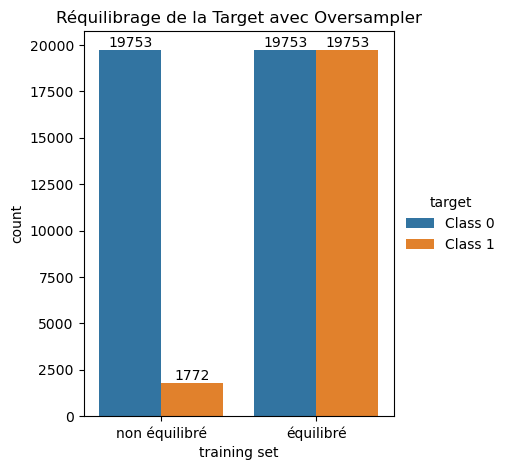

In [67]:
from collections import Counter

y_train_counter = Counter(y_train)
# Display barplot of distribution
class_distr_df = pd.DataFrame({'training set': ['non équilibré', 'non équilibré', 'équilibré', 'équilibré'],
                               'target': ['Class 0', 'Class 1', 'Class 0', 'Class 1'],
                               'count': [y_train_counter[0], y_train_counter[1], Counter(y_oversample)[0], Counter(y_oversample)[1]]})

# Display barplot
fig = plt.figure(figsize=(4,5))
ax = sns.barplot(class_distr_df, x='training set', y='count', hue='target')
plt.title("Réquilibrage de la Target avec Oversampler")
sns.move_legend(ax, bbox_to_anchor=(1, 0.5), loc='center left', frameon=False)
# Adding annotations
for container in ax.containers:
    ax.bar_label(container)
plt.show()

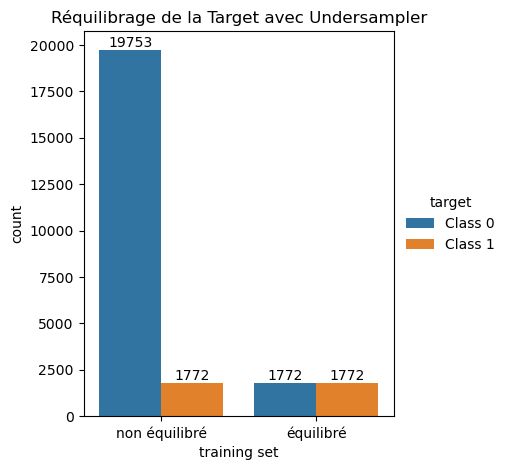

In [68]:
from collections import Counter

y_train_counter = Counter(y_train)
# Display barplot of distribution
class_distr_df = pd.DataFrame({'training set': ['non équilibré', 'non équilibré', 'équilibré', 'équilibré'],
                               'target': ['Class 0', 'Class 1', 'Class 0', 'Class 1'],
                               'count': [y_train_counter[0], y_train_counter[1], Counter(y_undersample)[0], Counter(y_undersample)[1]]})

# Display barplot
fig = plt.figure(figsize=(4,5))
ax = sns.barplot(class_distr_df, x='training set', y='count', hue='target')
plt.title("Réquilibrage de la Target avec Undersampler")
sns.move_legend(ax, bbox_to_anchor=(1, 0.5), loc='center left', frameon=False)
# Adding annotations
for container in ax.containers:
    ax.bar_label(container)
plt.show()

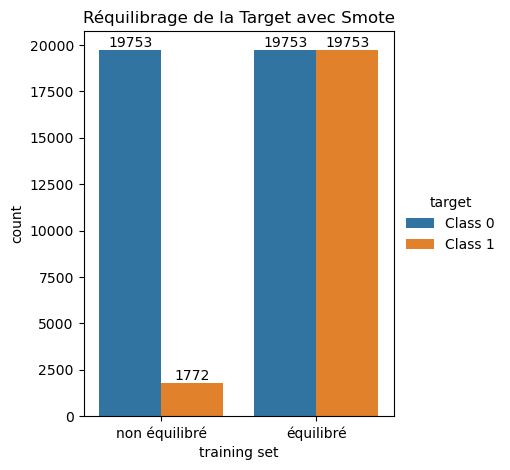

In [69]:
from collections import Counter

y_train_counter = Counter(y_train)
# Display barplot of distribution
class_distr_df = pd.DataFrame({'training set': ['non équilibré', 'non équilibré', 'équilibré', 'équilibré'],
                               'target': ['Class 0', 'Class 1', 'Class 0', 'Class 1'],
                               'count': [y_train_counter[0], y_train_counter[1], Counter(y_smote)[0], Counter(y_smote)[1]]})

# Display barplot
fig = plt.figure(figsize=(4,5))
ax = sns.barplot(class_distr_df, x='training set', y='count', hue='target')
plt.title("Réquilibrage de la Target avec Smote")
sns.move_legend(ax, bbox_to_anchor=(1, 0.5), loc='center left', frameon=False)
# Adding annotations
for container in ax.containers:
    ax.bar_label(container)
plt.show()

<b>Réquilibrage de la Target avec Class_weight</b> :

In [71]:
# Calcul des poids des classes avec class_weight
from sklearn.utils.class_weight import compute_class_weight
class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(y_train), y=y_train)
class_weight_dict = dict(zip(np.unique(y_train), class_weights))
print(class_weight_dict)

{0: 0.5448539462360148, 1: 6.073645598194131}


- Poids de la target 0 = (22560 + 2040) /(2 x 22560) = 24600 / 45120 = 0.5452127659574468
- Poids de la target 1 = (22560 + 2040) /(2 x 2040) = 24600 / 4080 = 6.029411764705882

In [73]:
#selection des variables numériques
NUMERIC_FEATURES = X.select_dtypes(exclude = "object").columns.values

- roc_auc_score() calcule l’AUC directement à partir des étiquettes vraies et des scores ou probabilités prédits.

- auc() calcule l’AUC à partir des taux de faux positifs (FPR) et des taux de vrais positifs (TPR) qui sont dérivés des scores prédits et des vraies étiquettes à l’aide de la fonction roc_curve().

In [93]:
import mlflow
mlflow.end_run()

In [99]:
perf_tableaux = pd.DataFrame()

<u>4 modèles testés</u> :
- modèle simple (baseline) : RegressionLogistic
- modèles ensemblistes :
    - LightGBM
    - XGBoost
    - RandomForest

In [102]:
import mlflow
mlflow.set_tracking_uri(uri="http://127.0.0.1:5000")
mlflow.set_experiment("Simulations modèles")

<Experiment: artifact_location='mlflow-artifacts:/999371258248648005', creation_time=1751042718757, experiment_id='999371258248648005', last_update_time=1751042718757, lifecycle_stage='active', name='Simulations modèles', tags={}>

In [104]:
perf_tableaux = pd.DataFrame(columns=['model', 'configuration', 'tuning', 'cv_seuil_optimal', 'cv_std_seuil_optimal', 'cv_cout_metier_optimal', 'cv_std_cout_metier_optimal', 'cv_cout_metier_0.5', 'cv_gain', 'cv_roc_auc', 'cv_temps_sec', 'eval_cout_metier_optimal', 'eval_cout_metier_0.5', 'eval_gain', 'eval_roc_auc','eval_temps_sec'])
X_trainval, X_test, y_trainval, y_test = train_test_split(X_sample, y_sample, test_size=0.2, stratify=y_sample, random_state=42)

In [106]:
#Définition des différents pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes 
#pour LGBM
LGBMs = Pipeline([
    ('scale', StandardScaler()),
     ('model', LGBMClassifier(random_state=42, verbose=-1))
])

LGBMs_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LGBMClassifier(random_state=42, verbose=-1))
])

LGBMs_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', LGBMClassifier(random_state=42, verbose=-1))
])

LGBMs_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTENC(categorical_features=categorical_indices, n_jobs=-1, random_state=42)),
    ('model', LGBMClassifier(random_state=42, n_jobs=-1, verbose=-1))
])

LGBMs_classweight = Pipeline([
    ('scaler', StandardScaler()),
    ('model', LGBMClassifier(class_weight='balanced', random_state=42, verbose=-1))
])

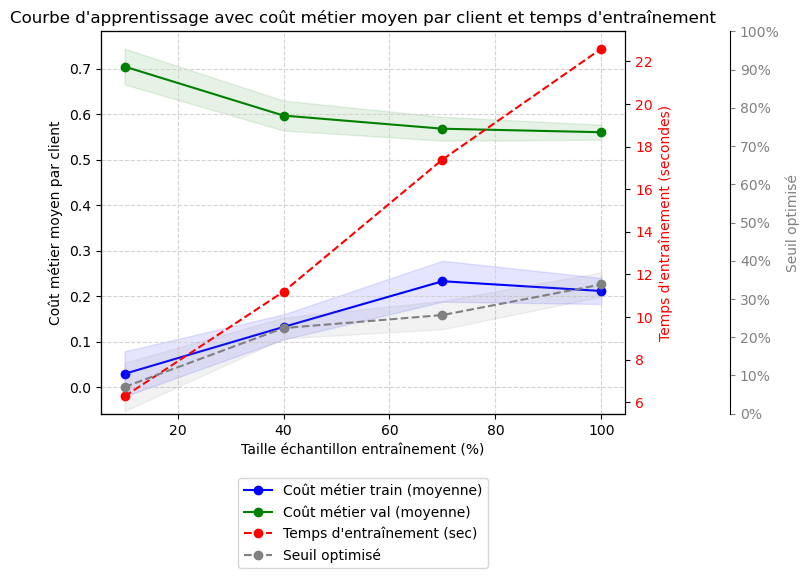

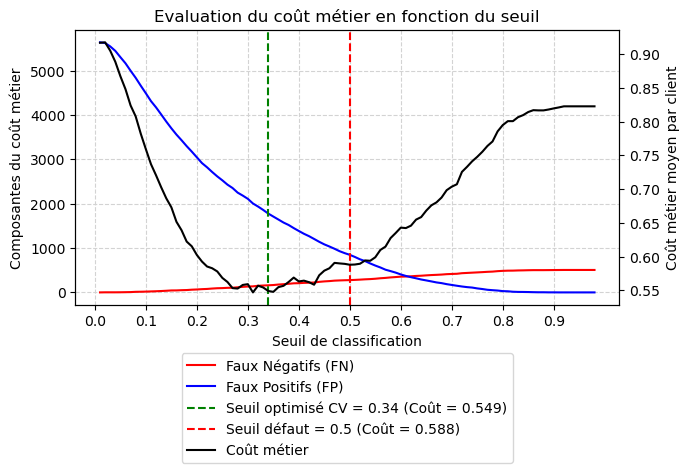

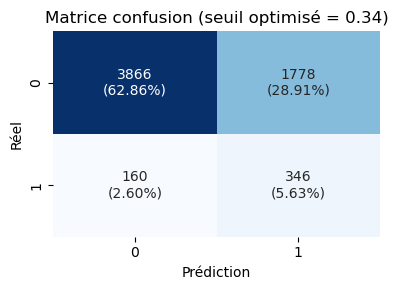

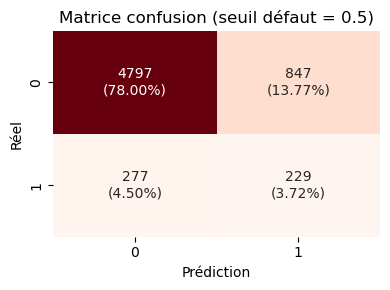

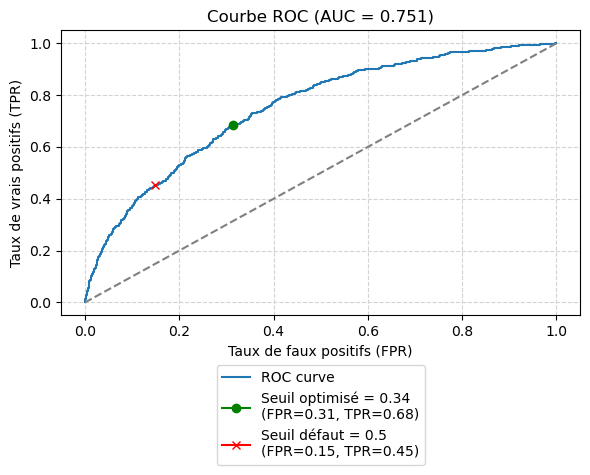

🏃 View run LGBM_Std_10_oversampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/10ee2f9ec4ca4566b4387f0a5fe95298
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


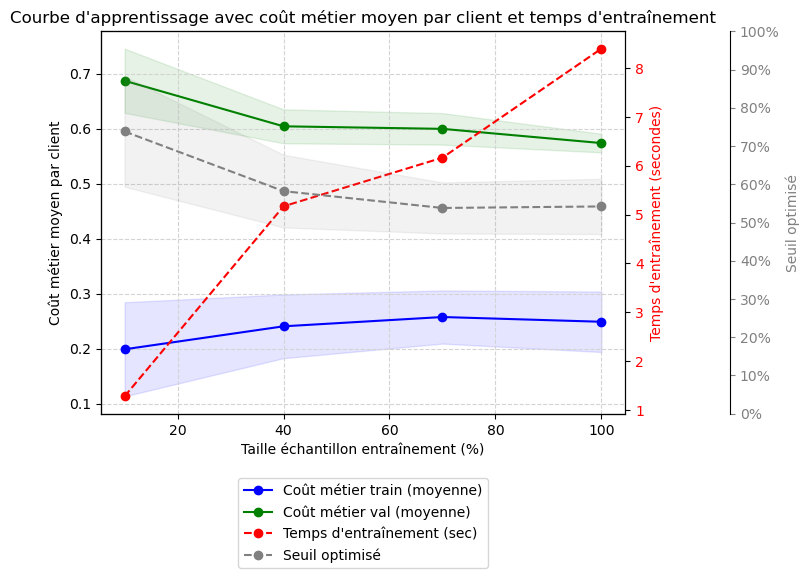

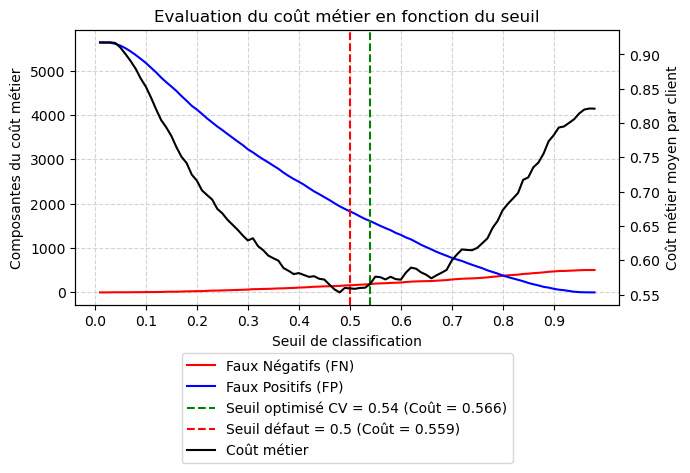

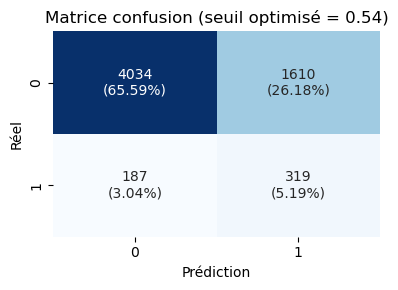

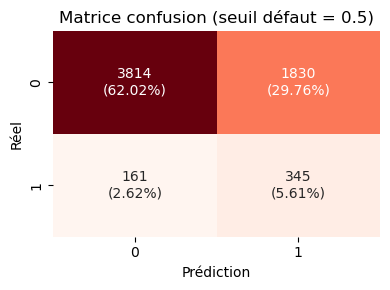

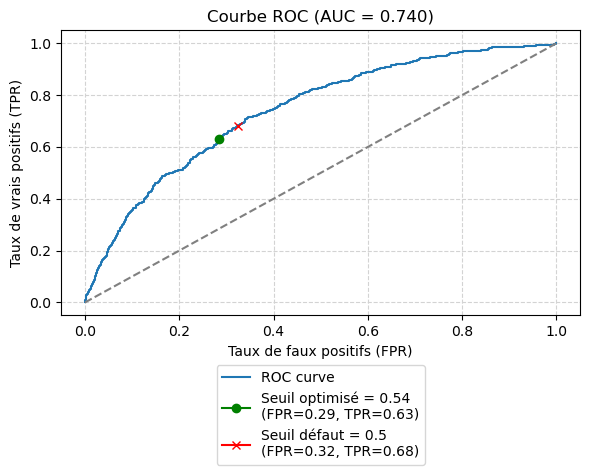

🏃 View run LGBM_Std_10_undersampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/d8989180a5c349c9aaddd132b3a5a24a
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


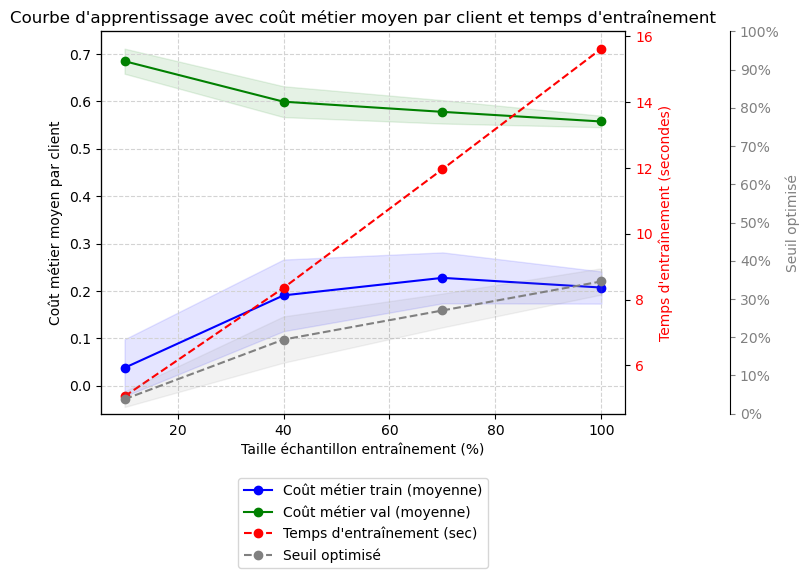

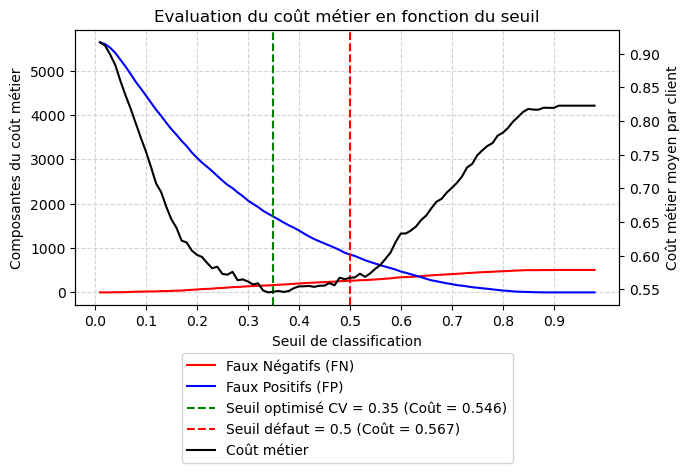

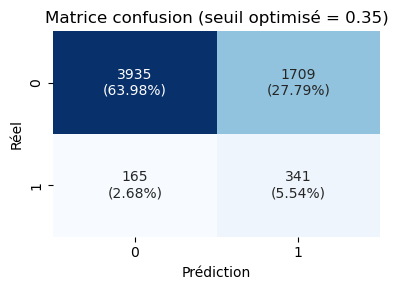

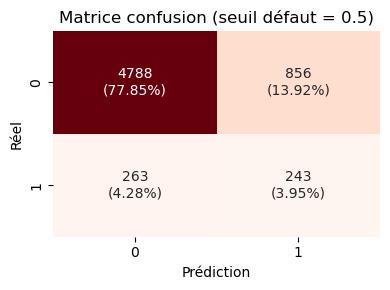

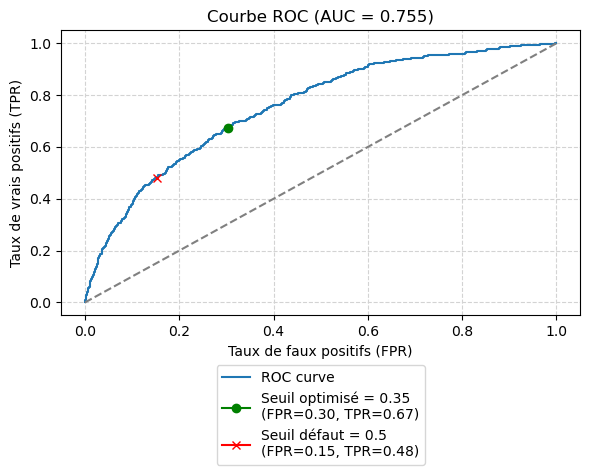

🏃 View run LGBM_Std_10_classweight at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/44aed1ed8eb244aab5f604f334652293
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


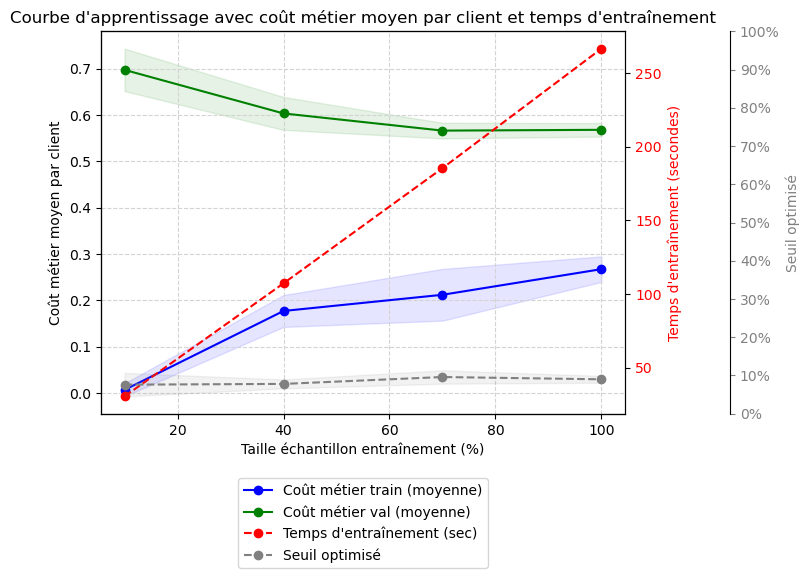

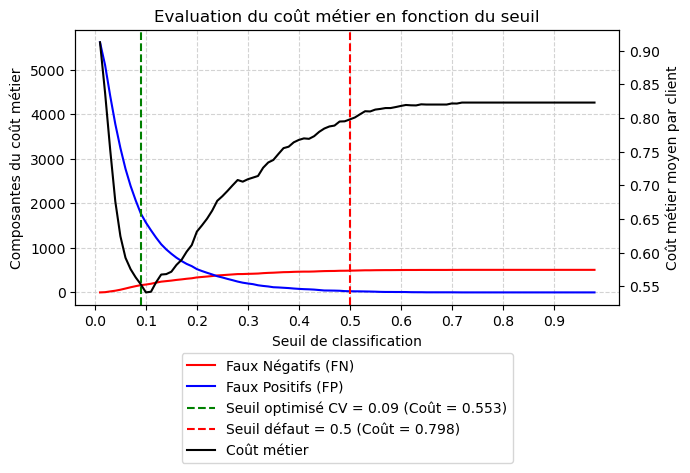

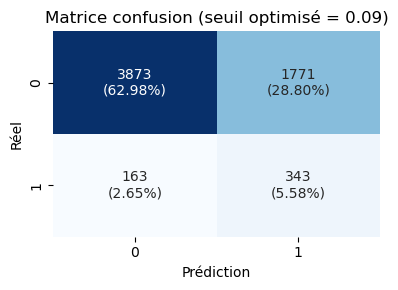

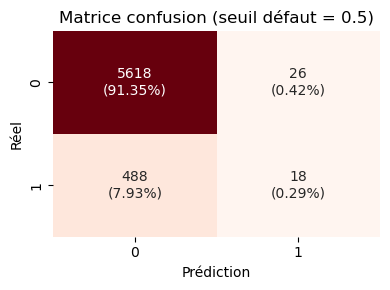

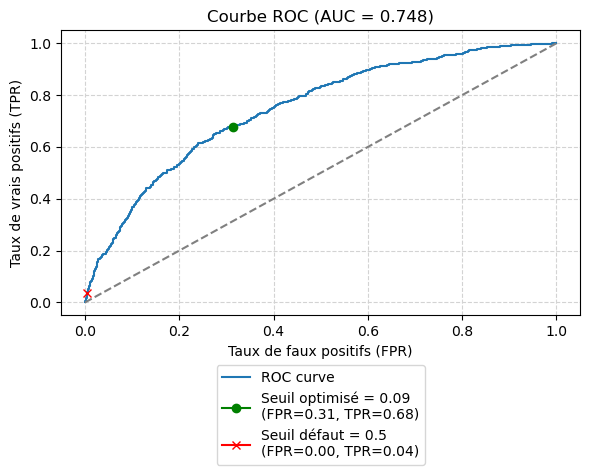

🏃 View run LGBM_Std_10_smote at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/89112760efb142e0915b0a15b1baeef5
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


In [108]:
eval_model_(LGBMs_oversampler, 'LGBM', 'LGBM_Std_10_oversampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LGBMs_undersampler, 'LGBM', 'LGBM_Std_10_undersampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LGBMs_classweight, 'LGBM', 'LGBM_Std_10_classweight', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LGBMs_smote, 'LGBM', 'LGBM_Std_10_smote', X_trainval, y_trainval, X_test, y_test, perf_tableaux)


In [109]:
perf_tableaux

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
0,LGBM,LGBM_Std_10_oversampler,None,0.34,0.032,0.560,0.017,0.603,0.042,0.732,20.7,0.549,0.588,0.039,0.751,6.7
1,LGBM,LGBM_Std_10_undersampler,None,0.54,0.072,0.574,0.017,0.586,0.012,0.727,7.0,0.566,0.559,-0.007,0.740,2.8
2,LGBM,LGBM_Std_10_classweight,None,0.35,0.034,0.558,0.012,0.599,0.042,0.733,14.2,0.546,0.567,0.021,0.755,4.4
3,LGBM,LGBM_Std_10_smote,None,0.09,0.009,0.568,0.015,0.808,0.240,0.729,266.2,0.553,0.798,0.245,0.748,69.0


In [110]:
#Définition des différents pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes 
#pour LogisticRegression
LRs = Pipeline([
    ('scale', StandardScaler()),
     ('model', LogisticRegression(max_iter=5000, random_state=42, verbose=0))
])

LRs_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LogisticRegression(max_iter=5000, random_state=42, verbose=0))
])

LRs_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', LogisticRegression(max_iter=5000, random_state=42, verbose=0))
])

LRs_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTENC(categorical_features=categorical_indices, random_state=42)),
    ('model', LogisticRegression(max_iter=5000, random_state=42, verbose=0))
])

LRs_classweight = Pipeline([
    ('scaler', StandardScaler()),
    ('model', LogisticRegression(max_iter=5000, class_weight='balanced', random_state=42, verbose=0))
])

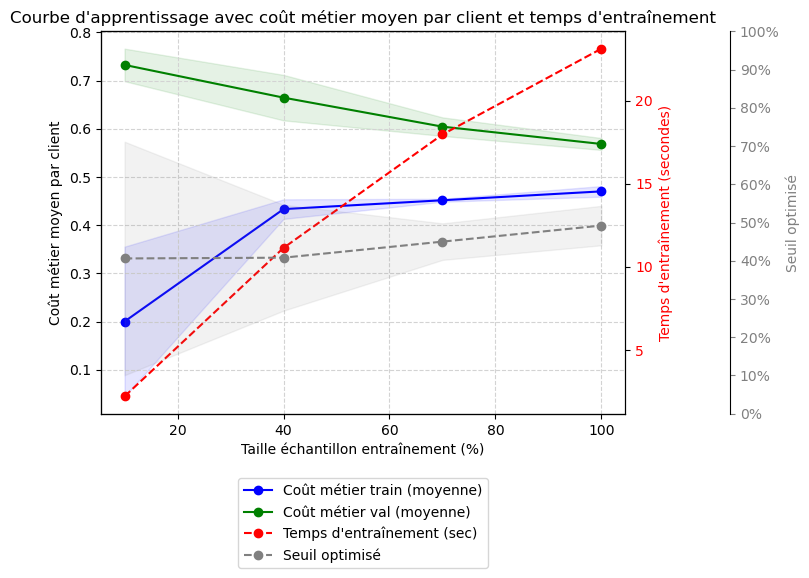

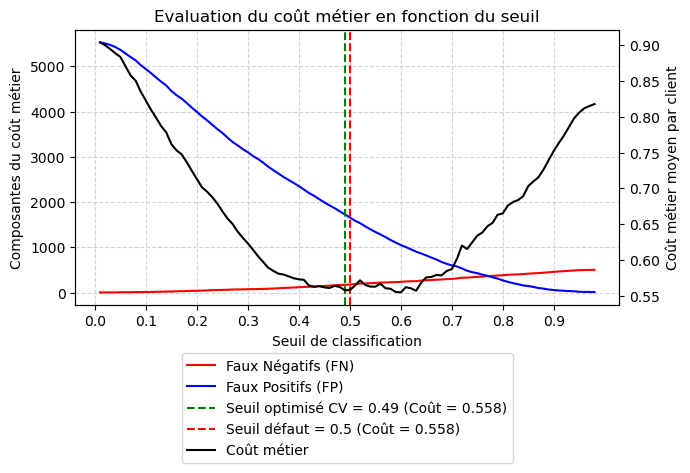

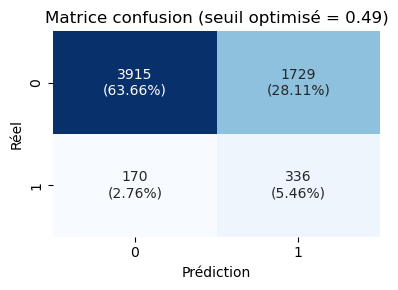

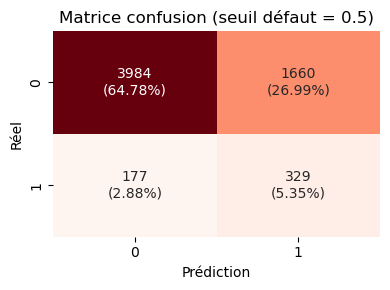

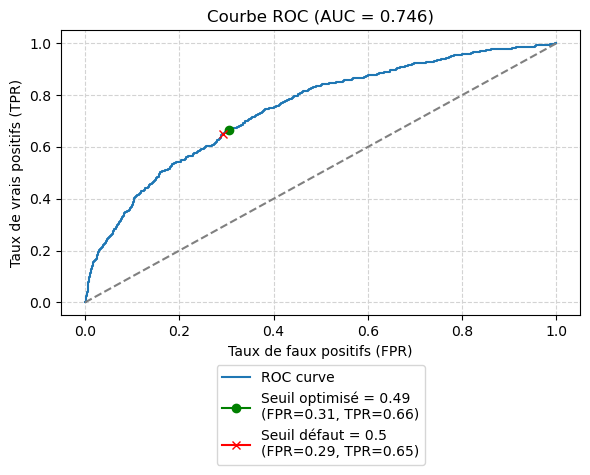

🏃 View run LR_Std_10_oversampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/518f309b4e3f49f88b1b4285b56867f8
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


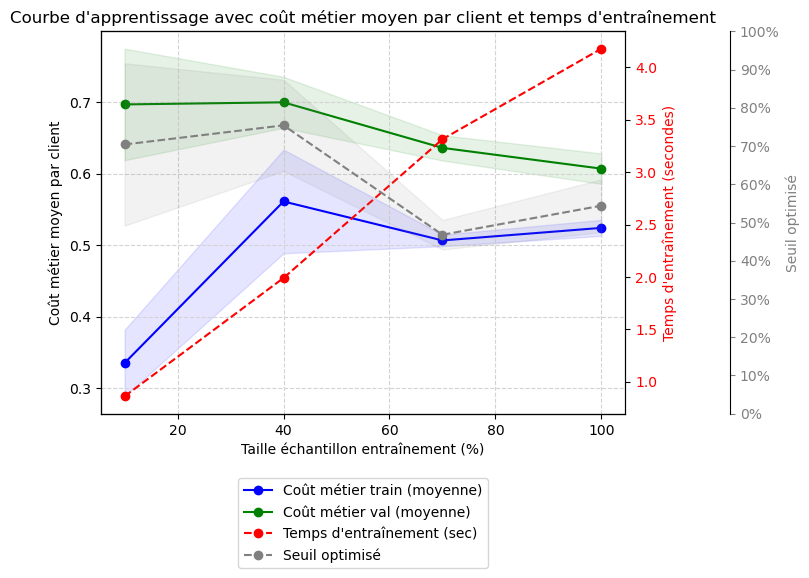

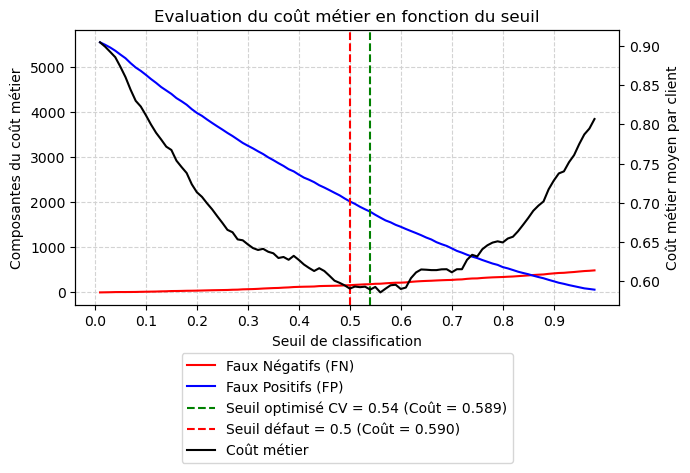

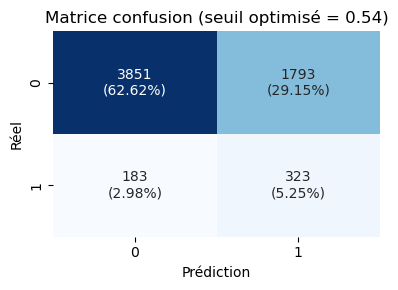

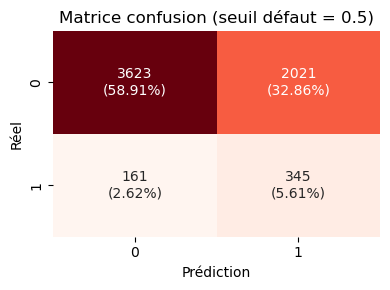

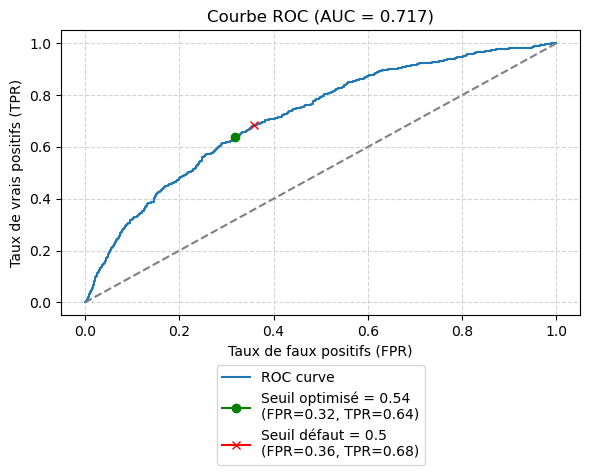

🏃 View run LR_Std_10_undersampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/93e8590d3bcf4267b65c264ff891c8d2
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


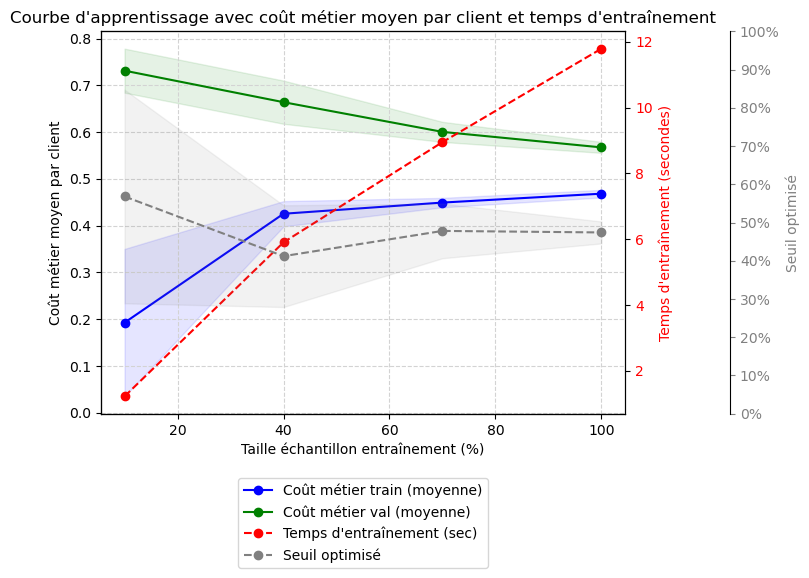

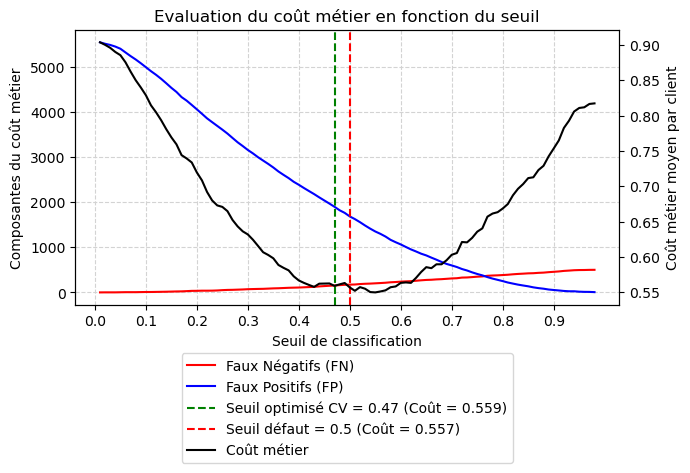

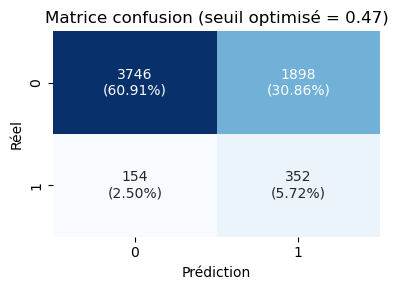

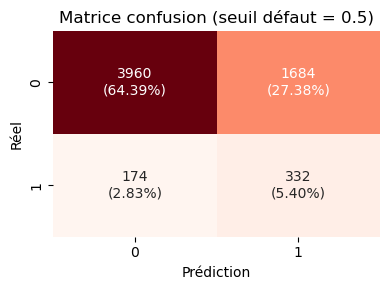

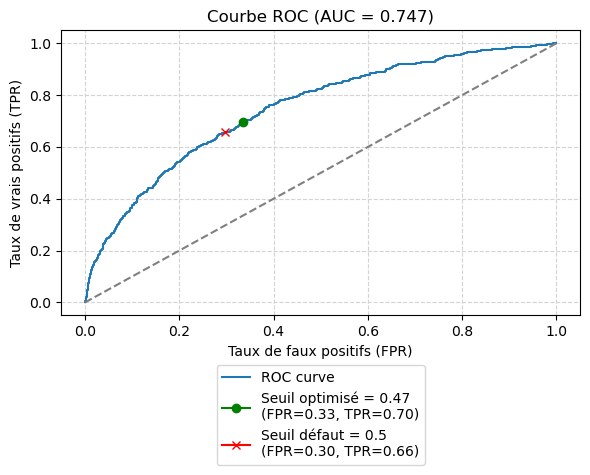

🏃 View run LR_Std_10_classweight at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/5724423a21ca4a3b8ee97a50f717c3d2
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


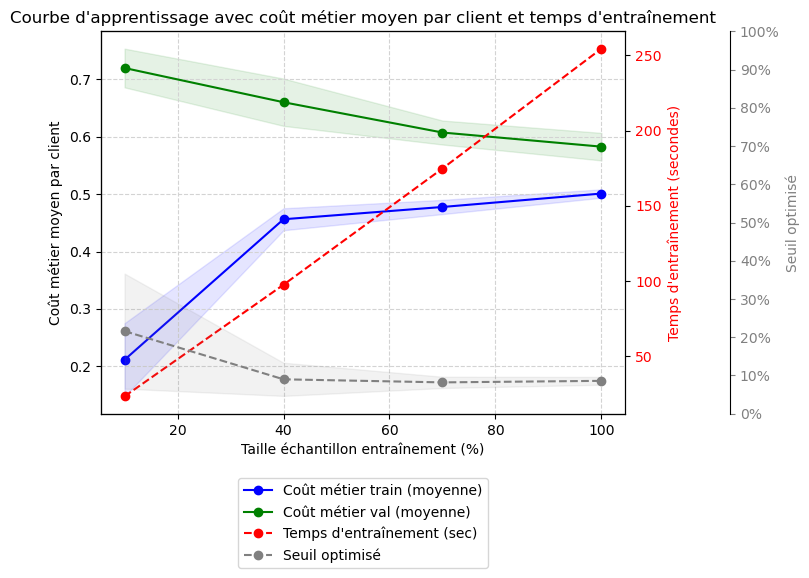

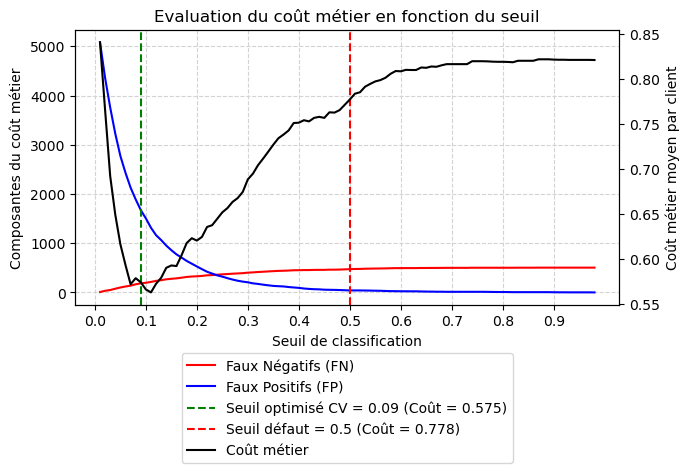

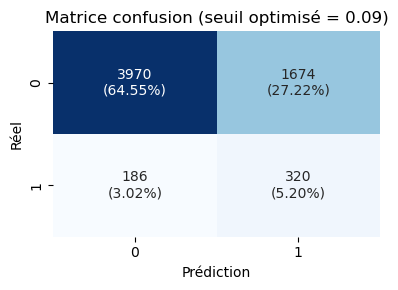

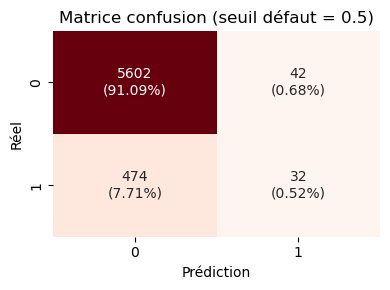

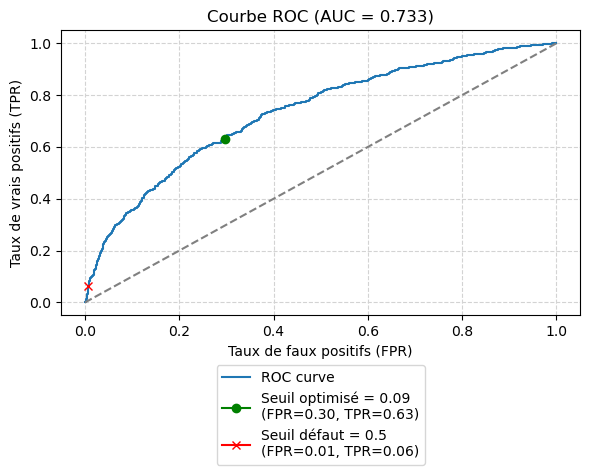

🏃 View run LR_Std_10_smote at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/23c9722ff2cd410691c4b4069716026e
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


In [111]:
#eval_model_(LRs, 'LR', 'LR_Std_10', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LRs_oversampler, 'LR', 'LR_Std_10_oversampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LRs_undersampler, 'LR', 'LR_Std_10_undersampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LRs_classweight, 'LR', 'LR_Std_10_classweight', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LRs_smote, 'LR', 'LR_Std_10_smote', X_trainval, y_trainval, X_test, y_test, perf_tableaux)


In [112]:
perf_tableaux

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
0,LGBM,LGBM_Std_10_oversampler,None,0.34,0.032,0.560,0.017,0.603,0.042,0.732,20.7,0.549,0.588,0.039,0.751,6.7
1,LGBM,LGBM_Std_10_undersampler,None,0.54,0.072,0.574,0.017,0.586,0.012,0.727,7.0,0.566,0.559,-0.007,0.740,2.8
2,LGBM,LGBM_Std_10_classweight,None,0.35,0.034,0.558,0.012,0.599,0.042,0.733,14.2,0.546,0.567,0.021,0.755,4.4
3,LGBM,LGBM_Std_10_smote,None,0.09,0.009,0.568,0.015,0.808,0.240,0.729,266.2,0.553,0.798,0.245,0.748,69.0
4,LR,LR_Std_10_oversampler,None,0.49,0.052,0.568,0.012,0.575,0.007,0.720,22.7,0.558,0.558,0.000,0.746,8.7
5,LR,LR_Std_10_undersampler,None,0.54,0.069,0.607,0.021,0.612,0.005,0.697,3.5,0.589,0.590,0.001,0.717,2.3
6,LR,LR_Std_10_classweight,None,0.47,0.029,0.567,0.012,0.576,0.009,0.723,11.5,0.559,0.557,-0.002,0.747,4.2
7,LR,LR_Std_10_smote,None,0.09,0.010,0.583,0.024,0.784,0.202,0.710,254.6,0.575,0.778,0.203,0.733,66.7


In [113]:
#Définition des différents pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes 
#pour RandomForest
RFs = Pipeline([
    ('scale', StandardScaler()),
     ('model', RandomForestClassifier(random_state=42, verbose=0))
])

RFs_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', RandomForestClassifier(random_state=42, verbose=0))
])

RFs_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', RandomForestClassifier(random_state=42, verbose=0))
])

RFs_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTENC(categorical_features=categorical_indices, random_state=42)),
    ('model', RandomForestClassifier(random_state=42, verbose=0))
])

RFs_classweight = Pipeline([
    ('scaler', StandardScaler()),
    ('model', RandomForestClassifier(class_weight='balanced', random_state=42, verbose=0))
])

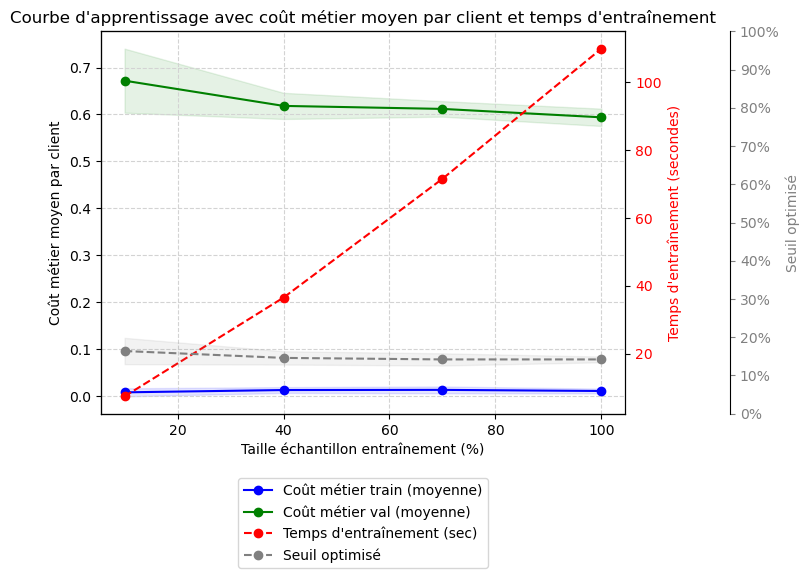

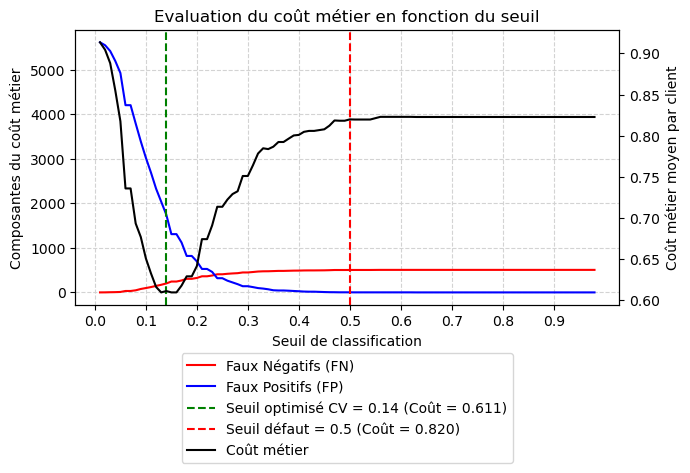

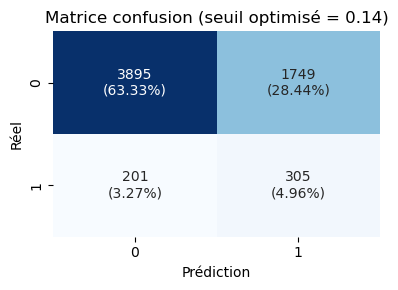

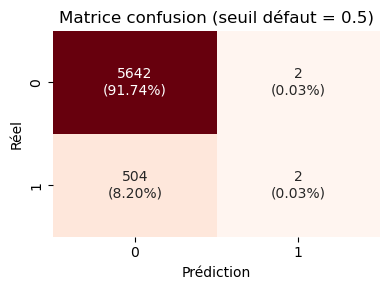

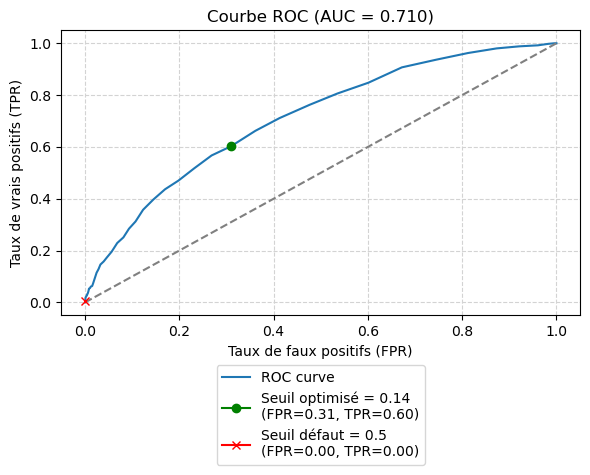

🏃 View run RF_Std_10_oversampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/67107f1595f4443cb4d0dec01ab52aca
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


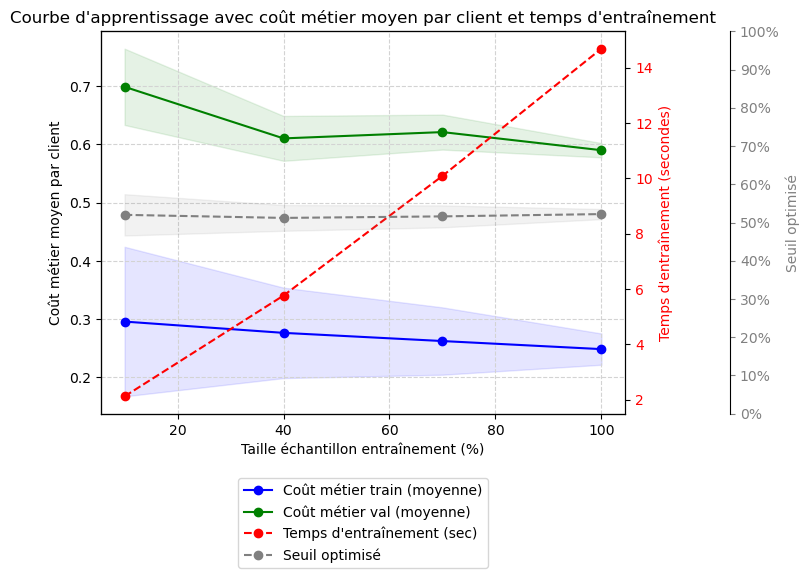

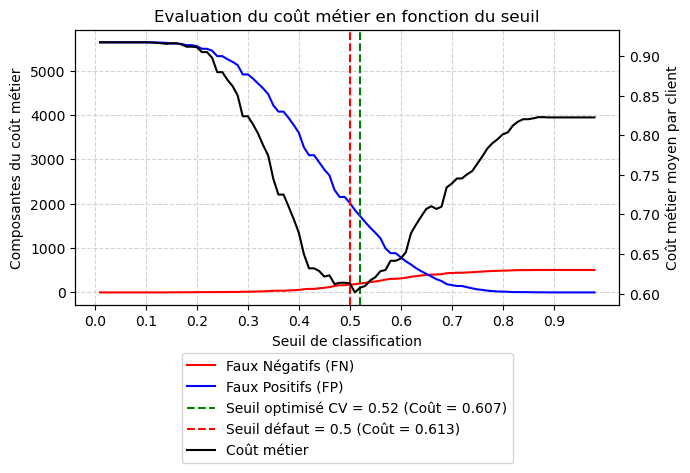

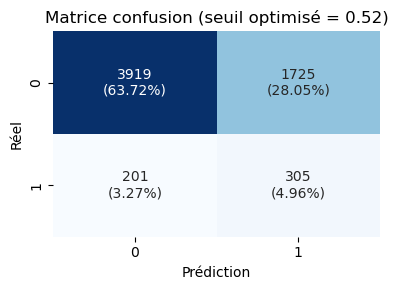

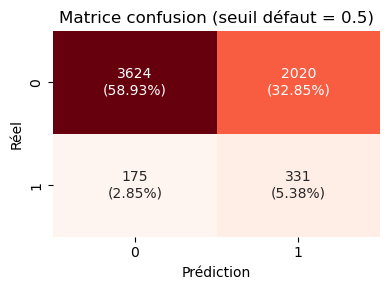

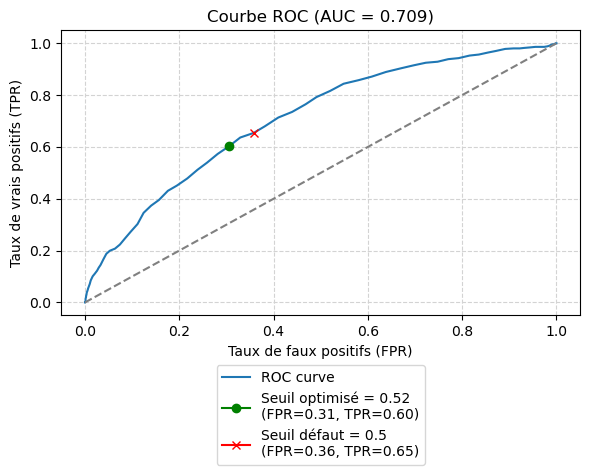

🏃 View run RF_Std_10_undersampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/de3b04ac610a4d279c18ec17a2f8a8a1
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


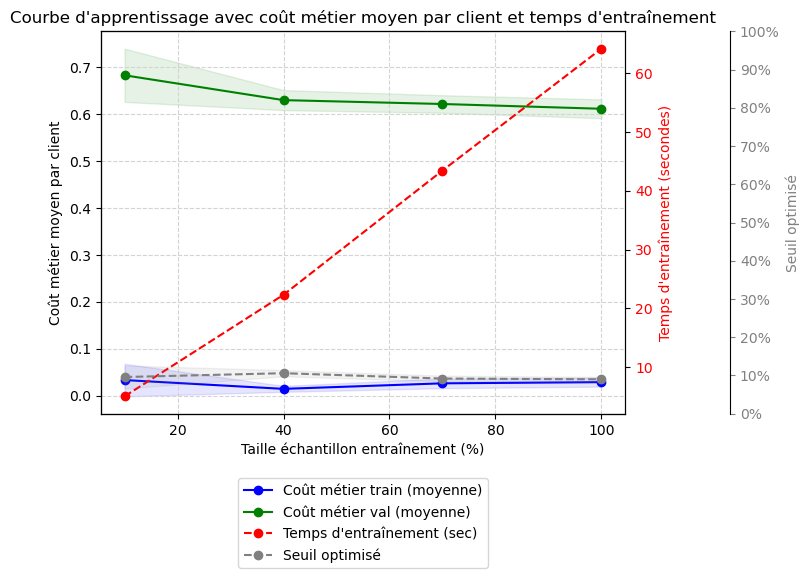

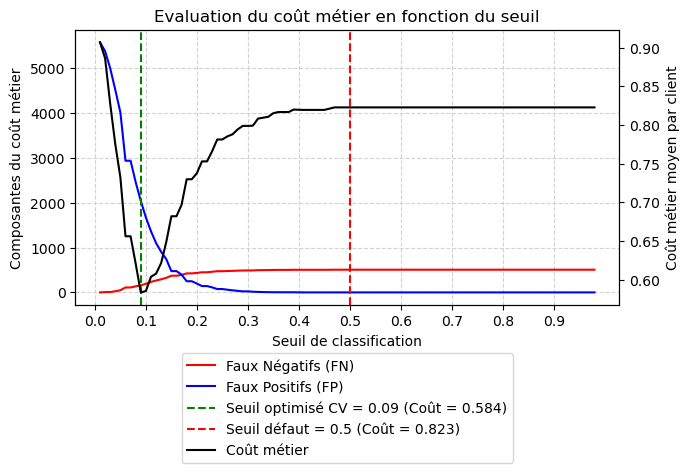

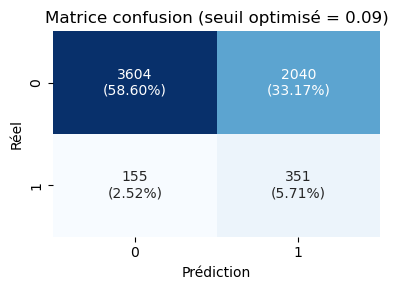

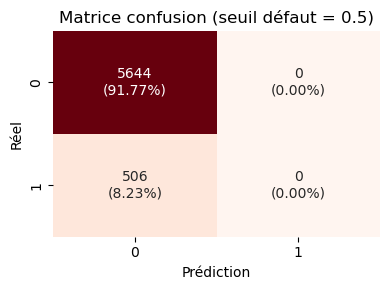

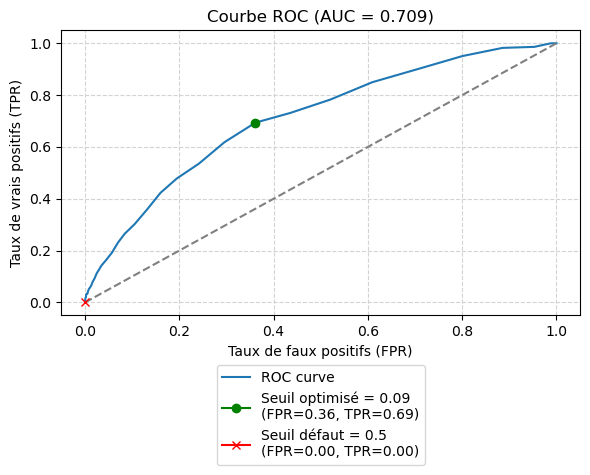

🏃 View run RF_Std_10_classweight at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/7007d05017a846528e6206a5ba7769e8
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


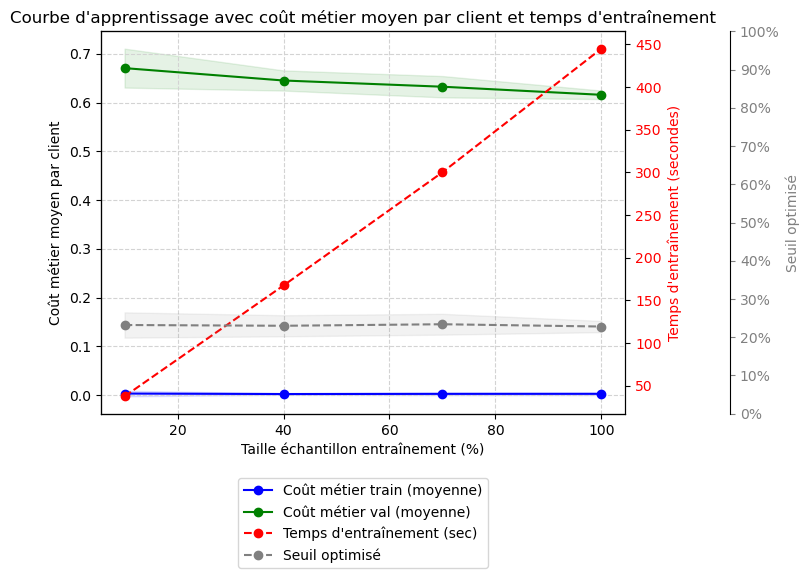

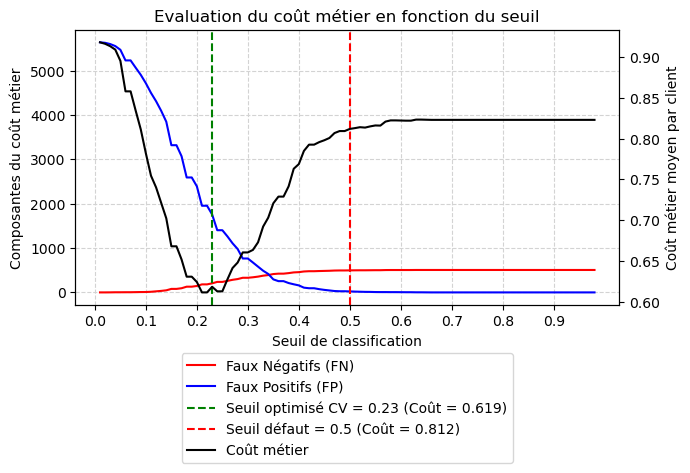

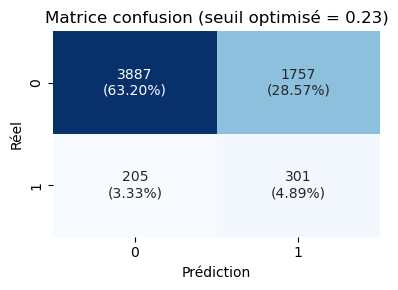

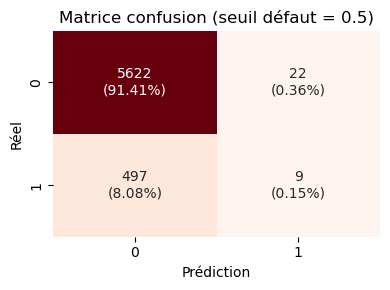

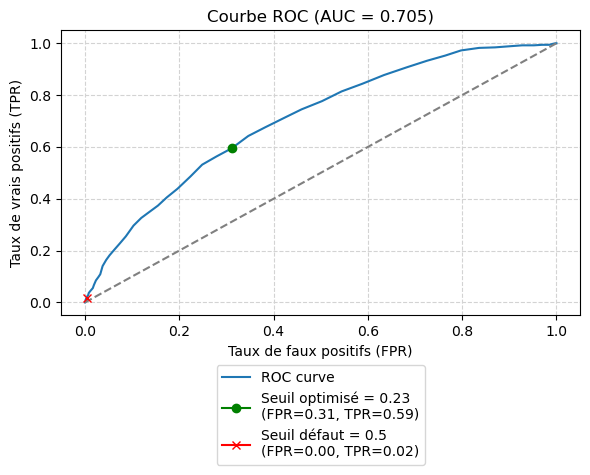

🏃 View run RF_Std_10_smote at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/4880235895c145f486d6be4978818d78
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


In [114]:
eval_model_(RFs_oversampler, 'RF', 'RF_Std_10_oversampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(RFs_undersampler, 'RF', 'RF_Std_10_undersampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(RFs_classweight, 'RF', 'RF_Std_10_classweight', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(RFs_smote, 'RF', 'RF_Std_10_smote', X_trainval, y_trainval, X_test, y_test, perf_tableaux)

In [130]:
perf_tableaux

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
0,LGBM,LGBM_Std_10_oversampler,None,0.34,0.032,0.560,0.017,0.603,0.042,0.732,20.7,0.549,0.588,0.039,0.751,6.7
1,LGBM,LGBM_Std_10_undersampler,None,0.54,0.072,0.574,0.017,0.586,0.012,0.727,7.0,0.566,0.559,-0.007,0.740,2.8
2,LGBM,LGBM_Std_10_classweight,None,0.35,0.034,0.558,0.012,0.599,0.042,0.733,14.2,0.546,0.567,0.021,0.755,4.4
3,LGBM,LGBM_Std_10_smote,None,0.09,0.009,0.568,0.015,0.808,0.240,0.729,266.2,0.553,0.798,0.245,0.748,69.0
4,LR,LR_Std_10_oversampler,None,0.49,0.052,0.568,0.012,0.575,0.007,0.720,22.7,0.558,0.558,0.000,0.746,8.7
5,LR,LR_Std_10_undersampler,None,0.54,0.069,0.607,0.021,0.612,0.005,0.697,3.5,0.589,0.590,0.001,0.717,2.3
6,LR,LR_Std_10_classweight,None,0.47,0.029,0.567,0.012,0.576,0.009,0.723,11.5,0.559,0.557,-0.002,0.747,4.2
7,LR,LR_Std_10_smote,None,0.09,0.010,0.583,0.024,0.784,0.202,0.710,254.6,0.575,0.778,0.203,0.733,66.7
8,RF,RF_Std_10_oversampler,None,0.14,0.007,0.594,0.018,0.821,0.228,0.708,106.3,0.611,0.820,0.209,0.710,30.5
9,RF,RF_Std_10_undersampler,None,0.52,0.013,0.590,0.012,0.597,0.007,0.715,12.1,0.607,0.613,0.006,0.709,5.0


In [116]:
#Définition des différents pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes 
#pour XGBoost
XGBs = Pipeline([
    ('scale', StandardScaler()),
     ('model', XGBClassifier(random_state=42, verbosity=0))
])

XGBs_oversampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', XGBClassifier(random_state=42, verbosity=0))
])

XGBs_undersampler = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', XGBClassifier(random_state=42, verbosity=0))
])

XGBs_smote = imbpipeline([
    ('scaler', StandardScaler()),
    ('balance', SMOTENC(categorical_features=categorical_indices, random_state=42)),
    ('model', XGBClassifier(random_state=42, verbosity=0))
])

#equivalent à class_weight
scale_pos_weight = (y_train == 0).sum() / (y_train == 1).sum()
XGBs_classweight = Pipeline([
    ('scaler', StandardScaler()),
    ('model', XGBClassifier(scale_pos_weight=scale_pos_weight, use_label_encoder=False, eval_metric='logloss', random_state=42, verbosity=0))
])

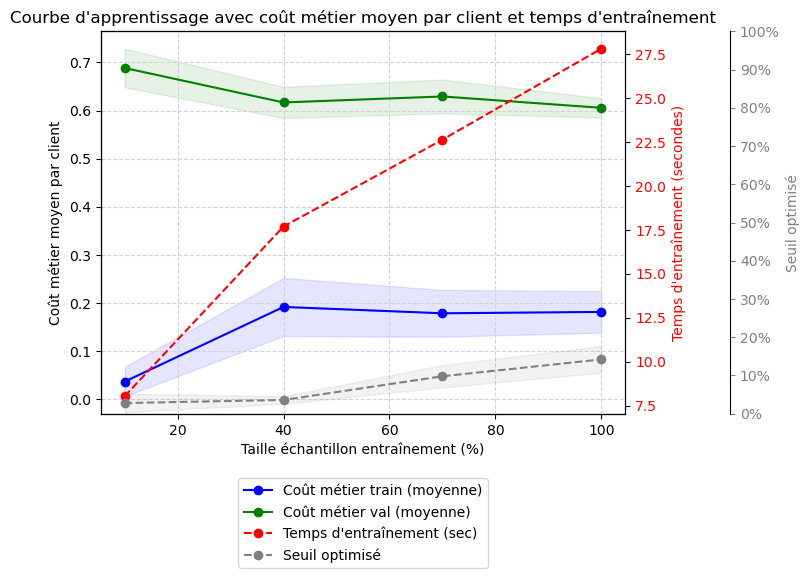

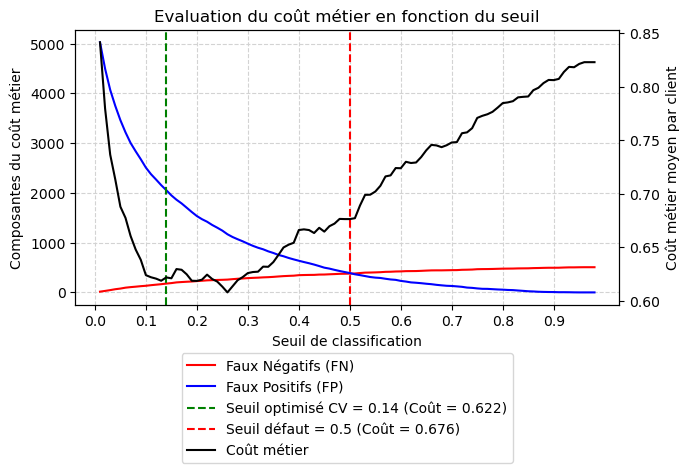

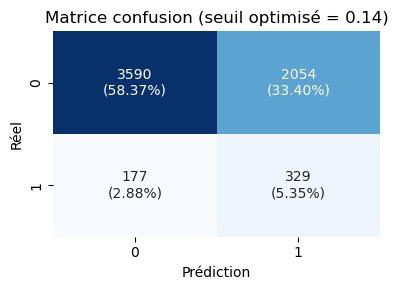

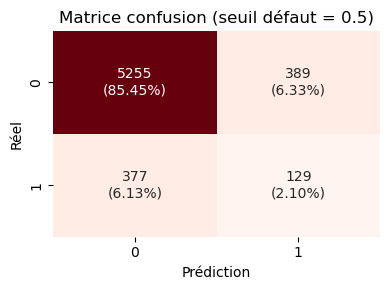

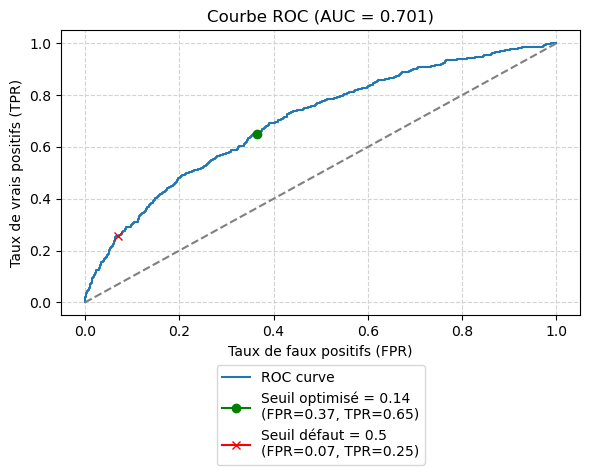

🏃 View run XGB_Std_10_oversampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/f0e2bc154b6d422abc6cc7258eecfb35
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


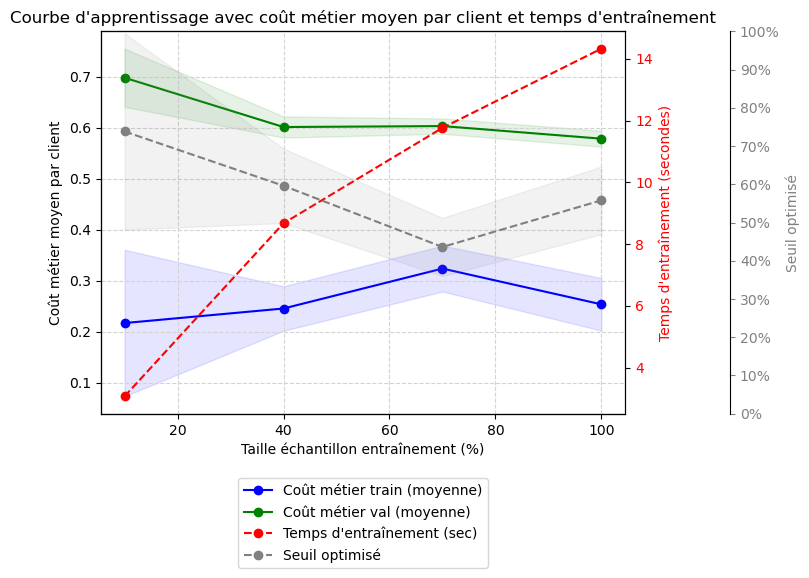

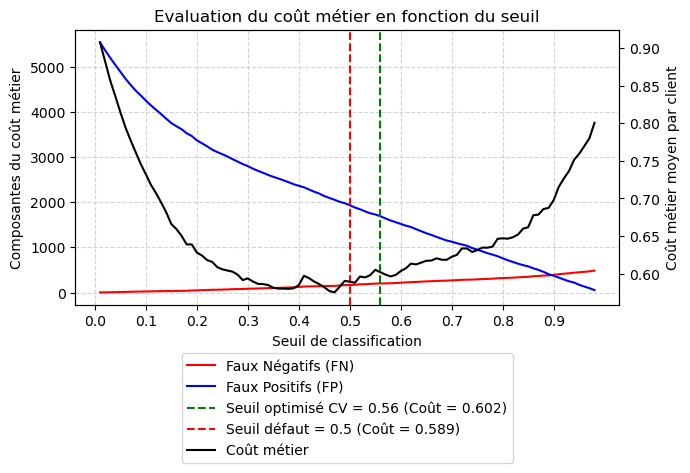

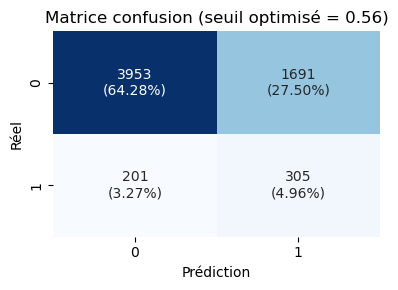

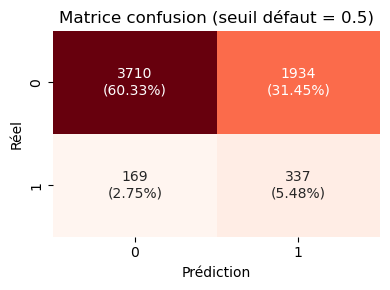

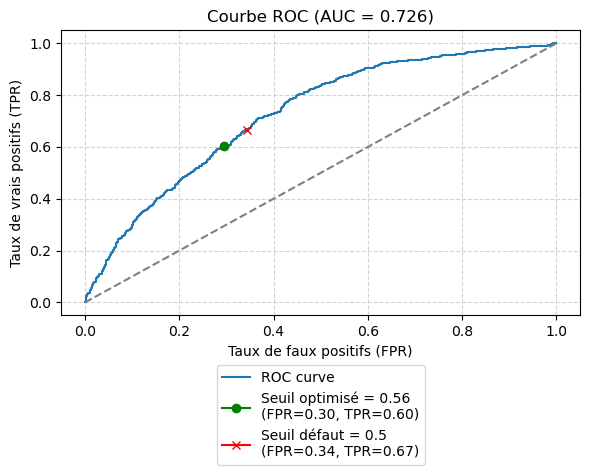

🏃 View run XGB_Std_10_undersampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/d80f8224be8d49eea2ccff69e3155508
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


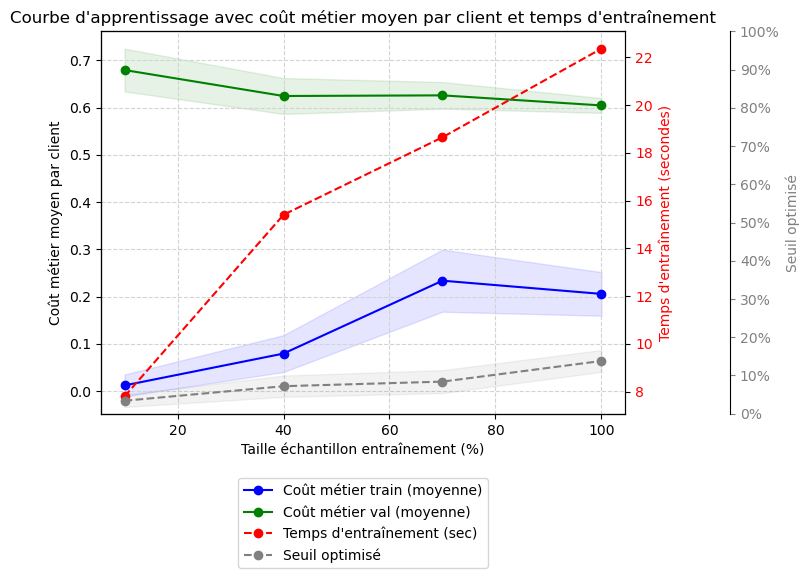

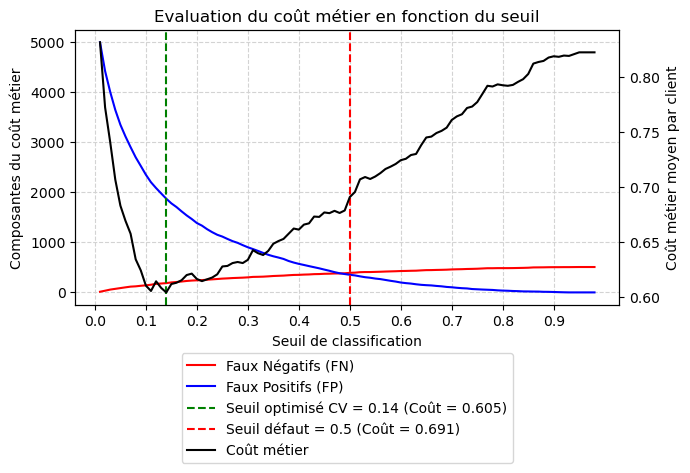

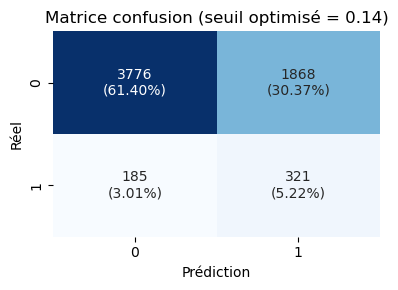

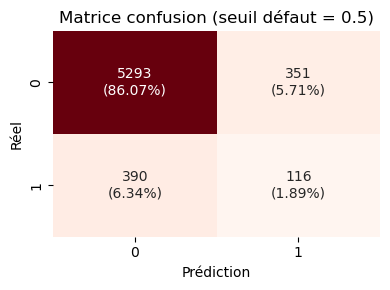

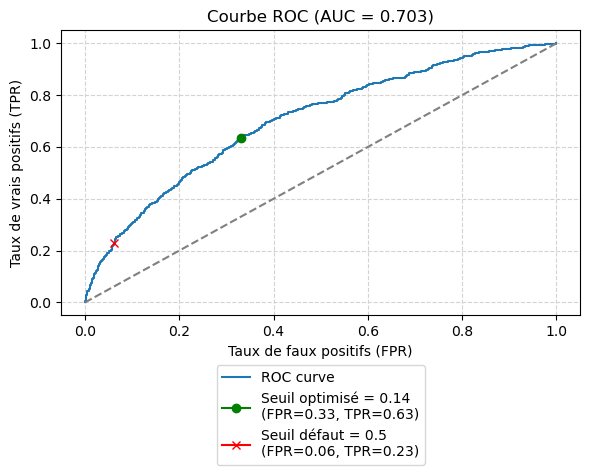

🏃 View run XGB_Std_10_classweight at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/acbdd68cfd814630909fe3c8daad0aee
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


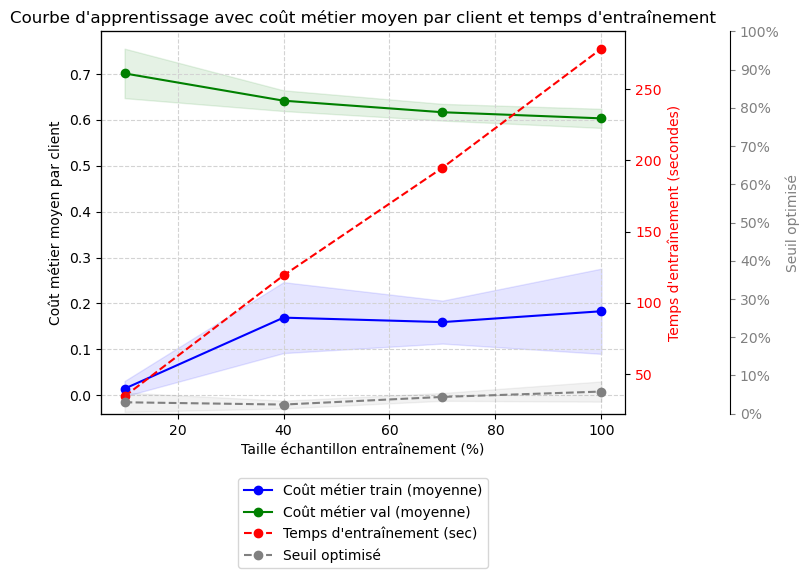

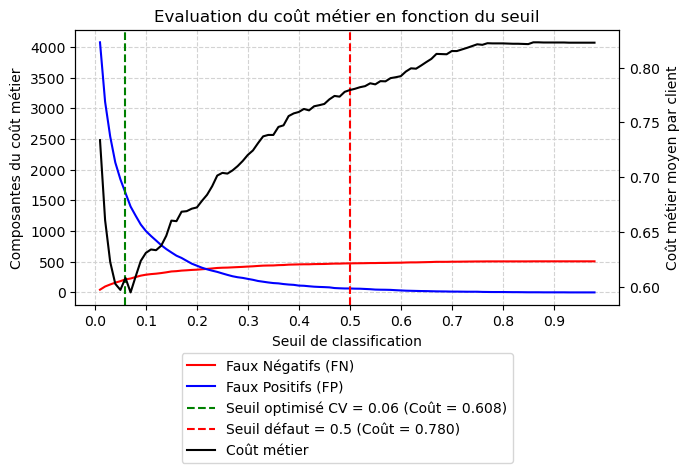

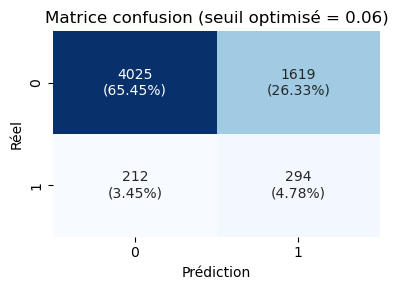

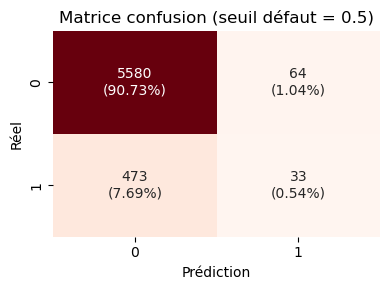

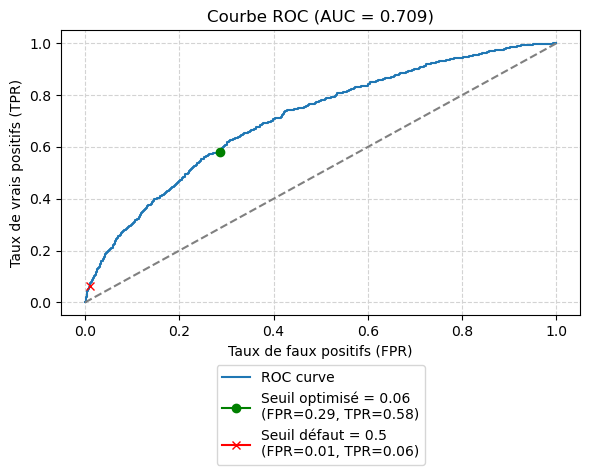

🏃 View run XGB_Std_10_smote at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/629d145e632d418c90e5be70746137d8
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


In [117]:
eval_model_(XGBs_oversampler, 'XGB', 'XGB_Std_10_oversampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(XGBs_undersampler, 'XGB', 'XGB_Std_10_undersampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(XGBs_classweight, 'XGB', 'XGB_Std_10_classweight', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(XGBs_smote, 'XGB', 'XGB_Std_10_smote', X_trainval, y_trainval, X_test, y_test, perf_tableaux)

In [132]:
perf_tableaux

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
0,LGBM,LGBM_Std_10_oversampler,None,0.34,0.032,0.560,0.017,0.603,0.042,0.732,20.7,0.549,0.588,0.039,0.751,6.7
1,LGBM,LGBM_Std_10_undersampler,None,0.54,0.072,0.574,0.017,0.586,0.012,0.727,7.0,0.566,0.559,-0.007,0.740,2.8
2,LGBM,LGBM_Std_10_classweight,None,0.35,0.034,0.558,0.012,0.599,0.042,0.733,14.2,0.546,0.567,0.021,0.755,4.4
3,LGBM,LGBM_Std_10_smote,None,0.09,0.009,0.568,0.015,0.808,0.240,0.729,266.2,0.553,0.798,0.245,0.748,69.0
4,LR,LR_Std_10_oversampler,None,0.49,0.052,0.568,0.012,0.575,0.007,0.720,22.7,0.558,0.558,0.000,0.746,8.7
5,LR,LR_Std_10_undersampler,None,0.54,0.069,0.607,0.021,0.612,0.005,0.697,3.5,0.589,0.590,0.001,0.717,2.3
6,LR,LR_Std_10_classweight,None,0.47,0.029,0.567,0.012,0.576,0.009,0.723,11.5,0.559,0.557,-0.002,0.747,4.2
7,LR,LR_Std_10_smote,None,0.09,0.010,0.583,0.024,0.784,0.202,0.710,254.6,0.575,0.778,0.203,0.733,66.7
8,RF,RF_Std_10_oversampler,None,0.14,0.007,0.594,0.018,0.821,0.228,0.708,106.3,0.611,0.820,0.209,0.710,30.5
9,RF,RF_Std_10_undersampler,None,0.52,0.013,0.590,0.012,0.597,0.007,0.715,12.1,0.607,0.613,0.006,0.709,5.0


In [134]:
perf_tableaux.sort_values(by = ["model","eval_cout_metier_optimal","eval_gain"], ascending = [True,True, False]).head(40)

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
2,LGBM,LGBM_Std_10_classweight,None,0.35,0.034,0.558,0.012,0.599,0.042,0.733,14.2,0.546,0.567,0.021,0.755,4.4
0,LGBM,LGBM_Std_10_oversampler,None,0.34,0.032,0.560,0.017,0.603,0.042,0.732,20.7,0.549,0.588,0.039,0.751,6.7
3,LGBM,LGBM_Std_10_smote,None,0.09,0.009,0.568,0.015,0.808,0.240,0.729,266.2,0.553,0.798,0.245,0.748,69.0
1,LGBM,LGBM_Std_10_undersampler,None,0.54,0.072,0.574,0.017,0.586,0.012,0.727,7.0,0.566,0.559,-0.007,0.740,2.8
4,LR,LR_Std_10_oversampler,None,0.49,0.052,0.568,0.012,0.575,0.007,0.720,22.7,0.558,0.558,0.000,0.746,8.7
6,LR,LR_Std_10_classweight,None,0.47,0.029,0.567,0.012,0.576,0.009,0.723,11.5,0.559,0.557,-0.002,0.747,4.2
7,LR,LR_Std_10_smote,None,0.09,0.010,0.583,0.024,0.784,0.202,0.710,254.6,0.575,0.778,0.203,0.733,66.7
5,LR,LR_Std_10_undersampler,None,0.54,0.069,0.607,0.021,0.612,0.005,0.697,3.5,0.589,0.590,0.001,0.717,2.3
10,RF,RF_Std_10_classweight,None,0.09,0.006,0.612,0.020,0.823,0.212,0.700,61.5,0.584,0.823,0.239,0.709,17.6
9,RF,RF_Std_10_undersampler,None,0.52,0.013,0.590,0.012,0.597,0.007,0.715,12.1,0.607,0.613,0.006,0.709,5.0


In [355]:
perf_tableaux.drop(columns="Model_prefix", inplace=True)

Classement retenu par modèle avec normalisation=StandardScaler et équilibrage :
- 1 : LGBM_Std_classweight : cout_metier_client=0.546 - roc_auc=0.755 - time_fit_cv=14.2sec - seuil optimisé=0.35
- 2 : LR_Std_oversampler : cout_metier_client=0.558 - roc_auc=0.746 - time_fit_cv=22.7	sec - seuil optimisé=0.49
- 3 : RF_Std_classweight : cout_metier_client=0.584 - roc_auc=0.709 - time_fit_cv=61.5sec - seuil optimisé=0.09
- 4 : XGB_Std_undersampler : cout_metier_client=0.602 - roc_auc=0.726 - time_fit_cv=13.0sec - seuil optimisé=0.56

In [292]:
df_best_perf = pd.DataFrame()
row_index = df_best_perf.shape[0]
df_best_perf.loc[row_index, 'Model'] = "LGBM"
df_best_perf.loc[row_index, 'Normalisation'] = "StandardScaler"
df_best_perf.loc[row_index, 'Equilibrage'] = "classweight"
df_best_perf.loc[row_index, 'Configuration'] = "LGBM_Std_classweight"
df_best_perf.loc[row_index, 'Echantillon'] = "10%"
df_best_perf.loc[row_index, 'Cout Metier client'] = 0.546
df_best_perf.loc[row_index, 'Seuil optimisé'] =  0.35
df_best_perf.loc[row_index, 'ROC_AUC'] = 0.755
df_best_perf.loc[row_index, 'Time Train cv (sec)'] = 14.2
row_index+=1
df_best_perf.loc[row_index, 'Model'] = "LR"
df_best_perf.loc[row_index, 'Normalisation'] = "StandardScaler"
df_best_perf.loc[row_index, 'Equilibrage'] = "oversampler"
df_best_perf.loc[row_index, 'Configuration'] = "LR_Std_oversampler"
df_best_perf.loc[row_index, 'Echantillon'] = "10%"
df_best_perf.loc[row_index, 'Cout Metier client'] = 0.558
df_best_perf.loc[row_index, 'Seuil optimisé'] =  0.49
df_best_perf.loc[row_index, 'ROC_AUC'] = 0.746
df_best_perf.loc[row_index, 'Time Train cv (sec)'] = 22.7
row_index+=1
df_best_perf.loc[row_index, 'Model'] = "RF"
df_best_perf.loc[row_index, 'Normalisation'] = "StandardScaler"
df_best_perf.loc[row_index, 'Equilibrage'] = "classweight"
df_best_perf.loc[row_index, 'Configuration'] = "RF_Std_classweight"
df_best_perf.loc[row_index, 'Echantillon'] = "10%"
df_best_perf.loc[row_index, 'Cout Metier client'] = 0.584
df_best_perf.loc[row_index, 'Seuil optimisé'] =  0.09
df_best_perf.loc[row_index, 'ROC_AUC'] = 0.709
df_best_perf.loc[row_index, 'Time Train cv (sec)'] = 61.5
row_index+=1
df_best_perf.loc[row_index, 'Model'] = "XGB"
df_best_perf.loc[row_index, 'Normalisation'] = "StandardScaler"
df_best_perf.loc[row_index, 'Equilibrage'] = "undersampler"
df_best_perf.loc[row_index, 'Configuration'] = "XGB_Std_undersampler"
df_best_perf.loc[row_index, 'Echantillon'] = "10%"
df_best_perf.loc[row_index, 'Cout Metier client'] = 0.602
df_best_perf.loc[row_index, 'Seuil optimisé'] =  0.56
df_best_perf.loc[row_index, 'ROC_AUC'] = 0.726
df_best_perf.loc[row_index, 'Time Train cv (sec)'] = 13.0
row_index+=1

In [294]:
df_best_perf

,Model,Normalisation,Equilibrage,Configuration,Echantillon,Cout Metier client,Seuil optimisé,ROC_AUC,Time Train cv (sec)
0,LGBM,StandardScaler,classweight,LGBM_Std_classweight,10%,0.546,0.35,0.755,14.2
1,LR,StandardScaler,oversampler,LR_Std_oversampler,10%,0.558,0.49,0.746,22.7
2,RF,StandardScaler,classweight,RF_Std_classweight,10%,0.584,0.09,0.709,61.5
3,XGB,StandardScaler,undersampler,XGB_Std_undersampler,10%,0.602,0.56,0.726,13.0


In [153]:
#Définition des différents pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes 
#pour LGBM
LGBMm = Pipeline([
    ('scale', MinMaxScaler()),
     ('model', LGBMClassifier(random_state=42, verbose=-1))
])

LGBMm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LGBMClassifier(random_state=42, verbose=-1))
])

LGBMm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', LGBMClassifier(random_state=42, verbose=-1))
])

LGBMm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTENC(categorical_features=categorical_indices, n_jobs=-1, random_state=42)),
    ('model', LGBMClassifier(random_state=42, n_jobs=-1, verbose=-1))
])

LGBMm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LGBMClassifier(class_weight='balanced', random_state=42, verbose=-1))
])

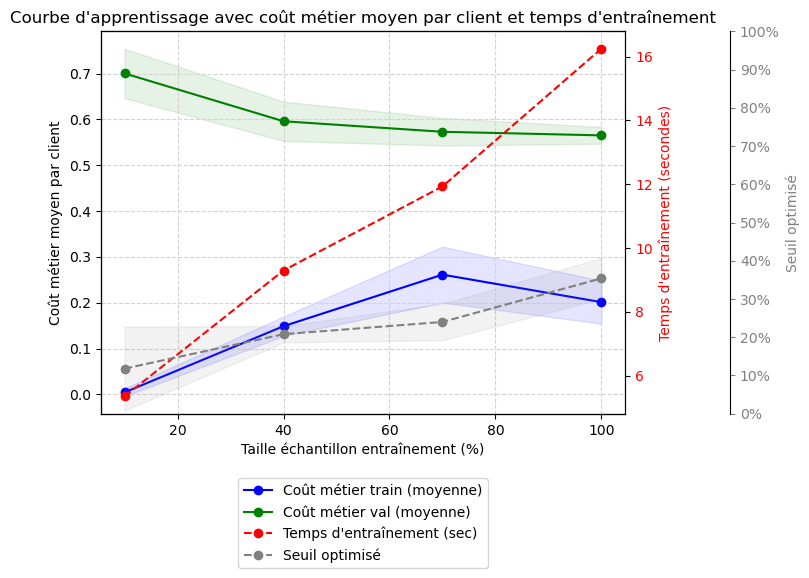

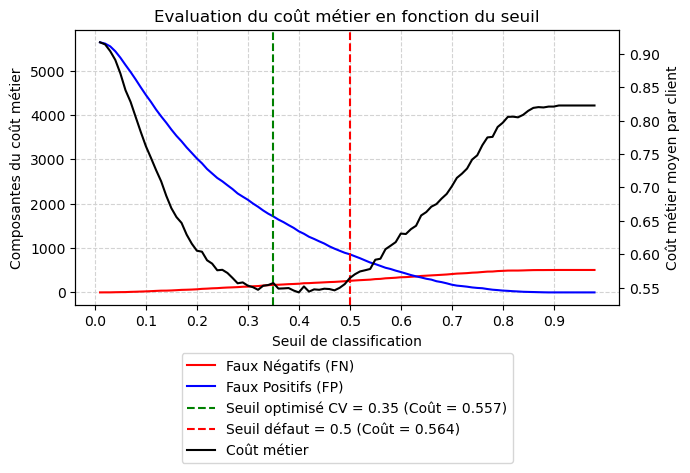

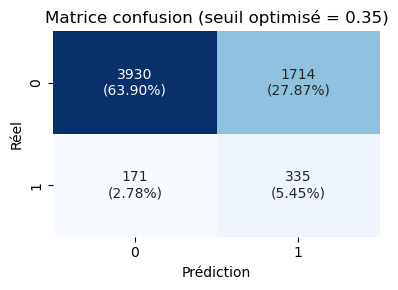

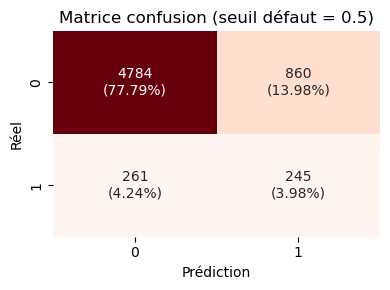

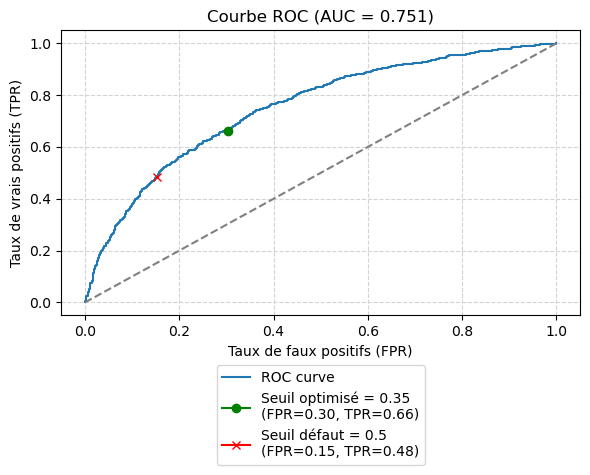

🏃 View run LGBM_MinMax_10_oversampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/f55dc03757ac4eed8763f4587088accc
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


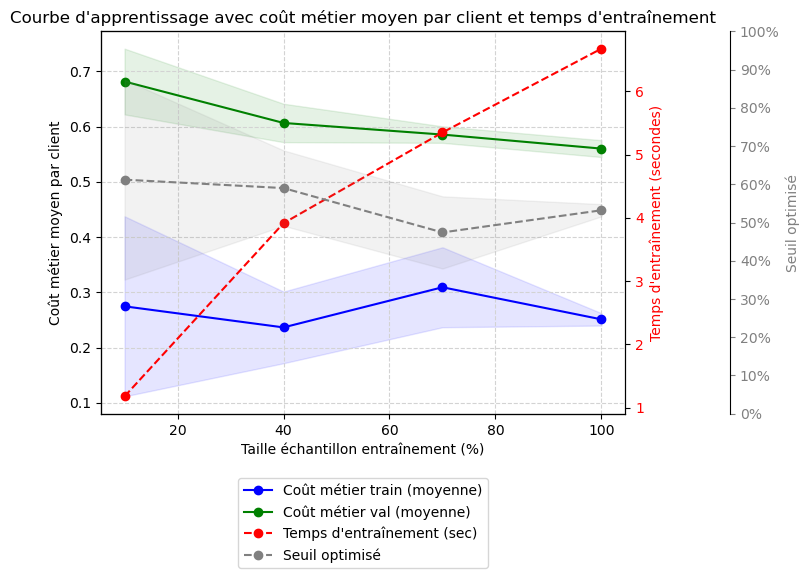

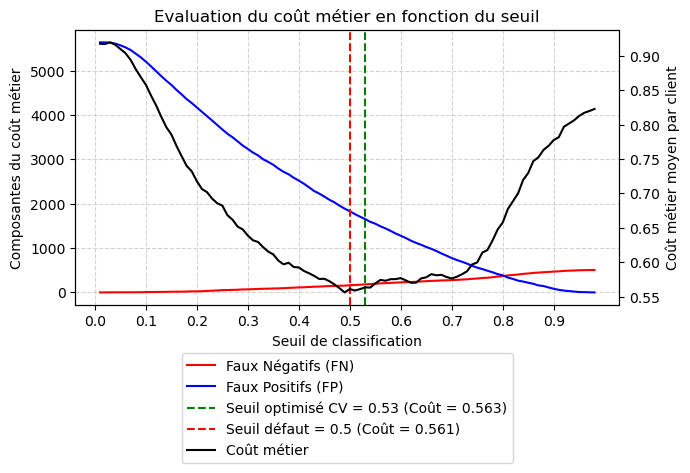

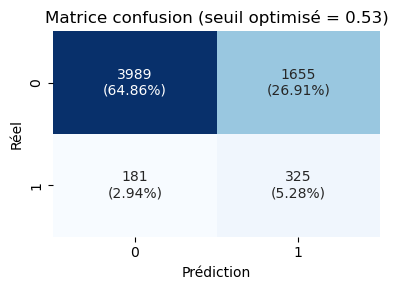

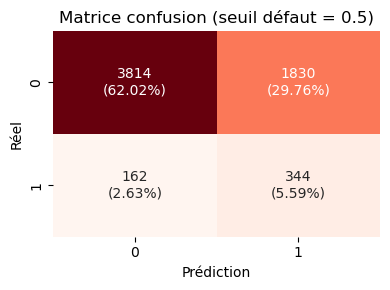

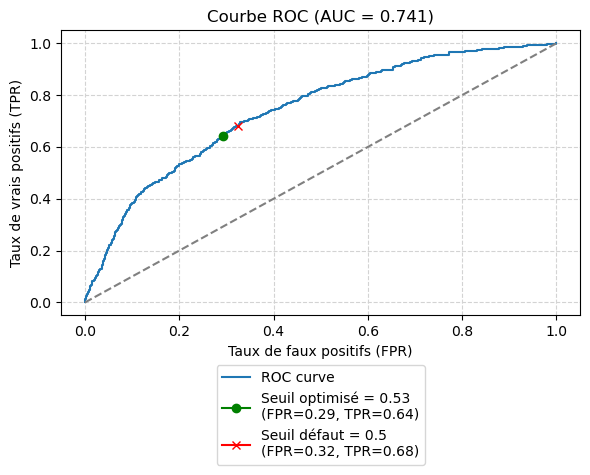

🏃 View run LGBM_MinMax_10_undersampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/0e67d6fd9e8340f0a9c2eba10b35aa72
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


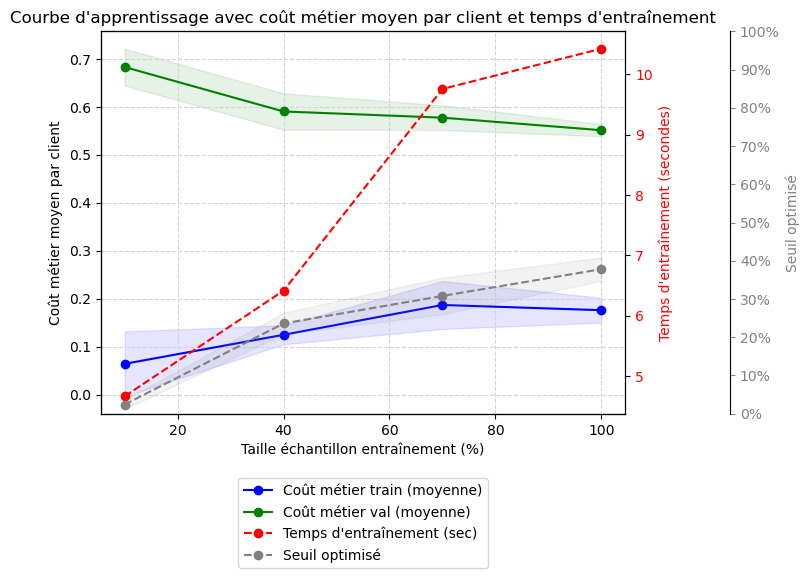

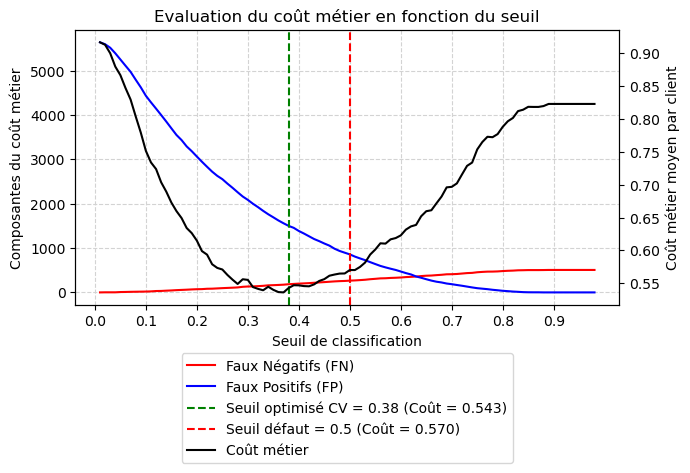

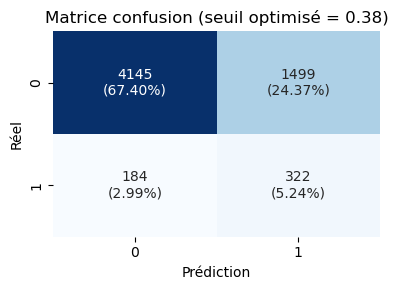

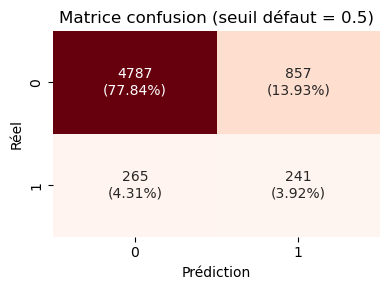

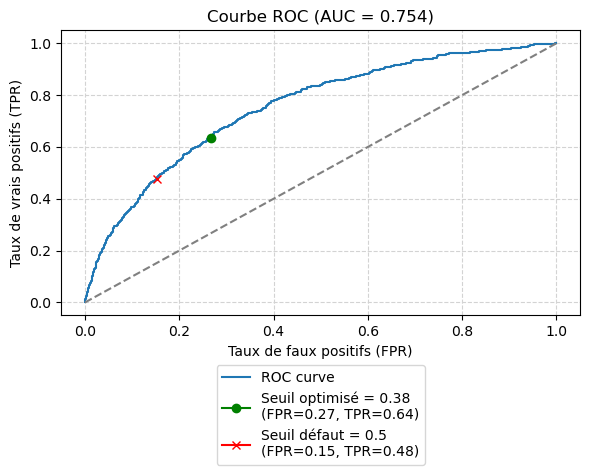

🏃 View run LGBM_MinMax_10_classweight at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/236bbfe1421c4fe59ddc010116ed3fc8
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


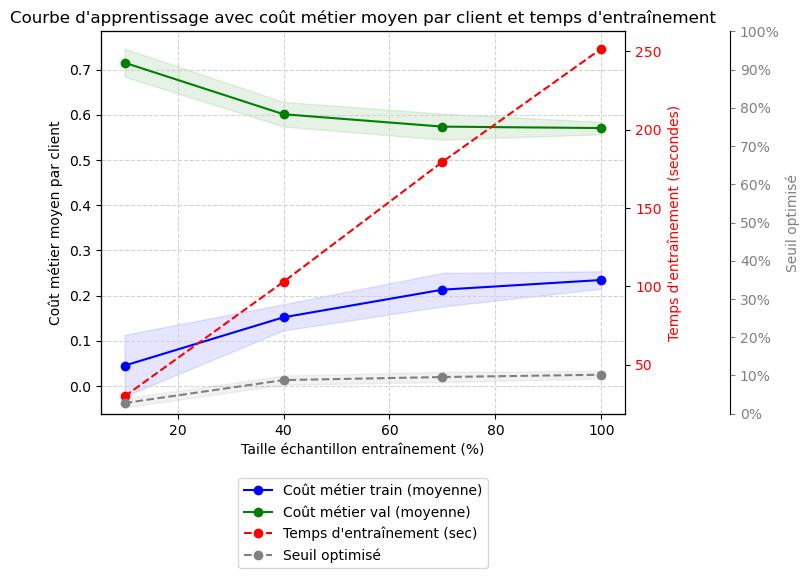

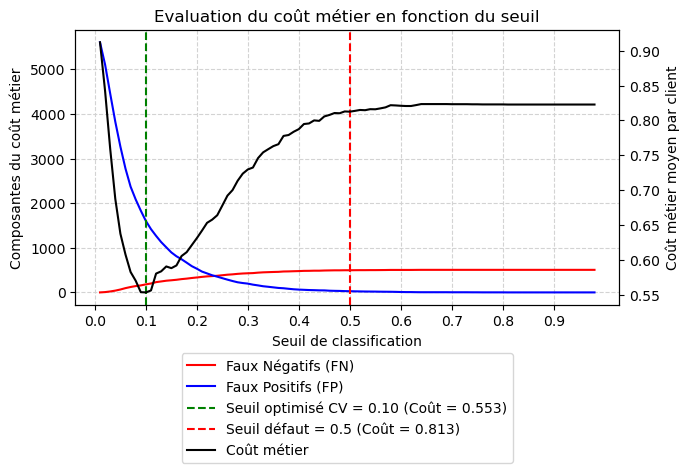

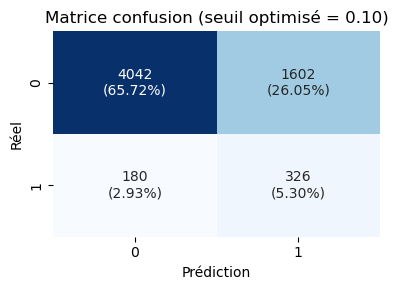

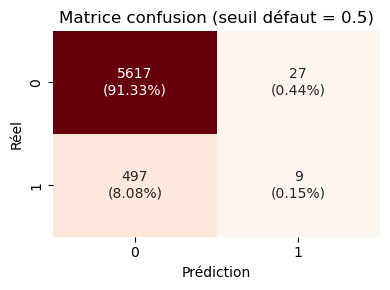

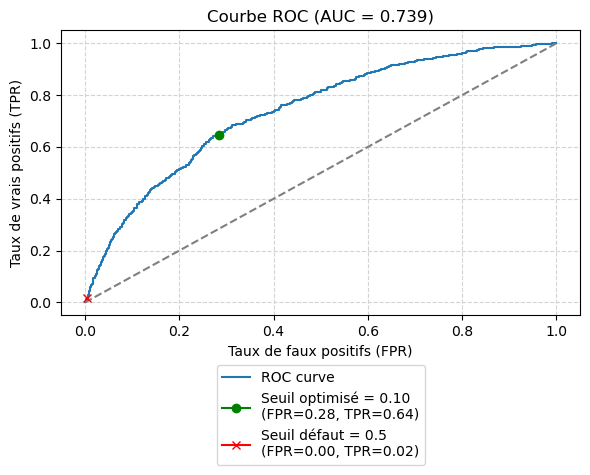

🏃 View run LGBM_MinMax_10_smote at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/e4041fca618d4b039e960e37a8146da3
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


In [155]:
eval_model_(LGBMm_oversampler, 'LGBM', 'LGBM_MinMax_10_oversampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LGBMm_undersampler, 'LGBM', 'LGBM_MinMax_10_undersampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LGBMm_classweight, 'LGBM', 'LGBM_MinMax_10_classweight', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LGBMm_smote, 'LGBM', 'LGBM_MinMax_10_smote', X_trainval, y_trainval, X_test, y_test, perf_tableaux)

In [156]:
#Définition des différents pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes 
#pour LogisticRegression
LRm = Pipeline([
    ('scale', MinMaxScaler()),
     ('model', LogisticRegression(max_iter=5000, random_state=42, verbose=0))
])

LRm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', LogisticRegression(max_iter=5000, random_state=42, verbose=0))
])

LRm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', LogisticRegression(max_iter=5000, random_state=42, verbose=0))
])

LRm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTENC(categorical_features=categorical_indices, random_state=42)),
    ('model', LogisticRegression(max_iter=5000, random_state=42, verbose=0))
])

LRm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LogisticRegression(max_iter=5000, class_weight='balanced', random_state=42, verbose=0))
])

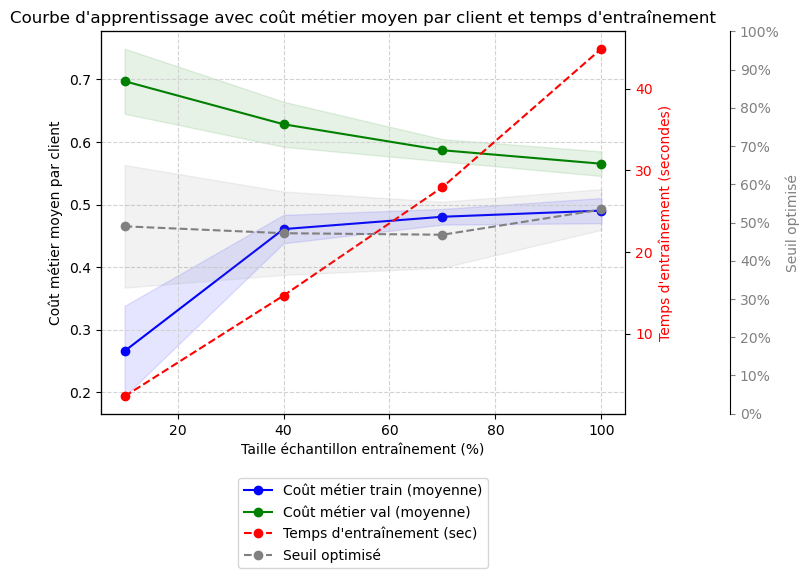

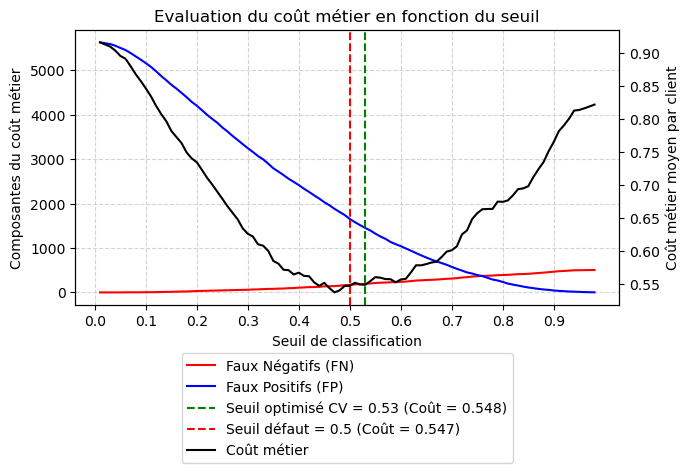

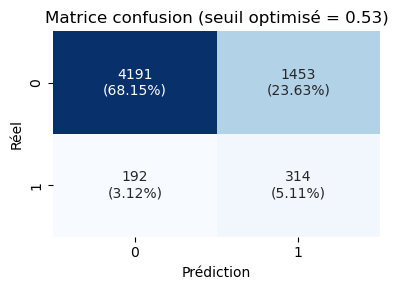

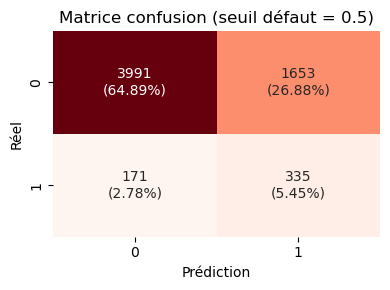

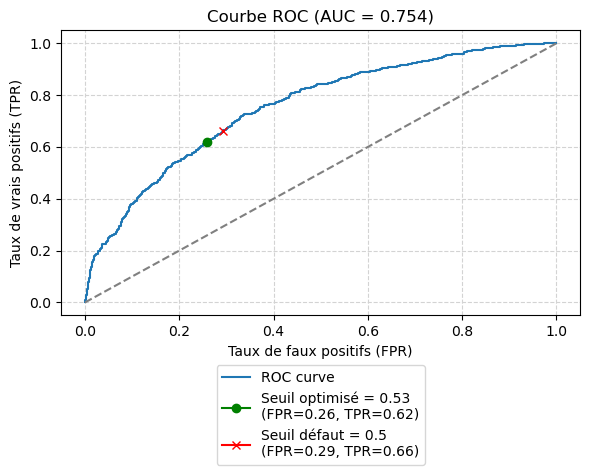

🏃 View run LR_MinMax_10_oversampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/0e9e55d355a44f6fb24ca2ee41835886
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


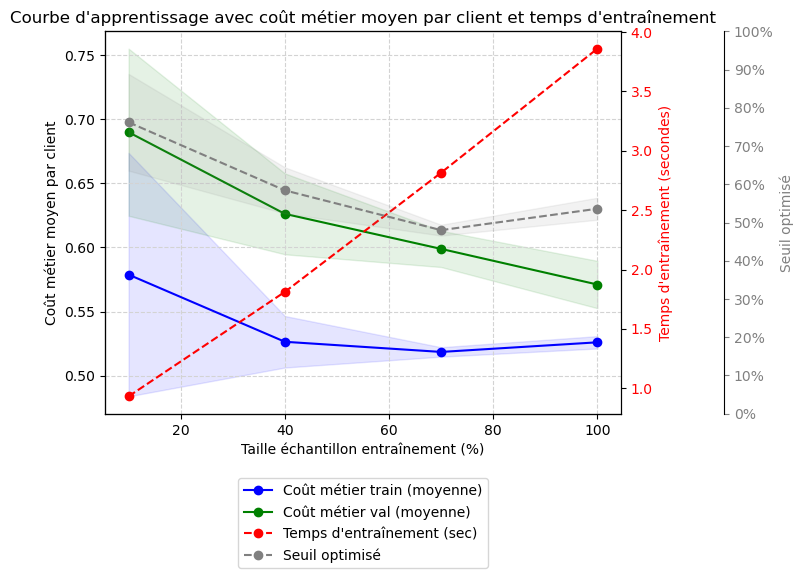

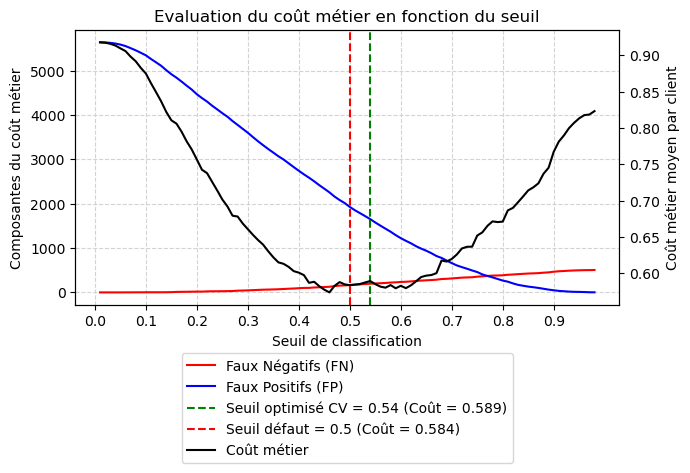

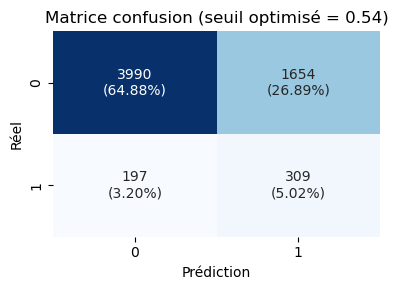

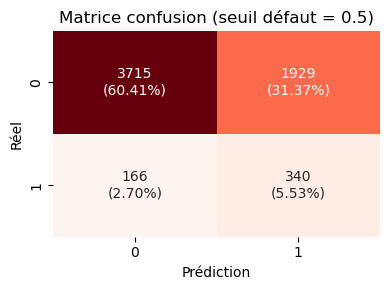

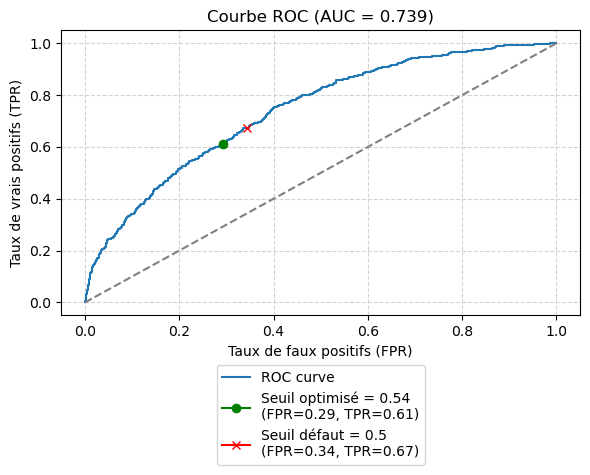

🏃 View run LR_MinMax_10_undersampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/fededdbeaf854b91a9c5ac657b1ef188
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


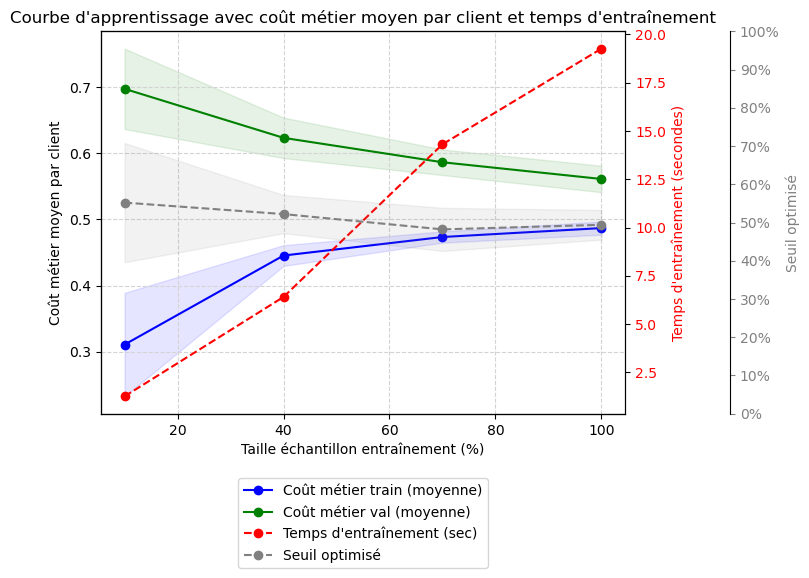

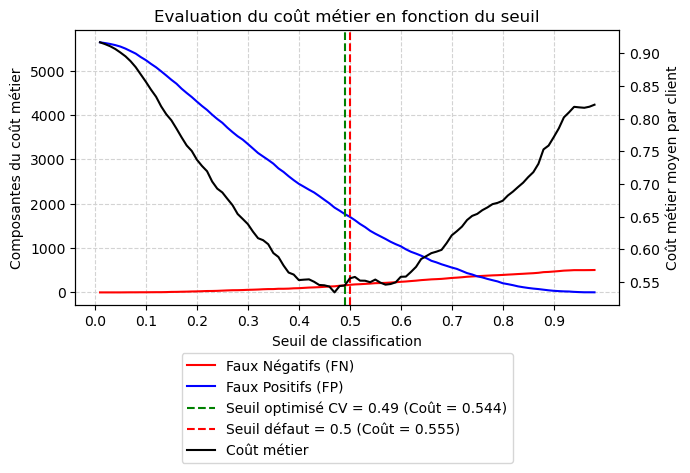

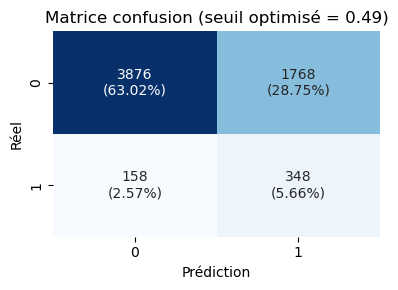

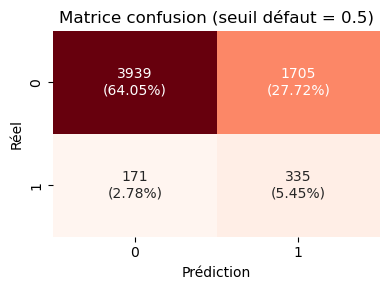

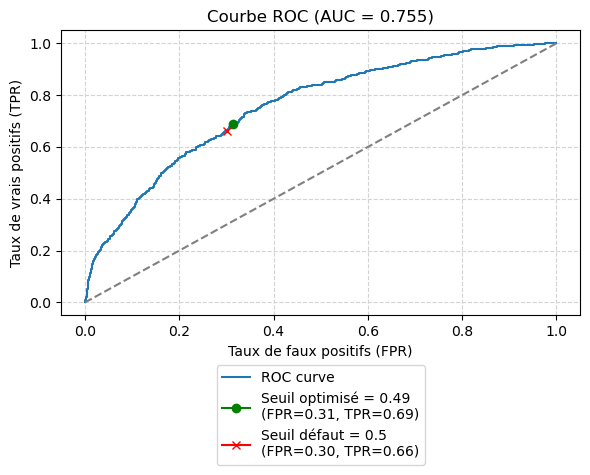

🏃 View run LR_MinMax_10_classweight at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/64198f958dbf4a9e96345c38a3638a48
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


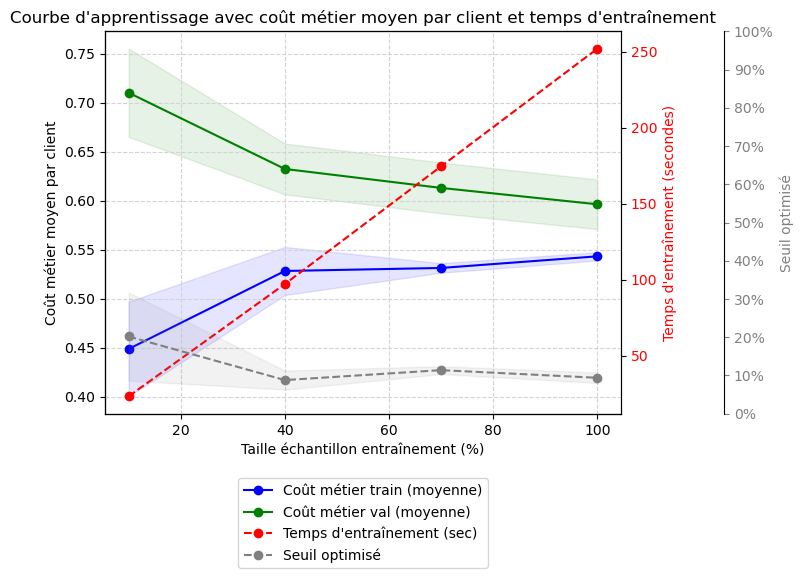

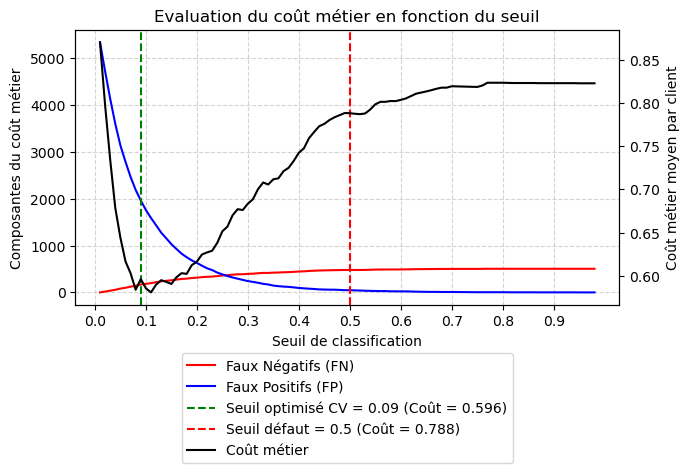

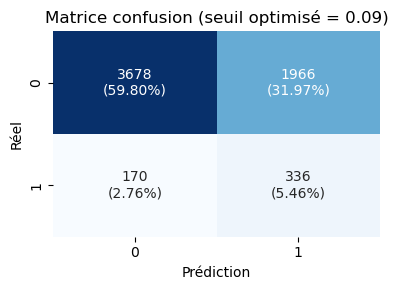

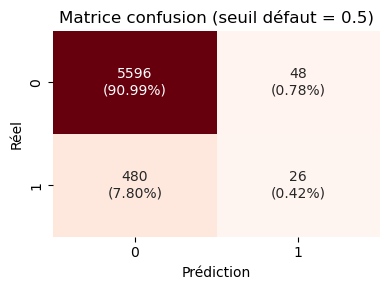

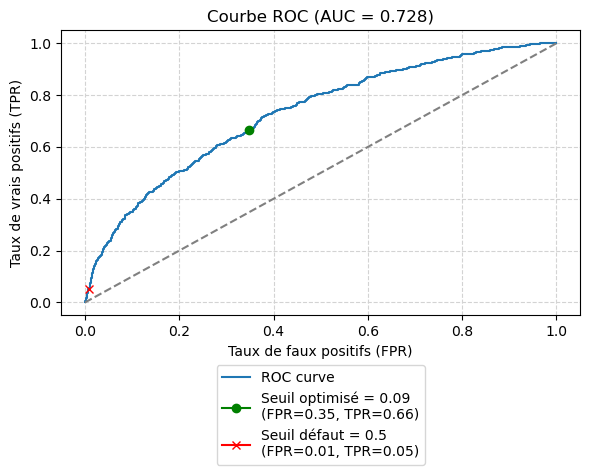

🏃 View run LR_MinMax_10_smote at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/15d32b19d5564d0caba2fcd69d1b9a8c
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


In [157]:
eval_model_(LRm_oversampler, 'LR', 'LR_MinMax_10_oversampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LRm_undersampler, 'LR', 'LR_MinMax_10_undersampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LRm_classweight, 'LR', 'LR_MinMax_10_classweight', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(LRm_smote, 'LR', 'LR_MinMax_10_smote', X_trainval, y_trainval, X_test, y_test, perf_tableaux)


In [158]:
#Définition des différents pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes 
#pour RandomForest
RFm = Pipeline([
    ('scale', MinMaxScaler()),
     ('model', RandomForestClassifier(random_state=42, verbose=0))
])

RFm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', RandomForestClassifier(random_state=42, verbose=0))
])

RFm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', RandomForestClassifier(random_state=42, verbose=0))
])

RFm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTENC(categorical_features=categorical_indices, random_state=42)),
    ('model', RandomForestClassifier(random_state=42, verbose=0))
])

RFm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', RandomForestClassifier(class_weight='balanced', random_state=42, verbose=0))
])

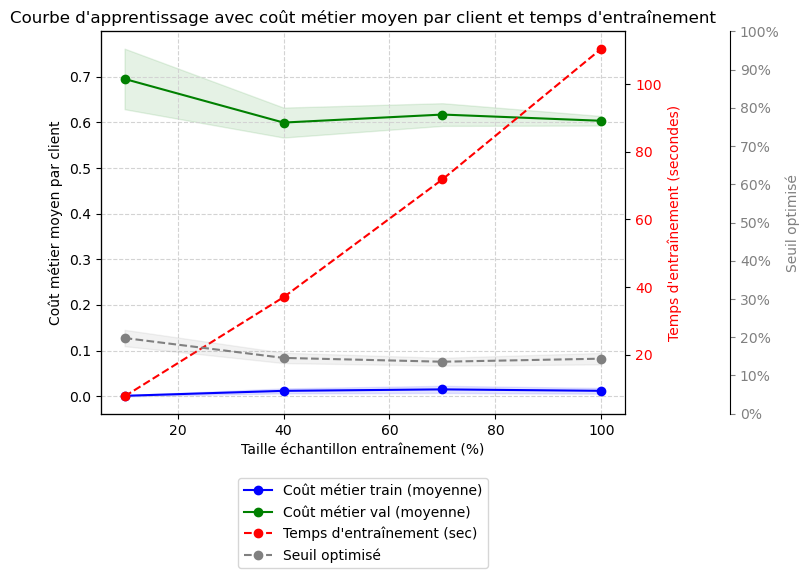

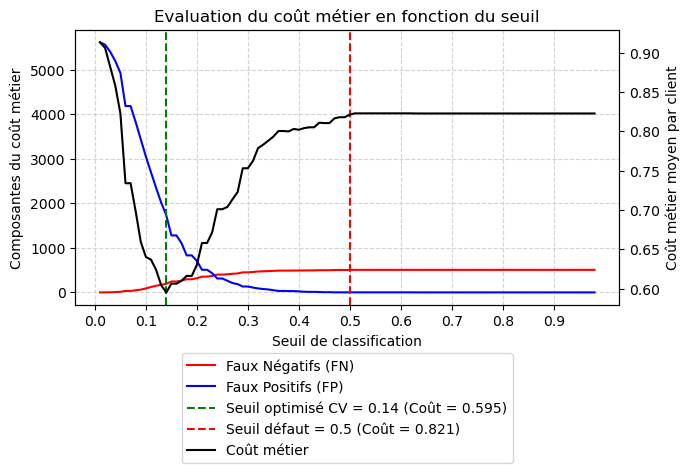

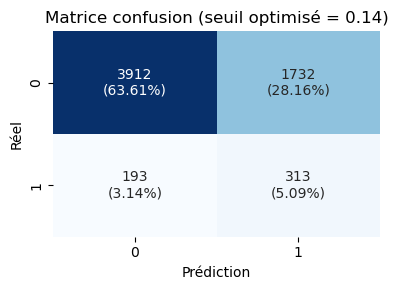

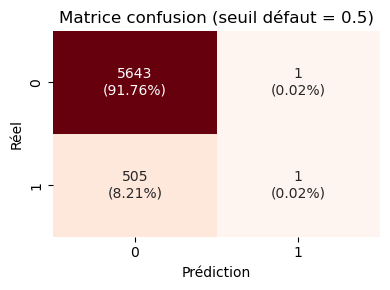

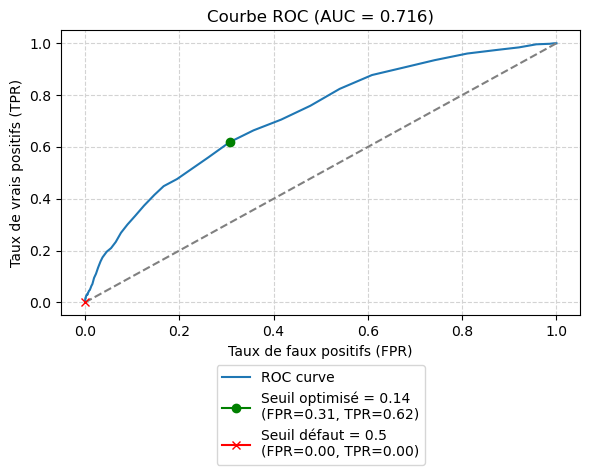

🏃 View run RF_MinMax_10_oversampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/e558b2b30cae4472a5914289d8e70613
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


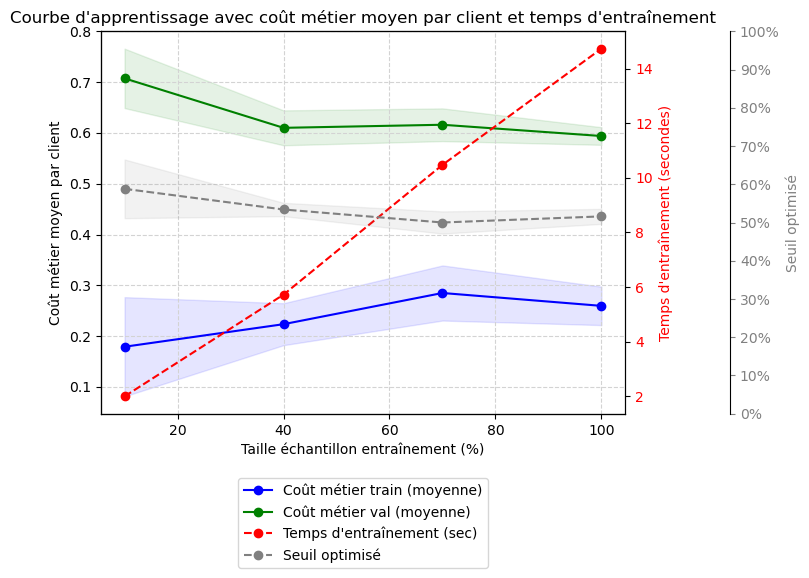

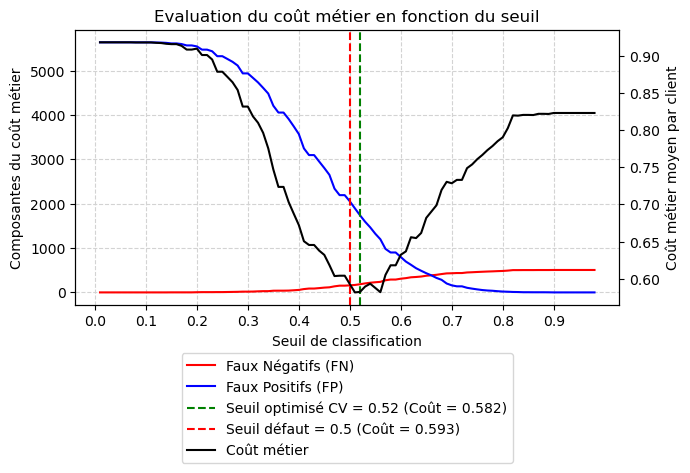

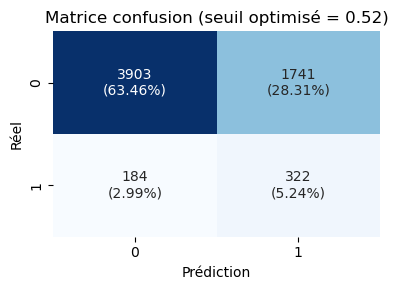

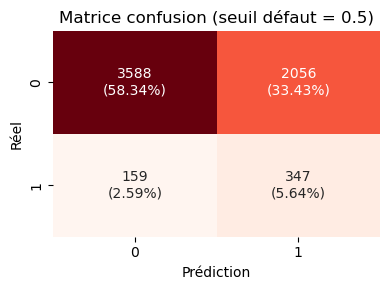

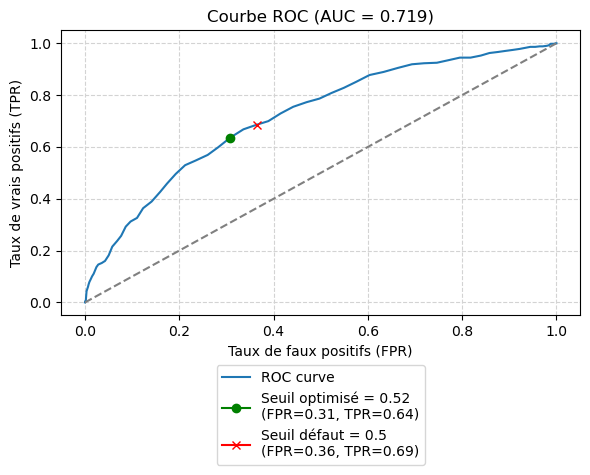

🏃 View run RF_MinMax_10_undersampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/7b9c25aed1104f4dbc3af68be26cdf64
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


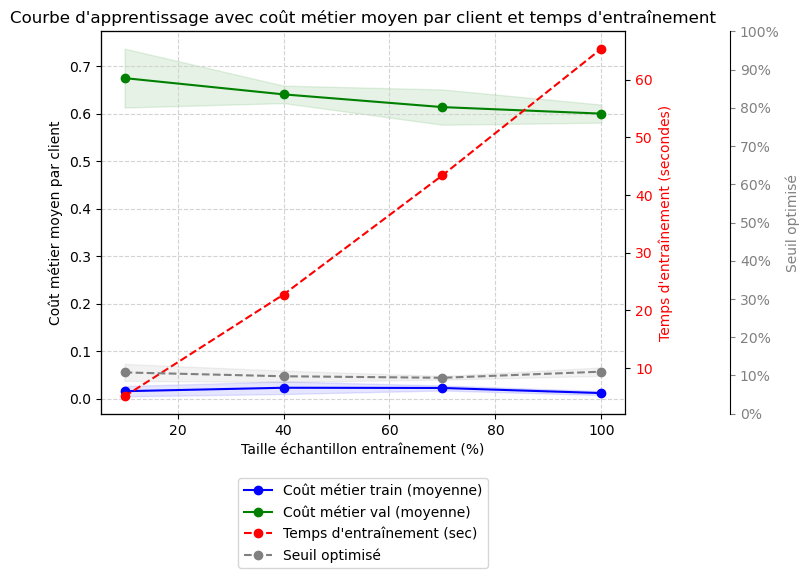

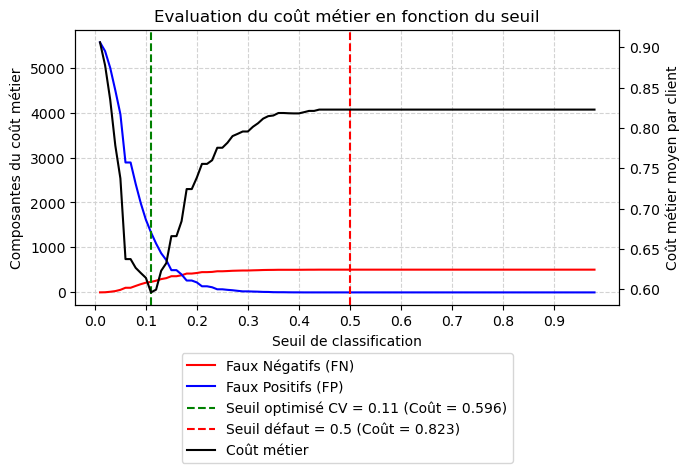

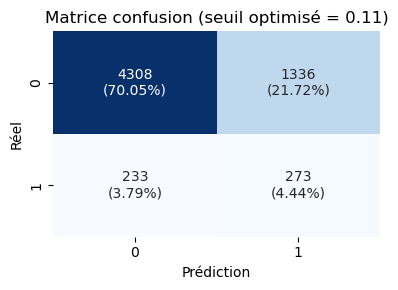

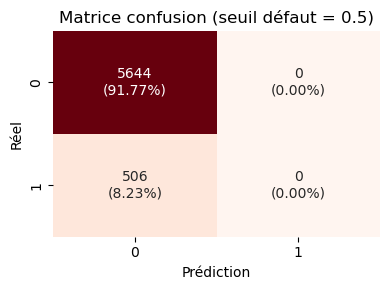

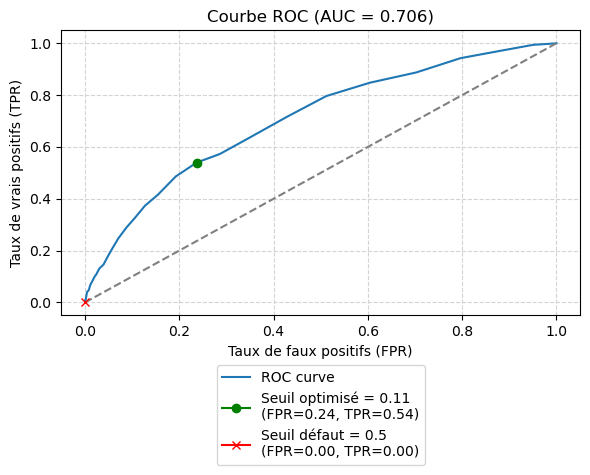

🏃 View run RF_MinMax_10_classweight at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/38652ad361be47558dd5c3db8ff4a8c8
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


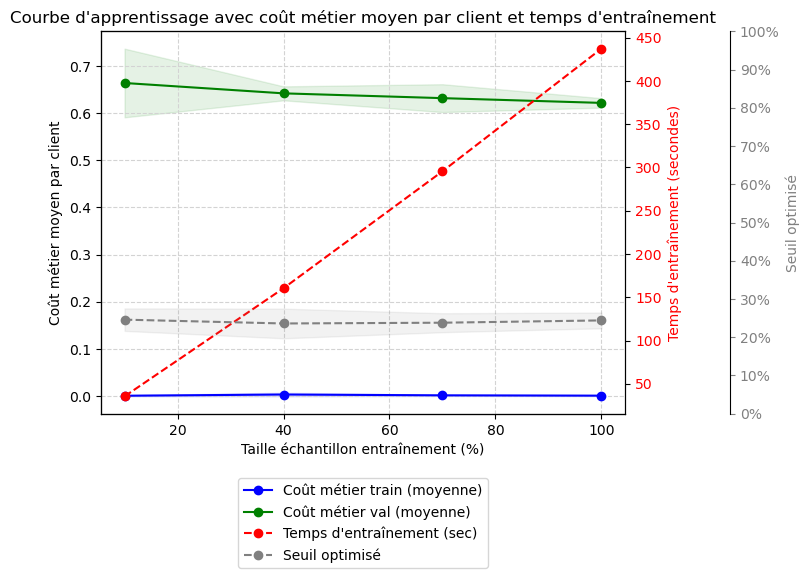

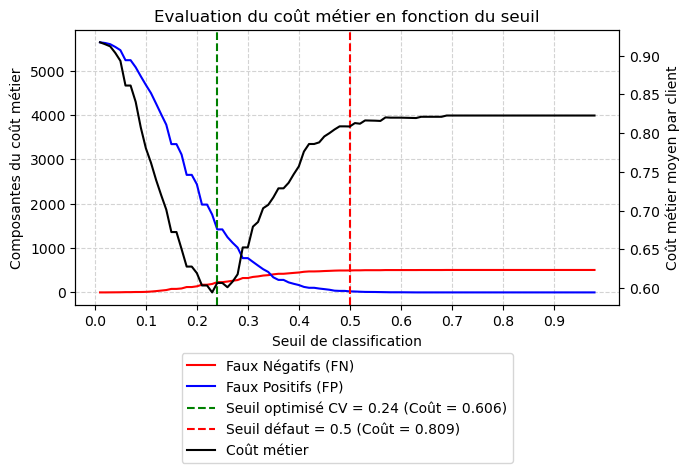

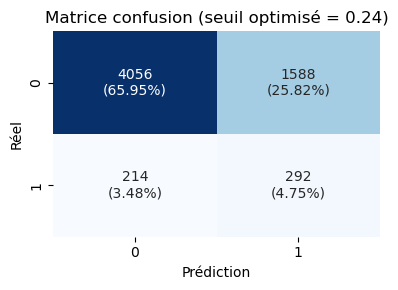

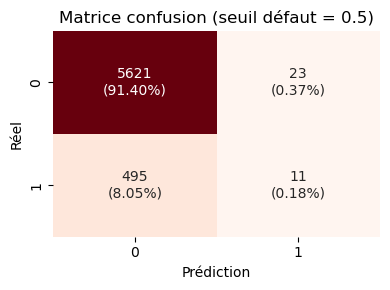

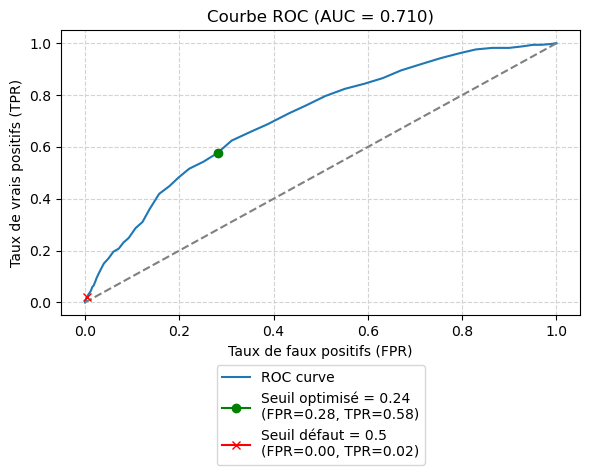

🏃 View run RF_MinMax_10_smote at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/6e48b130f2b54a7791b29a112c35af84
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


In [159]:
eval_model_(RFm_oversampler, 'RF', 'RF_MinMax_10_oversampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(RFm_undersampler, 'RF', 'RF_MinMax_10_undersampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(RFm_classweight, 'RF', 'RF_MinMax_10_classweight', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(RFm_smote, 'RF', 'RF_MinMax_10_smote', X_trainval, y_trainval, X_test, y_test, perf_tableaux)


In [160]:
#Définition des différents pipeline pour enchainer les étapes de prétraiement et de classification + techniques de ré-équilibrage des classes 
#pour XGBoost
XGBm = Pipeline([
    ('scale', MinMaxScaler()),
     ('model', XGBClassifier(random_state=42, verbosity=0))
])

XGBm_oversampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomOverSampler(random_state=42)),
    ('model', XGBClassifier(random_state=42, verbosity=0))
])

XGBm_undersampler = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', RandomUnderSampler(random_state=42)),
    ('model', XGBClassifier(random_state=42, verbosity=0))
])

XGBm_smote = imbpipeline([
    ('scaler', MinMaxScaler()),
    ('balance', SMOTENC(categorical_features=categorical_indices, random_state=42)),
    ('model', XGBClassifier(random_state=42, verbosity=0))
])

#equivalent à class_weight
scale_pos_weight = (y_train == 0).sum() / (y_train == 1).sum()
XGBm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', XGBClassifier(scale_pos_weight=scale_pos_weight, use_label_encoder=False, eval_metric='logloss', random_state=42, verbosity=0))
])

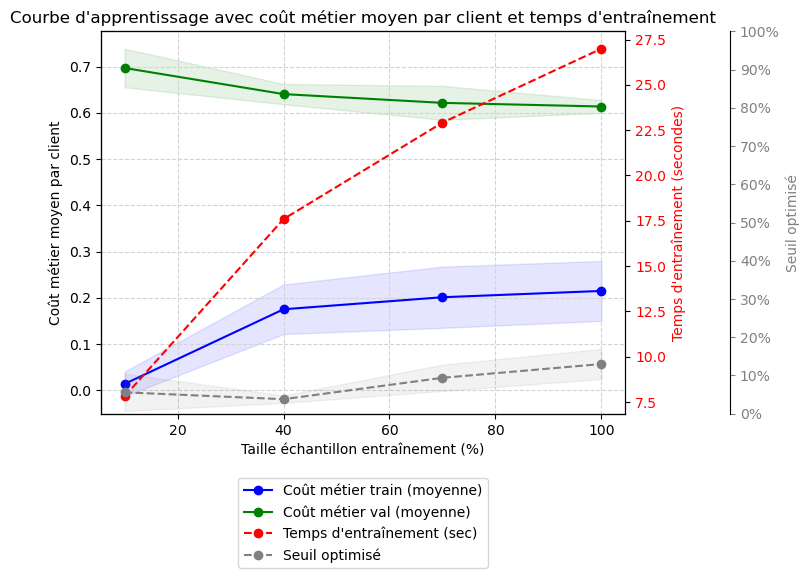

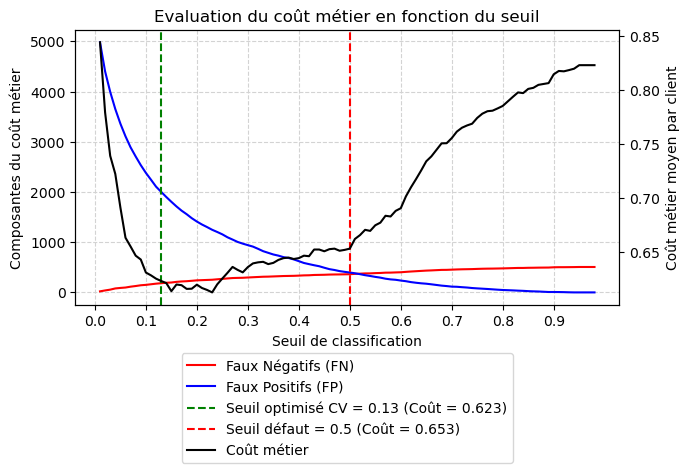

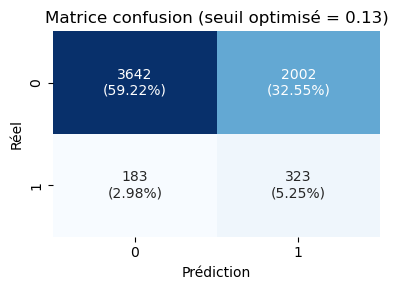

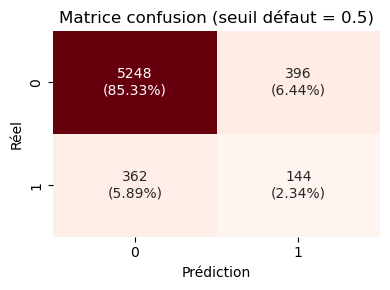

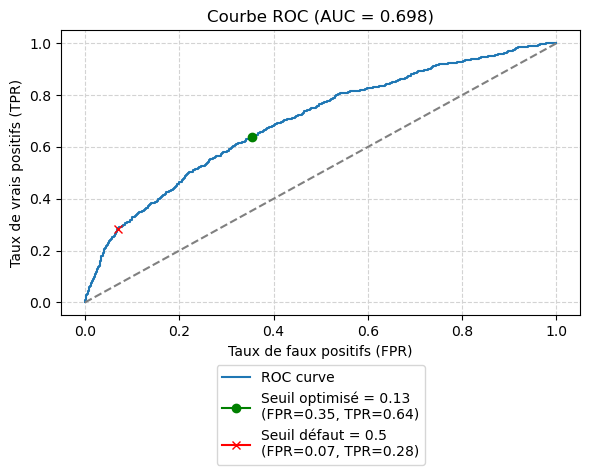

🏃 View run XGB_MinMax_10_oversampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/9541b22444eb466a80ecabac92fd5f78
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


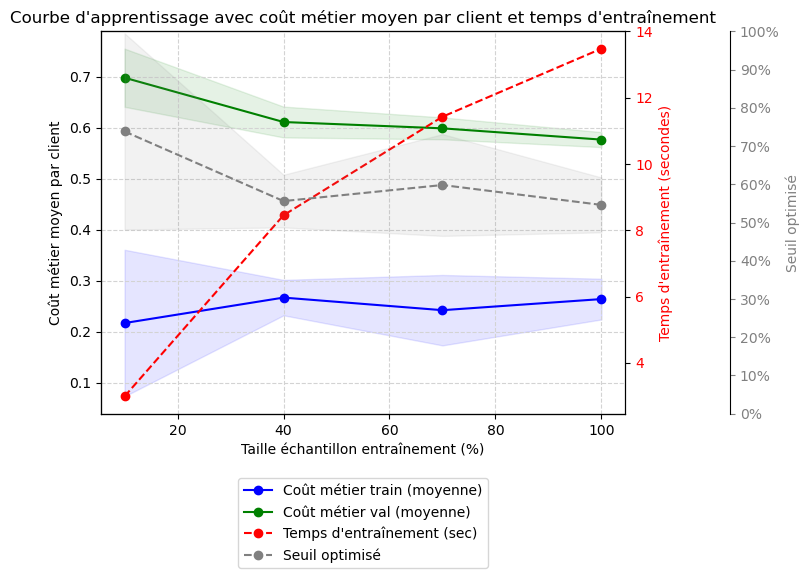

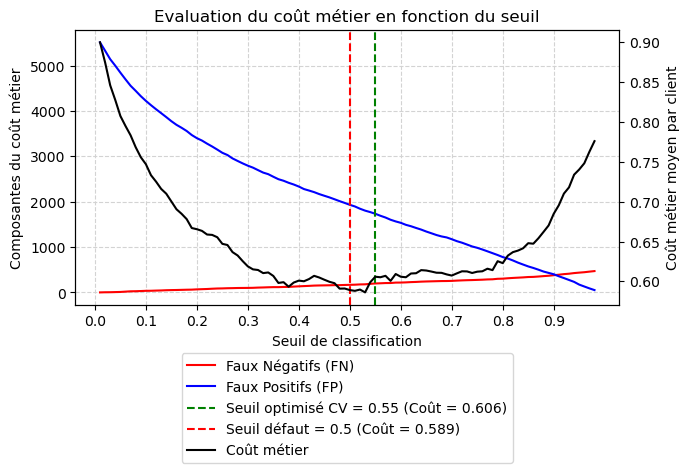

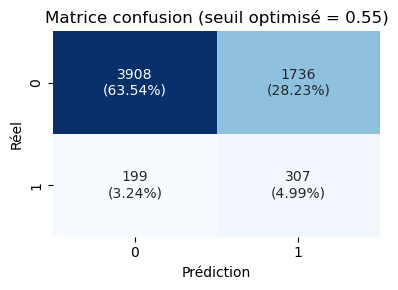

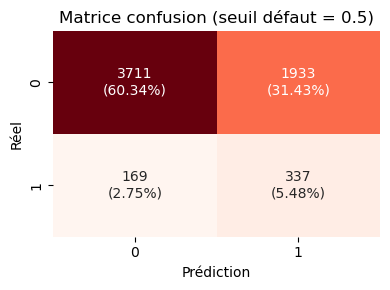

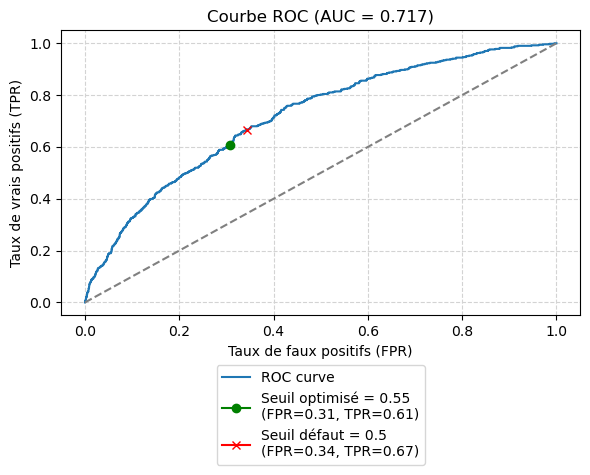

🏃 View run XGB_MinMax_10_undersampler at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/a83ba1b38a664a66ac571496151e0d93
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


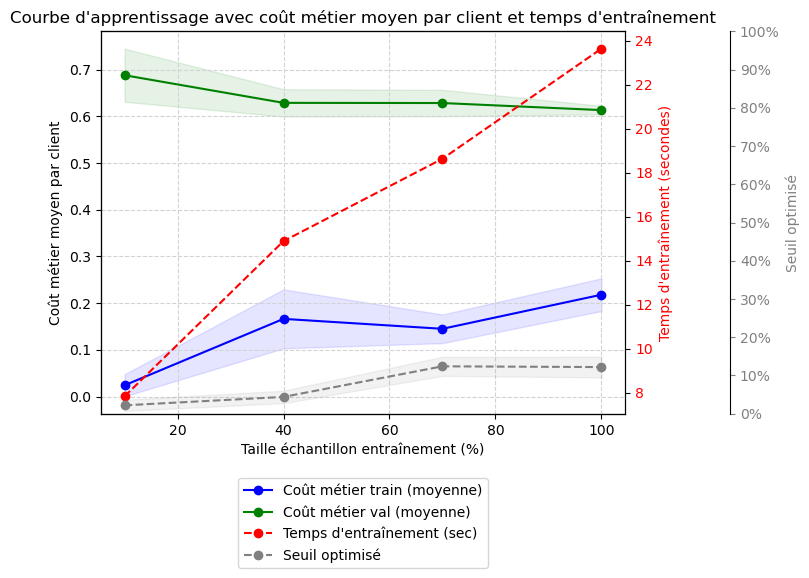

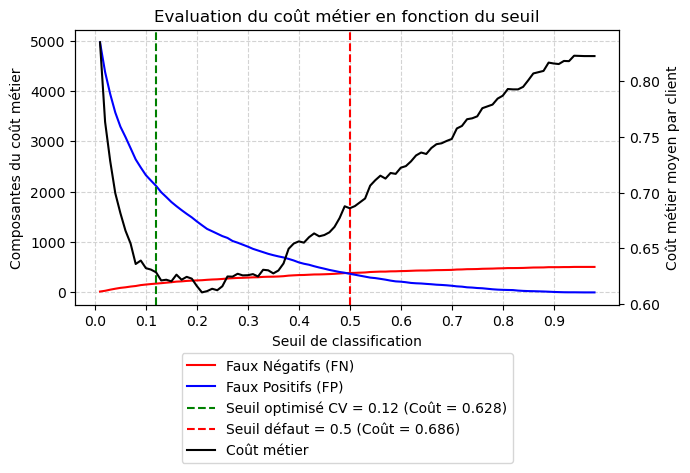

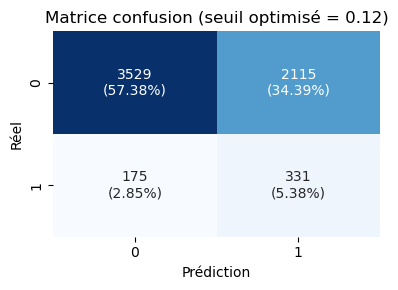

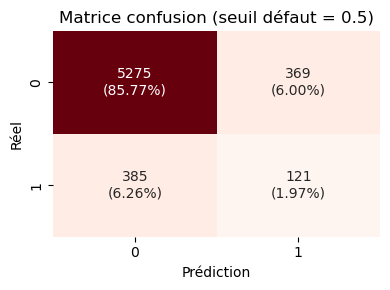

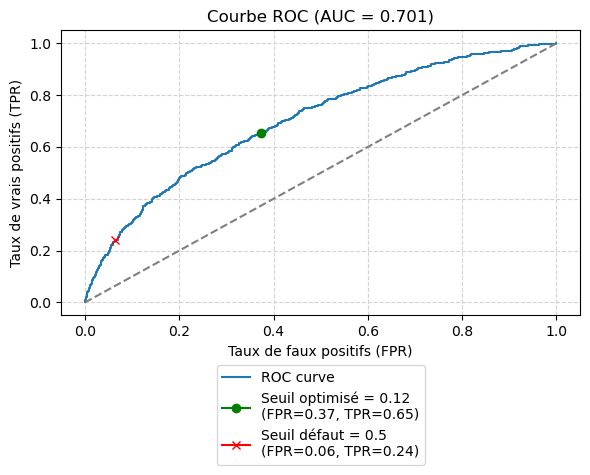

🏃 View run XGB_MinMax_10_classweight at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/a704829eeab34c8399be37efd5263718
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


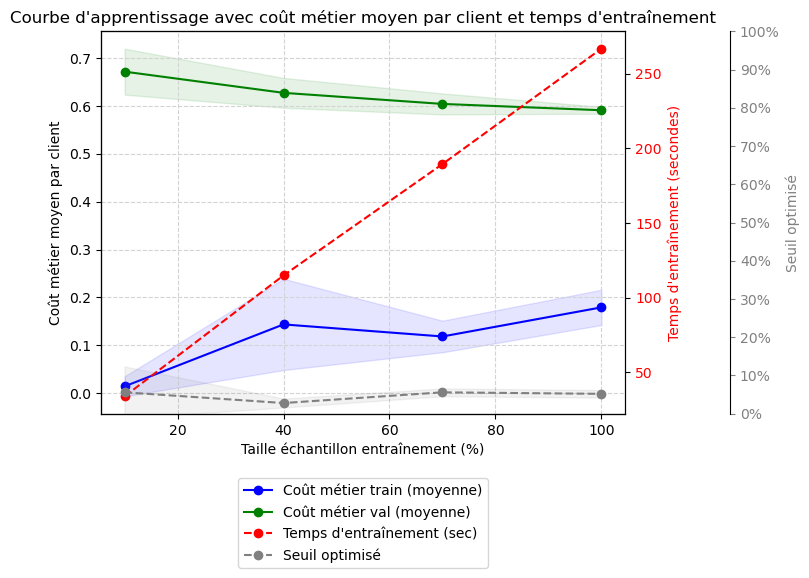

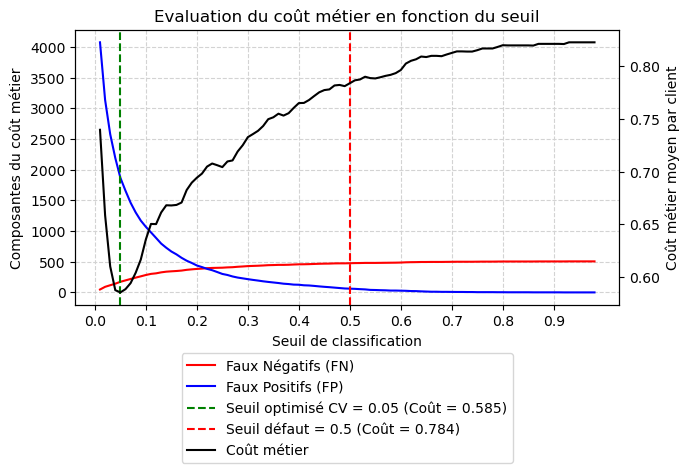

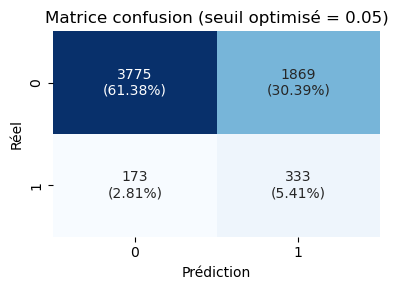

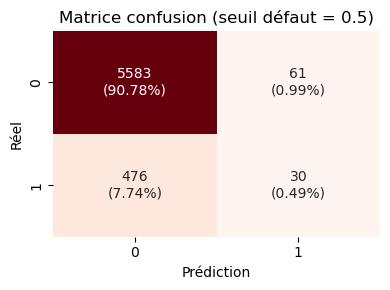

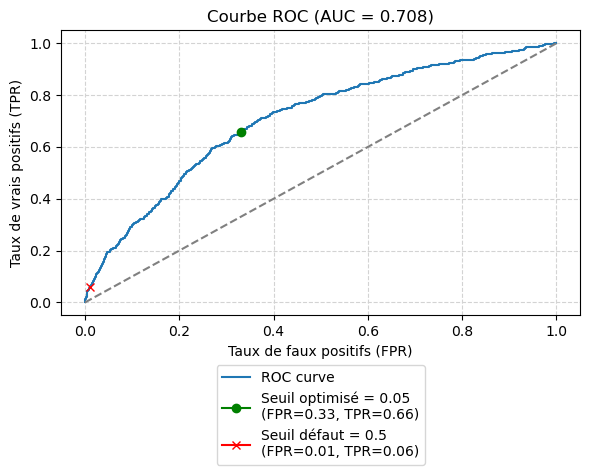

🏃 View run XGB_MinMax_10_smote at: http://127.0.0.1:5000/#/experiments/999371258248648005/runs/294b03da03aa446c89f7a5772bd2c6a5
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/999371258248648005


In [161]:
eval_model_(XGBm_oversampler, 'XGB', 'XGB_MinMax_10_oversampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(XGBm_undersampler, 'XGB', 'XGB_MinMax_10_undersampler', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(XGBm_classweight, 'XGB', 'XGB_MinMax_10_classweight', X_trainval, y_trainval, X_test, y_test, perf_tableaux)
eval_model_(XGBm_smote, 'XGB', 'XGB_MinMax_10_smote', X_trainval, y_trainval, X_test, y_test, perf_tableaux)


In [173]:
perf_tableaux[perf_tableaux['configuration'].str.contains("MinMax", na=False)].sort_values(by = ["model","eval_cout_metier_optimal","eval_gain"], ascending = [True,True, False]).head(40)

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
18,LGBM,LGBM_MinMax_10_classweight,None,0.38,0.031,0.552,0.013,0.600,0.048,0.736,10.2,0.543,0.570,0.027,0.754,3.4
19,LGBM,LGBM_MinMax_10_smote,None,0.10,0.010,0.571,0.014,0.800,0.230,0.727,249.7,0.553,0.813,0.259,0.739,63.7
16,LGBM,LGBM_MinMax_10_oversampler,None,0.35,0.053,0.565,0.018,0.606,0.041,0.730,16.5,0.557,0.564,0.007,0.751,5.7
17,LGBM,LGBM_MinMax_10_undersampler,None,0.53,0.016,0.560,0.015,0.569,0.009,0.729,5.6,0.563,0.561,-0.002,0.741,2.6
22,LR,LR_MinMax_10_classweight,None,0.49,0.039,0.561,0.020,0.571,0.010,0.733,18.4,0.544,0.555,0.011,0.755,6.0
20,LR,LR_MinMax_10_oversampler,None,0.53,0.053,0.565,0.020,0.572,0.007,0.729,42.9,0.548,0.547,-0.002,0.754,13.2
21,LR,LR_MinMax_10_undersampler,None,0.54,0.029,0.571,0.018,0.584,0.013,0.722,3.4,0.589,0.584,-0.006,0.739,2.1
23,LR,LR_MinMax_10_smote,None,0.09,0.014,0.596,0.025,0.784,0.187,0.704,248.8,0.596,0.788,0.192,0.728,63.3
25,RF,RF_MinMax_10_undersampler,None,0.52,0.020,0.594,0.017,0.601,0.007,0.712,12.0,0.582,0.593,0.011,0.719,4.9
24,RF,RF_MinMax_10_oversampler,None,0.14,0.015,0.603,0.010,0.821,0.218,0.704,106.8,0.595,0.821,0.226,0.716,30.2


Classement retenu par modèle avec normalisation=MinMaxScaler et équilibrage :
- 1 : LGBM_MinMax_10_classweight : cout_metier_client=0.543 - roc_auc=0.754 - time_fit_cv=10.2sec - seuil optimisé=0.38
- 2 : LR_MinMax_10_classweight : cout_metier_client=0.544 - roc_auc=0.755 - time_fit_cv=12.4sec - seuil optimisé=0.49
- 3 : RF_MinMax_10_undersampler : cout_metier_client=0.582 - roc_auc=0.719 - time_fit_cv=12.0sec - seuil optimisé=0.52
- 4 : XGB_MinMax_10_smote : cout_metier_client=0.585 - roc_auc=0.708 - time_fit_cv=269.0sec - seuil optimisé=0.05

In [297]:
df_best_perf.loc[row_index, 'Model'] = "LGBM"
df_best_perf.loc[row_index, 'Normalisation'] = "MinMaxScaler"
df_best_perf.loc[row_index, 'Equilibrage'] = "classweight"
df_best_perf.loc[row_index, 'Configuration'] = "LGBM_MinMax_classweight"
df_best_perf.loc[row_index, 'Echantillon'] = "10%"
df_best_perf.loc[row_index, 'Cout Metier client'] = 0.543
df_best_perf.loc[row_index, 'Seuil optimisé'] =  0.38
df_best_perf.loc[row_index, 'ROC_AUC'] = 0.754
df_best_perf.loc[row_index, 'Time Train cv (sec)'] = 10.2
row_index+=1
df_best_perf.loc[row_index, 'Model'] = "LR"
df_best_perf.loc[row_index, 'Normalisation'] = "MinMaxScaler"
df_best_perf.loc[row_index, 'Equilibrage'] = "classweight"
df_best_perf.loc[row_index, 'Configuration'] = "LR_MinMax_classweight"
df_best_perf.loc[row_index, 'Echantillon'] = "10%"
df_best_perf.loc[row_index, 'Cout Metier client'] = 0.544
df_best_perf.loc[row_index, 'Seuil optimisé'] =  0.49
df_best_perf.loc[row_index, 'ROC_AUC'] = 0.755
df_best_perf.loc[row_index, 'Time Train cv (sec)'] = 12.4
row_index+=1
df_best_perf.loc[row_index, 'Model'] = "RF"
df_best_perf.loc[row_index, 'Normalisation'] = "MinMaxScaler"
df_best_perf.loc[row_index, 'Equilibrage'] = "undersampler"
df_best_perf.loc[row_index, 'Configuration'] = "RF_MinMax_undersampler"
df_best_perf.loc[row_index, 'Echantillon'] = "10%"
df_best_perf.loc[row_index, 'Cout Metier client'] = 0.582
df_best_perf.loc[row_index, 'Seuil optimisé'] =  0.52
df_best_perf.loc[row_index, 'ROC_AUC'] = 0.719
df_best_perf.loc[row_index, 'Time Train cv (sec)'] = 12.0
row_index+=1
df_best_perf.loc[row_index, 'Model'] = "XGB"
df_best_perf.loc[row_index, 'Normalisation'] = "MinMaxScaler"
df_best_perf.loc[row_index, 'Equilibrage'] = "smote"
df_best_perf.loc[row_index, 'Configuration'] = "XGB_MinMax_smote"
df_best_perf.loc[row_index, 'Echantillon'] = "10%"
df_best_perf.loc[row_index, 'Cout Metier client'] = 0.585
df_best_perf.loc[row_index, 'Seuil optimisé'] =  0.05
df_best_perf.loc[row_index, 'ROC_AUC'] = 0.708
df_best_perf.loc[row_index, 'Time Train cv (sec)'] = 269.0
row_index+=1

In [299]:
#on trie par model et par cout métier client croissant pour savoir quelle configuration est la meilleur
df_best_perf.sort_values(by = ["Model", "Cout Metier client"], ascending = [True, True])

,Model,Normalisation,Equilibrage,Configuration,Echantillon,Cout Metier client,Seuil optimisé,ROC_AUC,Time Train cv (sec)
4,LGBM,MinMaxScaler,classweight,LGBM_MinMax_classweight,10%,0.543,0.38,0.754,10.2
0,LGBM,StandardScaler,classweight,LGBM_Std_classweight,10%,0.546,0.35,0.755,14.2
5,LR,MinMaxScaler,classweight,LR_MinMax_classweight,10%,0.544,0.49,0.755,12.4
1,LR,StandardScaler,oversampler,LR_Std_oversampler,10%,0.558,0.49,0.746,22.7
6,RF,MinMaxScaler,undersampler,RF_MinMax_undersampler,10%,0.582,0.52,0.719,12.0
2,RF,StandardScaler,classweight,RF_Std_classweight,10%,0.584,0.09,0.709,61.5
7,XGB,MinMaxScaler,smote,XGB_MinMax_smote,10%,0.585,0.05,0.708,269.0
3,XGB,StandardScaler,undersampler,XGB_Std_undersampler,10%,0.602,0.56,0.726,13.0


In [301]:
#On retient uniquement la meilleur configuration par modèle (celui qui a le cout métier par client le plus faible)
#On observe que c'est avec la normalisation minmaxscaler que les 4 modèles obtiennent les meilleurs cout métiers 
df_best_perf2 = pd.DataFrame()
df_best_perf2.loc[row_index, 'Model'] = "LGBM"
df_best_perf2.loc[row_index, 'Normalisation'] = "MinMaxScaler"
df_best_perf2.loc[row_index, 'Equilibrage'] = "classweight"
df_best_perf2.loc[row_index, 'Configuration'] = "LGBM_MinMax_classweight"
df_best_perf2.loc[row_index, 'Echantillon'] = "10%"
df_best_perf2.loc[row_index, 'Cout Metier client'] = 0.543
df_best_perf2.loc[row_index, 'Seuil optimisé'] =  0.38
df_best_perf2.loc[row_index, 'ROC_AUC'] = 0.754
df_best_perf2.loc[row_index, 'Time Train cv (sec)'] = 10.2
row_index+=1
df_best_perf2.loc[row_index, 'Model'] = "LR"
df_best_perf2.loc[row_index, 'Normalisation'] = "MinMaxScaler"
df_best_perf2.loc[row_index, 'Equilibrage'] = "classweight"
df_best_perf2.loc[row_index, 'Configuration'] = "LR_MinMax_classweight"
df_best_perf2.loc[row_index, 'Echantillon'] = "10%"
df_best_perf2.loc[row_index, 'Cout Metier client'] = 0.544
df_best_perf2.loc[row_index, 'Seuil optimisé'] =  0.49
df_best_perf2.loc[row_index, 'ROC_AUC'] = 0.755
df_best_perf2.loc[row_index, 'Time Train cv (sec)'] = 12.4
row_index+=1
df_best_perf2.loc[row_index, 'Model'] = "RF"
df_best_perf2.loc[row_index, 'Normalisation'] = "MinMaxScaler"
df_best_perf2.loc[row_index, 'Equilibrage'] = "undersampler"
df_best_perf2.loc[row_index, 'Configuration'] = "RF_MinMax_undersampler"
df_best_perf2.loc[row_index, 'Echantillon'] = "10%"
df_best_perf2.loc[row_index, 'Cout Metier client'] = 0.582
df_best_perf2.loc[row_index, 'Seuil optimisé'] =  0.52
df_best_perf2.loc[row_index, 'ROC_AUC'] = 0.719
df_best_perf2.loc[row_index, 'Time Train cv (sec)'] = 12.0
row_index+=1
df_best_perf2.loc[row_index, 'Model'] = "XGB"
df_best_perf2.loc[row_index, 'Normalisation'] = "MinMaxScaler"
df_best_perf2.loc[row_index, 'Equilibrage'] = "smote"
df_best_perf2.loc[row_index, 'Configuration'] = "XGB_MinMax_smote"
df_best_perf2.loc[row_index, 'Echantillon'] = "10%"
df_best_perf2.loc[row_index, 'Cout Metier client'] = 0.585
df_best_perf2.loc[row_index, 'Seuil optimisé'] =  0.05
df_best_perf2.loc[row_index, 'ROC_AUC'] = 0.708
df_best_perf2.loc[row_index, 'Time Train cv (sec)'] = 269
row_index+=1

In [303]:
df_best_perf2.sort_values(by = ["Cout Metier client"], ascending = [True])

,Model,Normalisation,Equilibrage,Configuration,Echantillon,Cout Metier client,Seuil optimisé,ROC_AUC,Time Train cv (sec)
8,LGBM,MinMaxScaler,classweight,LGBM_MinMax_classweight,10%,0.543,0.38,0.754,10.2
9,LR,MinMaxScaler,classweight,LR_MinMax_classweight,10%,0.544,0.49,0.755,12.4
10,RF,MinMaxScaler,undersampler,RF_MinMax_undersampler,10%,0.582,0.52,0.719,12.0
11,XGB,MinMaxScaler,smote,XGB_MinMax_smote,10%,0.585,0.05,0.708,269.0


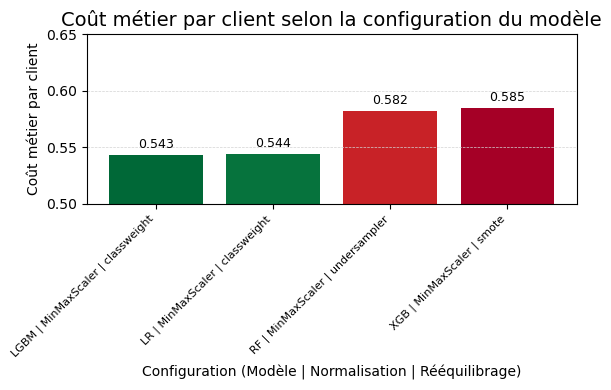

In [305]:
#Création d'une étiquette combinée pour l'axe X
df_best_perf2["Config"] = df_best_perf2["Model"] + " | " + df_best_perf2["Normalisation"] + " | " + df_best_perf2["Equilibrage"]

#Tri par coût métier
df_best_perf2 = df_best_perf2.sort_values(by="Cout Metier client", ascending=True).reset_index(drop=True)

#Création des couleurs avec colormap
norm = Normalize(vmin=df_best_perf2["Cout Metier client"].min(), vmax=df_best_perf2["Cout Metier client"].max())
colors = [cm.RdYlGn_r(norm(val)) for val in df_best_perf2["Cout Metier client"]]

#Tracé du barplot avec couleur personnalisée
plt.figure(figsize=(6, 4))
bars = plt.bar(df_best_perf2["Config"], df_best_perf2["Cout Metier client"], color=colors)

#Annotations au-dessus des barres
for bar in bars:
    height = bar.get_height()
    plt.annotate(f'{height:.3f}',
                 xy=(bar.get_x() + bar.get_width() / 2, height),
                 xytext=(0, 3),  # décalage en pixels
                 textcoords="offset points",
                 ha='center', va='bottom',
                 fontsize=9, color='black')

#Mise en forme
plt.title("Coût métier par client selon la configuration du modèle", fontsize=14)
plt.xlabel("Configuration (Modèle | Normalisation | Rééquilibrage)", fontsize=10)
plt.ylabel("Coût métier par client", fontsize=10)
plt.ylim(bottom=0.5, top=0.65)
plt.xticks(rotation=45, ha="right", fontsize=8)
plt.grid(True, axis='y', linestyle='--', color='lightgray', linewidth=0.5)
plt.tight_layout()

plt.show()

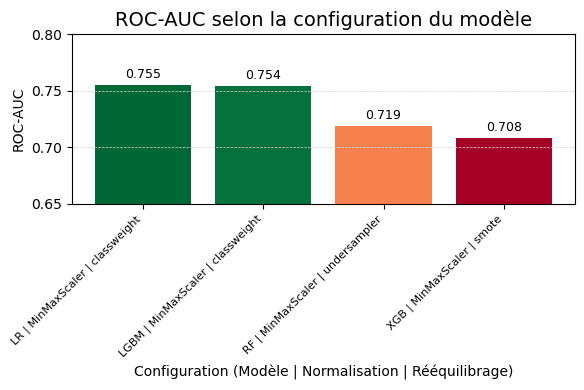

In [307]:
#Tri par coût métier
df_best_perf2 = df_best_perf2.sort_values(by="ROC_AUC", ascending=False).reset_index(drop=True)

norm = Normalize(vmax=df_best_perf2["ROC_AUC"].max(), vmin=df_best_perf2["ROC_AUC"].min())
colors = [cm.RdYlGn(norm(val)) for val in df_best_perf2["ROC_AUC"]]

#Tracé du barplot avec couleur personnalisée
plt.figure(figsize=(6, 4))
bars = plt.bar(df_best_perf2["Config"], df_best_perf2["ROC_AUC"], color=colors)

#Annotations au-dessus des barres
for bar in bars:
    height = bar.get_height()
    plt.annotate(f'{height:.3f}',
                 xy=(bar.get_x() + bar.get_width() / 2, height),
                 xytext=(0, 3),  # décalage en pixels
                 textcoords="offset points",
                 ha='center', va='bottom',
                 fontsize=9, color='black')

#Mise en forme
plt.title("ROC-AUC selon la configuration du modèle", fontsize=14)
plt.xlabel("Configuration (Modèle | Normalisation | Rééquilibrage)", fontsize=10)
plt.ylabel("ROC-AUC", fontsize=10)
plt.ylim(bottom=0.65, top=0.8)
plt.xticks(rotation=45, ha="right", fontsize=8)
plt.grid(True, axis='y', linestyle='--', color='lightgray', linewidth=0.5)
plt.tight_layout()

plt.show()

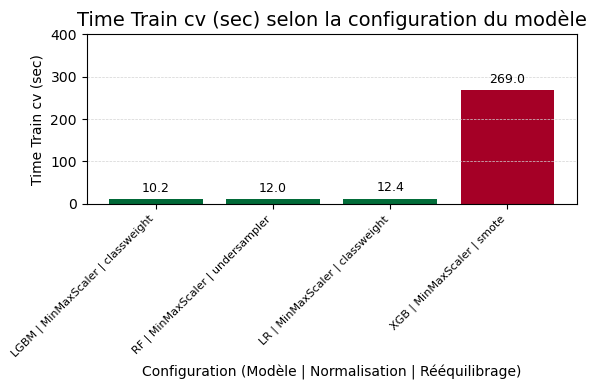

In [313]:
#Tri par temps d'entrainement
df_best_perf2 = df_best_perf2.sort_values(by="Time Train cv (sec)", ascending=True).reset_index(drop=True)

norm = Normalize(vmin=df_best_perf2["Time Train cv (sec)"].min(), vmax=df_best_perf2["Time Train cv (sec)"].max())
colors = [cm.RdYlGn_r(norm(val)) for val in df_best_perf2["Time Train cv (sec)"]]

#Tracé du barplot avec couleur personnalisée
plt.figure(figsize=(6, 4))
bars = plt.bar(df_best_perf2["Config"], df_best_perf2["Time Train cv (sec)"], color=colors)

#Annotations au-dessus des barres
for bar in bars:
    height = bar.get_height()
    plt.annotate(f'{height:.1f}',
                 xy=(bar.get_x() + bar.get_width() / 2, height),
                 xytext=(0, 3),  # décalage en pixels
                 textcoords="offset points",
                 ha='center', va='bottom',
                 fontsize=9, color='black')

#Mise en forme
plt.title("Time Train cv (sec) selon la configuration du modèle", fontsize=14)
plt.xlabel("Configuration (Modèle | Normalisation | Rééquilibrage)", fontsize=10)
plt.ylabel("Time Train cv (sec)", fontsize=10)
plt.ylim(bottom=0.0, top=400)
plt.xticks(rotation=45, ha="right", fontsize=8)
plt.grid(True, axis='y', linestyle='--', color='lightgray', linewidth=0.5)
plt.tight_layout()

plt.show()

On continue les essais avec les 2 meilleurs modèles retenus qui sont :
- LR MinMax classweight
- LGBM MinMax classweight

On va optimiser les hyperparametres avec randomizedSearch avec 10% et ensuite 100%

#### <font color="green" size=4>5.2 Optimisation des modèles selectionnés </font><a href="#chapitre5" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_5_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>


#### <font color="blue" size=3>5.2.1 Utilisation de RandomizedSearch </font>


<b><u>Avec 10%</u></b>


In [223]:
perf_tableaux_optim = pd.DataFrame(columns=['model', 'configuration', 'tuning', 'cv_seuil_optimal', 'cv_std_seuil_optimal', 'cv_cout_metier_optimal', 'cv_std_cout_metier_optimal', 'cv_cout_metier_0.5', 'cv_gain', 'cv_roc_auc', 'cv_temps_sec', 'eval_cout_metier_optimal', 'eval_cout_metier_0.5', 'eval_gain', 'eval_roc_auc','eval_temps_sec'])


In [202]:
#import mlflow
#mlflow.set_tracking_uri(uri="http://127.0.0.1:5000")
mlflow.set_experiment("Simulations RandomizedSearch avec 10% données")

<Experiment: artifact_location='mlflow-artifacts:/829412219979995540', creation_time=1750972950482, experiment_id='829412219979995540', last_update_time=1750972950482, lifecycle_stage='active', name='Simulations RandomizedSearch avec 10% données', tags={}>

In [175]:

#from sklearn.model_selection import RandomizedSearchCV, StratifiedKFold

#Fonction du coût métier par client
#def cost_per_client(y_true, y_pred, cost_fn=10, cost_fp=1):
#    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
#    total = len(y_true)
#    cost = (cost_fn * fn + cost_fp * fp) / total
#    return cost

#Conversion du cout métier en scorer
#On met greater_is_better=False car on cherche à minimiser le coût métier.
#cost_per_client_scorer = make_scorer(cost_per_client, greater_is_better=False)

In [209]:
from scipy.stats import randint, uniform
from sklearn.model_selection import RandomizedSearchCV
# -----------------------------
# Train / test split
# -----------------------------
#X_train_split, X_test, y_train_split, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

# -----------------------------
# RandomizedSearchCV LR
# -----------------------------
hyperparameter_LR = {
                  'model__C'       : np.logspace(-3, 3, 50),                     #régularisation
                  'model__max_iter': randint(4000, 8000)             #nb max d'itération autorisé pour converger vers la solution
                 }

LRs_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LogisticRegression(class_weight='balanced', random_state=42, verbose=0))
])

start_rs_fit = time.time()

cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

random_search = RandomizedSearchCV(
    LRs_classweight,
    param_distributions=hyperparameter_LR,
    n_iter=10,
    scoring=cost_per_client_scorer,
    cv=cv,
    random_state=42,
    n_jobs=-1,
    verbose=0
)

random_search.fit(X_trainval, y_trainval)

end_rs_fit = time.time()
total_rs_fit_time = end_rs_fit - start_rs_fit

#Temps d'entrainement pour estimer les meilleurs hyperparametres
print("Time Fit to compute for Best Params (sec) :", round(total_rs_fit_time,1))

# Meilleur pipeline
best_model = random_search.best_estimator_
best_params = random_search.best_params_
print("Best Params :", best_params)

Time Fit for compute Best Params (sec) : 175.6
Best Params : {'model__C': 0.655128556859551, 'model__max_iter': 7444}


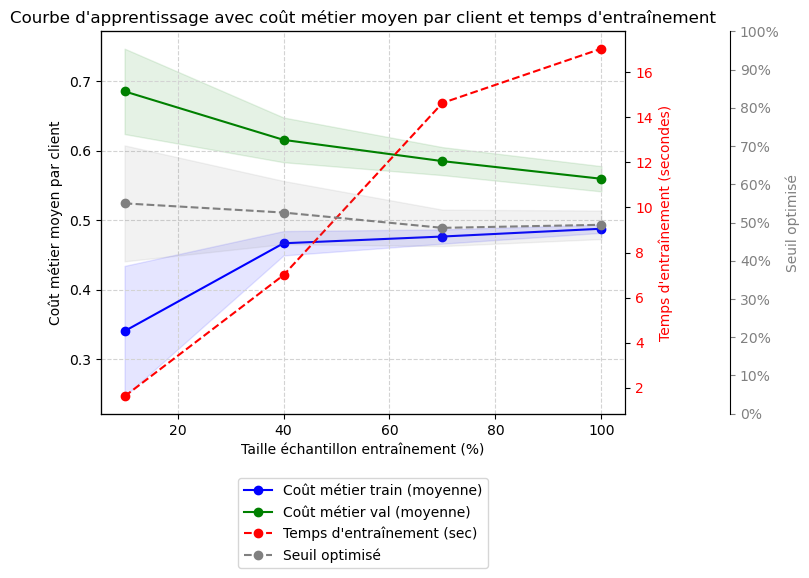

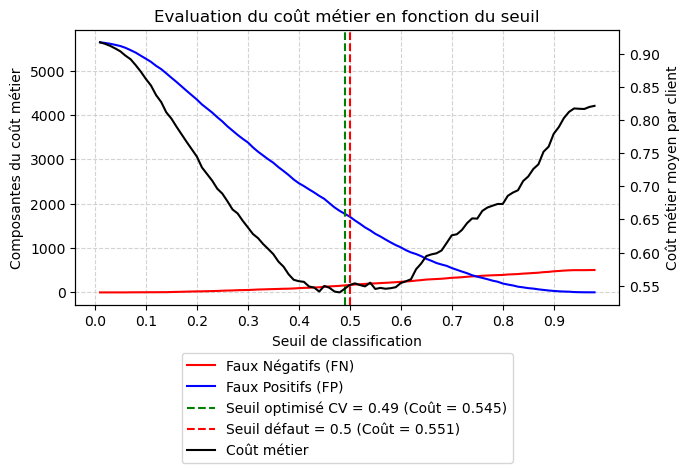

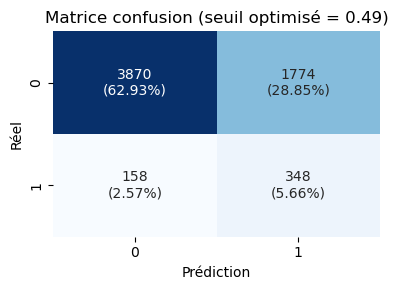

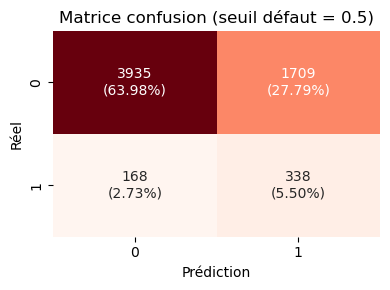

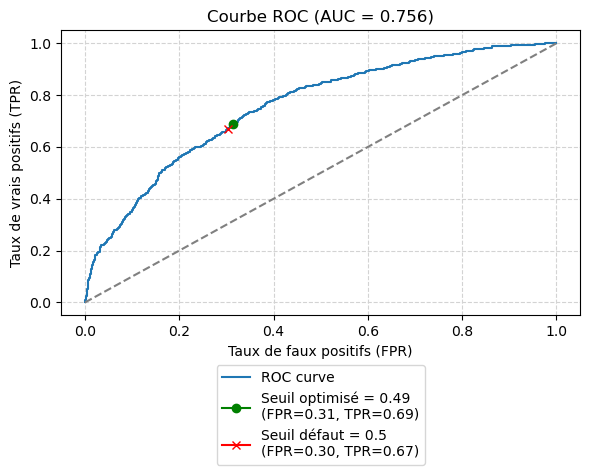

🏃 View run LR_MinMax_10_classweight_RSearchCV at: http://127.0.0.1:5000/#/experiments/829412219979995540/runs/96227d8545e5447caad0136908a952fb
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/829412219979995540


In [233]:
eval_model_(best_model, 'LR', 'LR_MinMax_10_classweight_RSearchCV', X_trainval, y_trainval, X_test, y_test, perf_tableaux_optim, "RandomizedSearchCV", best_params)

In [235]:
perf_tableaux_optim

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
0,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.56,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7


In [237]:
# -----------------------------
# RandomizedSearchCV LGBM
# -----------------------------
hyperparameter_LGBM = {
                  'model__n_estimators'    : randint(10, 500),   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : uniform(0.01, 0.5), #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : randint(1,10),      #profondeur max de chaque estimateur
                  'model__num_leaves'       : randint(10,100),   #nombre de feuilles dans chaque arbre
                  'model__subsample'       : uniform(0.5,0.5),   #proportion d'echantillons à utiliser pour chaque arbre
                  'model__reg_alpha'       : uniform(0,1),       #parametre de regularisation L1/L2
                  'model__reg_lambda'       : uniform(0,1)
                 }

LGBMm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LGBMClassifier(class_weight='balanced', random_state=42, verbose=-1))
])

start_rs_fit = time.time()

cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

random_search = RandomizedSearchCV(
    LGBMm_classweight,
    param_distributions=hyperparameter_LGBM,
    n_iter=10,
    scoring=cost_per_client_scorer,
    cv=cv,
    random_state=42,
    n_jobs=-1,
    verbose=0
)

random_search.fit(X_trainval, y_trainval)

end_rs_fit = time.time()
total_rs_fit_time = end_rs_fit - start_rs_fit

#Temps d'entrainement pour estimer les meilleurs hyperparametres
print("Time Fit to compute for Best Params (sec) :", round(total_rs_fit_time,1))

# Meilleur pipeline
best_model = random_search.best_estimator_
best_params = random_search.best_params_
print("Best Params :", best_params)

Time Fit for compute Best Params (sec) : 86.3
Best Params : {'model__learning_rate': 0.2259725093210579, 'model__max_depth': 1, 'model__n_estimators': 484, 'model__num_leaves': 68, 'model__reg_alpha': 0.3998609717152555, 'model__reg_lambda': 0.04666566321361543, 'model__subsample': 0.9868777594207296}


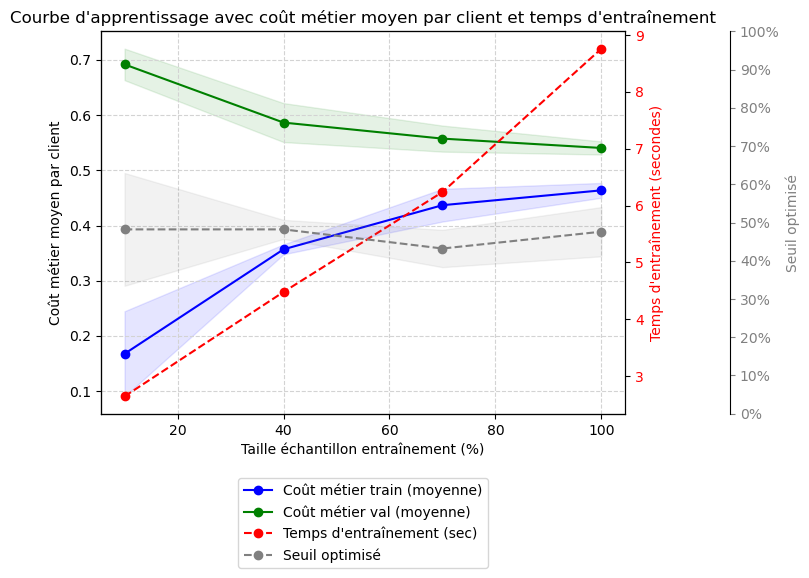

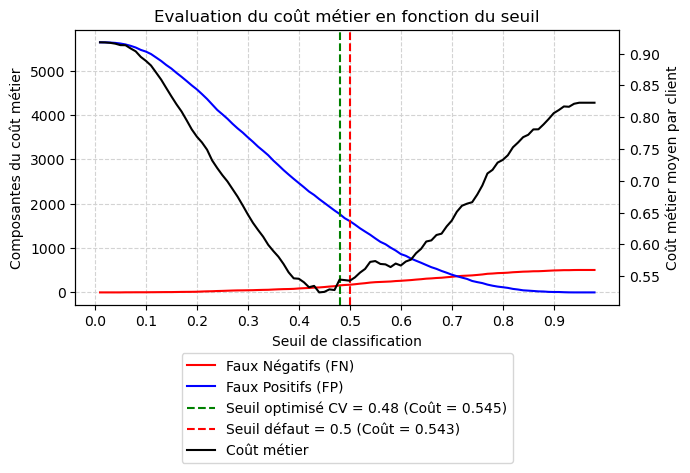

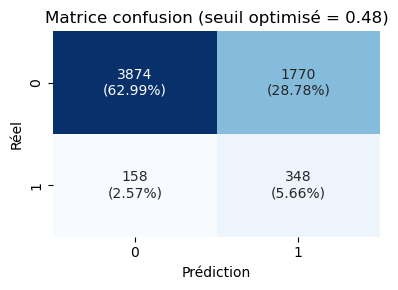

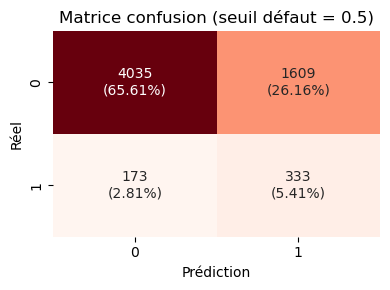

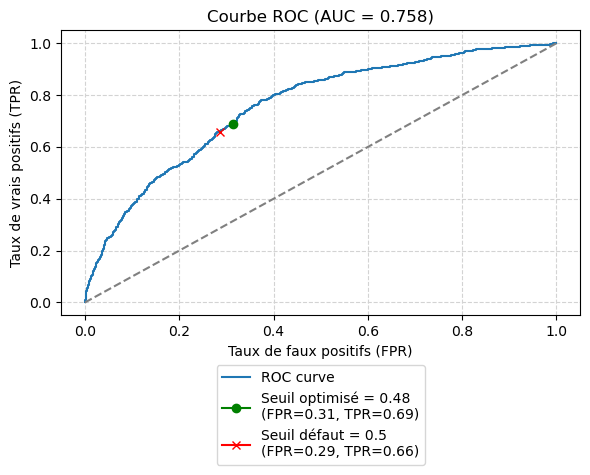

🏃 View run LGBM_MinMax_10_classweight_RSearchCV at: http://127.0.0.1:5000/#/experiments/829412219979995540/runs/64c5f29a998f4e09ab979237e7052189
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/829412219979995540


In [239]:
eval_model_(best_model, 'LGBM', 'LGBM_MinMax_10_classweight_RSearchCV', X_trainval, y_trainval, X_test, y_test, perf_tableaux_optim, "RandomizedSearchCV", best_params)

In [247]:
perf_tableaux_optim.sort_values(by = ["eval_cout_metier_optimal"], ascending = [True])

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
0,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.56,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7
1,LGBM,LGBM_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.48,0.064,0.54,0.012,0.551,0.010,0.749,9.1,0.545,0.543,-0.002,0.758,4.4


<b><u>Avec 100%</u></b>


In [249]:
mlflow.set_experiment("Simulations RandomizedSearch avec 100% données")

<Experiment: artifact_location='mlflow-artifacts:/443648004001849486', creation_time=1751004346332, experiment_id='443648004001849486', last_update_time=1751004346332, lifecycle_stage='active', name='Simulations RandomizedSearch avec 100% données', tags={}>

In [251]:
X_trainval, X_test, y_trainval, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

Time Fit to compute for Best Params (sec) : 1784.8
Best Params : {'model__C': 44.98432668969444, 'model__max_iter': 7507}


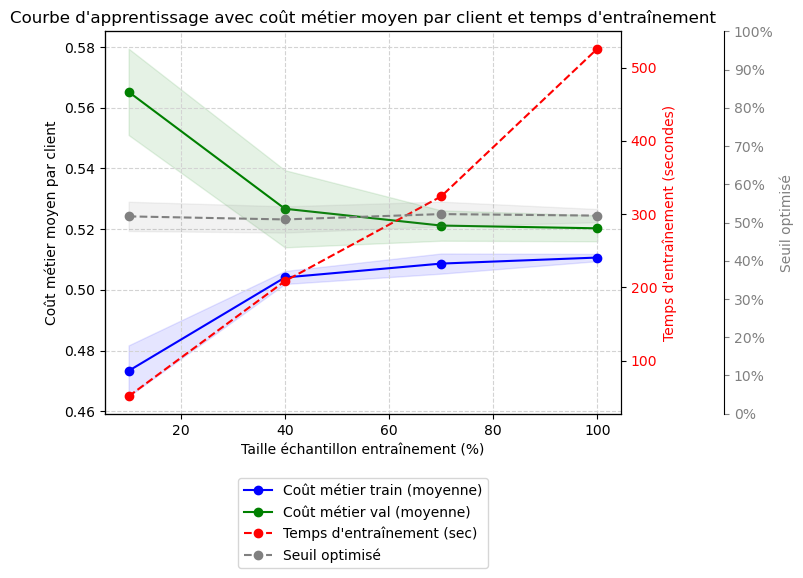

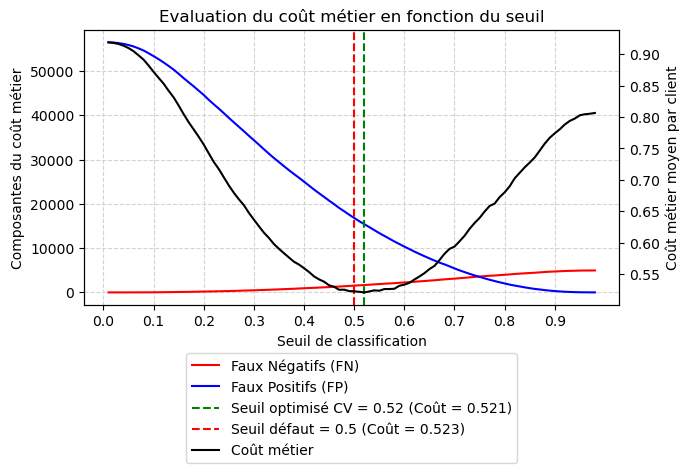

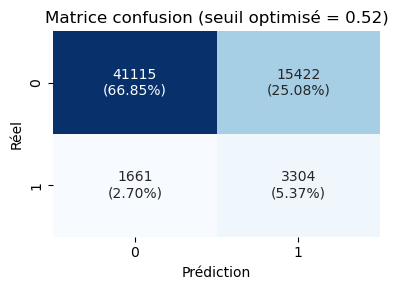

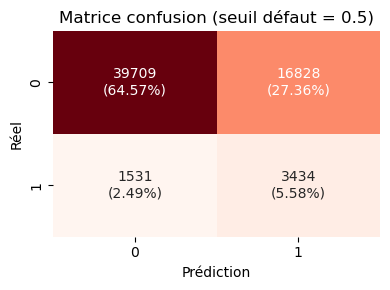

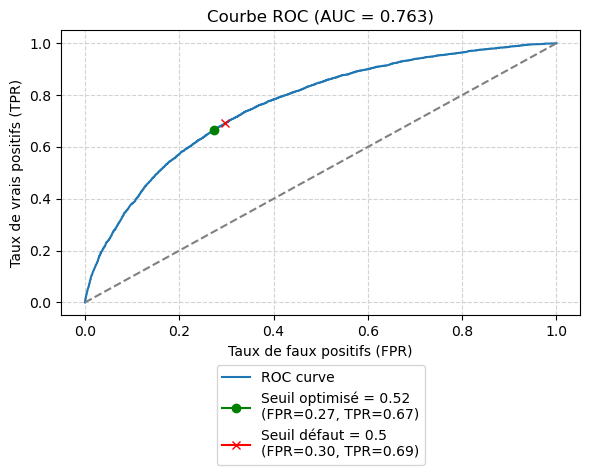

🏃 View run LR_MinMax_100_classweight_RSearchCV at: http://127.0.0.1:5000/#/experiments/443648004001849486/runs/045d534b2d014bb7b0f8c8afac0d3ccc
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/443648004001849486


In [259]:
# -----------------------------
# RandomizedSearchCV LR
# -----------------------------
hyperparameter_LR = {
                  'model__C'       : np.logspace(-3, 3, 50),                     #régularisation
                  'model__max_iter': randint(4000, 8000)             #nb max d'itération autorisé pour converger vers la solution
                 }

LRs_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LogisticRegression(class_weight='balanced', random_state=42, verbose=0))
])

start_rs_fit = time.time()

cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

random_search = RandomizedSearchCV(
    LRs_classweight,
    param_distributions=hyperparameter_LR,
    n_iter=10,
    scoring=cost_per_client_scorer,
    cv=cv,
    random_state=42,
    n_jobs=2,
    verbose=0
)

random_search.fit(X_trainval, y_trainval)

end_rs_fit = time.time()
total_rs_fit_time = end_rs_fit - start_rs_fit

#Temps d'entrainement pour estimer les meilleurs hyperparametres
print("Time Fit to compute for Best Params (sec) :", round(total_rs_fit_time,1))

# Meilleur pipeline
best_model = random_search.best_estimator_
best_params = random_search.best_params_
print("Best Params :", best_params)
eval_model_(best_model, 'LR', 'LR_MinMax_100_classweight_RSearchCV', X_trainval, y_trainval, X_test, y_test, perf_tableaux_optim, "RandomizedSearchCV", best_params)

In [260]:
perf_tableaux_optim

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
0,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.56,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7
1,LGBM,LGBM_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.48,0.064,0.54,0.012,0.551,0.010,0.749,9.1,0.545,0.543,-0.002,0.758,4.4
2,LR,LR_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.52,0.017,0.52,0.004,0.522,0.001,0.764,495.9,0.521,0.523,0.002,0.763,143.4


Time Fit to compute for Best Params (sec) : 414.2
Best Params : {'model__learning_rate': 0.12638567021515212, 'model__max_depth': 3, 'model__n_estimators': 373, 'model__num_leaves': 64, 'model__reg_alpha': 0.9832308858067882, 'model__reg_lambda': 0.4667628932479799, 'model__subsample': 0.9299702033681603}


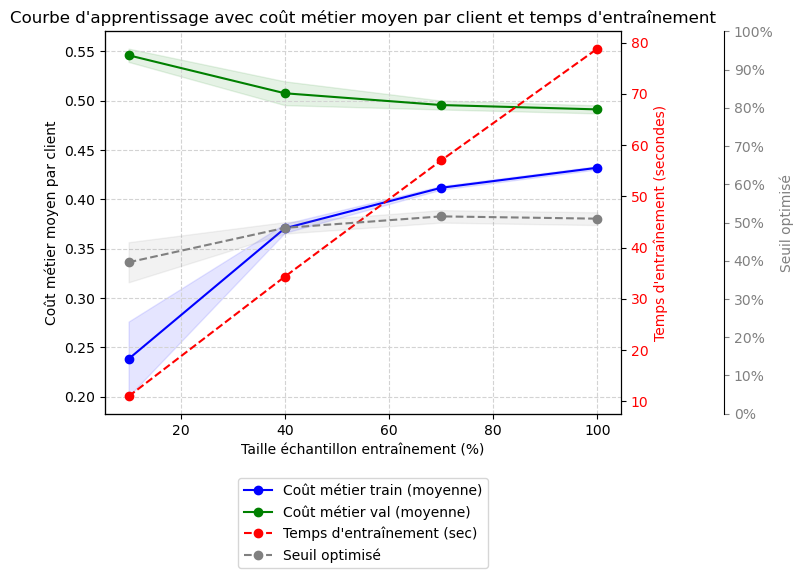

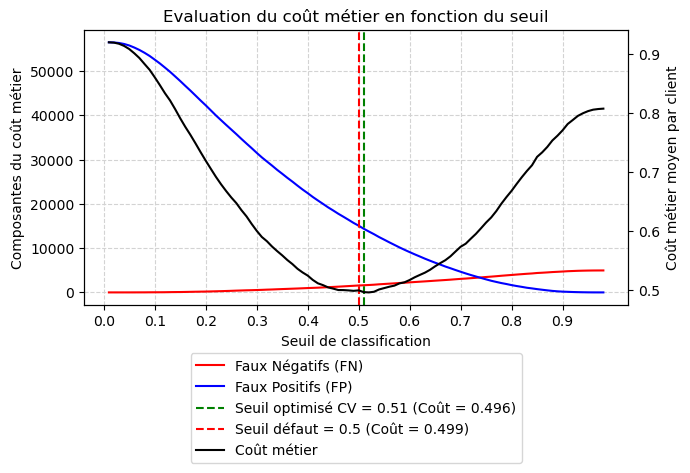

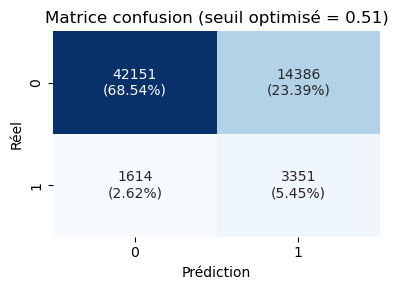

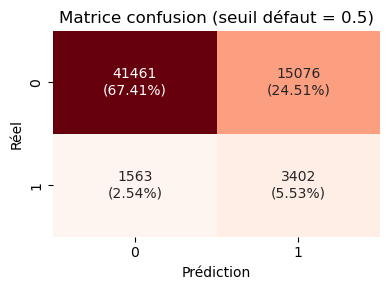

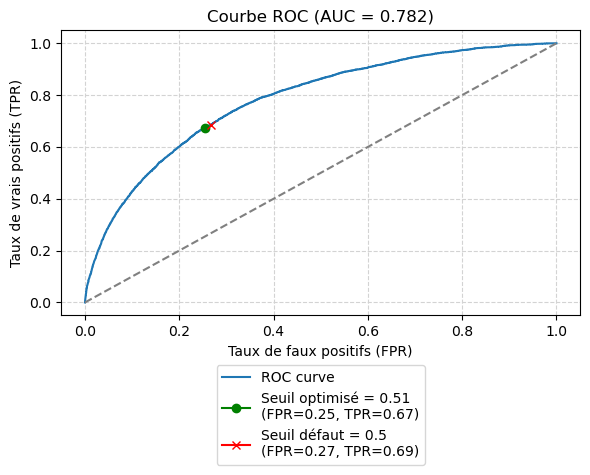

🏃 View run LGBM_MinMax_100_classweight_RSearchCV at: http://127.0.0.1:5000/#/experiments/443648004001849486/runs/b96e4ee969294b189af5f2075d995530
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/443648004001849486


In [261]:
# -----------------------------
# RandomizedSearchCV LGBM
# -----------------------------
hyperparameter_LGBM = {
                  'model__n_estimators'    : randint(10, 500),   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : uniform(0.01, 0.5), #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : randint(1,10),      #profondeur max de chaque estimateur
                  'model__num_leaves'       : randint(10,100),   #nombre de feuilles dans chaque arbre
                  'model__subsample'       : uniform(0.5,0.5),   #proportion d'echantillons à utiliser pour chaque arbre
                  'model__reg_alpha'       : uniform(0,1),       #parametre de regularisation L1/L2
                  'model__reg_lambda'       : uniform(0,1)
                 }

LGBMm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LGBMClassifier(class_weight='balanced', random_state=42, verbose=-1))
])

start_rs_fit = time.time()

cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

random_search = RandomizedSearchCV(
    LGBMm_classweight,
    param_distributions=hyperparameter_LGBM,
    n_iter=10,
    scoring=cost_per_client_scorer,
    cv=cv,
    random_state=42,
    n_jobs=2,
    verbose=0
)

random_search.fit(X_trainval, y_trainval)

end_rs_fit = time.time()
total_rs_fit_time = end_rs_fit - start_rs_fit

#Temps d'entrainement pour estimer les meilleurs hyperparametres
print("Time Fit to compute for Best Params (sec) :", round(total_rs_fit_time,1))

# Meilleur pipeline
best_model = random_search.best_estimator_
best_params = random_search.best_params_
print("Best Params :", best_params)
eval_model_(best_model, 'LGBM', 'LGBM_MinMax_100_classweight_RSearchCV', X_trainval, y_trainval, X_test, y_test, perf_tableaux_optim, "RandomizedSearchCV", best_params)

<b><u>Courbe d'apprentissage</u></b> :

|Situation | Coût train | Coût validation | Interprétation
| :----                             | :---     | :---  | :---        
| Bon apprentissage                 | Bas      | Bas   | Le modèle se généralise bien
| Overfitting (surapprentissage)    | Très bas | Élevé | Trop spécifique au train
| Underfitting (sous-apprentissage) | Élevé    | Élevé | Le modèle est trop simple

Le modèle semble bien apprendre : il devient moins optimiste sur train (le coût métier moyen par client augmente), mais gagne en robustesse sur validation (le coût moyen par client diminue), avec une bonne proximité des valeurs train/val au fur et à mesure que la taille de l'échantillon tend vers 100%.

<b><u>Matrice de confusion</u></b> :

|Cas | Nom | Intérptretation | Impact métier
| :----       | :---              | :---              | :---        
| TN          | Vrais négatifs    | Le modèle a correctement prédit que le client ne sera pas défaillant                | Bon
| TP          |  Vrais positifs   | Le modèle a correctement prédit que le client sera défaillant             | Bon
| FP          | Faux positifs     | Le modèle prédit une défaillance à tort pour le client (le client est sain, il aurait remboursé)                 | Mauvais pour le client – refus injustifié
| FN          | Faux négatifs     | Le modèle ne détecte pas une vrai défaillance pour le client (client qui ne rembourse pas)                 | Mauvais pour l’entreprise – perte financière

Interprétation avec seuil optimisé :
- Le modèle a correctement identifié 68,54% des clients comme non-défaillants (TN) (67,41% avec seuil defaut).
- Le modèle a identifié 23,39% des clients comme défaillants alors qu'ils ne le sont pas (FP) (24,51% avec seuil defaut).
- Le modèle a laissé passer 2.62% des clients réellement défaillants (FN) (2.54% avec seuil defaut).
- Le modèle a correctement identifié 5.45% des clients comme défaillants (TP) (5.53% avec seuil defaut).

<b><u>Courbe ROC-AUC</u></b> :

- TPR (True Positive Rate) : proportion de bons clients défaillants bien détectés par le modèle.
- FPR (False Positive Rate) : proportion de clients sains (non défaillants) mal prédits par le modèle comme étant à risque.
    
La courbe ROC-AUC montre :
- avec le <b>seuil optimisé (51%)</b> qui miminise le cout métier, le modèle a un TPR de 67% et un FPR de 25% : <b>le modèle détecte 67% de clients défaillants et se trompe sur 25% de clients sains</b>.
- avec le <b>seuil par dafaut (50%)</b> le modèle a un TPR de 69% et un FPR de 27% : <b>le modèle détecte 69% de clients défaillants et se trompe sur 27% de clients sains</b>.

In [262]:
perf_tableaux_optim

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
0,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.560,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7
1,LGBM,LGBM_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.48,0.064,0.540,0.012,0.551,0.010,0.749,9.1,0.545,0.543,-0.002,0.758,4.4
2,LR,LR_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.52,0.017,0.520,0.004,0.522,0.001,0.764,495.9,0.521,0.523,0.002,0.763,143.4
3,LGBM,LGBM_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,74.5,0.496,0.499,0.003,0.782,20.1


In [269]:
perf_tableaux_optim.sort_values(by = ["eval_cout_metier_optimal"], ascending = [True])

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
3,LGBM,LGBM_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,74.5,0.496,0.499,0.003,0.782,20.1
2,LR,LR_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.52,0.017,0.520,0.004,0.522,0.001,0.764,495.9,0.521,0.523,0.002,0.763,143.4
0,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.560,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7
1,LGBM,LGBM_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.48,0.064,0.540,0.012,0.551,0.010,0.749,9.1,0.545,0.543,-0.002,0.758,4.4


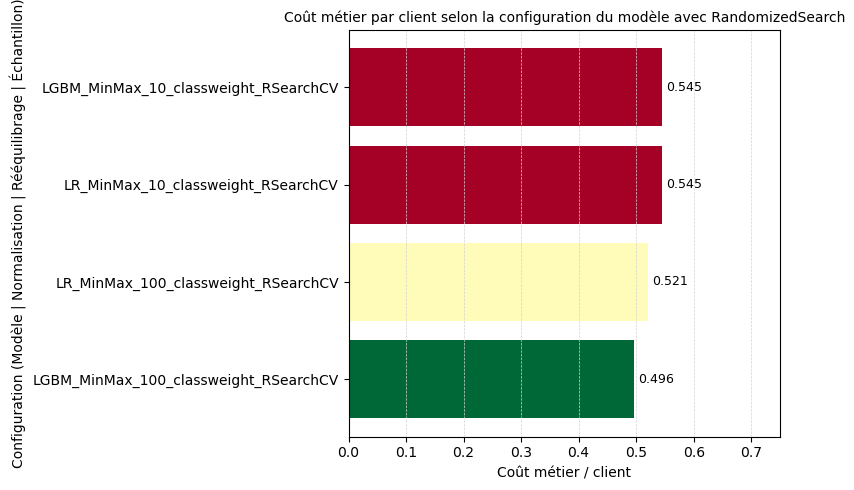

In [273]:
# Tri par coût métier
perf_tableaux_optim = perf_tableaux_optim.sort_values(by = ["eval_cout_metier_optimal"], ascending = [True]).reset_index(drop=True)
# Couleurs avec colormap
norm = Normalize(
    vmin=perf_tableaux_optim["eval_cout_metier_optimal"].min(),
    vmax=perf_tableaux_optim["eval_cout_metier_optimal"].max()
)
colors = [cm.RdYlGn_r(norm(val)) for val in perf_tableaux_optim["eval_cout_metier_optimal"]]

# Tracé horizontal
plt.figure(figsize=(8, 5))
bars = plt.barh(
    y=perf_tableaux_optim["configuration"],
    width=perf_tableaux_optim["eval_cout_metier_optimal"],
    color=colors
)

# Annotations à droite des barres
for bar in bars:
    width = bar.get_width()
    plt.annotate(f'{width:.3f}',
                 xy=(width, bar.get_y() + bar.get_height() / 2),
                 xytext=(3, 0),  # décalage horizontal
                 textcoords="offset points",
                 ha='left', va='center',
                 fontsize=9, color='black')

# Mise en forme
plt.title("Coût métier par client selon la configuration du modèle avec RandomizedSearch", fontsize=10)
plt.xlabel("Coût métier / client", fontsize=10)
plt.ylabel("Configuration (Modèle | Normalisation | Rééquilibrage | Échantillon)", fontsize=10)
plt.xlim(left=0.0, right=0.75)
plt.grid(True, axis='x', linestyle='--', color='lightgray', linewidth=0.5)
plt.tight_layout()

plt.show()

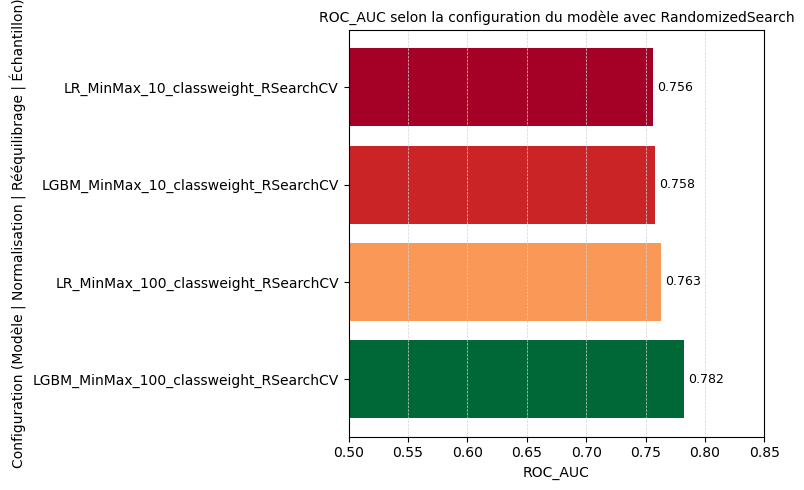

In [277]:
# Tri par coût métier
perf_tableaux_optim = perf_tableaux_optim.sort_values(by="eval_roc_auc", ascending=False).reset_index(drop=True)

# Couleurs avec colormap
norm = Normalize(
    vmin=perf_tableaux_optim["eval_roc_auc"].min(),
    vmax=perf_tableaux_optim["eval_roc_auc"].max()
)
colors = [cm.RdYlGn(norm(val)) for val in perf_tableaux_optim["eval_roc_auc"]]

# Tracé horizontal
plt.figure(figsize=(8, 5))
bars = plt.barh(
    y=perf_tableaux_optim["configuration"],
    width=perf_tableaux_optim["eval_roc_auc"],
    color=colors
)

# Annotations à droite des barres
for bar in bars:
    width = bar.get_width()
    plt.annotate(f'{width:.3f}',
                 xy=(width, bar.get_y() + bar.get_height() / 2),
                 xytext=(3, 0),  # décalage horizontal
                 textcoords="offset points",
                 ha='left', va='center',
                 fontsize=9, color='black')

# Mise en forme
plt.title("ROC_AUC selon la configuration du modèle avec RandomizedSearch", fontsize=10)
plt.xlabel("ROC_AUC", fontsize=10)
plt.ylabel("Configuration (Modèle | Normalisation | Rééquilibrage | Échantillon)", fontsize=10)
plt.xlim(left=0.5, right=0.85)
plt.grid(True, axis='x', linestyle='--', color='lightgray', linewidth=0.5)
plt.tight_layout()

plt.show()

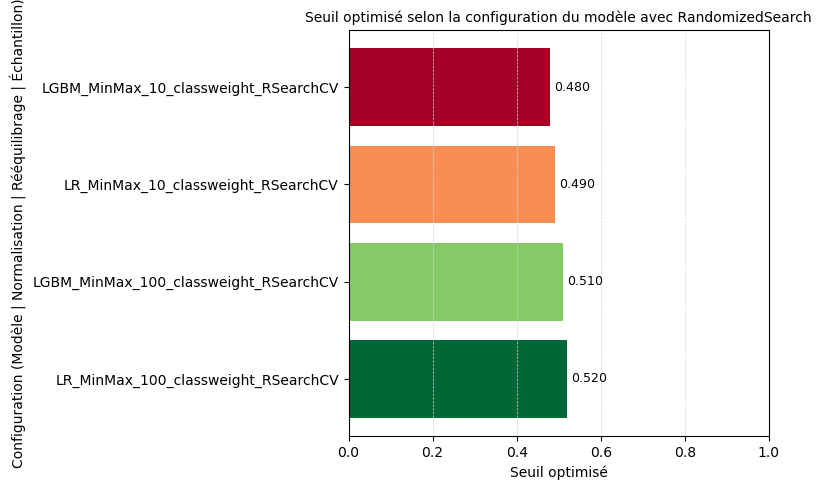

In [281]:
# Tri par coût métier
perf_tableaux_optim = perf_tableaux_optim.sort_values(by="cv_seuil_optimal", ascending=False).reset_index(drop=True)

# Couleurs avec colormap
norm = Normalize(
    vmin=perf_tableaux_optim["cv_seuil_optimal"].min(),
    vmax=perf_tableaux_optim["cv_seuil_optimal"].max()
)
colors = [cm.RdYlGn(norm(val)) for val in perf_tableaux_optim["cv_seuil_optimal"]]

# Tracé horizontal
plt.figure(figsize=(8, 5))
bars = plt.barh(
    y=perf_tableaux_optim["configuration"],
    width=perf_tableaux_optim["cv_seuil_optimal"],
    color=colors
)

# Annotations à droite des barres
for bar in bars:
    width = bar.get_width()
    plt.annotate(f'{width:.3f}',
                 xy=(width, bar.get_y() + bar.get_height() / 2),
                 xytext=(3, 0),  # décalage horizontal
                 textcoords="offset points",
                 ha='left', va='center',
                 fontsize=9, color='black')

# Mise en forme
plt.title("Seuil optimisé selon la configuration du modèle avec RandomizedSearch", fontsize=10)
plt.xlabel("Seuil optimisé", fontsize=10)
plt.ylabel("Configuration (Modèle | Normalisation | Rééquilibrage | Échantillon)", fontsize=10)
plt.xlim(left=0.0, right=1.0)
plt.grid(True, axis='x', linestyle='--', color='lightgray', linewidth=0.5)
plt.tight_layout()

plt.show()

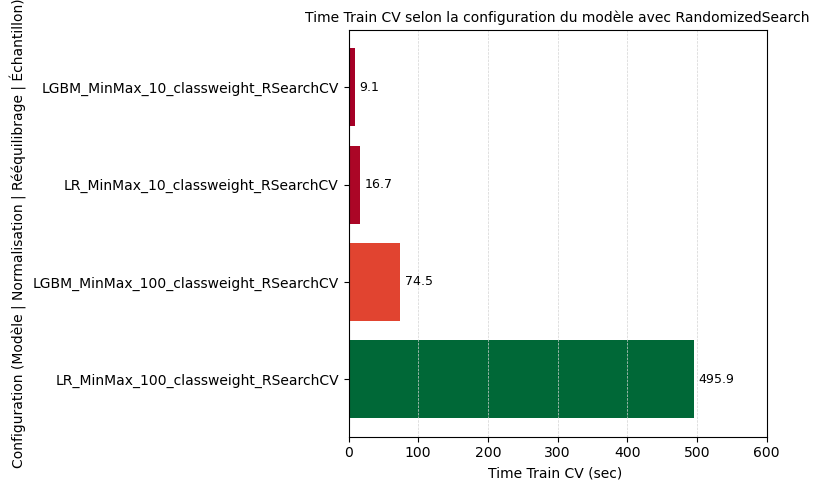

In [287]:
# Tri par coût métier
perf_tableaux_optim = perf_tableaux_optim.sort_values(by="cv_temps_sec", ascending=False).reset_index(drop=True)

# Couleurs avec colormap
norm = Normalize(
    vmin=perf_tableaux_optim["cv_temps_sec"].min(),
    vmax=perf_tableaux_optim["cv_temps_sec"].max()
)
colors = [cm.RdYlGn(norm(val)) for val in perf_tableaux_optim["cv_temps_sec"]]

# Tracé horizontal
plt.figure(figsize=(8, 5))
bars = plt.barh(
    y=perf_tableaux_optim["configuration"],
    width=perf_tableaux_optim["cv_temps_sec"],
    color=colors
)

# Annotations à droite des barres
for bar in bars:
    width = bar.get_width()
    plt.annotate(f'{width:.1f}',
                 xy=(width, bar.get_y() + bar.get_height() / 2),
                 xytext=(3, 0),  # décalage horizontal
                 textcoords="offset points",
                 ha='left', va='center',
                 fontsize=9, color='black')

# Mise en forme
plt.title("Time Train CV selon la configuration du modèle avec RandomizedSearch", fontsize=10)
plt.xlabel("Time Train CV (sec) ", fontsize=10)
plt.ylabel("Configuration (Modèle | Normalisation | Rééquilibrage | Échantillon)", fontsize=10)
plt.xlim(left=0.0, right=600)
plt.grid(True, axis='x', linestyle='--', color='lightgray', linewidth=0.5)
plt.tight_layout()

plt.show()

In [315]:
perf_tableaux_optim.sort_values(by = ["eval_cout_metier_optimal"], ascending = [True])

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
1,LGBM,LGBM_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,74.5,0.496,0.499,0.003,0.782,20.1
0,LR,LR_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.52,0.017,0.520,0.004,0.522,0.001,0.764,495.9,0.521,0.523,0.002,0.763,143.4
2,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.560,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7
3,LGBM,LGBM_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.48,0.064,0.540,0.012,0.551,0.010,0.749,9.1,0.545,0.543,-0.002,0.758,4.4


In [317]:
df_best_perf_time = pd.DataFrame()
row_index = df_best_perf_time.shape[0]
df_best_perf_time.loc[row_index, 'Model'] = "LGBM"
df_best_perf_time.loc[row_index, 'configuration'] = "LGBM_MinMax_100_classweight_RSearchCV"
df_best_perf_time.loc[row_index, 'tuning'] = "RandomizedSearchCV"
df_best_perf_time.loc[row_index, 'cv_temps_sec'] = 74.5
df_best_perf_time.loc[row_index, 'fit_time_sec'] = 414.2
row_index+=1
df_best_perf_time.loc[row_index, 'Model'] = "LR"
df_best_perf_time.loc[row_index, 'configuration'] = "LR_MinMax_100_classweight_RSearchCV"
df_best_perf_time.loc[row_index, 'tuning'] = "RandomizedSearchCV"
df_best_perf_time.loc[row_index, 'cv_temps_sec'] = 495.9
df_best_perf_time.loc[row_index, 'fit_time_sec'] = 1784.8
row_index+=1
df_best_perf_time.loc[row_index, 'Model'] = "LGBM"
df_best_perf_time.loc[row_index, 'configuration'] = "LR_MinMax_10_classweight_RSearchCV"
df_best_perf_time.loc[row_index, 'tuning'] = "RandomizedSearchCV"
df_best_perf_time.loc[row_index, 'cv_temps_sec'] = 9.1
df_best_perf_time.loc[row_index, 'fit_time_sec'] = 86.3
row_index+=1
df_best_perf_time.loc[row_index, 'Model'] = "LR"
df_best_perf_time.loc[row_index, 'configuration'] = "LR_MinMax_10_classweight_RSearchCV"
df_best_perf_time.loc[row_index, 'tuning'] = "RandomizedSearchCV"
df_best_perf_time.loc[row_index, 'cv_temps_sec'] = 16.7
df_best_perf_time.loc[row_index, 'fit_time_sec'] = 175.6

In [319]:
df_best_perf_time

,Model,configuration,tuning,cv_temps_sec,fit_time_sec
0,LGBM,LGBM_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,74.5,414.2
1,LR,LR_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,495.9,1784.8
2,LGBM,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,9.1,86.3
3,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,16.7,175.6


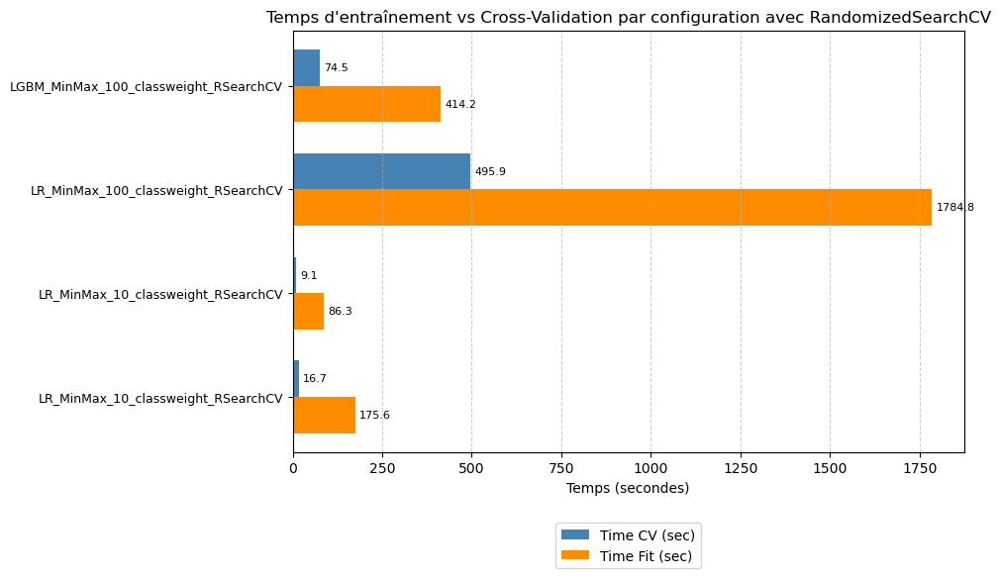

In [327]:
# Préparation pour barres horizontales
y = np.arange(len(df_best_perf_time))  # positions verticales
height = 0.35  # hauteur de chaque barre

fig, ax = plt.subplots(figsize=(10, 6))
bar1 = ax.barh(y - height/2, df_best_perf_time['cv_temps_sec'], height, label='Time CV (sec)', color='steelblue')
bar2 = ax.barh(y + height/2, df_best_perf_time['fit_time_sec'], height, label='Time Fit (sec)', color='darkorange')

# Configuration graphique
ax.set_xlabel('Temps (secondes)')
ax.set_title("Temps d'entraînement vs Cross-Validation par configuration avec RandomizedSearchCV")
ax.set_yticks(y)
ax.set_yticklabels(df_best_perf_time['configuration'], fontsize=9)
ax.invert_yaxis()  # meilleure lisibilité du haut vers le bas
ax.legend(loc='upper center', bbox_to_anchor=(0.5, -0.15))
ax.grid(axis='x', linestyle='--', alpha=0.6)

# Valeurs sur les barres
for bars in [bar1, bar2]:
    for bar in bars:
        width = bar.get_width()
        ax.annotate(f'{width:.1f}', xy=(width, bar.get_y() + bar.get_height()/2),
                    xytext=(3, 0), textcoords="offset points",
                    ha='left', va='center', fontsize=8)

plt.tight_layout()
plt.show()

On observe qu'avec la totalité des données :
- les modèles obtienent de meilleurs résultats
- les meilleurs hyperaparamtres trouvés avec 10% et 100% des données ne sont pas identiques : on ne peut donc pas appliqué le meme jeu de valeurs des hyperparametres trouvé avec 10% des données sur 100% des données
- LGBM obtient le meilleur cout métier par client (0.496) et score roc-auc (0.782) et un temps d'entrainement et de cross-validation réduit

C'est donc le modèle LGBM qui sera conservé pour fine-tuning avec GridSearch

#### <font color="blue" size=3>5.2.2 Utilisation de GridSearch </font>

In [330]:
mlflow.set_experiment("Simulations GridSearch avec 100% données")

<Experiment: artifact_location='mlflow-artifacts:/861686349216485461', creation_time=1751014159060, experiment_id='861686349216485461', last_update_time=1751014159060, lifecycle_stage='active', name='Simulations GridSearch avec 100% données', tags={}>

On va réaliser un fine-tuning autour des meilleurs hyperparametres

In [343]:
gc.collect() #vide la mémoire

0

Time Fit to compute for Best Params (sec) : 13596.6
Best Params : {'model__colsample_bytree': 0.8, 'model__learning_rate': 0.11, 'model__max_depth': 3, 'model__n_estimators': 350, 'model__num_leaves': 48, 'model__reg_alpha': 0.98, 'model__reg_lambda': 0.47, 'model__subsample': 0.9}


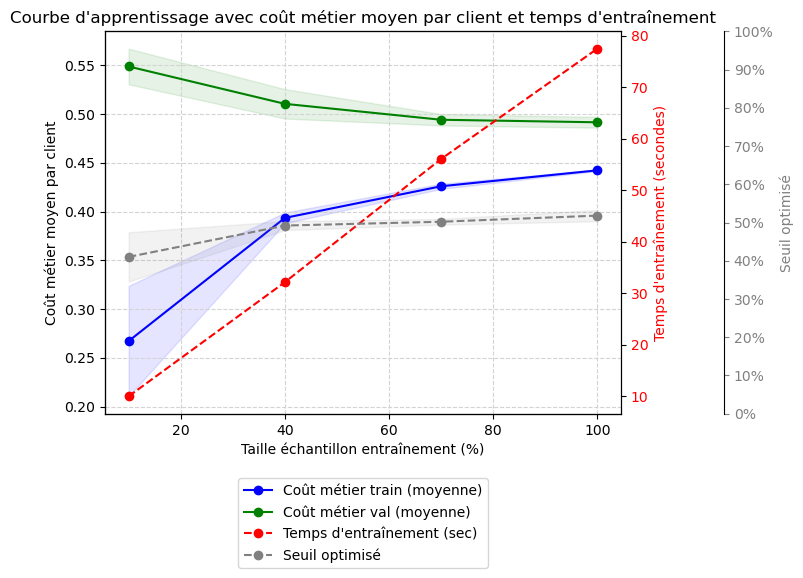

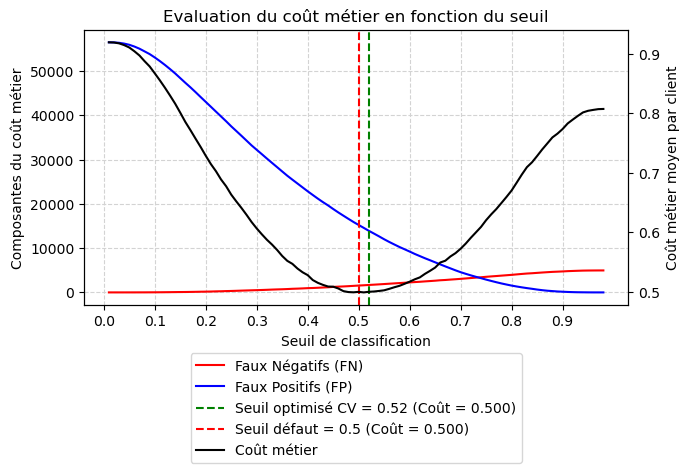

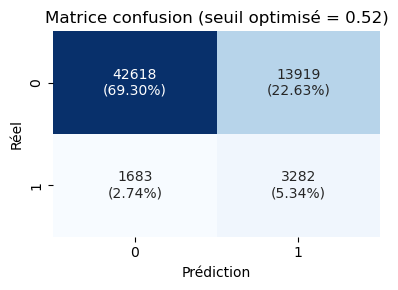

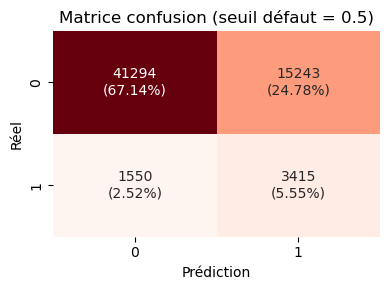

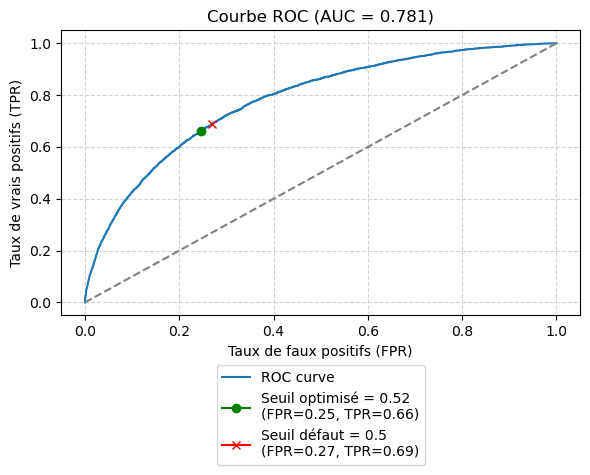

🏃 View run LGBM_MinMax_100_classweight_GSearchCV at: http://127.0.0.1:5000/#/experiments/861686349216485461/runs/a706e03080bd432cb5f4d5d1d8dc74ad
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/861686349216485461


In [347]:
# -----------------------------
# GridSearch LGBM
# -----------------------------
hyperparameter_LGBM = {
    'model__n_estimators': [350, 375],           # 2 valeurs proches de l’optimum
    'model__learning_rate': [0.11, 0.126],       # 2 valeurs proches
    'model__max_depth': [3, 4],                   # petite variation
    'model__num_leaves': [48, 64],                # 2 valeurs autour du best
    'model__subsample': [0.9, 0.93],              # 2 valeurs proches
    'model__colsample_bytree': [0.8, 0.9, 1.0],  # tester 3 valeurs (pour tester l’effet du sous-échantillonnage features)
    'model__reg_alpha': [0.9, 0.98],              # régularisation L1, 2 valeurs
    'model__reg_lambda': [0.4, 0.47]               # régularisation L2, 2 valeurs

                 }

LGBMm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LGBMClassifier(class_weight='balanced', random_state=42, verbose=-1))
])

start_rs_fit = time.time()

cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

grid_search = GridSearchCV(
    estimator=LGBMm_classweight,
    param_grid=hyperparameter_LGBM,
    scoring=cost_per_client_scorer,
    cv=cv,
    n_jobs=4,
    verbose=0
)

grid_search.fit(X_trainval, y_trainval)

end_rs_fit = time.time()
total_rs_fit_time = end_rs_fit - start_rs_fit

#Temps d'entrainement pour estimer les meilleurs hyperparametres
print("Time Fit to compute for Best Params (sec) :", round(total_rs_fit_time,1))

# Meilleur pipeline
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_
print("Best Params :", best_params)
eval_model_(best_model, 'LGBM', 'LGBM_MinMax_100_classweight_GSearchCV', X_trainval, y_trainval, X_test, y_test, perf_tableaux_optim, "GridSearchCV", best_params)

In [363]:
perf_tableaux_optim.sort_values(by = ["eval_cout_metier_optimal"], ascending = [True])

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
1,LGBM,LGBM_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,74.5,0.496,0.499,0.003,0.782,20.1
4,LGBM,LGBM_MinMax_100_classweight_GSearchCV,GridSearchCV,0.52,0.015,0.492,0.006,0.493,0.002,0.783,69.1,0.500,0.500,-0.000,0.781,20.1
0,LR,LR_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.52,0.017,0.520,0.004,0.522,0.001,0.764,495.9,0.521,0.523,0.002,0.763,143.4
2,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.560,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7
3,LGBM,LGBM_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.48,0.064,0.540,0.012,0.551,0.010,0.749,9.1,0.545,0.543,-0.002,0.758,4.4


le fine-tuning avec GridSearchCV ne donne pas de meilleurs résultats sur le cout métier Vs RandomizedSearch.<br>
On reteste le GridSearchCV avec les memes valeurs pour confirmer les résultats

Time Fit to compute for Best Params (sec) : 63.8
Best Params : {'model__learning_rate': 0.126, 'model__max_depth': 3, 'model__n_estimators': 375, 'model__num_leaves': 64, 'model__reg_alpha': 0.98, 'model__reg_lambda': 0.47, 'model__subsample': 0.93}


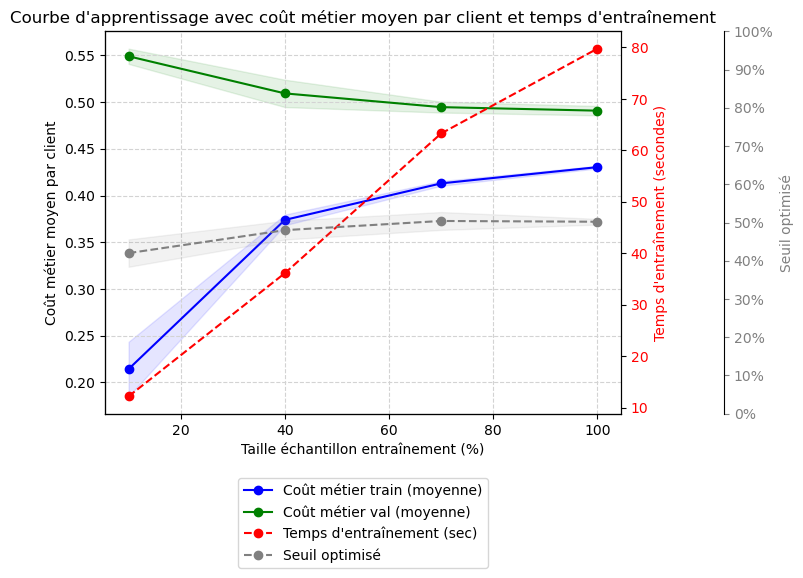

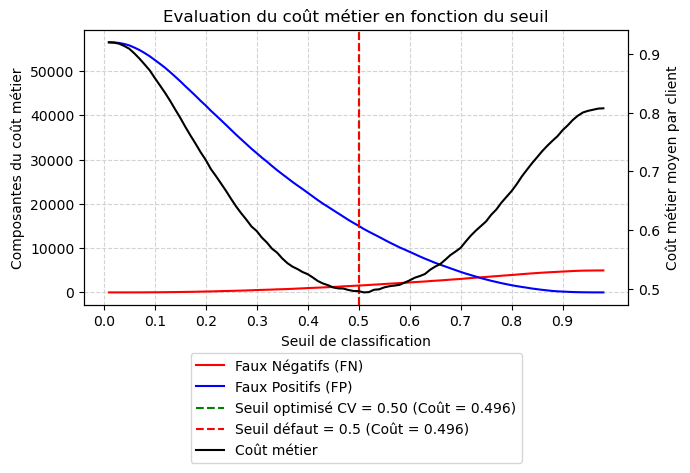

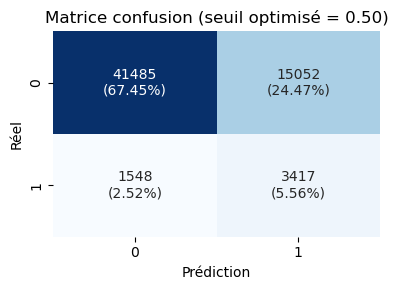

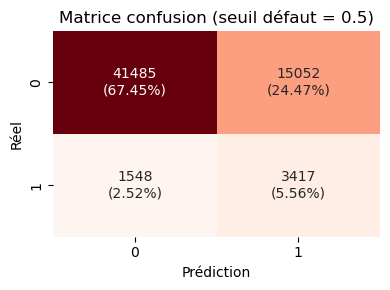

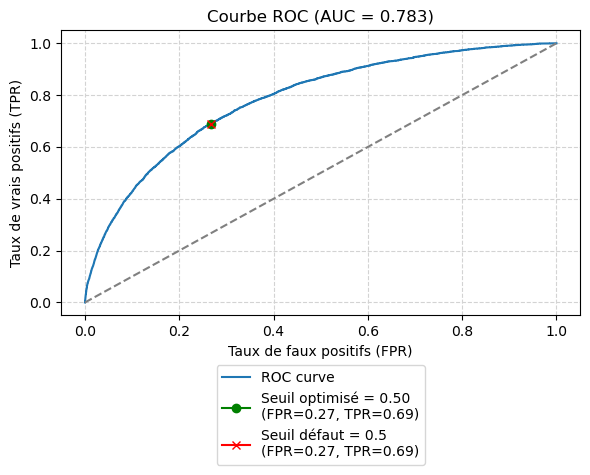

🏃 View run LGBM_MinMax_100_classweight_GSearchCV_v2 at: http://127.0.0.1:5000/#/experiments/861686349216485461/runs/59c4e3c3897045c0a1674f6049319c31
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/861686349216485461


In [365]:
# -----------------------------
# GridSearch LGBM
# -----------------------------
hyperparameter_LGBM = {
    'model__n_estimators': [375],           
    'model__learning_rate': [0.126],       
    'model__max_depth': [3],                  
    'model__num_leaves': [64],               
    'model__subsample': [0.93],              
    'model__reg_alpha': [0.98],              
    'model__reg_lambda': [0.47]             

                 }

LGBMm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LGBMClassifier(class_weight='balanced', random_state=42, verbose=-1))
])

start_rs_fit = time.time()

cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

grid_search = GridSearchCV(
    estimator=LGBMm_classweight,
    param_grid=hyperparameter_LGBM,
    scoring=cost_per_client_scorer,
    cv=cv,
    n_jobs=4,
    verbose=0
)

grid_search.fit(X_trainval, y_trainval)

end_rs_fit = time.time()
total_rs_fit_time = end_rs_fit - start_rs_fit

#Temps d'entrainement pour estimer les meilleurs hyperparametres
print("Time Fit to compute for Best Params (sec) :", round(total_rs_fit_time,1))

# Meilleur pipeline
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_
print("Best Params :", best_params)
eval_model_(best_model, 'LGBM', 'LGBM_MinMax_100_classweight_GSearchCV_v2', X_trainval, y_trainval, X_test, y_test, perf_tableaux_optim, "GridSearchCV", best_params)

In [368]:
perf_tableaux_optim.sort_values(by = ["eval_cout_metier_optimal"], ascending = [True])

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
1,LGBM,LGBM_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,74.5,0.496,0.499,0.003,0.782,20.1
5,LGBM,LGBM_MinMax_100_classweight_GSearchCV_v2,GridSearchCV,0.50,0.007,0.491,0.005,0.492,0.001,0.784,76.1,0.496,0.496,0.000,0.783,20.7
4,LGBM,LGBM_MinMax_100_classweight_GSearchCV,GridSearchCV,0.52,0.015,0.492,0.006,0.493,0.002,0.783,69.1,0.500,0.500,-0.000,0.781,20.1
0,LR,LR_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.52,0.017,0.520,0.004,0.522,0.001,0.764,495.9,0.521,0.523,0.002,0.763,143.4
2,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.560,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7
3,LGBM,LGBM_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.48,0.064,0.540,0.012,0.551,0.010,0.749,9.1,0.545,0.543,-0.002,0.758,4.4


Time Fit to compute for Best Params (sec) : 61.9
Best Params : {'model__learning_rate': 0.12638567021515212, 'model__max_depth': 3, 'model__n_estimators': 373, 'model__num_leaves': 64, 'model__reg_alpha': 0.9832308858067882, 'model__reg_lambda': 0.4667628932479799, 'model__subsample': 0.9299702033681603}


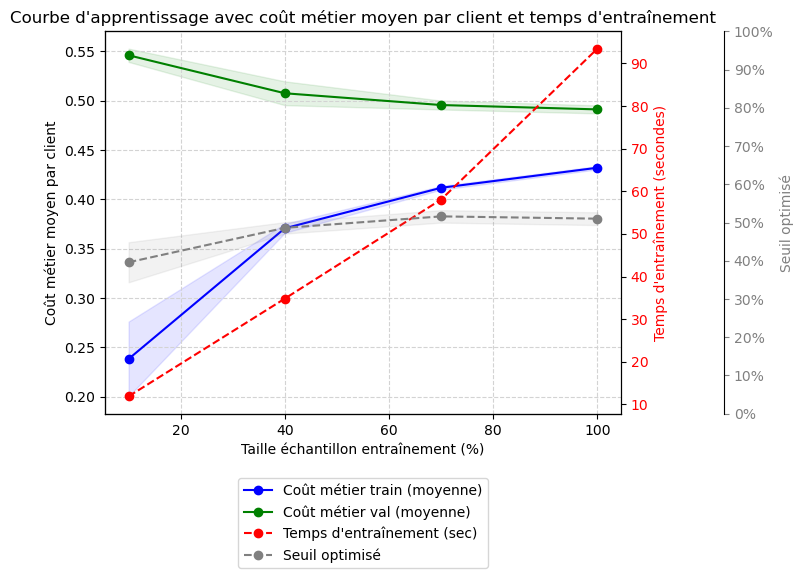

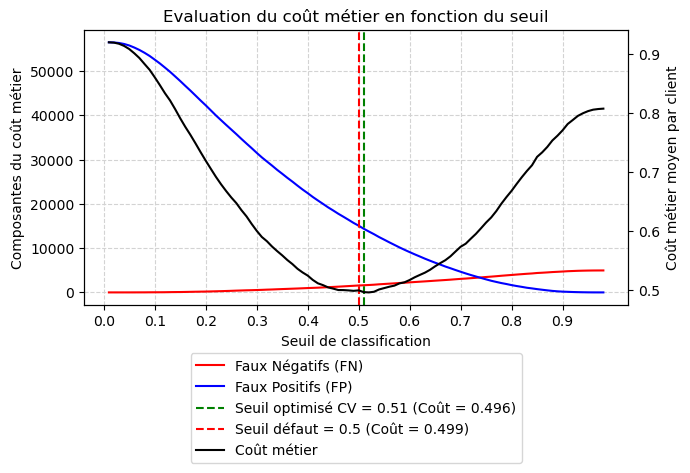

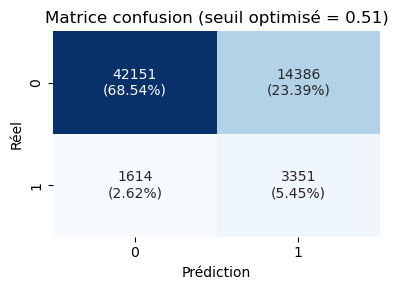

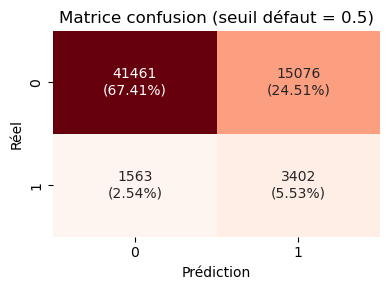

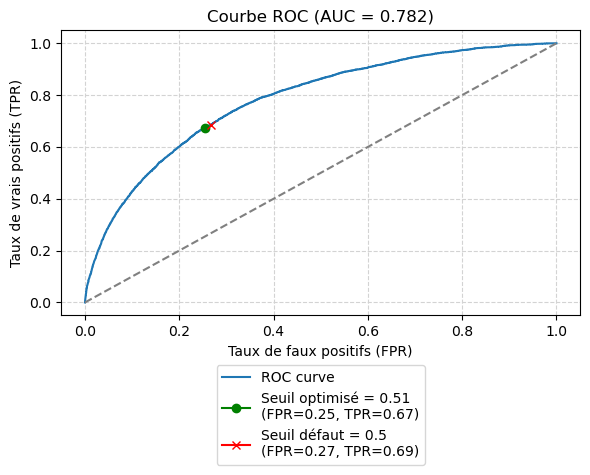

🏃 View run LGBM_MinMax_100_classweight_GSearchCV_v3 at: http://127.0.0.1:5000/#/experiments/861686349216485461/runs/ed506ac1c29e4f95977c46840141c92e
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/861686349216485461


In [370]:
# -----------------------------
# GridSearch LGBM
# -----------------------------
hyperparameter_LGBM = {
    'model__n_estimators': [373],           
    'model__learning_rate': [0.12638567021515212],       
    'model__max_depth': [3],                  
    'model__num_leaves': [64],               
    'model__subsample': [0.9299702033681603],              
    'model__reg_alpha': [0.9832308858067882],              
    'model__reg_lambda': [0.4667628932479799]             

                 }

LGBMm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LGBMClassifier(class_weight='balanced', random_state=42, verbose=-1))
])

start_rs_fit = time.time()

cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

grid_search = GridSearchCV(
    estimator=LGBMm_classweight,
    param_grid=hyperparameter_LGBM,
    scoring=cost_per_client_scorer,
    cv=cv,
    n_jobs=4,
    verbose=0
)

grid_search.fit(X_trainval, y_trainval)

end_rs_fit = time.time()
total_rs_fit_time = end_rs_fit - start_rs_fit

#Temps d'entrainement pour estimer les meilleurs hyperparametres
print("Time Fit to compute for Best Params (sec) :", round(total_rs_fit_time,1))

# Meilleur pipeline
best_model = grid_search.best_estimator_
best_params = grid_search.best_params_
print("Best Params :", best_params)
eval_model_(best_model, 'LGBM', 'LGBM_MinMax_100_classweight_GSearchCV_v3', X_trainval, y_trainval, X_test, y_test, perf_tableaux_optim, "GridSearchCV", best_params)

In [372]:
perf_tableaux_optim.sort_values(by = ["eval_cout_metier_optimal"], ascending = [True])

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
1,LGBM,LGBM_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,74.5,0.496,0.499,0.003,0.782,20.1
5,LGBM,LGBM_MinMax_100_classweight_GSearchCV_v2,GridSearchCV,0.50,0.007,0.491,0.005,0.492,0.001,0.784,76.1,0.496,0.496,0.000,0.783,20.7
6,LGBM,LGBM_MinMax_100_classweight_GSearchCV_v3,GridSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,78.8,0.496,0.499,0.003,0.782,20.9
4,LGBM,LGBM_MinMax_100_classweight_GSearchCV,GridSearchCV,0.52,0.015,0.492,0.006,0.493,0.002,0.783,69.1,0.500,0.500,-0.000,0.781,20.1
0,LR,LR_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.52,0.017,0.520,0.004,0.522,0.001,0.764,495.9,0.521,0.523,0.002,0.763,143.4
2,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.560,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7
3,LGBM,LGBM_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.48,0.064,0.540,0.012,0.551,0.010,0.749,9.1,0.545,0.543,-0.002,0.758,4.4


In [372]:
perf_tableaux_optim.sort_values(by = ["eval_cout_metier_optimal"], ascending = [True])

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
1,LGBM,LGBM_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,74.5,0.496,0.499,0.003,0.782,20.1
5,LGBM,LGBM_MinMax_100_classweight_GSearchCV_v2,GridSearchCV,0.50,0.007,0.491,0.005,0.492,0.001,0.784,76.1,0.496,0.496,0.000,0.783,20.7
6,LGBM,LGBM_MinMax_100_classweight_GSearchCV_v3,GridSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,78.8,0.496,0.499,0.003,0.782,20.9
4,LGBM,LGBM_MinMax_100_classweight_GSearchCV,GridSearchCV,0.52,0.015,0.492,0.006,0.493,0.002,0.783,69.1,0.500,0.500,-0.000,0.781,20.1
0,LR,LR_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.52,0.017,0.520,0.004,0.522,0.001,0.764,495.9,0.521,0.523,0.002,0.763,143.4
2,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.560,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7
3,LGBM,LGBM_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.48,0.064,0.540,0.012,0.551,0.010,0.749,9.1,0.545,0.543,-0.002,0.758,4.4


In [376]:
perf_tableaux_optim_lgbm = pd.DataFrame()
row_index = perf_tableaux_optim_lgbm.shape[0]
perf_tableaux_optim_lgbm.loc[row_index, 'Model'] = "LGBM"
perf_tableaux_optim_lgbm.loc[row_index, 'configuration'] = "LGBM_MinMax_100_classweight_RSearchCV"
perf_tableaux_optim_lgbm.loc[row_index, 'tuning'] = "RandomizedSearchCV"
perf_tableaux_optim_lgbm.loc[row_index, 'cv_seuil_optimal'] = 0.51
perf_tableaux_optim_lgbm.loc[row_index, 'eval_roc_auc'] = 0.782	
perf_tableaux_optim_lgbm.loc[row_index, 'eval_cout_metier_optimal'] = 0.496
perf_tableaux_optim_lgbm.loc[row_index, 'cv_temps_sec'] = 74.5
perf_tableaux_optim_lgbm.loc[row_index, 'fit_time_sec'] = 414.2
row_index+=1
perf_tableaux_optim_lgbm.loc[row_index, 'Model'] = "LGBM"
perf_tableaux_optim_lgbm.loc[row_index, 'configuration'] = "LGBM_MinMax_100_classweight_GSearchCV_finetuning"
perf_tableaux_optim_lgbm.loc[row_index, 'tuning'] = "GridSearchCV"
perf_tableaux_optim_lgbm.loc[row_index, 'cv_seuil_optimal'] = 0.52
perf_tableaux_optim_lgbm.loc[row_index, 'eval_roc_auc'] = 0.781	
perf_tableaux_optim_lgbm.loc[row_index, 'eval_cout_metier_optimal'] = 0.500	
perf_tableaux_optim_lgbm.loc[row_index, 'cv_temps_sec'] = 69.1
perf_tableaux_optim_lgbm.loc[row_index, 'fit_time_sec'] = 13596.6
row_index+=1
perf_tableaux_optim_lgbm.loc[row_index, 'Model'] = "LGBM"
perf_tableaux_optim_lgbm.loc[row_index, 'configuration'] = "LGBM_MinMax_100_classweight_GSearchCV=RSearchCV"
perf_tableaux_optim_lgbm.loc[row_index, 'tuning'] = "GridSearchCV"
perf_tableaux_optim_lgbm.loc[row_index, 'cv_seuil_optimal'] = 0.51
perf_tableaux_optim_lgbm.loc[row_index, 'eval_roc_auc'] = 0.782
perf_tableaux_optim_lgbm.loc[row_index, 'eval_cout_metier_optimal'] = 0.496	
perf_tableaux_optim_lgbm.loc[row_index, 'cv_temps_sec'] = 78.8	
perf_tableaux_optim_lgbm.loc[row_index, 'fit_time_sec'] = 61.9

In [378]:
perf_tableaux_optim_lgbm

,Model,configuration,tuning,cv_seuil_optimal,eval_roc_auc,eval_cout_metier_optimal,cv_temps_sec,fit_time_sec
0,LGBM,LGBM_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.51,0.782,0.496,74.5,414.2
1,LGBM,LGBM_MinMax_100_classweight_GSearchCV_finetuning,GridSearchCV,0.52,0.781,0.500,69.1,13596.6
2,LGBM,LGBM_MinMax_100_classweight_GSearchCV=RSearchCV,GridSearchCV,0.51,0.782,0.496,78.8,61.9


#### <font color="blue" size=3>5.2.3 Features Importance  </font>

Analysons l'impact des variables avec la features importance.

Feature Importance Computed with SHAP Values :
- Features importance global = 100% du dataset<br>
- Features importance local  = sur 1 client<br>

In [380]:
# -----------------------------
# GridSearch LGBM
# -----------------------------
hyperparameter_LGBM = {
    'model__n_estimators': [373],           
    'model__learning_rate': [0.12638567021515212],       
    'model__max_depth': [3],                  
    'model__num_leaves': [64],               
    'model__subsample': [0.9299702033681603],              
    'model__reg_alpha': [0.9832308858067882],              
    'model__reg_lambda': [0.4667628932479799]             

                 }

LGBMm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LGBMClassifier(class_weight='balanced', random_state=42, verbose=-1))
])

start_rs_fit = time.time()

cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

grid_cv_LGBM = GridSearchCV(
    estimator=LGBMm_classweight,
    param_grid=hyperparameter_LGBM,
    scoring=cost_per_client_scorer,
    cv=cv,
    n_jobs=4,
    verbose=0
)

grid_cv_LGBM.fit(X_trainval, y_trainval)

end_rs_fit = time.time()
total_rs_fit_time = end_rs_fit - start_rs_fit

#Temps d'entrainement pour estimer les meilleurs hyperparametres
print("Time Fit to compute for Best Params (sec) :", round(total_rs_fit_time,1))

Time Fit to compute for Best Params (sec) : 60.3


<u>Features importance global</u>

In [382]:
# 1. Récupérer le pipeline entraîné avec les meilleurs hyperparamètres
best_pipeline = grid_cv_LGBM.best_estimator_

# 2. Extraire le modèle LGBM entraîné
lgbm_model = best_pipeline.named_steps['model']

# 3. Transformer les données (scaling + SMOTE)
# Attention : SMOTE ne s'applique qu'à l'entraînement, donc ici on ne l’utilise PAS
# pour interpréter le test set. On ne veut pas générer de faux exemples pour l'explication.

# Donc on applique uniquement le scaler au X_test :
X_test_scaled = best_pipeline.named_steps['scaler'].transform(X_test)

# 4. Utiliser SHAP
import shap

explainer = shap.TreeExplainer(lgbm_model)
shap_values = explainer.shap_values(X_test_scaled)
all_features = X_test.columns
# 5. Affichage des valeurs SHAP pour la classe 1
#shap.summary_plot(shap_values[1], X_test_scaled)

C:\Users\MOI\anaconda3\Lib\site-packages\shap\explainers\_tree.py:448: UserWarning: LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray
  warnings.warn('LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray')


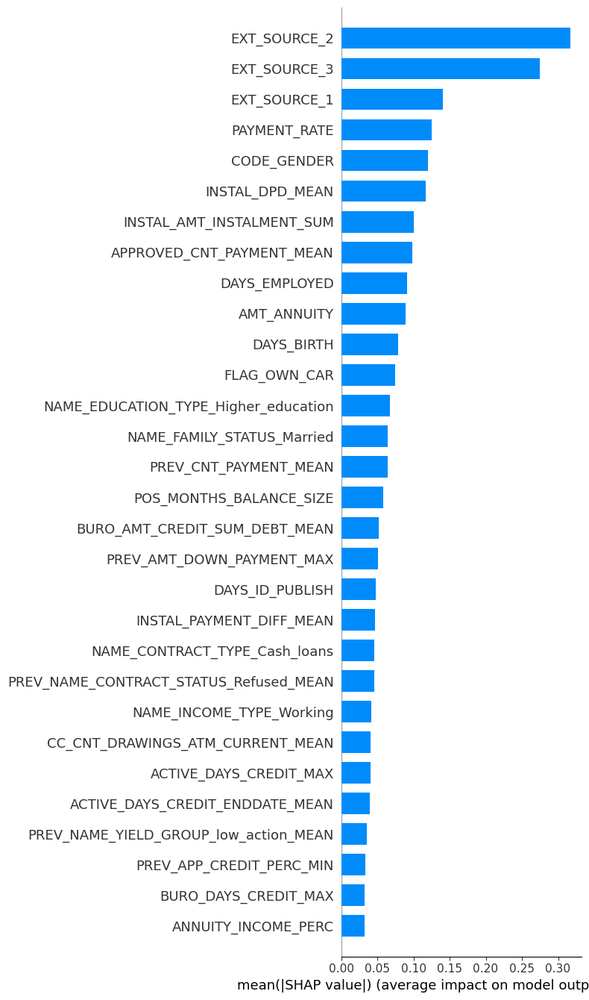

In [384]:
shap.initjs() 

# Affichage de la feature importance
#shap.summary_plot(shap_values, X_resampled, plot_type="bar")
#shap.summary_plot(shap_values, features=X_resampled, feature_names=all_features, plot_type='bar', max_display=30)
shap.summary_plot(shap_values, features=X_test_scaled, feature_names=all_features, plot_type='bar', max_display=30)


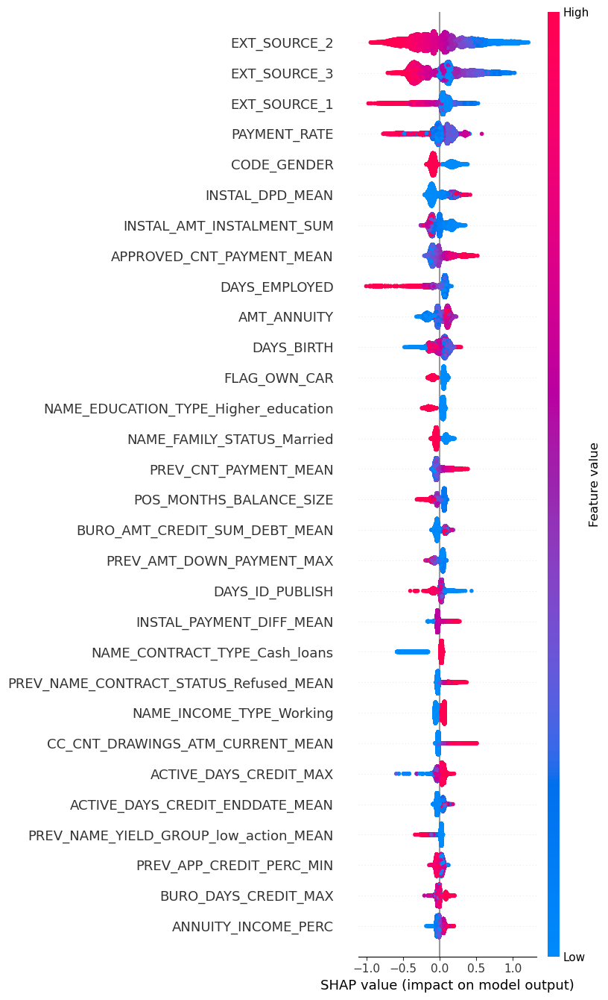

In [386]:
shap.initjs() 
#affichage des 30 variables les plus importantes
shap.summary_plot(shap_values, features=X_test_scaled, feature_names=all_features, max_display=30)

In [388]:
#recupération de la feature importance
feature_importances = np.abs(shap_values).mean(axis=0)

features_importances_df = pd.DataFrame()
row_index = features_importances_df.shape[0]
for i, feature in enumerate(all_features):
    #print(f"{feature} : {feature_importances[i]}")
    features_importances_df.loc[row_index, 'Features'] = feature
    features_importances_df.loc[row_index, 'Features_importances_value'] = feature_importances[i]
    row_index+=1

In [390]:
features_importances_df.sort_values(by = 'Features_importances_value', ascending = False).head(30)

,Features,Features_importances_value
29,EXT_SOURCE_2,0.316625
30,EXT_SOURCE_3,0.274438
28,EXT_SOURCE_1,0.140404
205,PAYMENT_RATE,0.125589
0,CODE_GENDER,0.120341
501,INSTAL_DPD_MEAN,0.117097
515,INSTAL_AMT_INSTALMENT_SUM,0.100928
468,APPROVED_CNT_PAYMENT_MEAN,0.098233
9,DAYS_EMPLOYED,0.090977
6,AMT_ANNUITY,0.088596


In [392]:
#calcul des features avec une valeur importance à zero 
zero_importance_columns = X_train.columns[feature_importances == 0].tolist()
print("Nb features avec une importance nulle : ",len(zero_importance_columns))

Nb features avec une importance nulle :  240


In [394]:
#liste des features avec une valeur importance à zero 
zero_importance_columns

['FLAG_OWN_REALTY',
 'CNT_CHILDREN',
 'FLAG_MOBIL',
 'FLAG_EMP_PHONE',
 'FLAG_CONT_MOBILE',
 'FLAG_EMAIL',
 'REG_REGION_NOT_LIVE_REGION',
 'REG_REGION_NOT_WORK_REGION',
 'LIVE_REGION_NOT_WORK_REGION',
 'LIVE_CITY_NOT_WORK_CITY',
 'FLAG_DOCUMENT_2',
 'FLAG_DOCUMENT_4',
 'FLAG_DOCUMENT_5',
 'FLAG_DOCUMENT_6',
 'FLAG_DOCUMENT_7',
 'FLAG_DOCUMENT_9',
 'FLAG_DOCUMENT_10',
 'FLAG_DOCUMENT_11',
 'FLAG_DOCUMENT_12',
 'FLAG_DOCUMENT_14',
 'FLAG_DOCUMENT_15',
 'FLAG_DOCUMENT_17',
 'FLAG_DOCUMENT_19',
 'FLAG_DOCUMENT_20',
 'FLAG_DOCUMENT_21',
 'AMT_REQ_CREDIT_BUREAU_HOUR',
 'AMT_REQ_CREDIT_BUREAU_WEEK',
 'NAME_TYPE_SUITE_Children',
 'NAME_TYPE_SUITE_Family',
 'NAME_TYPE_SUITE_Group_of_people',
 'NAME_TYPE_SUITE_Other_A',
 'NAME_TYPE_SUITE_Other_B',
 'NAME_TYPE_SUITE_Spouse_partner',
 'NAME_INCOME_TYPE_Businessman',
 'NAME_INCOME_TYPE_Commercial_associate',
 'NAME_INCOME_TYPE_Maternity_leave',
 'NAME_INCOME_TYPE_Student',
 'NAME_INCOME_TYPE_Unemployed',
 'NAME_EDUCATION_TYPE_Academic_degree',
 'NA

In [396]:
#calcul des features avec une valeur importance différente de zero 
importance_columns_notnul = X_train.columns[feature_importances > 0].tolist()
print("Nb features avec une importance non nulle : ",len(importance_columns_notnul))

Nb features avec une importance non nulle :  349


In [398]:
importance_columns_notnul

['CODE_GENDER',
 'FLAG_OWN_CAR',
 'AMT_INCOME_TOTAL',
 'AMT_CREDIT',
 'AMT_ANNUITY',
 'REGION_POPULATION_RELATIVE',
 'DAYS_BIRTH',
 'DAYS_EMPLOYED',
 'DAYS_REGISTRATION',
 'DAYS_ID_PUBLISH',
 'OWN_CAR_AGE',
 'FLAG_WORK_PHONE',
 'FLAG_PHONE',
 'CNT_FAM_MEMBERS',
 'REGION_RATING_CLIENT',
 'HOUR_APPR_PROCESS_START',
 'REG_CITY_NOT_LIVE_CITY',
 'REG_CITY_NOT_WORK_CITY',
 'EXT_SOURCE_1',
 'EXT_SOURCE_2',
 'EXT_SOURCE_3',
 'APARTMENTS_AVG',
 'BASEMENTAREA_AVG',
 'YEARS_BEGINEXPLUATATION_AVG',
 'YEARS_BUILD_AVG',
 'COMMONAREA_AVG',
 'ELEVATORS_AVG',
 'ENTRANCES_AVG',
 'FLOORSMAX_AVG',
 'FLOORSMIN_AVG',
 'LANDAREA_AVG',
 'LIVINGAPARTMENTS_AVG',
 'NONLIVINGAPARTMENTS_AVG',
 'NONLIVINGAREA_AVG',
 'OBS_30_CNT_SOCIAL_CIRCLE',
 'DEF_30_CNT_SOCIAL_CIRCLE',
 'DEF_60_CNT_SOCIAL_CIRCLE',
 'DAYS_LAST_PHONE_CHANGE',
 'FLAG_DOCUMENT_3',
 'FLAG_DOCUMENT_8',
 'FLAG_DOCUMENT_13',
 'FLAG_DOCUMENT_16',
 'FLAG_DOCUMENT_18',
 'AMT_REQ_CREDIT_BUREAU_DAY',
 'AMT_REQ_CREDIT_BUREAU_MON',
 'AMT_REQ_CREDIT_BUREAU_QRT'

In [139]:
#visualisation d'une colonne avec 1 modalité
print('Nb valeurs distincts pour CODE_GENDER :',len(DataFeatureEngennering.groupby('CODE_GENDER')))
resultat = DataFeatureEngennering.groupby(['CODE_GENDER'], dropna=True).size().reset_index()
resultat.columns = ['CODE_GENDER','nb']
resultat['Percentage'] = 100 * resultat['nb']  / resultat['nb'].sum()
resultat.sort_values('Percentage',ascending=False,inplace=True)
resultat.head(10)

Nb valeurs distincts pour CODE_GENDER : 2


,CODE_GENDER,nb,Percentage
1,1,202447,65.835138
0,0,105059,34.164862


<u>Features importance local</u> : explications du modèle pour un client en particulier

- Le <u>force plot</u> est pour voir où se place la prédiction par rapport à la “base value” (c’est la valeur qui serait prédite si nous ne connaissions aucune caractéristiques pour le client  = moyenne des prédictions de défaillance sur le jeu d'entrainement). Nous observons également quelles variables ont un impact positif (rouge) ou négatif (bleu) sur la prédiction et l’amplitude de cet impact. 
- Le <u>Decision plot</u> permet d’observer l’amplitude de chaque changement, “une trajectoire” prise par une instance pour les valeurs des variables affichées.

In [426]:
shap.initjs() 

#exemple d'un client avec une prédiction de non défaillance
i = 35
shap.force_plot(explainer.expected_value, shap_values[i], 
                features=X_test_scaled[i], feature_names=all_features)

- La prédiction de défaillance  pour ce client = <b>-3.81</b>
- La valeur de base = <b>2.782</b>
- Les chiffres sur les flèches sont la valeur de la caractéristique pour ce client
- Les fleches Rouges representent les variables qui poussent le modèle à prédire une défaillance de remboursement, et les fleches Bleues représentent les variables qui poussent à prédire une non défaillance
- Plus l'amplitude de la fleche est grande, plus fort est l'impact de cette variable sur la prédiction.
- Pour cet exemple de client, ce sont plusieurs variables "FLAG_PHONE" et  "EXT_SOURCE_3" et "CODE_GENDER" qui poussent fortement le modèle à prédire une <u>non défaillance</u> du client.

In [412]:
shap.initjs() 
#exemple d'un client avec une prédiction de défaillance
i = 56
shap.force_plot(explainer.expected_value, shap_values[i], 
                features=X_test_scaled[i], feature_names=all_features)

- La prédiction de défaillance  pour ce client = <b>+0.2</b>
- Les chiffres sur les flèches sont la valeur de la caractéristique pour ce client
- Les fleches Rouges representent les variables qui poussent le modèle à prédire une défaillance de remboursement, et les fleches Bleues représentent les variables qui poussent à prédire une non défaillance
- Plus l'amplitude de la fleche est grande, plus fort est l'impact de cette variable sur la prédiction.
- Pour cet exemple de client, ce sont 2 variables "EXT_SOURCE_3" et  "EXT_SOURCE_2" qui poussent fortement le modèle à prédire une <u>défaillance</u> du client.

In [416]:
shap.initjs() 
#exemple d'un client avec une prédiction de défaillance
i = 111
shap.force_plot(explainer.expected_value, shap_values[i], 
                features=X_test_scaled[i], feature_names=all_features)

#### <font color="blue" size=3>5.2.4 Calcul des metrics avec les Features Importance  </font>

<b><u>a) Avec l'ensemble des features importances non nulles</u></b>

On va recalculer le score métier uniquement avec les features importances non nulles 

In [438]:
X = DataFeatureEngennering.drop(columns=['SK_ID_CURR','TARGET'], axis=1)
y = DataFeatureEngennering['TARGET']

In [440]:
X_features_importance = X.drop(columns=zero_importance_columns, axis=1)
X_train, X_test, y_train, y_test = train_test_split(X_features_importance, y, train_size=0.8, random_state=42)


In [442]:
# tracking new experience
mlflow.set_experiment("Simulations du meilleur modèle avec RandomizedSearchCV sur 100% données et avec features importance non nulles")


<Experiment: artifact_location='file:///C:/Users/MOI/PROJET_7/mlruns/461903428084806168', creation_time=1749638678901, experiment_id='461903428084806168', last_update_time=1749638678901, lifecycle_stage='active', name=('Simulations du meilleur modèle avec RandomizedSearchCV sur 100% données et '
 'avec features importance non nulles'), tags={}>

In [444]:
# vérification de la taille des matrices :
print('taille X_train:', X_train.shape)
print('taille X_test:', X_test.shape)
print('taille y_train:', y_train.shape)
print('taille y_test:', y_test.shape)



taille X_train: (246004, 349)
taille X_test: (61502, 349)
taille y_train: (246004,)
taille y_test: (61502,)


Time Fit to compute for Best Params (sec) : 457.0
Best Params : {'model__learning_rate': 0.12638567021515212, 'model__max_depth': 3, 'model__n_estimators': 373, 'model__num_leaves': 64, 'model__reg_alpha': 0.9832308858067882, 'model__reg_lambda': 0.4667628932479799, 'model__subsample': 0.9299702033681603}


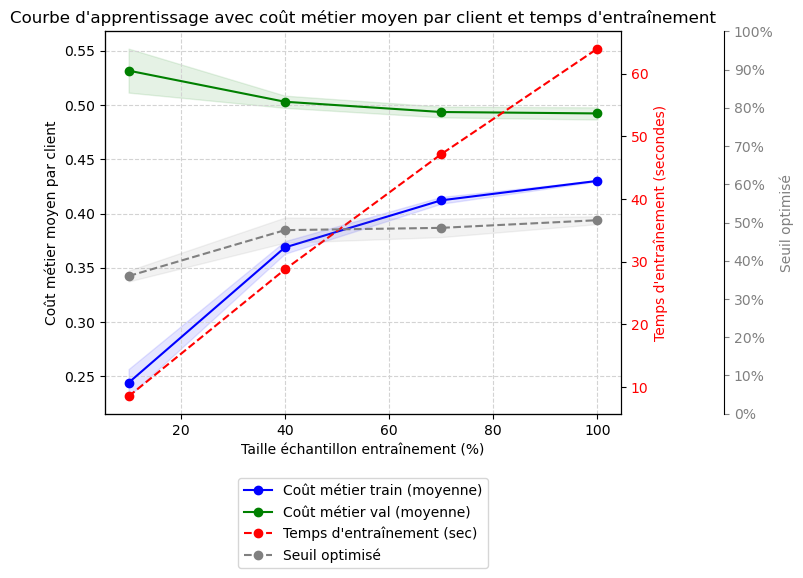

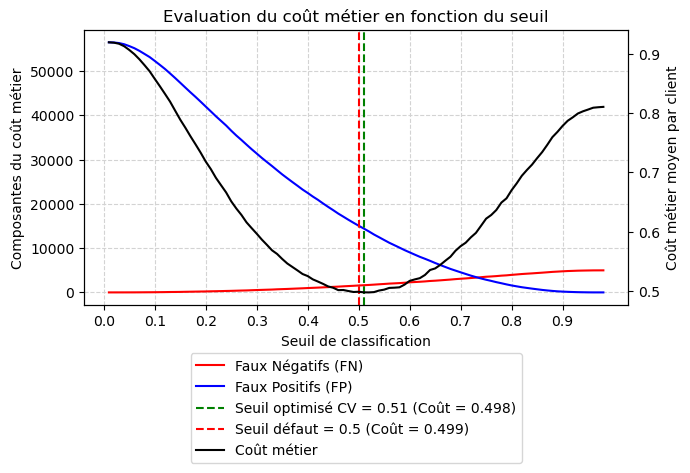

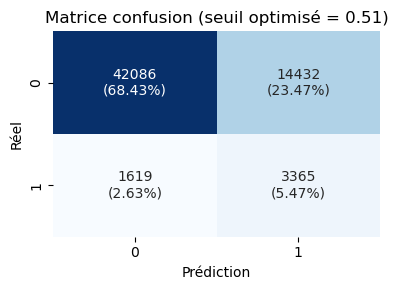

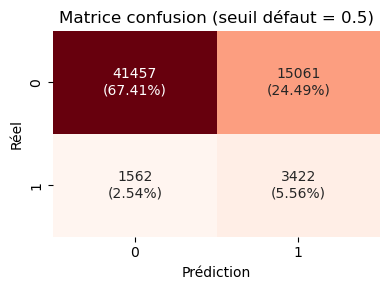

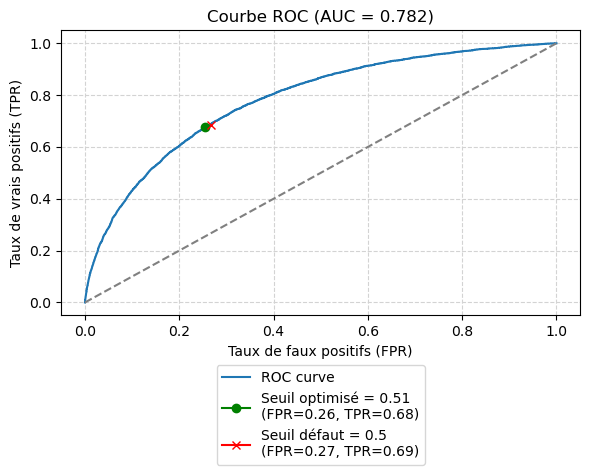

🏃 View run LGBM_MinMax_100_classweight_RSearchCV_featuresImpNotNul at: http://127.0.0.1:5000/#/experiments/461903428084806168/runs/c1724c142bc54488a28cdfc5e5916234
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/461903428084806168


In [448]:
# -----------------------------
# RandomizedSearchCV LGBM
# -----------------------------
hyperparameter_LGBM = {
                  'model__n_estimators'    : randint(10, 500),   #nombre d'estimateur (=arbre)
                  'model__learning_rate'   : uniform(0.01, 0.5), #taux d'apprentissage pour chaque estimateur
                  'model__max_depth'       : randint(1,10),      #profondeur max de chaque estimateur
                  'model__num_leaves'       : randint(10,100),   #nombre de feuilles dans chaque arbre
                  'model__subsample'       : uniform(0.5,0.5),   #proportion d'echantillons à utiliser pour chaque arbre
                  'model__reg_alpha'       : uniform(0,1),       #parametre de regularisation L1/L2
                  'model__reg_lambda'       : uniform(0,1)
                 }

LGBMm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LGBMClassifier(class_weight='balanced', random_state=42, verbose=-1))
])

start_rs_fit = time.time()

cv = StratifiedKFold(n_splits=3, shuffle=True, random_state=42)

random_search = RandomizedSearchCV(
    LGBMm_classweight,
    param_distributions=hyperparameter_LGBM,
    n_iter=10,
    scoring=cost_per_client_scorer,
    cv=cv,
    random_state=42,
    n_jobs=-1,
    verbose=0
)

random_search.fit(X_train, y_train)

end_rs_fit = time.time()
total_rs_fit_time = end_rs_fit - start_rs_fit

#Temps d'entrainement pour estimer les meilleurs hyperparametres
print("Time Fit to compute for Best Params (sec) :", round(total_rs_fit_time,1))

# Meilleur pipeline
best_model = random_search.best_estimator_
best_params = random_search.best_params_
print("Best Params :", best_params)
eval_model_(best_model, 'LGBM', 'LGBM_MinMax_100_classweight_RSearchCV_featuresImpNotNul', X_train, y_train, X_test, y_test, perf_tableaux_optim, "RandomizedSearchCV", best_params)

In [450]:
perf_tableaux_optim

,model,configuration,tuning,cv_seuil_optimal,cv_std_seuil_optimal,cv_cout_metier_optimal,cv_std_cout_metier_optimal,cv_cout_metier_0.5,cv_gain,cv_roc_auc,cv_temps_sec,eval_cout_metier_optimal,eval_cout_metier_0.5,eval_gain,eval_roc_auc,eval_temps_sec
0,LR,LR_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.52,0.017,0.520,0.004,0.522,0.001,0.764,495.9,0.521,0.523,0.002,0.763,143.4
1,LGBM,LGBM_MinMax_100_classweight_RSearchCV,RandomizedSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,74.5,0.496,0.499,0.003,0.782,20.1
2,LR,LR_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.49,0.037,0.560,0.018,0.567,0.008,0.734,16.7,0.545,0.551,0.006,0.756,6.7
3,LGBM,LGBM_MinMax_10_classweight_RSearchCV,RandomizedSearchCV,0.48,0.064,0.540,0.012,0.551,0.010,0.749,9.1,0.545,0.543,-0.002,0.758,4.4
4,LGBM,LGBM_MinMax_100_classweight_GSearchCV,GridSearchCV,0.52,0.015,0.492,0.006,0.493,0.002,0.783,69.1,0.500,0.500,-0.000,0.781,20.1
5,LGBM,LGBM_MinMax_100_classweight_GSearchCV_v2,GridSearchCV,0.50,0.007,0.491,0.005,0.492,0.001,0.784,76.1,0.496,0.496,0.000,0.783,20.7
6,LGBM,LGBM_MinMax_100_classweight_GSearchCV_v3,GridSearchCV,0.51,0.017,0.491,0.004,0.494,0.002,0.784,78.8,0.496,0.499,0.003,0.782,20.9
7,LGBM,LGBM_MinMax_100_classweight_RSearchCV_featuresImpNotNul,RandomizedSearchCV,0.51,0.010,0.492,0.006,0.493,0.000,0.784,60.3,0.498,0.499,0.001,0.782,16.6


<div class="alert alert-block alert-info">
Le modèle LGBMClassifier + RandomizedSearch + 100% données + Features Importance non nulles est :
    
- d'une grande stabilité
- cout métier 0,498 (très légerement dégradé Vs avec toutes les features)
- score ROC AUC 0,782 (identique avec l'ensemble des features 0,782)
- un seuil optimal à 51% (identique avec l'ensemble des features)
- temps de la cross-validation réduit : 60,3 sec Vs 495,9 sec avec l'ensemble des features

<b>C'est donc surtout sur le temps machine que les gains sont significatif en selectionnant l'ensemble des Features Importance non nulles </b></div>

###  <font color="blue" size=5>Chapitre 6 - API </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre6"></a><a name="chapitre6"></a>

#### <font color="green" size=4>6.1 Construction du modèle final avec joblib </font><a href="#chapitre6" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_6_1"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

Construisez un pipeline de prédiction intégrant l'étape de pré-traitement et la classification LGBMClassifier avec les meilleurs hyperparamètres trouvés à l'étape précédente.

In [453]:
#split du jeu de données en train 80% + test 20% 
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.8, random_state=42)

# vérification de la taille des matrices :
print('taille X_train:', X_train.shape)
print('taille X_test:', X_test.shape)
print('taille y_train:', y_train.shape)
print('taille y_test:', y_test.shape)

taille X_train: (246004, 589)
taille X_test: (61502, 589)
taille y_train: (246004,)
taille y_test: (61502,)


In [461]:
#pipeline de prédiction LGBMClassifier + MinMaxScaler + classweight
LGBMm_classweight = Pipeline([
    ('scaler', MinMaxScaler()),
    ('model', LGBMClassifier(
        n_estimators=373,
        learning_rate=0.12638567021515212,
        max_depth=3,
        num_leaves=64,
        reg_alpha=0.9832308858067882,
        reg_lambda=0.4667628932479799,
        subsample=0.9299702033681603,
        class_weight='balanced', 
        random_state=42, 
        verbose=-1))
])


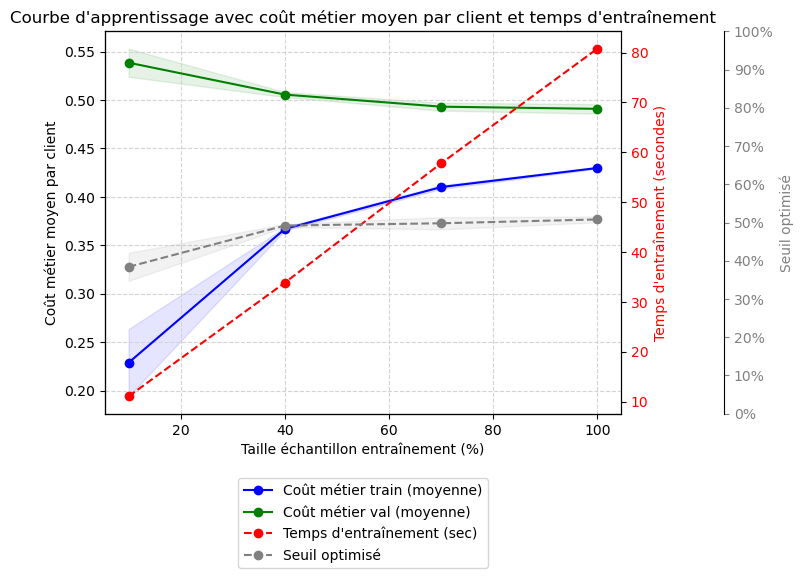

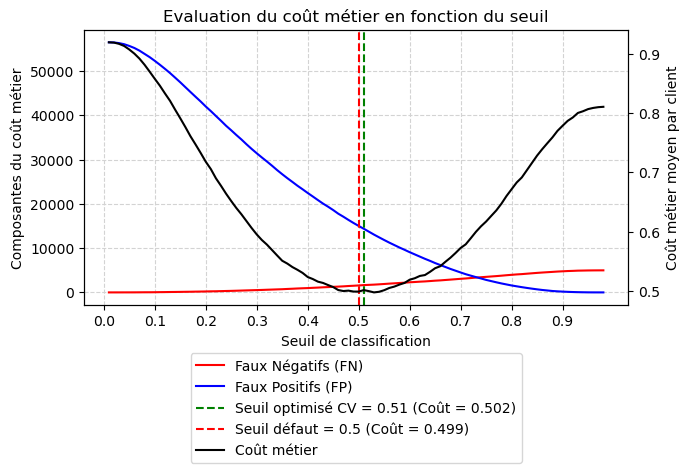

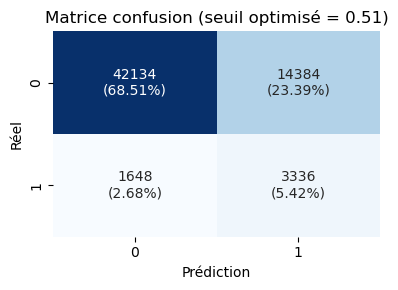

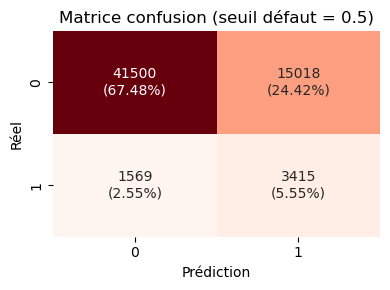

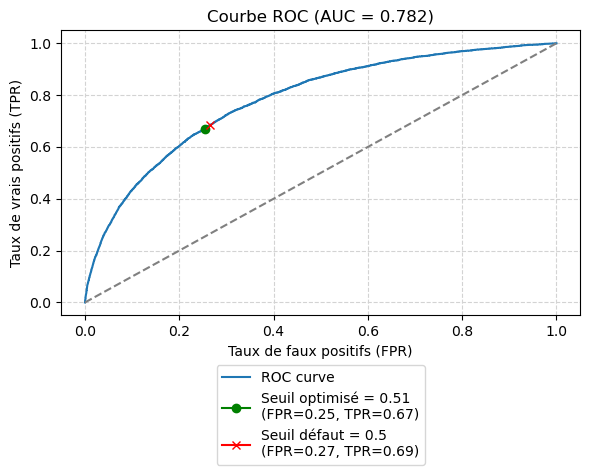

🏃 View run LGBM_MinMax_100_classweight_GSearchCV_VF at: http://127.0.0.1:5000/#/experiments/461903428084806168/runs/8610500aea094b238b806c5a4c42f01c
🧪 View experiment at: http://127.0.0.1:5000/#/experiments/461903428084806168


In [463]:
eval_model_(LGBMm_classweight, 'LGBM', 'LGBM_MinMax_100_classweight_GSearchCV_VF', X_train, y_train, X_test, y_test, perf_tableaux_optim)

Pour déployer notre modèle en production, on va sérialiser le pipeline à l'aide de joblib.

In [466]:
# Réduire la taille du modèle LGBM en supprimant l'historique d'entraînement
model = LGBMm_classweight.named_steps['model']
model.booster_.free_dataset()  # libère les datasets internes inutiles

# Réinsère le modèle allégé dans le pipeline
LGBMm_classweight.named_steps['model'] = model

# Sauvegarde avec une compression
joblib.dump(LGBMm_classweight, 'API/LGBMClm_model.pkl', compress=3)

['API/LGBMClm_model.pkl']

On va sauvegarder le seuil de probabilité optimal

In [468]:
best_threshold = 0.51
with open("API/threshold.txt", "w") as f:
    f.write(str(best_threshold))

On va sauvegarder les 1000 premières lignes du dataset qui a servi à l'entrainement du modèle pour l'API

In [125]:
X_api = DataFeatureEngennering.drop(columns=['TARGET'], axis=1)

In [127]:
X_api = X_api.head(1000)

In [129]:
X_api

,SK_ID_CURR,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGANIZATION_TYPE_Cleaning,ORGANIZATION_TYPE_Construction,ORGANIZATION_TYPE_Culture,ORGANIZATION_TYPE_Electricity,ORGANIZATION_TYPE_Emergency,ORGANIZATION_TYPE_Government,ORGANIZATION_TYPE_Hotel,ORGANIZATION_TYPE_Housing,ORGANIZATION_TYPE_Industry: type 1,ORGANIZATION_TYPE_Industry: type 10,ORGANIZATION_TYPE_Industry: type 11,ORGANIZATION_TYPE_Industry: type 12,ORGANIZATION_TYPE_Industry: type 13,ORGANIZATION_TYPE_Industry: type 2,ORGANIZATION_TYPE_Industry: type 3,ORGANIZATION_TYPE_Industry: type 4,ORGANIZATION_TYPE_Industry: type 5,ORGANIZATION_TYPE_Industry: type 6,ORGANIZATION_TYPE_Industry: type 7,ORGANIZATION_TYPE_Industry: type 8

In [133]:
#visualisation de la target sur les 1000 premiers clients du dataset
print('Nb valeurs distincts pour TARGET :',len(DataFeatureEngennering.head(1000).groupby('TARGET')))
resultat = DataFeatureEngennering.head(1000).groupby(['TARGET'], dropna=True).size().reset_index()
resultat.columns = ['TARGET','nb']
resultat['Percentage'] = 100 * resultat['nb']  / resultat['nb'].sum()
resultat.sort_values('Percentage',ascending=False,inplace=True)
resultat.head(10)

Nb valeurs distincts pour TARGET : 2


,TARGET,nb,Percentage
0,0,930,93.0
1,1,70,7.0


In [135]:
# built new dataset clean feature engennering for my API 
X_api.to_csv('API/data.csv', index=False)

In [159]:
X_api.rename(columns = {'SK_ID_CURR': 'client_id'}, inplace=True)

C:\Users\MOI\AppData\Local\Temp\ipykernel_17324\714354186.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  X_api.rename(columns = {'SK_ID_CURR': 'client_id'}, inplace=True)


In [161]:
X_api

,client_id,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGANIZATION_TYPE_Cleaning,ORGANIZATION_TYPE_Construction,ORGANIZATION_TYPE_Culture,ORGANIZATION_TYPE_Electricity,ORGANIZATION_TYPE_Emergency,ORGANIZATION_TYPE_Government,ORGANIZATION_TYPE_Hotel,ORGANIZATION_TYPE_Housing,ORGANIZATION_TYPE_Industry: type 1,ORGANIZATION_TYPE_Industry: type 10,ORGANIZATION_TYPE_Industry: type 11,ORGANIZATION_TYPE_Industry: type 12,ORGANIZATION_TYPE_Industry: type 13,ORGANIZATION_TYPE_Industry: type 2,ORGANIZATION_TYPE_Industry: type 3,ORGANIZATION_TYPE_Industry: type 4,ORGANIZATION_TYPE_Industry: type 5,ORGANIZATION_TYPE_Industry: type 6,ORGANIZATION_TYPE_Industry: type 7,ORGANIZATION_TYPE_Industry: type 8,

In [163]:
une_liste = X_api["client_id"].astype(str).tolist()

In [137]:
DataFeatureEngennering.head(1000).loc[DataFeatureEngennering['TARGET'] == 1,:]

,SK_ID_CURR,TARGET,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,OWN_CAR_AGE,FLAG_MOBIL,FLAG_EMP_PHONE,FLAG_WORK_PHONE,FLAG_CONT_MOBILE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,REGION_RATING_CLIENT,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,EXT_SOURCE_1,EXT_SOURCE_2,EXT_SOURCE_3,APARTMENTS_AVG,BASEMENTAREA_AVG,YEARS_BEGINEXPLUATATION_AVG,YEARS_BUILD_AVG,COMMONAREA_AVG,ELEVATORS_AVG,ENTRANCES_AVG,FLOORSMAX_AVG,FLOORSMIN_AVG,LANDAREA_AVG,LIVINGAPARTMENTS_AVG,NONLIVINGAPARTMENTS_AVG,NONLIVINGAREA_AVG,OBS_30_CNT_SOCIAL_CIRCLE,DEF_30_CNT_SOCIAL_CIRCLE,DEF_60_CNT_SOCIAL_CIRCLE,DAYS_LAST_PHONE_CHANGE,FLAG_DOCUMENT_2,FLAG_DOCUMENT_3,FLAG_DOCUMENT_4,FLAG_DOCUMENT_5,FLAG_DOCUMENT_6,FLAG_DOCUMENT_7,FLAG_DOCUMENT_8,FLAG_DOCUMENT_9,FLAG_DOCUMENT_10,FLAG_DOCUMENT_11,FLAG_DOCUMENT_12,FLAG_DOCUMENT_13,FLAG_DOCUMENT_14,FLAG_DOCUMENT_15,FLAG_DOCUMENT_16,FLAG_DOCUMENT_17,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR,NAME_CONTRACT_TYPE_Cash loans,NAME_TYPE_SUITE_Children,NAME_TYPE_SUITE_Family,NAME_TYPE_SUITE_Group of people,NAME_TYPE_SUITE_Other_A,NAME_TYPE_SUITE_Other_B,"NAME_TYPE_SUITE_Spouse, partner",NAME_TYPE_SUITE_Unaccompanied,NAME_INCOME_TYPE_Businessman,NAME_INCOME_TYPE_Commercial associate,NAME_INCOME_TYPE_Maternity leave,NAME_INCOME_TYPE_State servant,NAME_INCOME_TYPE_Student,NAME_INCOME_TYPE_Unemployed,NAME_INCOME_TYPE_Working,NAME_EDUCATION_TYPE_Academic degree,NAME_EDUCATION_TYPE_Higher education,NAME_EDUCATION_TYPE_Incomplete higher,NAME_EDUCATION_TYPE_Lower secondary,NAME_EDUCATION_TYPE_Secondary / secondary special,NAME_FAMILY_STATUS_Civil marriage,NAME_FAMILY_STATUS_Married,NAME_FAMILY_STATUS_Separated,NAME_FAMILY_STATUS_Single / not married,NAME_FAMILY_STATUS_Unknown,NAME_FAMILY_STATUS_Widow,NAME_HOUSING_TYPE_Co-op apartment,NAME_HOUSING_TYPE_House / apartment,NAME_HOUSING_TYPE_Municipal apartment,NAME_HOUSING_TYPE_Office apartment,NAME_HOUSING_TYPE_Rented apartment,NAME_HOUSING_TYPE_With parents,OCCUPATION_TYPE_Accountants,OCCUPATION_TYPE_Cleaning staff,OCCUPATION_TYPE_Cooking staff,OCCUPATION_TYPE_Core staff,OCCUPATION_TYPE_Drivers,OCCUPATION_TYPE_HR staff,OCCUPATION_TYPE_High skill tech staff,OCCUPATION_TYPE_IT staff,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,WEEKDAY_APPR_PROCESS_START_FRIDAY,WEEKDAY_APPR_PROCESS_START_MONDAY,WEEKDAY_APPR_PROCESS_START_SATURDAY,WEEKDAY_APPR_PROCESS_START_SUNDAY,WEEKDAY_APPR_PROCESS_START_THURSDAY,WEEKDAY_APPR_PROCESS_START_TUESDAY,WEEKDAY_APPR_PROCESS_START_WEDNESDAY,ORGANIZATION_TYPE_Advertising,ORGANIZATION_TYPE_Agriculture,ORGANIZATION_TYPE_Bank,ORGANIZATION_TYPE_Business Entity Type 1,ORGANIZATION_TYPE_Business Entity Type 2,ORGANIZATION_TYPE_Business Entity Type 3,ORGANIZATION_TYPE_Cleaning,ORGANIZATION_TYPE_Construction,ORGANIZATION_TYPE_Culture,ORGANIZATION_TYPE_Electricity,ORGANIZATION_TYPE_Emergency,ORGANIZATION_TYPE_Government,ORGANIZATION_TYPE_Hotel,ORGANIZATION_TYPE_Housing,ORGANIZATION_TYPE_Industry: type 1,ORGANIZATION_TYPE_Industry: type 10,ORGANIZATION_TYPE_Industry: type 11,ORGANIZATION_TYPE_Industry: type 12,ORGANIZATION_TYPE_Industry: type 13,ORGANIZATION_TYPE_Industry: type 2,ORGANIZATION_TYPE_Industry: type 3,ORGANIZATION_TYPE_Industry: type 4,ORGANIZATION_TYPE_Industry: type 5,ORGANIZATION_TYPE_Industry: type 6,ORGANIZATION_TYPE_Industry: type 7,ORGANIZATION_TYPE_Industry:

#### <font color="green" size=4>6.2 Déploiement de l'API sur Github </font><a href="#chapitre6" style="text-decoration:none"><font color="YellowGreen" size="2">retour début chapitre</font></a><a class="anchor" id="section_6_2"></a> / <a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a>

1. initialise le dépot local : %> <i>git init</i>
2. ajout tous les fichiers : %> <i>git add .</i>
3. commit l'ensemble des fichiers et ajoute un commentaire au commit : %> <i>git commit -m "Initial commit - API FastAPI Projet 7 openclassroom"</i>
4. créer le dépot distant sur le compte github (à faire lors de l'init) %> <i>git remote add origin https://github.com/polo91670/api-scoring-projet7.git</i>
5. créer une branche 'main' à partir du dépot distant : %> <i>git branch -M main</i>
6. pousse les fichiers du dépot local vers la branche main du dépot distant : %> <i>git push -u origin main</i>


pour lancer l'API sur Render<br>
- dans le web service -> startCommand : "uvicorn app.main:app --host=0.0.0.0 --port=8000"
- en local : uvicorn app.main:app --reload

pour lancer Streamlit avec l'API sur Render
- dans le web service -> startCommand : "streamlit run streamlit_app/app.py --server.port=10000 --server.enableCORS=false"
- en local : streamlit run streamlit_app/app.py

l'API et l'application sur le cloud fonctionne via https://dashboard.render.com/

- URL API : https://api-scoring-projet7.onrender.com/predict_score
- URL interface Streamlit : https://streamlit-scoring-projet7.onrender.com/

In [473]:
import requests

url = "https://api-scoring-projet7.onrender.com/predict_score"
data = {"client_id": 100002}
response = requests.post(url, json=data)
print(response.status_code)
print(response.json())

200
{'client_id': 100002, 'score_proba': 0.795, 'seuil_utilisé': 0.51, 'décision': 'Refusé'}


###  <font color="blue" size=5>Chapitre 7 - Data Drift </font><a href="#sommaire" style="text-decoration:none"><font color="skyblue" size="2">retour sommaire</font></a><a id="chapitre7"></a><a name="chapitre7"></a>

<b>Qu’est-ce que le Data Drift ?</b><br>
Le data drift (dérive des données) désigne le changement dans la distribution statistique des données au fil du temps, entre les données sur lesquelles le modèle a été entraîné (données de référence) et les nouvelles données qu’il rencontre en production (données actuelles).


- Si la distribution des données change, la performance du modèle peut se dégrader.
- Détecter le data drift permet d’alerter sur la nécessité de réentraîner ou ajuster le modèle.

<b>Comment Evidently détecte le data drift ?</b><br>
Comparaison statistique entre données de référence et données actuelles.

Tests statistiques (ex : test de Kolmogorov-Smirnov, Chi-2, Wasserstein) sur chaque variable.

Calcul d’un score global et par variable qui indique si une variable a changé de distribution.

<b>Comment interpréter un rapport de data drift ?</b><br>
1. Score global de drift
Souvent entre 0 et 1 :
- Proche de 0 → pas de drift détecté.
- Proche de 1 → forte dérive.

2. Drift par variable
Certaines variables peuvent dériver (alert), d’autres non (stable).

3. Visualisations
Histogrammes, boxplots comparant la distribution des données de référence et courantes.

Les graphiques aident à voir si une variable a plus de valeurs extrêmes, une moyenne différente, etc.

In [477]:
pip show evidently

Name: evidently
Version: 0.7.8
Summary: Open-source tools to analyze, monitor, and debug machine learning model in production.
Home-page: https://github.com/evidentlyai/evidently
Author: Emeli Dral
Author-email: emeli.dral@gmail.com
License: UNKNOWN
Location: C:\Users\MOI\anaconda3\Lib\site-packages
Requires: certifi, cryptography, deprecation, dynaconf, fsspec, iterative-telemetry, litestar, nltk, numpy, pandas, plotly, pydantic, PyYAML, requests, rich, scikit-learn, scipy, statsmodels, typer, typing-inspect, ujson, urllib3, uuid6, uvicorn, watchdog
Required-by: 
Note: you may need to restart the kernel to use updated packages.


In [479]:
# jeu de données de référence sans l'id client et la target
reference_df =  DataAppTrain.drop(columns=['SK_ID_CURR','TARGET'], axis=1)

In [480]:
#jeu de données récent
current_df  = DataAppTest.drop(columns=['SK_ID_CURR'], axis=1)

In [481]:
reference_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Columns: 120 entries, NAME_CONTRACT_TYPE to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(39), object(16)
memory usage: 281.5+ MB


In [482]:
current_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 48744 entries, 0 to 48743
Columns: 120 entries, NAME_CONTRACT_TYPE to AMT_REQ_CREDIT_BUREAU_YEAR
dtypes: float64(65), int64(39), object(16)
memory usage: 44.6+ MB


In [483]:
# Création du rapport avec le preset Data Drift
report = Report(metrics=[DataDriftPreset()])

# Calcul du rapport sur les données
my_eval = report.run(reference_data=reference_df, current_data=current_df)

In [485]:
# Affiche le rapport complet dans un notebook Jupyter
my_eval

In [ ]:

# Pour exporter le rapport en HTML
my_eval.save_html("data_drift_report.html")

Le tableau indique le message "Dataset Drift is NOT detected".<br>
Le test de dérive globale n’a pas détecté de drift entre les données de référence (dataset train qui a servi au train) et les données actuelles (dataset test).

Le seuil de détection du drift est fixé à 0.5<br>
- Si la valeur calculée du drift est inférieure à 0.5, alors on considère qu’il n’y a pas de drift.
- Si elle avait été supérieure ou égale à 0.5, on considére que le drift est détecté.

Le score global de drift calculé est de 0.075 donc < 0.5 → pas de changement statistiquement important dans la distribution des données.

Les données observées en production ressemblent bien aux données d’entraînement.

Au niveau de la dérive locale (variable par variable), il y a 9 variables qui présentent une dérive des données car leur score de drift > 0.1<br>
En général le score de drift mesure l'écart entre la distribution référence et actuelle avec différent test statistique selon le typage de la variable (Test de Kolmogorov-Smirnov, la distance de Wasserstein).:
- inf à 0.1 : pas de dérive
- 0.1 - 0.3 : légère dérive
- 0.3 - 0.5 : dérive modéré
- sup à 0.5 : dérive importante 


Par exemple sur la variable NAME_CONTRACT_TYPE : 
- dans le dataset train : 2 modalités "cash loans"  + "cash revolving"
- dans le dataset test : 1 seule modalité "cash loans"